# Predicting the Soil Temperature at 100cm depth using machine learning
### 1. Problem definition
> Soil temperature is one of the important parameters of a soil characteristics that contributes information in understanding the nitrate levels of a soil at different depths. This is because the soil temperature affects the soil's microbial activity, plant uptake, volatilization of Nitrogen compounds and leaching.  NMBU measures soil temperature at different depths (2cm, 5cm, 10cm, 20cm, 50cm, 100cm) using platinum resistance thermometers called PT100. Machine learning based predication may help reducing the effort and installation cost required to measure temperature at deeper soil levels such 100cm. This machine learning algorithm will first try to predict the soil temperature at 100cm from the different data features. 
### 2. Data Source
> To start the analysis process, the data source (2018-2022) is downloaded from the Meteorological data for Ås - BIOKLIM website (https://www.nmbu.no/forskning/grupper/meteorologiske-data) and organized into one big dataset which contains nearly 1800 samples. The improvements will be: first, the dataset will be improved to have bigger number of samples (2000-2024); second, multi-sites will be considererd to make the prediction more generic for different types of soils in Norway.
> #### There is one dataset inside the data folder
### 3. Evaluation metrics
> The evaluation metrics such as R-squared (R²) Score, Mean Absolute Error (MAE), Mean Square Error (MSE) and Root Mean Square Log Error (RMSLE) will be considered as common regression metrics.
> > The goal of this machine learning model is to build a machine leanrning model that minimizes the erros: MAE, MSE, RMSLE and increase the R-squared (R²) Score.
### 4. Data Features
> The original features of the dataset are:  month,	date, mean_air_temperature_2m, min_air_temperature_2m,	max_air_temperature_2m	soil_temperature_2cm,	soil_temperature_5cm,	soil_temperature_10cm,	soil_temperature_20cm,	soil_temperature_50cm,	relative_humudity_%,	air_pressure_2m_mbar,	radiation_balance_w_m2,	albedo_RR_GR,	earth_heat_flux_MJ_m2,	evaporation_mm,	rainfall_mm,	snowfall_cm. But through feature importance analysis less number of features will be used for consideration.
>> The original dataset is inside the data folder in this project with a file name 'NMBUBigDatasetFinal.csv'.



In [1]:
# !pip install statsmodels

In [2]:
# !pip install tensorflow

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import sklearn
import seaborn as sns
# Import the train_test_split module from sklearn
from sklearn.model_selection import train_test_split
# For z-score calculations
from scipy import stats
# Import the GridSearchCV and RandomizeSearchCV
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
import mplcursors
import pickle
from joblib import dump, load
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import IsolationForest

In [2]:
dataset = pd.read_csv("data/NMBUBigDatasetFinal.csv", low_memory=False)

In [3]:
dataset

,ID,date,mean_air_temperature_2m,min_air_temperature_2m,max_air_temperature_2m,relative_humidity,air_pressure_2m_mbar,precipitation_mm,evaporation_mm,earth_heat_flux_MJ_m2,radiation_balance_w_m2,phosynthetic_active_radiation_mE_m2,albedo_RR_GR,snow_depth_cm,ST2,ST5,ST10,ST20,ST50,ST100
0,1,1/1/2000,-5.0,-7.6,-3.0,100.0,1001.5,NaN,NaN,-0.3,-0.12,1.17,0.74,NaN,-0.2,-0.1,0.1,0.4,1.9,3.4
1,2,1/2/2000,0.6,-5.0,4.0,88.6,997.7,NaN,NaN,-0.2,-2.21,1.62,0.77,NaN,-0.1,-0.1,0.0,0.4,1.9,3.4
2,3,1/3/2000,2.1,-1.1,4.6,88.6,991.5,8.8,NaN,-0.1,-1.80,0.71,0.39,NaN,-0.1,-0.1,0.0,0.5,1.9,3.4
3,4,1/4/2000,1.8,-3.3,4.4,67.3,987.0,2.1,NaN,-0.1,-4.83,2.49,0.48,NaN,0.0,0.0,0.1,0.5,1.9,3.4
4,5,1/5/2000,0.6,-3.6,4.4,98.2,993.3,1.2,NaN,-0.2,-0.44,1.68,0.17,NaN,0.0,0.0,0.1,0.5,1.9,3.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8851,8852,3/28/2024,5.2,2.4,7.9,90.0,976.7,7.6,NaN,0.6,0.45,13.34,0.21,NaN,1.6,1.3,1.0,0.9,1.2,2.0
8852,8853,3/29/2024,5.9,4.7,7.4,93.6,978.3,2.6,NaN,0.8,0.29,9.17,0.18,NaN,2.9,2.6,2.1,1.7,1.5,2.1
8853,8854,3/30/2024,5.9,4.0,7.4,94.4,990.1,2.0,NaN,0.7,0.61,9.32,0.18,NaN,3.5,3.3,2.8,2.5,1.9,2.2
8854,8855,3/31/2024,6.2,2.4,8.0,93.6,988.1,2.9,NaN,0.6,0.02,8.09,0.18,NaN,4.2,4.1,3.6,3.1,2.4,2.3


# 1. Data Preprocessing Stage
### Excel manipulation to clean the original dataset
#### 1. Duplicate values were removed where one date is repeated.
#### 2. Some of the snow_depth_cm data read from sensor are replaced by the manually recorded snow_depth_manual_cm data if manual recording data exists
#### 3. Unnecessary columns are removed from the original dataset


In [4]:
# dataset['snow_depth_cm'] = dataset['snow_depth_cm'].fillna(dataset['snow_depth_manual_cm'])
# dataset.drop('snow_depth_manual_cm', axis=1, inplace=True)

In [5]:
# Add a year, month and day columns by feature engineering to make manipulation of these easy
dataset['date'] = pd.to_datetime(dataset['date'])
dataset_copied = dataset.copy()
dataset_copied['year'] = dataset_copied['date'].dt.year
dataset_copied['month'] = dataset_copied['date'].dt.month
dataset_copied['day'] = dataset_copied['date'].dt.day

In [6]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8856 entries, 0 to 8855
Data columns (total 20 columns):
 #   Column                               Non-Null Count  Dtype         
---  ------                               --------------  -----         
 0   ID                                   8856 non-null   int64         
 1   date                                 8856 non-null   datetime64[ns]
 2   mean_air_temperature_2m              8856 non-null   float64       
 3   min_air_temperature_2m               8856 non-null   float64       
 4   max_air_temperature_2m               8856 non-null   float64       
 5   relative_humidity                    8764 non-null   float64       
 6   air_pressure_2m_mbar                 8822 non-null   float64       
 7   precipitation_mm                     8402 non-null   float64       
 8   evaporation_mm                       2466 non-null   float64       
 9   earth_heat_flux_MJ_m2                7891 non-null   float64       
 10  radiation_ba

In [7]:
dataset.isna().sum()

ID                                        0
date                                      0
mean_air_temperature_2m                   0
min_air_temperature_2m                    0
max_air_temperature_2m                    0
relative_humidity                        92
air_pressure_2m_mbar                     34
precipitation_mm                        454
evaporation_mm                         6390
earth_heat_flux_MJ_m2                   965
radiation_balance_w_m2                  202
phosynthetic_active_radiation_mE_m2     427
albedo_RR_GR                            684
snow_depth_cm                          7537
ST2                                      96
ST5                                      94
ST10                                    157
ST20                                    170
ST50                                    324
ST100                                    95
dtype: int64

In [8]:
dataset_copied

,ID,date,mean_air_temperature_2m,min_air_temperature_2m,max_air_temperature_2m,relative_humidity,air_pressure_2m_mbar,precipitation_mm,evaporation_mm,earth_heat_flux_MJ_m2,...,snow_depth_cm,ST2,ST5,ST10,ST20,ST50,ST100,year,month,day
0,1,2000-01-01,-5.0,-7.6,-3.0,100.0,1001.5,NaN,NaN,-0.3,...,NaN,-0.2,-0.1,0.1,0.4,1.9,3.4,2000,1,1
1,2,2000-01-02,0.6,-5.0,4.0,88.6,997.7,NaN,NaN,-0.2,...,NaN,-0.1,-0.1,0.0,0.4,1.9,3.4,2000,1,2
2,3,2000-01-03,2.1,-1.1,4.6,88.6,991.5,8.8,NaN,-0.1,...,NaN,-0.1,-0.1,0.0,0.5,1.9,3.4,2000,1,3
3,4,2000-01-04,1.8,-3.3,4.4,67.3,987.0,2.1,NaN,-0.1,...,NaN,0.0,0.0,0.1,0.5,1.9,3.4,2000,1,4
4,5,2000-01-05,0.6,-3.6,4.4,98.2,993.3,1.2,NaN,-0.2,...,NaN,0.0,0.0,0.1,0.5,1.9,3.4,2000,1,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8851,8852,2024-03-28,5.2,2.4,7.9,90.0,976.7,7.6,NaN,0.6,...,NaN,1.6,1.3,1.0,0.9,1.2,2.0,2024,3,28
8852,8853,2024-03-29,5.9,4.7,7.4,93.6,978.3,2.6,NaN,0.8,...,NaN,2.9,2.6,2.1,1.7,1.5,2.1,2024,3,29
8853,8854,2024-03-30,5.9,4.0,7.4,94.4,990.1,2.0,NaN,0.7,...,NaN,3.5,3.3,2.8,2.5,1.9,2.2,2024,3,30
8854,8855,2024-03-31,6.2,2.4,8.0,93.6,988.1,2.9,NaN,0.6,...,NaN,4.2,4.1,3.6,3.1,2.4,2.3,2024,3,31


In [9]:
dataset

,ID,date,mean_air_temperature_2m,min_air_temperature_2m,max_air_temperature_2m,relative_humidity,air_pressure_2m_mbar,precipitation_mm,evaporation_mm,earth_heat_flux_MJ_m2,radiation_balance_w_m2,phosynthetic_active_radiation_mE_m2,albedo_RR_GR,snow_depth_cm,ST2,ST5,ST10,ST20,ST50,ST100
0,1,2000-01-01,-5.0,-7.6,-3.0,100.0,1001.5,NaN,NaN,-0.3,-0.12,1.17,0.74,NaN,-0.2,-0.1,0.1,0.4,1.9,3.4
1,2,2000-01-02,0.6,-5.0,4.0,88.6,997.7,NaN,NaN,-0.2,-2.21,1.62,0.77,NaN,-0.1,-0.1,0.0,0.4,1.9,3.4
2,3,2000-01-03,2.1,-1.1,4.6,88.6,991.5,8.8,NaN,-0.1,-1.80,0.71,0.39,NaN,-0.1,-0.1,0.0,0.5,1.9,3.4
3,4,2000-01-04,1.8,-3.3,4.4,67.3,987.0,2.1,NaN,-0.1,-4.83,2.49,0.48,NaN,0.0,0.0,0.1,0.5,1.9,3.4
4,5,2000-01-05,0.6,-3.6,4.4,98.2,993.3,1.2,NaN,-0.2,-0.44,1.68,0.17,NaN,0.0,0.0,0.1,0.5,1.9,3.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8851,8852,2024-03-28,5.2,2.4,7.9,90.0,976.7,7.6,NaN,0.6,0.45,13.34,0.21,NaN,1.6,1.3,1.0,0.9,1.2,2.0
8852,8853,2024-03-29,5.9,4.7,7.4,93.6,978.3,2.6,NaN,0.8,0.29,9.17,0.18,NaN,2.9,2.6,2.1,1.7,1.5,2.1
8853,8854,2024-03-30,5.9,4.0,7.4,94.4,990.1,2.0,NaN,0.7,0.61,9.32,0.18,NaN,3.5,3.3,2.8,2.5,1.9,2.2
8854,8855,2024-03-31,6.2,2.4,8.0,93.6,988.1,2.9,NaN,0.6,0.02,8.09,0.18,NaN,4.2,4.1,3.6,3.1,2.4,2.3


### NOTE: There are huge missing values for evaporation_mm= 6392, snow_depth_cm=7272 which hugely affect our data if we randomly impute them. So we need to study why these data are missing to decide on either to impute or drop these features from our dataset. To see if the missing values are evenly distributed throughout the period or are missing at specific instants, let us see the time series trend.

#### Draw Evaporation(mm) vs Time to see the trend and missing values

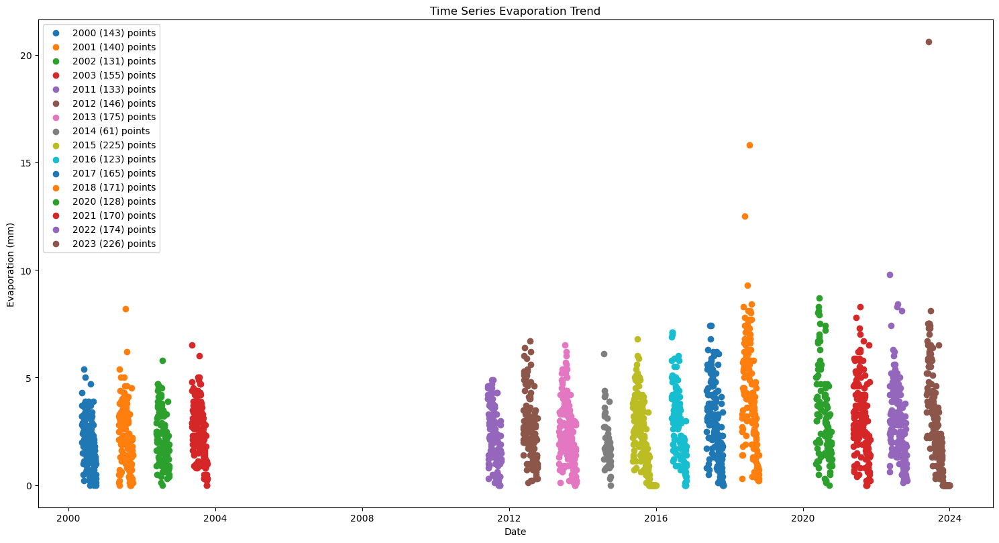

In [10]:
# Draw the scatter plot of the evaporation witht respect to time
# Filter out rows where evaporation is not missing
valid_evap_data = dataset_copied.dropna(subset=['evaporation_mm'])

# Group the valid data by year
# valid_evap_data['Year'] = valid_evap_data['year']
grouped_evap_data = valid_evap_data.groupby('year')

# Draw the scatter plot of snow_depth_cm vs date
def scatter_evaporation_timeseries(dataset_name, file='images/evaporation_mm_trend.png'):
    # Determine the number of unique groups (years) to adjust the figure size
    num_years = len(dataset_name['year'].unique())
    
    # Base figure height and additional height per year
    base_height = 5
    extra_height_per_year = 0.2
    
    # Adjust figure height based on the number of legend items
    fig_height = base_height + extra_height_per_year * num_years
    fig, ax = plt.subplots(figsize=(15, fig_height))
    
    for year, group in dataset_name:
        ax.scatter(group['date'], group['evaporation_mm'], label=f'{year} ({len(group)}) points')
    
    # Set plot title and labels
    ax.set(title="Time Series Evaporation Trend", xlabel="Date", ylabel="Evaporation (mm)")
    
    # Add legend outside the plot area
    ax.legend()
    
    # Adjust layout to make room for the legend
    plt.tight_layout()
    
    # Save the plot
    plt.savefig(file, bbox_inches='tight')
    plt.show()
    
scatter_evaporation_timeseries(grouped_evap_data, 'images/evaporation_mm_missing_values')

### The above evaporation scatter plot shows there is missing data from 2004 - 2010 and 2019 which are in total 8 years. So, we can see at least 8 years data is fully missing. The majority of the evaporation value range from 0 to 10mm but there are three values which tend to be outliers and can be removed from the dataset. Two of them are in 2018 (12.5mm and 15.8mm) and one is in 2023 (20.6mm).

#### Remove the evaporation outliers (>10mm) from the dataset and redraw the scatter plot of evaporation timeseries

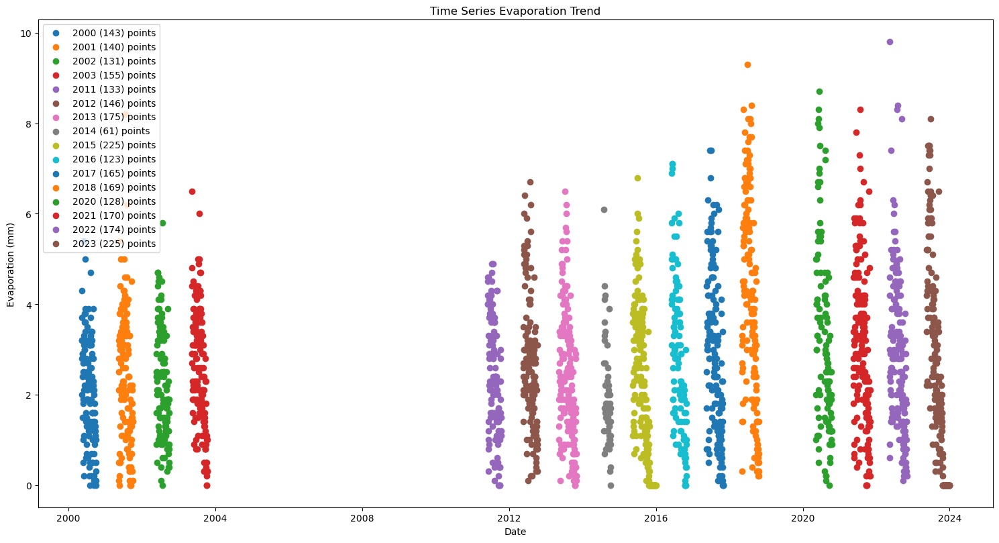

In [11]:
# Filter rows where 'evaporation_mm' is less than or equal to 10 and re-draw
dataset_copied = dataset_copied[(dataset_copied['evaporation_mm'] <= 10) | (pd.isna(dataset_copied['evaporation_mm']))]

# Filter out rows where evaporation is not missing
valid_evap_data = dataset_copied.dropna(subset=['evaporation_mm'])

# Group the valid data by year
grouped_evap_data = valid_evap_data.groupby('year')
# Redraw the evaporation_mm with time for outliers removed
scatter_evaporation_timeseries(grouped_evap_data, 'images/evaporation_mm_outliers_removed.png')

#### Fill the missing values of evaporation by the average of each same day throughout the years for non-empty values.

In [12]:
dataset_copied.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8853 entries, 0 to 8855
Data columns (total 23 columns):
 #   Column                               Non-Null Count  Dtype         
---  ------                               --------------  -----         
 0   ID                                   8853 non-null   int64         
 1   date                                 8853 non-null   datetime64[ns]
 2   mean_air_temperature_2m              8853 non-null   float64       
 3   min_air_temperature_2m               8853 non-null   float64       
 4   max_air_temperature_2m               8853 non-null   float64       
 5   relative_humidity                    8761 non-null   float64       
 6   air_pressure_2m_mbar                 8819 non-null   float64       
 7   precipitation_mm                     8399 non-null   float64       
 8   evaporation_mm                       2463 non-null   float64       
 9   earth_heat_flux_MJ_m2                7888 non-null   float64       
 10  radiation_balance

In [13]:
dataset_copied.isna().sum()

ID                                        0
date                                      0
mean_air_temperature_2m                   0
min_air_temperature_2m                    0
max_air_temperature_2m                    0
relative_humidity                        92
air_pressure_2m_mbar                     34
precipitation_mm                        454
evaporation_mm                         6390
earth_heat_flux_MJ_m2                   965
radiation_balance_w_m2                  202
phosynthetic_active_radiation_mE_m2     427
albedo_RR_GR                            684
snow_depth_cm                          7534
ST2                                      96
ST5                                      94
ST10                                    157
ST20                                    170
ST50                                    324
ST100                                    95
year                                      0
month                                     0
day                             

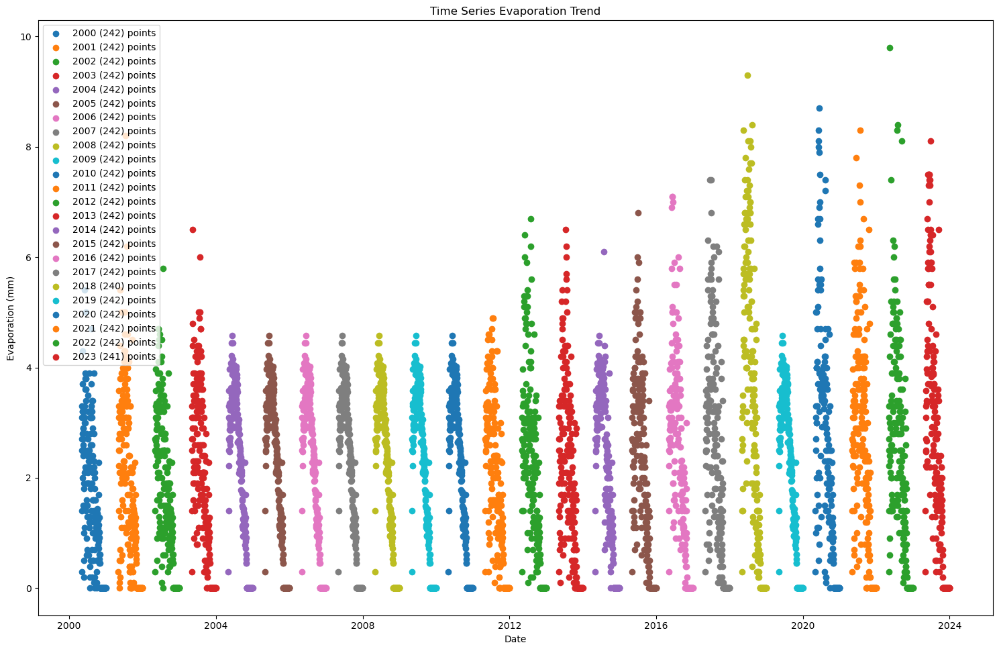

In [14]:
# Calculate the mean for evaporation_mm considering only non-NaN values for each day and month
mean_values = dataset_copied.groupby(['day', 'month'])['evaporation_mm'].apply(lambda x: x.dropna().mean()).reset_index(name='evaporation_mm_mean')

# Merge mean_values with the original DataFrame to fill missing values
dataset_copied = pd.merge(dataset_copied, mean_values, on=['day', 'month'], how='left')

# Fill missing values for evaporation_mm with the mean values calculated for the specific range of years
def fill_missing_evaporation(row):
    if pd.isna(row['evaporation_mm']):
        # Calculate the mean value for the specific range of years
        filtered_means = mean_values[(mean_values['day'] == row['day']) & (mean_values['month'] == row['month'])]
        mean_value = filtered_means['evaporation_mm_mean'].mean() if not filtered_means.empty else None
        return mean_value
    else:
        return row['evaporation_mm']

# Fill missing values for evaporation_mm with the mean values calculated for the specific range of years
dataset_copied['evaporation_mm'] = dataset_copied.apply(fill_missing_evaporation, axis=1)
# Drop auxiliary columns
dataset_copied.drop('evaporation_mm_mean', axis=1, inplace=True)
# Drop duplicates in case there are overlapping values from the merge
dataset_copied.drop_duplicates(inplace=True)

# Redraw the scatter plot for evaporation timeseries
# Filter out rows where evaporation is not missing
valid_evap_data = dataset_copied.dropna(subset=['evaporation_mm'])

# Group the valid data by year
grouped_evap_data = valid_evap_data.groupby('year')

# Draw the scatter plot of snow_depth_cm vs date
scatter_evaporation_timeseries(grouped_evap_data, 'images/evaporation_mm_missing_values_filled.png')

In [15]:
dataset_copied.isna().sum()

ID                                        0
date                                      0
mean_air_temperature_2m                   0
min_air_temperature_2m                    0
max_air_temperature_2m                    0
relative_humidity                        92
air_pressure_2m_mbar                     34
precipitation_mm                        454
evaporation_mm                         3048
earth_heat_flux_MJ_m2                   965
radiation_balance_w_m2                  202
phosynthetic_active_radiation_mE_m2     427
albedo_RR_GR                            684
snow_depth_cm                          7534
ST2                                      96
ST5                                      94
ST10                                    157
ST20                                    170
ST50                                    324
ST100                                    95
year                                      0
month                                     0
day                             

#### Let's count and draw the missing values based on monthes to see if the evaporation is missing for winter seasons

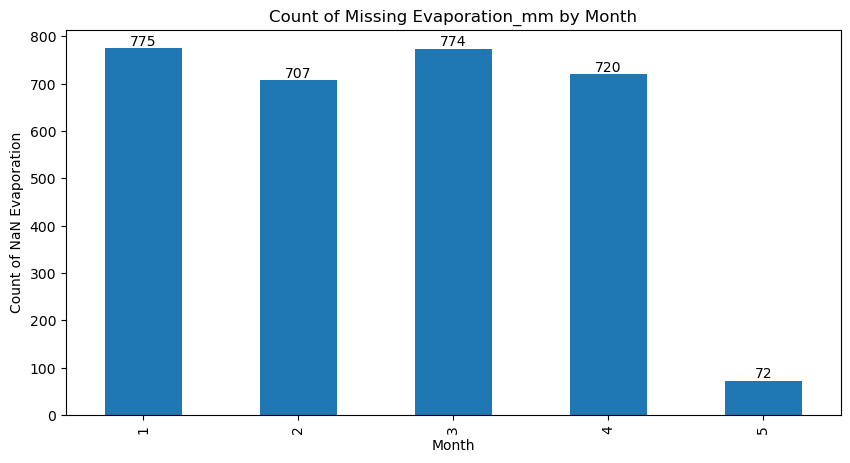

In [16]:
# Filter the dataframe to select rows where evaporation_mm is NaN
nan_evaporation = dataset_copied[dataset_copied['evaporation_mm'].isna()]

# Group by month and count NaN occurrenc
nan_evaporation_counts = nan_evaporation.groupby('month').size()

# Define the plot
fig, ax = plt.subplots(figsize=(10,5))
# Plotting the bar graph
nan_evaporation_counts.plot(kind='bar', ax=ax)

# Annotating each bar with its count value
for i, count in enumerate(nan_evaporation_counts):
    ax.text(i, count, str(count), ha='center', va='bottom')

# Setting labels and title
ax.set_xlabel('Month')
ax.set_ylabel('Count of NaN Evaporation')
ax.set_title('Count of Missing Evaporation_mm by Month')
# Save the figure to a file (e.g., PNG, PDF, etc.)
plt.savefig('images/evaporation_missing_count_by_month.png')  # Save as PNG format
# Displaying the plot
plt.show()

#### The above bargraph shows the missing evaporation measurements are mostly from January - April except few in May. This could be due to the winter season that evaporation is less likely. So, we can fill them all by zero value.

In [17]:
# Fill the missing evaporation_mm values by zero
dataset_copied['evaporation_mm'] = dataset_copied['evaporation_mm'].fillna(0.0)
dataset_copied.isna().sum()

ID                                        0
date                                      0
mean_air_temperature_2m                   0
min_air_temperature_2m                    0
max_air_temperature_2m                    0
relative_humidity                        92
air_pressure_2m_mbar                     34
precipitation_mm                        454
evaporation_mm                            0
earth_heat_flux_MJ_m2                   965
radiation_balance_w_m2                  202
phosynthetic_active_radiation_mE_m2     427
albedo_RR_GR                            684
snow_depth_cm                          7534
ST2                                      96
ST5                                      94
ST10                                    157
ST20                                    170
ST50                                    324
ST100                                    95
year                                      0
month                                     0
day                             

### Plot the evaporation data after removing all missing values

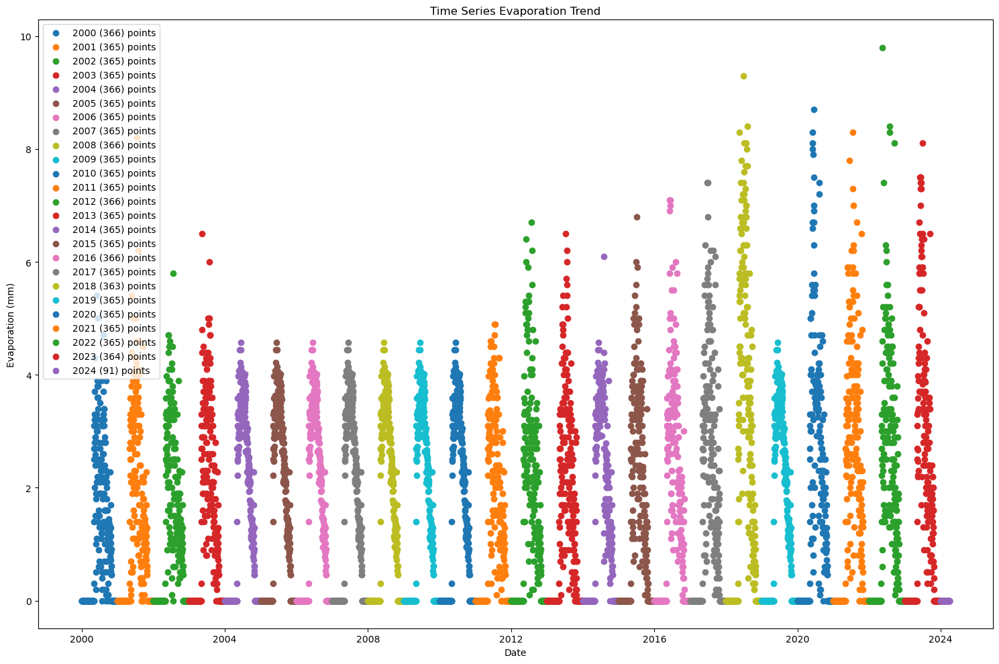

In [18]:
# Redraw the scatter plot for evaporation timeseries
# Filter out rows where evaporation is not missing
valid_evap_data_filled = dataset_copied.dropna(subset=['evaporation_mm'])

# Group the valid data by year
grouped_evap_data_filled = valid_evap_data_filled.groupby('year')

# Draw the scatter plot of snow_depth_cm vs date
scatter_evaporation_timeseries(grouped_evap_data_filled, 'images/evaporation_mm_all_missing_values_filled.png')

#### Draw Snow Depth(cm) vs Time to see the trend and missing values with time

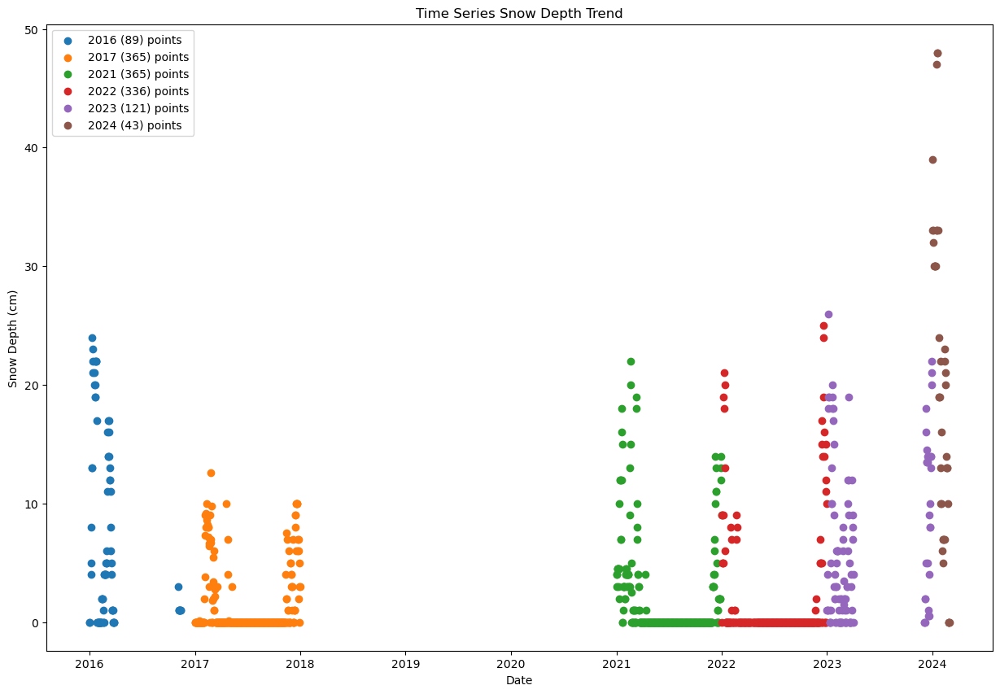

In [19]:
def scatter_snow_depth_timeseries(dataset_name, file='images/snow_depth_time_series.png'):
    # Draw the scatter plot of the evaporation witht respect to time
    # Determine the number of unique groups (years) to adjust the figure size
    num_years = len(dataset_name['year'].unique())
    
    # Base figure height and additional height per year
    base_height = 5
    extra_height_per_year = 0.2
    
    # Adjust figure height based on the number of legend items
    fig_height = base_height + extra_height_per_year * num_years
    fig, ax = plt.subplots(figsize=(15, fig_height))
    # Filter out rows where snow_depth_cm is not missing
    valid_snow_data = dataset_name.dropna(subset=['snow_depth_cm'])
    
    # Group the valid data by year
    # valid_snow_data['Year'] = valid_snow_data['date'].dt.year
    grouped_snow_data = valid_snow_data.groupby('year')
    
    for year, group in grouped_snow_data:
        ax.scatter(group['date'], group['snow_depth_cm'], label=f'{year} ({len(group)}) points')
    
    # Set plot title and labels
    ax.set(title="Time Series Snow Depth Trend", xlabel="Date", ylabel="Snow Depth (cm)")
    
    # Add legend
    ax.legend()
    # Save the figure to a file (e.g., PNG, PDF, etc.)
    plt.savefig(file)
    
    plt.show()
    
scatter_snow_depth_timeseries(dataset_copied, 'images/snow_depth_time_series_missing_values.png')

### The above snow depth scatter plot shows that snow data is completely missing from 2000-2015 and 2019. The daily snow depth ranges from 0 to about 50 cm.

### Some of the surface snow thickness values missing from the dataset are filled from the data gathered from MET Norway Frost API from 10/01/2016 - 29/03/2024

In [20]:
# Merge the two dataframes based on the 'date' column
snow_thickness = pd.read_csv('data/surface_snow_daily_2016_2024.csv')
snow_thickness['date'] = pd.to_datetime(snow_thickness['date'])
# Replace all values of snow_thickness['snow_depth_cm'] equal to -1 with 0 because -1 in MET Frost API indicates it is a very low or zero snow depth
snow_thickness.loc[snow_thickness['snow_depth_cm'] == -1, 'snow_depth_cm'] = 0

# Merge the two dataframes based on the 'date' column
merged_df = pd.merge(dataset_copied, snow_thickness, on='date', suffixes=('_copied', '_thickness'), how='left')

# Copy values from 'snow_depth_cm_thickness' to 'snow_depth_cm_copied' where 'snow_depth_cm_copied' is NaN
merged_df['snow_depth_cm_copied'] = merged_df['snow_depth_cm_copied'].fillna(merged_df['snow_depth_cm_thickness'])

# Drop the 'snow_depth_cm_thickness' column
merged_df.drop(['snow_depth_cm_thickness','index','elementId','sourceId'], axis=1, inplace=True)

# If needed, you can rename the 'snow_depth_cm_copied' column back to 'snow_depth_cm'
merged_df.rename(columns={'snow_depth_cm_copied': 'snow_depth_cm'}, inplace=True)

# Now, merged_df contains the updated snow depth values in the dataset_copied dataframe

# To overwrite the original dataset_copied with the updated values:
dataset_copied = merged_df.copy()

In [21]:
dataset[dataset['albedo_RR_GR'] < 0]['date']

Series([], Name: date, dtype: datetime64[ns])

In [22]:
dataset_copied.isna().sum()

ID                                        0
date                                      0
mean_air_temperature_2m                   0
min_air_temperature_2m                    0
max_air_temperature_2m                    0
relative_humidity                        92
air_pressure_2m_mbar                     34
precipitation_mm                        454
evaporation_mm                            0
earth_heat_flux_MJ_m2                   965
radiation_balance_w_m2                  202
phosynthetic_active_radiation_mE_m2     427
albedo_RR_GR                            684
snow_depth_cm                          6435
ST2                                      96
ST5                                      94
ST10                                    157
ST20                                    170
ST50                                    324
ST100                                    95
year                                      0
month                                     0
day                             

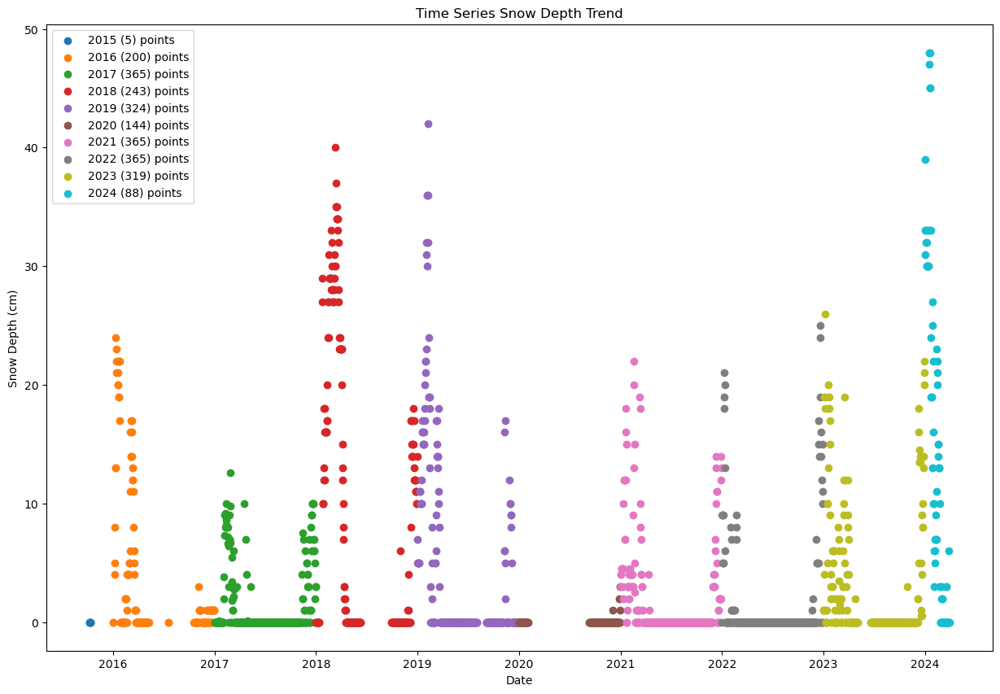

In [23]:
# Redraw the snow depth after some fillna
scatter_snow_depth_timeseries(dataset_copied, 'images/snow_depth_missing_values_filled_from_MET.png')

### Let's count and draw the missing values from 2016 - 2024 based on months to see if the snow depth is missing for non-winter seasons

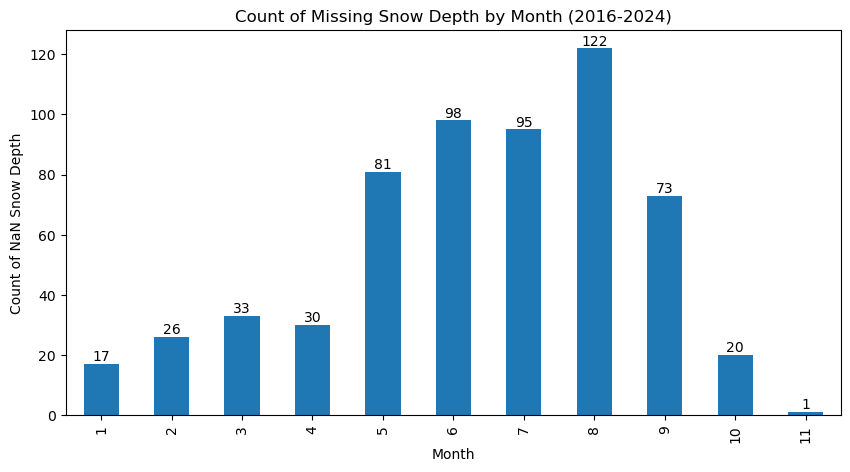

In [24]:
# Filter the dataframe to select rows for years 2016 to 2024 because the snow depth before 2016 is completely missing.
filtered_data = dataset_copied[(dataset_copied['year'] >= 2016) & (dataset_copied['year'] <= 2024)]

# Further filter the dataframe to select rows where snow_depth_cm is NaN
nan_snow_depth = filtered_data[filtered_data['snow_depth_cm'].isna()]

# Group by year and month and count NaN occurrences
nan_snow_depth_counts = nan_snow_depth.groupby(['year', 'month']).size().unstack(fill_value=0)

# Sum the counts across years to get the total missing values for each month
nan_snow_depth_counts_by_month = nan_snow_depth_counts.sum(axis=0)

# Define the plot
fig, ax = plt.subplots(figsize=(10, 5))

# Plotting the bar graph
nan_snow_depth_counts_by_month.plot(kind='bar', ax=ax)

# Annotating each bar with its count value
for i, count in enumerate(nan_snow_depth_counts_by_month):
    ax.text(i, count, str(count), ha='center', va='bottom')

# Setting labels and title
ax.set_xlabel('Month')
ax.set_ylabel('Count of NaN Snow Depth')
ax.set_title('Count of Missing Snow Depth by Month (2016-2024)')

# Save the figure to a file (e.g., PNG, PDF, etc.)
plt.savefig('images/snow_depth_missing_count_by_month.png')  # Save as PNG format

# Displaying the plot
plt.show()

### Define a helper function that is used to do the following:
##### 1. Fill missing values for each month of the year with the mean value of that month for the same year.
##### 2. For months where the mean value is NaN (i.e., all values for that month in the same year are NaN), fill missing values with the mean value of that month across all other years. 

### Define helper function that takes mean value of the same day and month across all years

In [25]:
# Define a generic function that is used for filling missing values different columns
def fill_missing_values_by_mean_day(row_data, dataset_passed, column_name):
    """
    Fill missing values for a specified column based on conditions.
    
    Parameters:
        row_data (pandas.Series): A single row_data of the DataFrame.
        dataset (pandas.DataFrame): The DataFrame containing the dataset.
        column_name (str): The name of the column to fill missing values for.
    
    Returns:
        float: The filled value for the specified column.
    """
    if pd.isna(row_data[column_name]):
        # Extract year and month from the current row_data
        year = row_data['year']
        month = row_data['month']
        day = row_data['day']
        
        # Check if there are any non-NaN values for the same month and year
        same_month_day = dataset_passed[(dataset_passed['day'] == day) & (dataset_passed['month'] == month)]
        valid_day_values = same_month_day.dropna(subset=[column_name])
        # Check if there are any non-NaN values for the same month and year
        same_month_year = dataset_passed[(dataset_passed['year'] == year) & (dataset_passed['month'] == month)]
        valid_month_values = same_month_year.dropna(subset=[column_name])
        
        if not valid_day_values.empty:
            # Calculate the mean of non-NaN values for the same month and year
            mean_values = valid_day_values[column_name].mean()
        elif not valid_month_values.empty:            
            mean_values = valid_month_values[column_name].mean()
        else:
            # Calculate the mean of non-NaN values for the same month in other years
            other_years = dataset_passed[(dataset_passed['month'] == month)]
            other_years_valid_value = other_years.dropna(subset=[column_name])
            mean_values = other_years_valid_value[column_name].mean()
        
        return mean_values
    else:
        # If the value is not NaN, return the original value
        return row_data[column_name]

def fill_missing_by_daily_mean(column_name, dataset_passed):
    dataset_passed[column_name] = dataset_passed.apply(lambda row_data: fill_missing_values_by_mean_day(row_data, dataset_passed, column_name), axis=1)

### Fill missing values of all features using the daily mean above helper function

In [26]:
%%time
# Fill the missing values for all features by the monthly mean of that specific year or mean value of that month across all other years if the month of that specific year is NaN
fill_missing_by_daily_mean("evaporation_mm", dataset_copied)
fill_missing_by_daily_mean("ST2", dataset_copied)
fill_missing_by_daily_mean("ST5", dataset_copied)
fill_missing_by_daily_mean("ST10", dataset_copied)
fill_missing_by_daily_mean("ST20", dataset_copied)
fill_missing_by_daily_mean("ST50", dataset_copied)
fill_missing_by_daily_mean("ST100", dataset_copied)
fill_missing_by_daily_mean("relative_humidity", dataset_copied)
fill_missing_by_daily_mean("air_pressure_2m_mbar", dataset_copied)
fill_missing_by_daily_mean("radiation_balance_w_m2", dataset_copied)
fill_missing_by_daily_mean("albedo_RR_GR", dataset_copied)
fill_missing_by_daily_mean("earth_heat_flux_MJ_m2", dataset_copied)
fill_missing_by_daily_mean("precipitation_mm", dataset_copied)
fill_missing_by_daily_mean("snow_depth_cm", dataset_copied)
fill_missing_by_daily_mean("phosynthetic_active_radiation_mE_m2", dataset_copied)

CPU times: total: 19.5 s
Wall time: 36 s


In [27]:
dataset_copied.isna().sum()

ID                                     0
date                                   0
mean_air_temperature_2m                0
min_air_temperature_2m                 0
max_air_temperature_2m                 0
relative_humidity                      0
air_pressure_2m_mbar                   0
precipitation_mm                       0
evaporation_mm                         0
earth_heat_flux_MJ_m2                  0
radiation_balance_w_m2                 0
phosynthetic_active_radiation_mE_m2    0
albedo_RR_GR                           0
snow_depth_cm                          0
ST2                                    0
ST5                                    0
ST10                                   0
ST20                                   0
ST50                                   0
ST100                                  0
year                                   0
month                                  0
day                                    0
dtype: int64

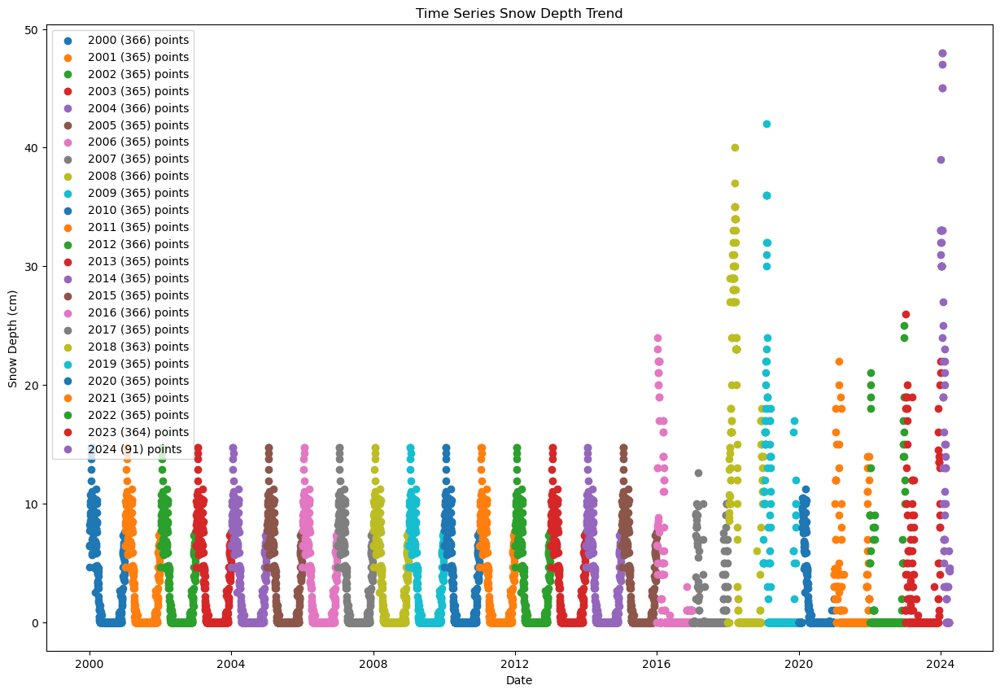

In [32]:
scatter_snow_depth_timeseries(dataset_copied, 'images/snow_depth_with_all_missing_values_filled.png')

# Timeseries soil temperature prediction

In [ ]:
# import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor, HistGradientBoostingRegressor
from xgboost import XGBRegressor
from catboost import CatBoostRegressor
from sklearn.ensemble import StackingRegressor
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import RidgeCV


dataset_time_series_copied = dataset_copied.copy()
# Change the date column to datetime format
dataset_time_series_copied['date'] = pd.to_datetime(dataset_time_series_copied['date'])

# Set the datetime column as the index
dataset_time_series_copied.set_index('date', inplace=True)

# Sort the data by the datetime index
dataset_time_series_copied = dataset_time_series_copied.sort_index()
dataset_time_series = dataset_time_series_copied.copy()
# Impute missing values (example: forward fill, you can use other methods as well)
dataset_time_series.ffill(inplace=True)

# Drop the original day, month, year columns
dataset_time_series.drop(columns=[ 'ID', 'ST5','ST10','ST20','ST50','ST100'], inplace=True)

# Check for missing dates and fill them with NaN
all_dates = pd.date_range(start=dataset_time_series.index.min(), end=dataset_time_series.index.max(), freq='D')
dataset_time_series = dataset_time_series.reindex(all_dates)


# Define the target column and the number of lags
target_column = 'ST2'
# Create daily lag features for the past 7 days
for lag in range(1, 8):
    dataset_time_series[f'{target_column}_lag_{lag}'] = dataset_time_series[target_column].shift(lag)

# Create monthly feature: average soil temperature for the past month
dataset_time_series[f'{target_column}_monthly_avg'] = dataset_time_series[target_column].rolling(window=30).mean().shift(1)

# Create annual feature: average soil temperature for the same month in the previous year
dataset_time_series[f'{target_column}_prev_year'] = dataset_time_series[target_column].shift(365)

# Create multi-year feature: average soil temperature for the same month over the past 5 years
for year in range(1, 6):
    dataset_time_series[f'{target_column}_prev_year_{year}'] = dataset_time_series[target_column].shift(365 * year)
dataset_time_series[f'{target_column}_5yr_avg'] = dataset_time_series[[f'{target_column}_prev_year_{year}' for year in range(1, 6)]].mean(axis=1)

# Drop rows with NaN values after creating lagged features
dataset_time_series.dropna(inplace=True)

# Define the feature columns
feature_columns = [col for col in dataset_time_series.columns if col != target_column]

# Prepare the feature matrix (X) and target vector (y)
X = dataset_time_series[feature_columns]
y = dataset_time_series[target_column]

# Split the data into training and testing sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)


rf = RandomForestRegressor(n_estimators=100, random_state=42)
xgb = XGBRegressor(n_estimators=100, random_state=42)
cat = CatBoostRegressor(n_estimators=100, random_state=42, verbose=0)
hgb = HistGradientBoostingRegressor(random_state=42)

# Define the Stacking Regressor
estimators = [
    ('rf', rf),
    ('xgb', xgb),
    ('cat', cat),
    ('hgb', hgb)
]

stacking_regressor = StackingRegressor(estimators=estimators, final_estimator=RidgeCV())

# Train and evaluate each model
models = {
    'RandomForest': rf,
    'XGBoost': xgb,
    'CatBoost': cat,
    'HistGradientBoosting': hgb,
    'StackingRegressor': stacking_regressor
}

for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    print(f'{name} RMSE: {rmse:.4f}')

## Cross-validation on the time-series prediction for each model

### For Soil Temperature ST2 at 2cm depth

RandomForest 10-Fold CV RMSE Scores: ['0.3875', '0.4545', '0.4092', '0.3744', '0.4047', '0.6268', '0.4575', '0.4161', '0.3315', '0.3617']
RandomForest 10-Fold CV RMSE: 0.4224 ± 0.0775
XGBoost 10-Fold CV RMSE Scores: ['0.3709', '0.3983', '0.4141', '0.3970', '0.3952', '0.6556', '0.4429', '0.4265', '0.3256', '0.3855']
XGBoost 10-Fold CV RMSE: 0.4212 ± 0.0838
CatBoost 10-Fold CV RMSE Scores: ['0.3835', '0.4002', '0.5013', '0.4022', '0.4504', '0.6608', '0.4760', '0.4407', '0.3900', '0.4428']
CatBoost 10-Fold CV RMSE: 0.4548 ± 0.0777
HistGradientBoosting 10-Fold CV RMSE Scores: ['0.3442', '0.3837', '0.4118', '0.3473', '0.3724', '0.6437', '0.4115', '0.3839', '0.2957', '0.3527']
HistGradientBoosting 10-Fold CV RMSE: 0.3947 ± 0.0893
StackingRegressor 10-Fold CV RMSE Scores: ['0.3387', '0.3708', '0.4038', '0.3435', '0.3679', '0.6178', '0.3956', '0.3811', '0.2878', '0.3387']
StackingRegressor 10-Fold CV RMSE: 0.3846 ± 0.0840


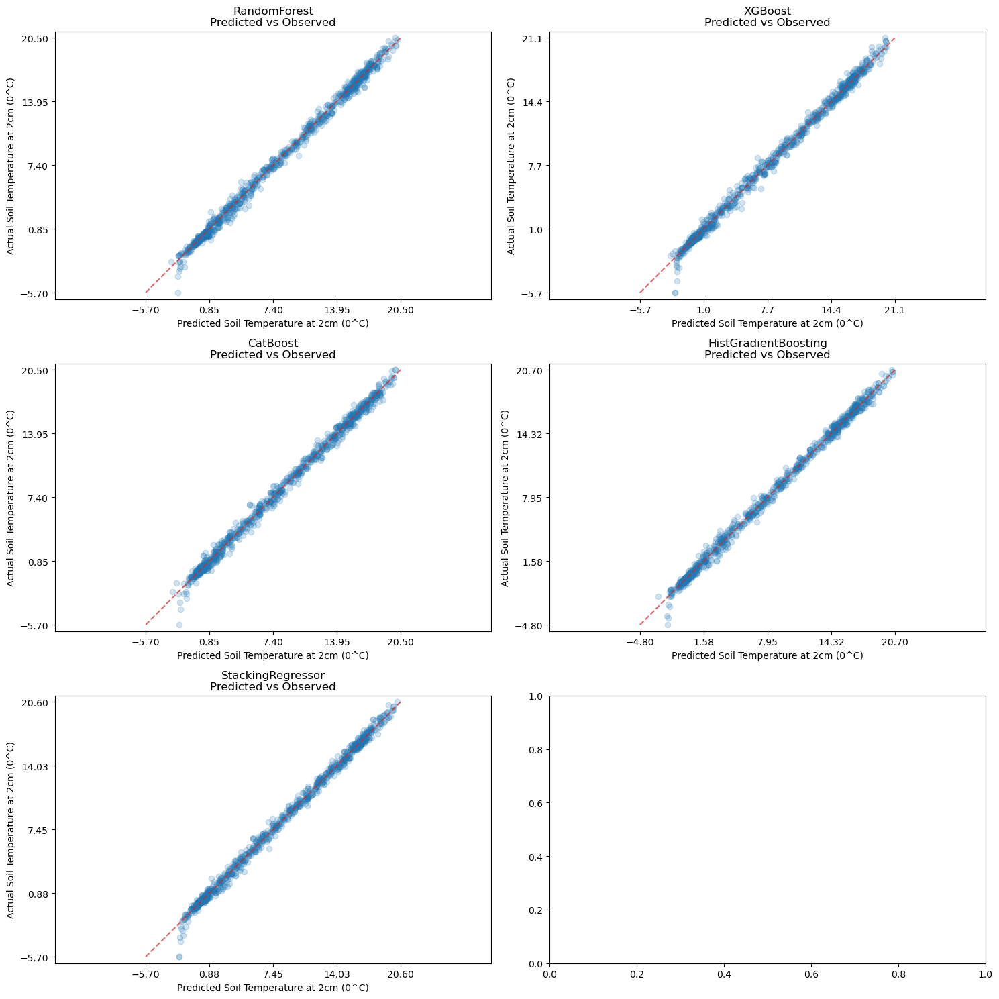

RandomForest Test RMSE: 0.3490
XGBoost Test RMSE: 0.3430
CatBoost Test RMSE: 0.3714
HistGradientBoosting Test RMSE: 0.3077
StackingRegressor Test RMSE: 0.3069


In [49]:
from sklearn.model_selection import cross_val_score, KFold
from sklearn.model_selection import cross_val_score, KFold, cross_val_predict, cross_validate
from sklearn.metrics import mean_squared_error, PredictionErrorDisplay
import matplotlib.pyplot as plt
import time
# Create a dataset copy and preprocess as before
dataset_time_series_copied = dataset_copied.copy()
dataset_time_series_copied['date'] = pd.to_datetime(dataset_time_series_copied['date'])
dataset_time_series_copied.set_index('date', inplace=True)
dataset_time_series_copied = dataset_time_series_copied.sort_index()
dataset_time_series = dataset_time_series_copied.copy()
dataset_time_series.ffill(inplace=True)
dataset_time_series.drop(columns=['ID', 'ST5', 'ST10', 'ST20', 'ST50', 'ST100'], inplace=True)
all_dates = pd.date_range(start=dataset_time_series.index.min(), end=dataset_time_series.index.max(), freq='D')
dataset_time_series = dataset_time_series.reindex(all_dates)

target_column = 'ST2'
for lag in range(1, 8):
    dataset_time_series[f'{target_column}_lag_{lag}'] = dataset_time_series[target_column].shift(lag)
dataset_time_series[f'{target_column}_monthly_avg'] = dataset_time_series[target_column].rolling(window=30).mean().shift(1)
dataset_time_series[f'{target_column}_prev_year'] = dataset_time_series[target_column].shift(365)
for year in range(1, 6):
    dataset_time_series[f'{target_column}_prev_year_{year}'] = dataset_time_series[target_column].shift(365 * year)
dataset_time_series[f'{target_column}_5yr_avg'] = dataset_time_series[[f'{target_column}_prev_year_{year}' for year in range(1, 6)]].mean(axis=1)
dataset_time_series.dropna(inplace=True)

feature_columns = [col for col in dataset_time_series.columns if col != target_column]
X = dataset_time_series[feature_columns]
y = dataset_time_series[target_column]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Initialize models
rf = RandomForestRegressor(n_estimators=100, random_state=42)
xgb = XGBRegressor(n_estimators=100, random_state=42)
cat = CatBoostRegressor(n_estimators=100, random_state=42, verbose=0)
hgb = HistGradientBoostingRegressor(random_state=42)

estimators = [
    ('rf', rf),
    ('xgb', xgb),
    ('cat', cat),
    ('hgb', hgb)
]

stacking_regressor = StackingRegressor(estimators=estimators, final_estimator=RidgeCV())

models = {
    'RandomForest': rf,
    'XGBoost': xgb,
    'CatBoost': cat,
    'HistGradientBoosting': hgb,
    'StackingRegressor': stacking_regressor
}

# Perform 10-fold cross-validation and plotting
kf = KFold(n_splits=10, shuffle=False)

fig, axs = plt.subplots(3, 2, figsize=(15, 15))
axs = np.ravel(axs)

for ax, (name, model) in zip(axs, models.items()):
    scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='neg_mean_squared_error')
    rmse_scores = np.sqrt(-scores)
    print(f'{name} 10-Fold CV RMSE Scores: {[f"{score:.4f}" for score in rmse_scores]}')
    print(f'{name} 10-Fold CV RMSE: {rmse_scores.mean():.4f} ± {rmse_scores.std():.4f}')
    
    # Cross-validated predictions
    y_pred = cross_val_predict(model, X_train, y_train, cv=kf, n_jobs=-1)
    
    # Plot predicted vs observed
    display = PredictionErrorDisplay.from_predictions(
        y_true=y_train,
        y_pred=y_pred,
        kind="actual_vs_predicted",
        ax=ax,
        scatter_kwargs={"alpha": 0.2, "color": "tab:blue"},
        line_kwargs={"color": "tab:red"},
    )
    ax.set_title(f"{name}\nPredicted vs Observed")
    ax.set_xlabel("Predicted Soil Temperature at 2cm (0^C)")
    ax.set_ylabel("Actual Soil Temperature at 2cm (0^C)")

plt.tight_layout()
plt.show()

# Train and evaluate on the test set
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    print(f'{name} Test RMSE: {rmse:.4f}')

### For Soil Temperature ST5 at 5cm depth

In [33]:
from sklearn.model_selection import cross_val_score, KFold
# Create a dataset copy and preprocess as before
dataset_time_series_copied = dataset_copied.copy()
dataset_time_series_copied['date'] = pd.to_datetime(dataset_time_series_copied['date'])
dataset_time_series_copied.set_index('date', inplace=True)
dataset_time_series_copied = dataset_time_series_copied.sort_index()
dataset_time_series = dataset_time_series_copied.copy()
dataset_time_series.ffill(inplace=True)
dataset_time_series.drop(columns=['ID', 'ST10', 'ST20', 'ST50', 'ST100'], inplace=True)
all_dates = pd.date_range(start=dataset_time_series.index.min(), end=dataset_time_series.index.max(), freq='D')
dataset_time_series = dataset_time_series.reindex(all_dates)

target_column = 'ST5'
for lag in range(1, 8):
    dataset_time_series[f'{target_column}_lag_{lag}'] = dataset_time_series[target_column].shift(lag)
dataset_time_series[f'{target_column}_monthly_avg'] = dataset_time_series[target_column].rolling(window=30).mean().shift(1)
dataset_time_series[f'{target_column}_prev_year'] = dataset_time_series[target_column].shift(365)
for year in range(1, 6):
    dataset_time_series[f'{target_column}_prev_year_{year}'] = dataset_time_series[target_column].shift(365 * year)
dataset_time_series[f'{target_column}_5yr_avg'] = dataset_time_series[[f'{target_column}_prev_year_{year}' for year in range(1, 6)]].mean(axis=1)
dataset_time_series.dropna(inplace=True)

feature_columns = [col for col in dataset_time_series.columns if col != target_column]
X = dataset_time_series[feature_columns]
y = dataset_time_series[target_column]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Initialize models
rf = RandomForestRegressor(n_estimators=100, random_state=42)
xgb = XGBRegressor(n_estimators=100, random_state=42)
cat = CatBoostRegressor(n_estimators=100, random_state=42, verbose=0)
hgb = HistGradientBoostingRegressor(random_state=42)

estimators = [
    ('rf', rf),
    ('xgb', xgb),
    ('cat', cat),
    ('hgb', hgb)
]

stacking_regressor = StackingRegressor(estimators=estimators, final_estimator=RidgeCV())

models = {
    'RandomForest': rf,
    'XGBoost': xgb,
    'CatBoost': cat,
    'HistGradientBoosting': hgb,
    'StackingRegressor': stacking_regressor
}

# Perform 10-fold cross-validation
kf = KFold(n_splits=10, shuffle=False)

for name, model in models.items():
    scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='neg_mean_squared_error')
    rmse_scores = np.sqrt(-scores)
    print(f'{name} 10-Fold CV RMSE Scores: {[f"{score:.4f}" for score in rmse_scores]}')
    print(f'{name} 10-Fold CV RMSE: {rmse_scores.mean():.4f} ± {rmse_scores.std():.4f}')

# Train and evaluate on the test set
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    print(f'{name} Test RMSE: {rmse:.4f}')


RandomForest 10-Fold CV RMSE Scores: ['0.1098', '0.0953', '0.0979', '0.0882', '0.0956', '0.3788', '0.1496', '0.1301', '0.0891', '0.0972']
RandomForest 10-Fold CV RMSE: 0.1332 ± 0.0840
XGBoost 10-Fold CV RMSE Scores: ['0.1140', '0.1134', '0.1064', '0.1019', '0.1086', '0.4732', '0.1654', '0.1244', '0.1035', '0.1247']
XGBoost 10-Fold CV RMSE: 0.1536 ± 0.1080
CatBoost 10-Fold CV RMSE Scores: ['0.2090', '0.2239', '0.2520', '0.1944', '0.1959', '0.4603', '0.2349', '0.2683', '0.1766', '0.2476']
CatBoost 10-Fold CV RMSE: 0.2463 ± 0.0764
HistGradientBoosting 10-Fold CV RMSE Scores: ['0.0874', '0.0980', '0.0947', '0.0862', '0.1008', '0.4855', '0.1568', '0.1190', '0.0794', '0.0956']
HistGradientBoosting 10-Fold CV RMSE: 0.1403 ± 0.1169
StackingRegressor 10-Fold CV RMSE Scores: ['0.1122', '0.1031', '0.0912', '0.0927', '0.0942', '0.4292', '0.1443', '0.1175', '0.0780', '0.0890']
StackingRegressor 10-Fold CV RMSE: 0.1351 ± 0.0996
RandomForest Test RMSE: 0.0901
XGBoost Test RMSE: 0.1126
CatBoost Test R

### For Soil Temperature ST10 at 10cm depth

In [34]:
from sklearn.model_selection import cross_val_score, KFold
# Create a dataset copy and preprocess as before
dataset_time_series_copied = dataset_copied.copy()
dataset_time_series_copied['date'] = pd.to_datetime(dataset_time_series_copied['date'])
dataset_time_series_copied.set_index('date', inplace=True)
dataset_time_series_copied = dataset_time_series_copied.sort_index()
dataset_time_series = dataset_time_series_copied.copy()
dataset_time_series.ffill(inplace=True)
dataset_time_series.drop(columns=['ID', 'ST20', 'ST50', 'ST100'], inplace=True)
all_dates = pd.date_range(start=dataset_time_series.index.min(), end=dataset_time_series.index.max(), freq='D')
dataset_time_series = dataset_time_series.reindex(all_dates)

target_column = 'ST10'
for lag in range(1, 8):
    dataset_time_series[f'{target_column}_lag_{lag}'] = dataset_time_series[target_column].shift(lag)
dataset_time_series[f'{target_column}_monthly_avg'] = dataset_time_series[target_column].rolling(window=30).mean().shift(1)
dataset_time_series[f'{target_column}_prev_year'] = dataset_time_series[target_column].shift(365)
for year in range(1, 6):
    dataset_time_series[f'{target_column}_prev_year_{year}'] = dataset_time_series[target_column].shift(365 * year)
dataset_time_series[f'{target_column}_5yr_avg'] = dataset_time_series[[f'{target_column}_prev_year_{year}' for year in range(1, 6)]].mean(axis=1)
dataset_time_series.dropna(inplace=True)

feature_columns = [col for col in dataset_time_series.columns if col != target_column]
X = dataset_time_series[feature_columns]
y = dataset_time_series[target_column]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Initialize models
rf = RandomForestRegressor(n_estimators=100, random_state=42)
xgb = XGBRegressor(n_estimators=100, random_state=42)
cat = CatBoostRegressor(n_estimators=100, random_state=42, verbose=0)
hgb = HistGradientBoostingRegressor(random_state=42)

estimators = [
    ('rf', rf),
    ('xgb', xgb),
    ('cat', cat),
    ('hgb', hgb)
]

stacking_regressor = StackingRegressor(estimators=estimators, final_estimator=RidgeCV())

models = {
    'RandomForest': rf,
    'XGBoost': xgb,
    'CatBoost': cat,
    'HistGradientBoosting': hgb,
    'StackingRegressor': stacking_regressor
}

# Perform 10-fold cross-validation
kf = KFold(n_splits=10, shuffle=False)

for name, model in models.items():
    scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='neg_mean_squared_error')
    rmse_scores = np.sqrt(-scores)
    print(f'{name} 10-Fold CV RMSE Scores: {[f"{score:.4f}" for score in rmse_scores]}')
    print(f'{name} 10-Fold CV RMSE: {rmse_scores.mean():.4f} ± {rmse_scores.std():.4f}')

# Train and evaluate on the test set
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    print(f'{name} Test RMSE: {rmse:.4f}')


RandomForest 10-Fold CV RMSE Scores: ['0.1078', '0.1123', '0.1052', '0.1074', '0.2020', '0.4168', '0.1845', '0.1631', '0.1469', '0.2508']
RandomForest 10-Fold CV RMSE: 0.1797 ± 0.0914
XGBoost 10-Fold CV RMSE Scores: ['0.1107', '0.1239', '0.1183', '0.1757', '0.2025', '0.5062', '0.1771', '0.1620', '0.1218', '0.2566']
XGBoost 10-Fold CV RMSE: 0.1955 ± 0.1122
CatBoost 10-Fold CV RMSE Scores: ['0.1818', '0.2328', '0.2017', '0.2402', '0.2438', '0.4616', '0.1961', '0.1954', '0.2091', '0.2928']
CatBoost 10-Fold CV RMSE: 0.2455 ± 0.0783
HistGradientBoosting 10-Fold CV RMSE Scores: ['0.0934', '0.1010', '0.0991', '0.0965', '0.2038', '0.5111', '0.1456', '0.1359', '0.1071', '0.2418']
HistGradientBoosting 10-Fold CV RMSE: 0.1735 ± 0.1222
StackingRegressor 10-Fold CV RMSE Scores: ['0.1081', '0.1088', '0.0964', '0.1052', '0.1941', '0.4713', '0.1495', '0.1284', '0.1039', '0.2446']
StackingRegressor 10-Fold CV RMSE: 0.1710 ± 0.1099
RandomForest Test RMSE: 0.2935
XGBoost Test RMSE: 0.2849
CatBoost Test R

### For Soil Temperature ST20 at 20cm depth

In [35]:
from sklearn.model_selection import cross_val_score, KFold
# Create a dataset copy and preprocess as before
dataset_time_series_copied = dataset_copied.copy()
dataset_time_series_copied['date'] = pd.to_datetime(dataset_time_series_copied['date'])
dataset_time_series_copied.set_index('date', inplace=True)
dataset_time_series_copied = dataset_time_series_copied.sort_index()
dataset_time_series = dataset_time_series_copied.copy()
dataset_time_series.ffill(inplace=True)
dataset_time_series.drop(columns=['ID', 'ST50', 'ST100'], inplace=True)
all_dates = pd.date_range(start=dataset_time_series.index.min(), end=dataset_time_series.index.max(), freq='D')
dataset_time_series = dataset_time_series.reindex(all_dates)

target_column = 'ST20'
for lag in range(1, 8):
    dataset_time_series[f'{target_column}_lag_{lag}'] = dataset_time_series[target_column].shift(lag)
dataset_time_series[f'{target_column}_monthly_avg'] = dataset_time_series[target_column].rolling(window=30).mean().shift(1)
dataset_time_series[f'{target_column}_prev_year'] = dataset_time_series[target_column].shift(365)
for year in range(1, 6):
    dataset_time_series[f'{target_column}_prev_year_{year}'] = dataset_time_series[target_column].shift(365 * year)
dataset_time_series[f'{target_column}_5yr_avg'] = dataset_time_series[[f'{target_column}_prev_year_{year}' for year in range(1, 6)]].mean(axis=1)
dataset_time_series.dropna(inplace=True)

feature_columns = [col for col in dataset_time_series.columns if col != target_column]
X = dataset_time_series[feature_columns]
y = dataset_time_series[target_column]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Initialize models
rf = RandomForestRegressor(n_estimators=100, random_state=42)
xgb = XGBRegressor(n_estimators=100, random_state=42)
cat = CatBoostRegressor(n_estimators=100, random_state=42, verbose=0)
hgb = HistGradientBoostingRegressor(random_state=42)

estimators = [
    ('rf', rf),
    ('xgb', xgb),
    ('cat', cat),
    ('hgb', hgb)
]

stacking_regressor = StackingRegressor(estimators=estimators, final_estimator=RidgeCV())

models = {
    'RandomForest': rf,
    'XGBoost': xgb,
    'CatBoost': cat,
    'HistGradientBoosting': hgb,
    'StackingRegressor': stacking_regressor
}

# Perform 10-fold cross-validation
kf = KFold(n_splits=10, shuffle=False)

for name, model in models.items():
    scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='neg_mean_squared_error')
    rmse_scores = np.sqrt(-scores)
    print(f'{name} 10-Fold CV RMSE Scores: {[f"{score:.4f}" for score in rmse_scores]}')
    print(f'{name} 10-Fold CV RMSE: {rmse_scores.mean():.4f} ± {rmse_scores.std():.4f}')

# Train and evaluate on the test set
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    print(f'{name} Test RMSE: {rmse:.4f}')


RandomForest 10-Fold CV RMSE Scores: ['0.1391', '0.1619', '0.1307', '0.1413', '0.5314', '0.4654', '0.1504', '0.1206', '0.1214', '0.1757']
RandomForest 10-Fold CV RMSE: 0.2138 ± 0.1440
XGBoost 10-Fold CV RMSE Scores: ['0.1675', '0.1603', '0.1414', '0.1442', '0.5582', '0.5421', '0.2100', '0.1410', '0.1244', '0.1797']
XGBoost 10-Fold CV RMSE: 0.2369 ± 0.1583
CatBoost 10-Fold CV RMSE Scores: ['0.1835', '0.2086', '0.1933', '0.1978', '0.6310', '0.6555', '0.2697', '0.1926', '0.1921', '0.2209']
CatBoost 10-Fold CV RMSE: 0.2945 ± 0.1760
HistGradientBoosting 10-Fold CV RMSE Scores: ['0.1367', '0.1388', '0.1277', '0.1427', '0.5544', '0.5019', '0.1499', '0.1264', '0.1124', '0.1576']
HistGradientBoosting 10-Fold CV RMSE: 0.2148 ± 0.1576
StackingRegressor 10-Fold CV RMSE Scores: ['0.1324', '0.1409', '0.1220', '0.1356', '0.5595', '0.4824', '0.1397', '0.1113', '0.1111', '0.1625']
StackingRegressor 10-Fold CV RMSE: 0.2098 ± 0.1572
RandomForest Test RMSE: 0.1467
XGBoost Test RMSE: 0.1799
CatBoost Test R

### For Soil Temperature ST50 at 50cm depth

In [48]:
from sklearn.model_selection import cross_val_score, KFold
# Create a dataset copy and preprocess as before
dataset_time_series_copied = dataset_copied.copy()
dataset_time_series_copied['date'] = pd.to_datetime(dataset_time_series_copied['date'])
dataset_time_series_copied.set_index('date', inplace=True)
dataset_time_series_copied = dataset_time_series_copied.sort_index()
dataset_time_series = dataset_time_series_copied.copy()
dataset_time_series.ffill(inplace=True)
dataset_time_series.drop(columns=['ID', 'ST20','ST100'], inplace=True)
all_dates = pd.date_range(start=dataset_time_series.index.min(), end=dataset_time_series.index.max(), freq='D')
dataset_time_series = dataset_time_series.reindex(all_dates)

target_column = 'ST50'
for lag in range(1, 8):
    dataset_time_series[f'{target_column}_lag_{lag}'] = dataset_time_series[target_column].shift(lag)
dataset_time_series[f'{target_column}_monthly_avg'] = dataset_time_series[target_column].rolling(window=30).mean().shift(1)
dataset_time_series[f'{target_column}_prev_year'] = dataset_time_series[target_column].shift(365)
for year in range(1, 6):
    dataset_time_series[f'{target_column}_prev_year_{year}'] = dataset_time_series[target_column].shift(365 * year)
dataset_time_series[f'{target_column}_5yr_avg'] = dataset_time_series[[f'{target_column}_prev_year_{year}' for year in range(1, 6)]].mean(axis=1)
dataset_time_series.dropna(inplace=True)

feature_columns = [col for col in dataset_time_series.columns if col != target_column]
X = dataset_time_series[feature_columns]
y = dataset_time_series[target_column]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Initialize models
rf = RandomForestRegressor(n_estimators=100, random_state=42)
xgb = XGBRegressor(n_estimators=100, random_state=42)
cat = CatBoostRegressor(n_estimators=100, random_state=42, verbose=0)
hgb = HistGradientBoostingRegressor(random_state=42)

estimators = [
    ('rf', rf),
    ('xgb', xgb),
    ('cat', cat),
    ('hgb', hgb)
]

stacking_regressor = StackingRegressor(estimators=estimators, final_estimator=RidgeCV())

models = {
    'RandomForest': rf,
    'XGBoost': xgb,
    'CatBoost': cat,
    'HistGradientBoosting': hgb,
    'StackingRegressor': stacking_regressor
}

# Perform 10-fold cross-validation
kf = KFold(n_splits=10, shuffle=False)

for name, model in models.items():
    scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='neg_mean_squared_error')
    rmse_scores = np.sqrt(-scores)
    print(f'{name} 10-Fold CV RMSE Scores: {[f"{score:.4f}" for score in rmse_scores]}')
    print(f'{name} 10-Fold CV RMSE: {rmse_scores.mean():.4f} ± {rmse_scores.std():.4f}')

# Train and evaluate on the test set
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    print(f'{name} Test RMSE: {rmse:.4f}')


RandomForest 10-Fold CV RMSE Scores: ['0.2166', '0.5482', '0.1539', '0.1963', '0.5162', '0.5798', '0.2191', '0.8681', '2.4400', '0.2045']
RandomForest 10-Fold CV RMSE: 0.5943 ± 0.6540
XGBoost 10-Fold CV RMSE Scores: ['0.2032', '0.7171', '0.1595', '0.1796', '0.6324', '0.8985', '0.3722', '0.4323', '2.4338', '0.2288']
XGBoost 10-Fold CV RMSE: 0.6257 ± 0.6486
CatBoost 10-Fold CV RMSE Scores: ['0.2669', '0.8330', '0.2513', '0.3585', '0.7253', '0.5211', '0.3344', '0.4862', '2.4847', '0.6847']
CatBoost 10-Fold CV RMSE: 0.6946 ± 0.6261
HistGradientBoosting 10-Fold CV RMSE Scores: ['0.2172', '0.2550', '0.1911', '0.2207', '0.4997', '0.3747', '0.2422', '0.3150', '2.4381', '0.3459']
HistGradientBoosting 10-Fold CV RMSE: 0.5100 ± 0.6487
StackingRegressor 10-Fold CV RMSE Scores: ['0.1921', '0.3103', '0.1726', '0.2054', '0.4876', '0.3748', '0.2308', '0.3502', '2.4344', '0.3214']
StackingRegressor 10-Fold CV RMSE: 0.5080 ± 0.6487
RandomForest Test RMSE: 1.8315
XGBoost Test RMSE: 1.6068
CatBoost Test R

### For Soil Temperature ST100 at 100cm depth

In [37]:
from sklearn.model_selection import cross_val_score, KFold
# Create a dataset copy and preprocess as before
dataset_time_series_copied = dataset_copied.copy()
dataset_time_series_copied['date'] = pd.to_datetime(dataset_time_series_copied['date'])
dataset_time_series_copied.set_index('date', inplace=True)
dataset_time_series_copied = dataset_time_series_copied.sort_index()
dataset_time_series = dataset_time_series_copied.copy()
dataset_time_series.ffill(inplace=True)
dataset_time_series.drop(columns=['ID'], inplace=True)
all_dates = pd.date_range(start=dataset_time_series.index.min(), end=dataset_time_series.index.max(), freq='D')
dataset_time_series = dataset_time_series.reindex(all_dates)

target_column = 'ST100'
for lag in range(1, 8):
    dataset_time_series[f'{target_column}_lag_{lag}'] = dataset_time_series[target_column].shift(lag)
dataset_time_series[f'{target_column}_monthly_avg'] = dataset_time_series[target_column].rolling(window=30).mean().shift(1)
dataset_time_series[f'{target_column}_prev_year'] = dataset_time_series[target_column].shift(365)
for year in range(1, 6):
    dataset_time_series[f'{target_column}_prev_year_{year}'] = dataset_time_series[target_column].shift(365 * year)
dataset_time_series[f'{target_column}_5yr_avg'] = dataset_time_series[[f'{target_column}_prev_year_{year}' for year in range(1, 6)]].mean(axis=1)
dataset_time_series.dropna(inplace=True)

feature_columns = [col for col in dataset_time_series.columns if col != target_column]
X = dataset_time_series[feature_columns]
y = dataset_time_series[target_column]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Initialize models
rf = RandomForestRegressor(n_estimators=100, random_state=42)
xgb = XGBRegressor(n_estimators=100, random_state=42)
cat = CatBoostRegressor(n_estimators=100, random_state=42, verbose=0)
hgb = HistGradientBoostingRegressor(random_state=42)

estimators = [
    ('rf', rf),
    ('xgb', xgb),
    ('cat', cat),
    ('hgb', hgb)
]

stacking_regressor = StackingRegressor(estimators=estimators, final_estimator=RidgeCV())

models = {
    'RandomForest': rf,
    'XGBoost': xgb,
    'CatBoost': cat,
    'HistGradientBoosting': hgb,
    'StackingRegressor': stacking_regressor
}

# Perform 10-fold cross-validation
kf = KFold(n_splits=10, shuffle=False)

for name, model in models.items():
    scores = cross_val_score(model, X_train, y_train, cv=kf, scoring='neg_mean_squared_error')
    rmse_scores = np.sqrt(-scores)
    print(f'{name} 10-Fold CV RMSE Scores: {[f"{score:.4f}" for score in rmse_scores]}')
    print(f'{name} 10-Fold CV RMSE: {rmse_scores.mean():.4f} ± {rmse_scores.std():.4f}')

# Train and evaluate on the test set
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    print(f'{name} Test RMSE: {rmse:.4f}')


RandomForest 10-Fold CV RMSE Scores: ['0.0636', '0.0741', '0.0663', '0.0713', '0.0937', '0.2658', '0.0651', '0.0824', '0.0561', '0.1033']
RandomForest 10-Fold CV RMSE: 0.0942 ± 0.0588
XGBoost 10-Fold CV RMSE Scores: ['0.0718', '0.0801', '0.0699', '0.0713', '0.1009', '0.2623', '0.0749', '0.0821', '0.0676', '0.0983']
XGBoost 10-Fold CV RMSE: 0.0979 ± 0.0559
CatBoost 10-Fold CV RMSE Scores: ['0.1742', '0.2310', '0.1615', '0.1583', '0.1951', '0.4233', '0.1996', '0.1620', '0.2139', '0.1871']
CatBoost 10-Fold CV RMSE: 0.2106 ± 0.0744
HistGradientBoosting 10-Fold CV RMSE Scores: ['0.0592', '0.0699', '0.0627', '0.0662', '0.0912', '0.2765', '0.0606', '0.0779', '0.0486', '0.0965']
HistGradientBoosting 10-Fold CV RMSE: 0.0909 ± 0.0634
StackingRegressor 10-Fold CV RMSE Scores: ['0.0630', '0.0718', '0.0631', '0.0691', '0.0910', '0.2706', '0.0682', '0.0789', '0.0567', '0.0997']
StackingRegressor 10-Fold CV RMSE: 0.0932 ± 0.0604
RandomForest Test RMSE: 0.1276
XGBoost Test RMSE: 0.1256
CatBoost Test R

### Visualize the fold with the worst performance

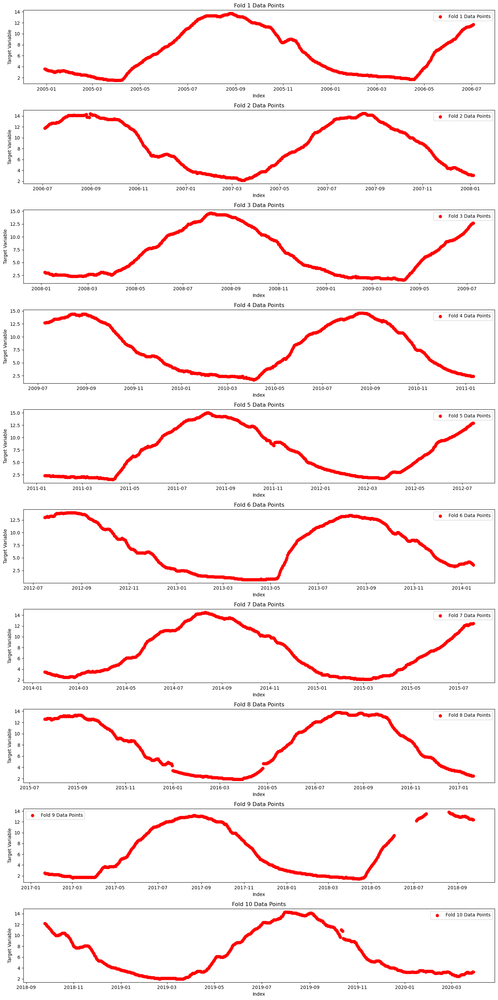

In [47]:
from sklearn.model_selection import KFold
import matplotlib.pyplot as plt

# # Initialize KFold
# kf = KFold(n_splits=10, shuffle=False)

# # Generate fold indices
# fold_indices = list(kf.split(X_train))

# # Get the indices of the sixth fold (index 5 because Python uses 0-based indexing)
# train_indices, test_indices = fold_indices[1]

# # Extract the sixth fold data
# X_train_fold_6 = X_train.iloc[test_indices]
# y_train_fold_6 = y_train.iloc[test_indices]

# # Print or visualize the data points in the sixth fold
# print("Indices of the sixth fold test set:")
# print(test_indices)

# print("Data points in the sixth fold test set:")
# print(X_train_fold_6)
# print(y_train_fold_6)

# # Visualize to inspect outliers (example using a scatter plot, adjust as needed)
# plt.figure(figsize=(10, 6))
# plt.scatter(X_train_fold_6.index, y_train_fold_6, label='Sixth Fold Data Points', color='red')
# plt.title('Sixth Fold Data Points')
# plt.xlabel('Index')
# plt.ylabel('Target Variable')
# plt.legend()
# plt.show()


# Initialize KFold
kf = KFold(n_splits=10, shuffle=False)

# Generate fold indices
fold_indices = list(kf.split(X_train))

# Set up the plot
plt.figure(figsize=(15, 30))
for fold, (train_indices, test_indices) in enumerate(fold_indices):
    # Extract the data for the current fold
    X_train_fold = X_train.iloc[test_indices]
    y_train_fold = y_train.iloc[test_indices]

    # Plot the data points for the current fold
    plt.subplot(10, 1, fold + 1)
    plt.scatter(X_train_fold.index, y_train_fold, label=f'Fold {fold + 1} Data Points', color='red')
    plt.title(f'Fold {fold + 1} Data Points')
    plt.xlabel('Index')
    plt.ylabel('Target Variable')
    plt.legend()

# Adjust layout for better visualization
plt.tight_layout()
plt.show()


In [41]:
from datetime import datetime
# Define the two dates
start_date = datetime.strptime('2012-07-16', '%Y-%m-%d')
end_date = datetime.strptime('2014-01-16', '%Y-%m-%d')

# Calculate the difference
difference = end_date - start_date

# Get the number of days
number_of_days = difference.days
number_of_days
X_train_fold_6.shape

(550, 35)

### Use IsolationForest to identify outliers and inliers
#### If there are no outliers the outlier prediction should return all 1 and if there are outliers it will return -1.
#### Identify the outliers using the Isolation Forest from the normalized dataset for ST2, ST5, ST10, ST20, ST50 and ST100

In [51]:
print('============================================= ST2 Outliers ========================================')
# Reset the index of the original outlier filtered DataFrame
dataset_normalized_outlier_filtered = dataset_normalized_outlier_filtered.reset_index(drop=True)
# Drop the target variable and unnecessary columns from the dataset that are not considered as features for target ST5
ST2_X_train_no_target_normalized = dataset_normalized_outlier_filtered.drop(columns=['ST2','ST5','ST10','ST20','ST50','ST100', 'month', 'day','ID'])
# Instantiate the IsolationForest model
ST2_isolation_forest_normalized = IsolationForest(random_state=42)
# Fit the IsolationForest model to your training dataset
ST2_isolation_forest_normalized.fit(ST2_X_train_no_target_normalized)
# Predict outliers in your dataset
ST2_outlier_preds_normalized = ST2_isolation_forest_normalized.predict(ST2_X_train_no_target_normalized)
if -1 in ST2_outlier_preds_normalized:
    print("Outliers detected.")
    # Get indices of outliers
    ST2_outlier_indices_normalized = np.where(ST2_outlier_preds_normalized == -1)[0]
    # Get the actual data points corresponding to outliers
    ST2_outliers_normalized = ST2_X_train_no_target_normalized.iloc[ST2_outlier_indices_normalized]
    ST2_clean_dataset_normalized = dataset_normalized_outlier_filtered.drop(ST2_outlier_indices_normalized)
    print('ST2 Outliers indices: ', len(ST2_outliers_normalized), ST2_outliers_normalized)
else:
    ST2_clean_dataset_normalized = dataset_normalized_outlier_filtered.copy()
    print("No outliers detected.")
ST2_IF_scores = ST2_isolation_forest_normalized.decision_function(ST2_X_train_no_target_normalized)
print("ST2 Scores: ", ST2_IF_scores)



print('============================================= ST5 Outliers ========================================')
# Drop the target variable and unnecessary columns from the dataset that are not considered as features for target ST5
ST5_X_train_no_target_normalized = dataset_normalized_outlier_filtered.drop(columns=['ST5','ST10','ST20','ST50','ST100', 'month', 'day','ID'])
# Instantiate the IsolationForest model
ST5_isolation_forest_normalized = IsolationForest(random_state=42)
# Fit the IsolationForest model to your training dataset
ST5_isolation_forest_normalized.fit(ST5_X_train_no_target_normalized)
# Predict outliers in your dataset
ST5_outlier_preds_normalized = ST5_isolation_forest_normalized.predict(ST5_X_train_no_target_normalized)
if -1 in ST5_outlier_preds_normalized:
    print("Outliers detected.")
    # Get indices of outliers
    ST5_outlier_indices_normalized = np.where(ST5_outlier_preds_normalized == -1)[0]
    # Get the actual data points corresponding to outliers
    ST5_outliers_normalized = ST5_X_train_no_target_normalized.iloc[ST5_outlier_indices_normalized]
    ST5_clean_dataset_normalized = dataset_normalized_outlier_filtered.drop(ST5_outlier_indices_normalized)
    print('ST5 Outliers indices: ', len(ST5_outliers_normalized), ST5_outliers_normalized)
else:
    ST5_clean_dataset_normalized = dataset_normalized_outlier_filtered.copy()
    print("No outliers detected.")
ST5_IF_scores = ST5_isolation_forest_normalized.decision_function(ST5_X_train_no_target_normalized)
print("ST5 Scores: ", ST5_IF_scores)

print('============================================= ST10 Outliers ========================================')
# Drop the target variable and unnecessary columns from the dataset that are not considered as features
ST10_X_train_no_target_normalized = dataset_normalized_outlier_filtered.drop(columns=['ST10','ST20','ST50','ST100', 'month', 'day','ID'])
# Instantiate the IsolationForest model
ST10_isolation_forest_normalized = IsolationForest(random_state=42)
# Fit the IsolationForest model to your training dataset
ST10_isolation_forest_normalized.fit(ST10_X_train_no_target_normalized)
# Predict outliers in your dataset
ST10_outlier_preds_normalized = ST10_isolation_forest_normalized.predict(ST10_X_train_no_target_normalized)
if -1 in ST10_outlier_preds_normalized:
    print("Outliers detected.")
    # Get indices of outliers
    ST10_outlier_indices_normalized = np.where(ST10_outlier_preds_normalized == -1)[0]
    # Get the actual data points corresponding to outliers
    ST10_outliers_normalized = ST10_X_train_no_target_normalized.iloc[ST10_outlier_indices_normalized]
    ST10_clean_dataset_normalized = dataset_normalized_outlier_filtered.drop(ST10_outlier_indices_normalized)
    print('ST10 Outliers indices: ', len(ST10_outliers_normalized), ST10_outliers_normalized)
else:
    ST10_clean_dataset_normalized = dataset_normalized_outlier_filtered.copy()
    print("No outliers detected.")
    
ST10_IF_scores = ST10_isolation_forest_normalized.decision_function(ST10_X_train_no_target_normalized)
print("SST10 Scores: ", ST10_IF_scores)

print('============================================= ST20 Outliers ========================================')
# Drop the target variable and unnecessary columns from the dataset that are not considered as features
ST20_X_train_no_target_normalized = dataset_normalized_outlier_filtered.drop(columns=['ST20','ST50','ST100', 'month', 'day','ID'])
# Instantiate the IsolationForest model
ST20_isolation_forest_normalized = IsolationForest(random_state=42)
# Fit the IsolationForest model to your training dataset
ST20_isolation_forest_normalized.fit(ST20_X_train_no_target_normalized)
# Predict outliers in your dataset
ST20_outlier_preds_normalized = ST20_isolation_forest_normalized.predict(ST20_X_train_no_target_normalized)
if -1 in ST20_outlier_preds_normalized:
    print("Outliers detected.")
    # Get indices of outliers
    ST20_outlier_indices_normalized = np.where(ST20_outlier_preds_normalized == -1)[0]
    # Get the actual data points corresponding to outliers
    ST20_outliers_normalized = ST20_X_train_no_target_normalized.iloc[ST20_outlier_indices_normalized]
    ST20_clean_dataset_normalized = dataset_normalized_outlier_filtered.drop(ST20_outlier_indices_normalized)
    print('ST20 Outliers indices: ', len(ST20_outliers_normalized), ST20_outliers_normalized)
else:
    ST20_clean_dataset_normalized = dataset_normalized_outlier_filtered.copy()
    print("No outliers detected.")

ST20_IF_scores = ST20_isolation_forest_normalized.decision_function(ST20_X_train_no_target_normalized)
print("ST20 Scores: ", ST20_IF_scores)

print('============================================= ST50 Outliers ========================================')
# Drop the target variable and unnecessary columns from the dataset that are not considered as features
ST50_X_train_no_target_normalized = dataset_normalized_outlier_filtered.drop(columns=['ST50','ST100', 'month', 'day','ID'])
# Instantiate the IsolationForest model
ST50_isolation_forest_normalized = IsolationForest(random_state=42)
# Fit the IsolationForest model to your training dataset
ST50_isolation_forest_normalized.fit(ST50_X_train_no_target_normalized)
# Predict outliers in your dataset
ST50_outlier_preds_normalized = ST50_isolation_forest_normalized.predict(ST50_X_train_no_target_normalized)
if -1 in ST50_outlier_preds_normalized:
    print("Outliers detected.")
    # Get indices of outliers
    ST50_outlier_indices_normalized = np.where(ST50_outlier_preds_normalized == -1)[0]
    # Get the actual data points corresponding to outliers
    ST50_outliers_normalized = ST50_X_train_no_target_normalized.iloc[ST50_outlier_indices_normalized]
    ST50_clean_dataset_normalized = dataset_normalized_outlier_filtered.drop(ST50_outlier_indices_normalized)
    print('ST50 Outliers indices: ', len(ST50_outliers_normalized), ST50_outliers_normalized)
else:
    ST50_clean_dataset_normalized = dataset_normalized_outlier_filtered.copy()
    print("No outliers detected.")

ST50_IF_scores = ST50_isolation_forest_normalized.decision_function(ST50_X_train_no_target_normalized)
print("ST50 Scores: ", ST50_IF_scores)

print('============================================= ST100 Outliers ========================================')
# Drop the target variable and unnecessary columns from the dataset that are not considered as features
ST100_X_train_no_target_normalized = dataset_normalized_outlier_filtered.drop(columns=['ST100', 'month', 'day','ID'])
# Instantiate the IsolationForest model
ST100_isolation_forest_normalized = IsolationForest(random_state=42)
# Fit the IsolationForest model to your training dataset
ST100_isolation_forest_normalized.fit(ST100_X_train_no_target_normalized)
# Predict outliers in your dataset
ST100_outlier_preds_normalized = ST100_isolation_forest_normalized.predict(ST100_X_train_no_target_normalized)
if -1 in ST100_outlier_preds_normalized:
    print("Outliers detected.")
    # Get indices of outliers
    ST100_outlier_indices_normalized = np.where(ST100_outlier_preds_normalized == -1)[0]
    # Get the actual data points corresponding to outliers
    ST100_outliers_normalized = ST100_X_train_no_target_normalized.iloc[ST100_outlier_indices_normalized]
    ST100_clean_dataset_normalized = dataset_normalized_outlier_filtered.drop(ST100_outlier_indices_normalized)
    print('ST100 Outliers indices: ', len(ST100_outliers_normalized), ST100_outliers_normalized)
else:
    ST100_clean_dataset_normalized = dataset_normalized_outlier_filtered.copy()
    print("No outliers detected.")

ST100_IF_scores = ST100_isolation_forest_normalized.decision_function(ST100_X_train_no_target_normalized)
print("ST100 Scores: ", ST100_IF_scores)

============================================= ST2 Outliers ========================================
Outliers detected.
ST2 Outliers indices:  886       mean_air_temperature_2m  min_air_temperature_2m  max_air_temperature_2m  \
17                  -2.170664               -2.348836               -1.859000   
23                  -0.793827               -0.870510               -0.730361   
38                  -0.793827               -0.513673               -0.764562   
44                  -1.674506               -1.991999               -0.935568   
55                  -0.855846               -0.679347               -0.935568   
...                       ...                     ...                     ...   
8207                -1.848161               -1.788092               -1.801998   
8208                -1.798546               -1.991999               -1.619591   
8209                -2.071432               -2.132185               -2.087007   
8210                -2.220279               

### Isolate outliers using Isolation Forest from the original denormalized dataset

In [54]:
print('============================================= ST2 Outliers ========================================')
# Reset the index of the original outlier filtered DataFrame
dataset_denormalized_outlier_filtered = dataset_denormalized_outlier_filtered.reset_index(drop=True)
# Drop the target variable and unnecessary columns from the dataset that are not considered as features for target ST5
ST2_X_train_no_target_denormalized = dataset_denormalized_outlier_filtered.drop(columns=['ST2','ST5','ST10','ST20','ST50','ST100', 'month', 'day','ID'])
# Instantiate the IsolationForest model
ST2_isolation_forest_denormalized = IsolationForest(random_state=42)
# Fit the IsolationForest model to your training dataset
ST2_isolation_forest_denormalized.fit(ST2_X_train_no_target_denormalized)
# Predict outliers in your dataset
ST2_outlier_preds_denormalized = ST2_isolation_forest_denormalized.predict(ST2_X_train_no_target_denormalized)
if -1 in ST2_outlier_preds_denormalized:
    print("Outliers detected.")
    # Get indices of outliers
    ST2_outlier_indices_denormalized = np.where(ST2_outlier_preds_denormalized == -1)[0]
    # Get the actual data points corresponding to outliers
    ST2_outliers_denormalized = ST2_X_train_no_target_denormalized.iloc[ST2_outlier_indices_denormalized]
    ST2_clean_dataset_denormalized = dataset_denormalized_outlier_filtered.drop(ST2_outlier_indices_denormalized)
    print('ST2 Outliers indices: ', len(ST2_outliers_denormalized), ST2_outliers_denormalized)
else:
    ST2_clean_dataset_denormalized = dataset_denormalized_outlier_filtered.copy()
    print("No outliers detected.")
ST2_IF_scores = ST2_isolation_forest_denormalized.decision_function(ST2_X_train_no_target_denormalized)
print("ST2 Scores: ", ST2_IF_scores)

ST2_clean_dataset_denormalized = ST2_clean_dataset_denormalized.reset_index(drop=True)
print('============================================= ST5 Outliers ========================================')
# Drop the target variable and unnecessary columns from the dataset that are not considered as features for target ST5
ST5_X_train_no_target_denormalized = ST2_clean_dataset_denormalized.drop(columns=['ST5','ST10','ST20','ST50','ST100', 'month', 'day','ID'])
# Instantiate the IsolationForest model
ST5_isolation_forest_denormalized = IsolationForest(random_state=42)
# Fit the IsolationForest model to your training dataset
ST5_isolation_forest_denormalized.fit(ST5_X_train_no_target_denormalized)
# Predict outliers in your dataset
ST5_outlier_preds_denormalized = ST5_isolation_forest_denormalized.predict(ST5_X_train_no_target_denormalized)
if -1 in ST5_outlier_preds_denormalized:
    print("Outliers detected.")
    # Get indices of outliers
    ST5_outlier_indices_denormalized = np.where(ST5_outlier_preds_denormalized == -1)[0]
    # Get the actual data points corresponding to outliers
    ST5_outliers_denormalized = ST5_X_train_no_target_denormalized.iloc[ST5_outlier_indices_denormalized]
    ST5_clean_dataset_denormalized = ST2_clean_dataset_denormalized.drop(ST5_outlier_indices_denormalized)
    print('ST5 Outliers indices: ', len(ST5_outliers_denormalized), ST5_outliers_denormalized)
else:
    ST5_clean_dataset_denormalized = ST2_clean_dataset_denormalized.copy()
    print("No outliers detected.")
ST5_IF_scores = ST5_isolation_forest_denormalized.decision_function(ST5_X_train_no_target_denormalized)
print("ST5 Scores: ", ST5_IF_scores)

ST5_clean_dataset_denormalized = ST5_clean_dataset_denormalized.reset_index(drop=True)

print('============================================= ST10 Outliers ========================================')
# Drop the target variable and unnecessary columns from the dataset that are not considered as features
ST10_X_train_no_target_denormalized = ST5_clean_dataset_denormalized.drop(columns=['ST10','ST20','ST50','ST100', 'month', 'day','ID'])
# Instantiate the IsolationForest model
ST10_isolation_forest_denormalized = IsolationForest(random_state=42)
# Fit the IsolationForest model to your training dataset
ST10_isolation_forest_denormalized.fit(ST10_X_train_no_target_denormalized)
# Predict outliers in your dataset
ST10_outlier_preds_denormalized = ST10_isolation_forest_denormalized.predict(ST10_X_train_no_target_denormalized)
if -1 in ST10_outlier_preds_denormalized:
    print("Outliers detected.")
    # Get indices of outliers
    ST10_outlier_indices_denormalized = np.where(ST10_outlier_preds_denormalized == -1)[0]
    # Get the actual data points corresponding to outliers
    ST10_outliers_denormalized = ST10_X_train_no_target_denormalized.iloc[ST10_outlier_indices_denormalized]
    ST10_clean_dataset_denormalized = ST5_clean_dataset_denormalized.drop(ST10_outlier_indices_denormalized)
    print('ST10 Outliers indices: ', len(ST10_outliers_denormalized), ST10_outliers_denormalized)
else:
    ST10_clean_dataset_denormalized = ST5_clean_dataset_denormalized.copy()
    print("No outliers detected.")
    
ST10_IF_scores = ST10_isolation_forest_denormalized.decision_function(ST10_X_train_no_target_denormalized)
print("SST10 Scores: ", ST10_IF_scores)

ST10_clean_dataset_denormalized = ST10_clean_dataset_denormalized.reset_index(drop=True)
print('============================================= ST20 Outliers ========================================')
# Drop the target variable and unnecessary columns from the dataset that are not considered as features
ST20_X_train_no_target_denormalized = ST10_clean_dataset_denormalized.drop(columns=['ST20','ST50','ST100', 'month', 'day','ID'])
# Instantiate the IsolationForest model
ST20_isolation_forest_denormalized = IsolationForest(random_state=42)
# Fit the IsolationForest model to your training dataset
ST20_isolation_forest_denormalized.fit(ST20_X_train_no_target_denormalized)
# Predict outliers in your dataset
ST20_outlier_preds_denormalized = ST20_isolation_forest_denormalized.predict(ST20_X_train_no_target_denormalized)
if -1 in ST20_outlier_preds_denormalized:
    print("Outliers detected.")
    # Get indices of outliers
    ST20_outlier_indices_denormalized = np.where(ST20_outlier_preds_denormalized == -1)[0]
    # Get the actual data points corresponding to outliers
    ST20_outliers_denormalized = ST20_X_train_no_target_denormalized.iloc[ST20_outlier_indices_denormalized]
    ST20_clean_dataset_denormalized = ST10_clean_dataset_denormalized.drop(ST20_outlier_indices_denormalized)
    print('ST20 Outliers indices: ', len(ST20_outliers_denormalized), ST20_outliers_denormalized)
else:
    ST20_clean_dataset_denormalized = ST10_clean_dataset_denormalized.copy()
    print("No outliers detected.")

ST20_IF_scores = ST20_isolation_forest_denormalized.decision_function(ST20_X_train_no_target_denormalized)
print("ST20 Scores: ", ST20_IF_scores)

ST20_clean_dataset_denormalized = ST20_clean_dataset_denormalized.reset_index(drop=True)
print('============================================= ST50 Outliers ========================================')
# Drop the target variable and unnecessary columns from the dataset that are not considered as features
ST50_X_train_no_target_denormalized = ST20_clean_dataset_denormalized.drop(columns=['ST50','ST100', 'month', 'day','ID'])
# Instantiate the IsolationForest model
ST50_isolation_forest_denormalized = IsolationForest(random_state=42)
# Fit the IsolationForest model to your training dataset
ST50_isolation_forest_denormalized.fit(ST50_X_train_no_target_denormalized)
# Predict outliers in your dataset
ST50_outlier_preds_denormalized = ST50_isolation_forest_denormalized.predict(ST50_X_train_no_target_denormalized)
if -1 in ST50_outlier_preds_denormalized:
    print("Outliers detected.")
    # Get indices of outliers
    ST50_outlier_indices_denormalized = np.where(ST50_outlier_preds_denormalized == -1)[0]
    # Get the actual data points corresponding to outliers
    ST50_outliers_denormalized = ST50_X_train_no_target_denormalized.iloc[ST50_outlier_indices_denormalized]
    ST50_clean_dataset_denormalized = ST20_clean_dataset_denormalized.drop(ST50_outlier_indices_denormalized)
    print('ST50 Outliers indices: ', len(ST50_outliers_denormalized), ST50_outliers_denormalized)
else:
    ST50_clean_dataset_denormalized = ST20_clean_dataset_denormalized.copy()
    print("No outliers detected.")

ST50_IF_scores = ST50_isolation_forest_denormalized.decision_function(ST50_X_train_no_target_denormalized)
print("ST50 Scores: ", ST50_IF_scores)

ST50_clean_dataset_denormalized = ST50_clean_dataset_denormalized.reset_index(drop=True)
print('============================================= ST100 Outliers ========================================')
# Drop the target variable and unnecessary columns from the dataset that are not considered as features
ST100_X_train_no_target_denormalized = ST50_clean_dataset_denormalized.drop(columns=['ST100', 'month', 'day','ID'])
# Instantiate the IsolationForest model
ST100_isolation_forest_denormalized = IsolationForest(random_state=42)
# Fit the IsolationForest model to your training dataset
ST100_isolation_forest_denormalized.fit(ST100_X_train_no_target_denormalized)
# Predict outliers in your dataset
ST100_outlier_preds_denormalized = ST100_isolation_forest_denormalized.predict(ST100_X_train_no_target_denormalized)
if -1 in ST100_outlier_preds_denormalized:
    print("Outliers detected.")
    # Get indices of outliers
    ST100_outlier_indices_denormalized = np.where(ST100_outlier_preds_denormalized == -1)[0]
    # Get the actual data points corresponding to outliers
    ST100_outliers_denormalized = ST100_X_train_no_target_denormalized.iloc[ST100_outlier_indices_denormalized]
    ST100_clean_dataset_denormalized = ST50_clean_dataset_denormalized.drop(ST100_outlier_indices_denormalized)
    print('ST100 Outliers indices: ', len(ST100_outliers_denormalized), ST100_outliers_denormalized)
else:
    ST100_clean_dataset_denormalized = ST50_clean_dataset_denormalized.copy()
    print("No outliers detected.")

ST100_IF_scores = ST100_isolation_forest_denormalized.decision_function(ST100_X_train_no_target_denormalized)
print("ST100 Scores: ", ST100_IF_scores)

============================================= ST2 Outliers ========================================
Outliers detected.
ST2 Outliers indices:  886       mean_air_temperature_2m  min_air_temperature_2m  max_air_temperature_2m  \
17                      -11.0                   -16.1                    -6.0   
23                        0.1                    -4.5                     3.9   
38                        0.1                    -1.7                     3.6   
44                       -7.0                   -13.3                     2.1   
55                       -0.4                    -3.0                     2.1   
...                       ...                     ...                     ...   
8207                     -8.4                   -11.7                    -5.5   
8208                     -8.0                   -13.3                    -3.9   
8209                    -10.2                   -14.4                    -8.0   
8210                    -11.4               

# 4. Saving and loading a trained model

#### b. Using Joblib module
##### NB: Go for Joblib if the data used for modelling is large

In [129]:
# Save model to file
dump(ST100_ideal_rf_model, filename="models/model_Temperature_100cm_joblib.joblib");

In [130]:
# Import saved joblib model
loaded_joblib_model = load(filename="models/model_Temperature_100cm_joblib.joblib")

In [131]:
# Check the score and prediction
loaded_joblib_model.score(ST100_X_test_3, ST100_Y_test_3)

0.9878044775650611

In [132]:
loaded_joblib_model.predict(ST100_X_test_3)

array([-0.09070342, -1.31595104,  1.5121668 , ..., -0.5736714 ,
        0.87361183, -1.3418822 ])

# Soil Temperature Forecast From MET Norway Weather Forecast Data

In [136]:
# import requests as requests
# import json as json
# import pandas as pd
# from datetime import datetime
# import math
# import openmeteo_requests
# import requests_cache
# from retry_requests import retry

# # Initialize the expires and last_modified variables 
# expire_time = None
# last_modified = None
# latitude = 59.6603 # in degrees
# longitude = 10.7817 # in degrees
# altitude = 93 # in meters
# # Now let us fetch the meteorological forecast data from MET Norway
# request_url = f'https://api.met.no/weatherapi/locationforecast/2.0/complete?lat={latitude}&lon={longitude}&altitude={altitude}'
# # Email address to include as User-Agent ID
# user_agent = '259646@usn.no'
# # Define headers with User-Agent
# headers = {'User-Agent': user_agent, 'If-Modified-Since':last_modified}
# # Send HTTP GET request with headers
# response = requests.get(request_url, headers=headers)

# # Extract the month and day
# current_datetime = datetime.now()
# current_month = current_datetime.strftime("%B")  # Full month name
# current_day = current_datetime.strftime("%d") 

# # Check the response status code
# if response.status_code == 200:
#      # Save the expires and last_modified variables to avoid frequency request to the server
#     expires_header = response.headers.get('expires')
#     last_modified_header = response.headers.get('last-modified')

#     # Convert expires and last_modified to RFC 1123 format
#     expire_time = datetime.strptime(expires_header, '%a, %d %b %Y %H:%M:%S GMT').strftime('%a, %d %b %Y %H:%M:%S GMT')
#     last_modified = datetime.strptime(last_modified_header, '%a, %d %b %Y %H:%M:%S GMT').strftime('%a, %d %b %Y %H:%M:%S GMT')
#     weather_data = response.json()
# else:
#     # Request failed, print error message
#     weather_data = {}
#     print(f"Error: {response.status_code}")

# # Extract relevant information
# rows = []
# for entry in weather_data['properties']['timeseries']:
#     instant_details = entry['data']['instant']['details']
#     next_6_hours_details = entry['data'].get('next_6_hours', {}).get('details', None)
#     row = {
#         'time': entry['time'],
#         'instant_air_temperature': instant_details['air_temperature'],
#         'instant_air_pressure_at_sea_level': instant_details['air_pressure_at_sea_level'],
#         'instant_relative_humidity': instant_details['relative_humidity'],
#         'next_6_hours_air_temperature_max': next_6_hours_details['air_temperature_max'] if next_6_hours_details else None,
#         'next_6_hours_air_temperature_min': next_6_hours_details['air_temperature_min'] if next_6_hours_details else None,
#         'next_6_hours_precipitation_amount': next_6_hours_details['precipitation_amount'] if next_6_hours_details else None
#     }
#     rows.append(row)

# # Create DataFrame
# MET_weather_df = pd.DataFrame(rows)
# # Save to file
# MET_weather_df.to_csv(f'data/{current_month}_{current_day}_MET_weather_forecast_14_days.csv')

# MET_weather_df['time'] = pd.to_datetime(MET_weather_df['time'])
# # Add snow depth with zero values for testing during the summer season as there is no snow but should be automated for all seasons not part of the weather forecast
# MET_weather_df['snow_depth_cm'] = 0.0
# # # Convert "time" column to datetime object
# # MET_weather_df['MET_time'] = pd.to_datetime(MET_weather_df['time'])
# # # Extract date from datetime object
# # MET_weather_df['date'] = MET_weather_df['time'].dt.date
# # # Check if each date has 24 hours
# # complete_dates = MET_weather_df['date'].value_counts()[MET_weather_df['date'].value_counts() == 24].index.tolist()
# # # Filter rows with complete dates
# # MET_weather_df = MET_weather_df[MET_weather_df['date'].isin(complete_dates)]
# # # Drop the 'date' column
# # MET_weather_df = MET_weather_df.drop(columns=['date'])

# # Group DataFrame by date
# grouped_df = MET_weather_df.groupby(MET_weather_df['time'].dt.date)

# # Calculate daily mean, min, max
# MET_daily_stats = grouped_df.agg(
#     mean_air_temperature_2m=('instant_air_temperature', 'mean'),
#     min_air_temperature_2m=('next_6_hours_air_temperature_min', 'min'),
#     max_air_temperature_2m=('next_6_hours_air_temperature_max', 'max'),
#     relative_humidity=('instant_relative_humidity', 'mean'),
#     air_pressure_2m_mbar=('instant_air_pressure_at_sea_level', 'mean'),
#     precipitation_mm=('next_6_hours_precipitation_amount', 'mean'),    
#     snow_depth_cm=('snow_depth_cm', 'mean')
# )

# # Option 2: Fetch weather data from Open Meteo API
# # Setup the Open-Meteo API client with cache and retry on error
# cache_session = requests_cache.CachedSession('.cache', expire_after = 3600)
# retry_session = retry(cache_session, retries = 5, backoff_factor = 0.2)
# openmeteo = openmeteo_requests.Client(session = retry_session)

# # Make sure all required weather variables are listed here
# # The order of variables in hourly or daily is important to assign them correctly below
# url = "https://api.open-meteo.com/v1/metno"
# params = {
# 	"latitude": 59.6602,
# 	"longitude": 10.7817,
# 	"hourly": ["temperature_2m", "relative_humidity_2m", "precipitation", "rain", "snowfall"],
# 	"timezone": "auto",
# 	"past_hours": 24,
# 	"forecast_hours": 24
# }
# responses = openmeteo.weather_api(url, params=params)

# # Process first location. Add a for-loop for multiple locations or weather models
# response = responses[0]
# print(f"Coordinates {response.Latitude()}°N {response.Longitude()}°E")
# print(f"Elevation {response.Elevation()} m asl")
# print(f"Timezone {response.Timezone()} {response.TimezoneAbbreviation()}")
# print(f"Timezone difference to GMT+0 {response.UtcOffsetSeconds()} s")

# # Process hourly data. The order of variables needs to be the same as requested.
# hourly = response.Hourly()
# hourly_temperature_2m = hourly.Variables(0).ValuesAsNumpy()
# hourly_relative_humidity_2m = hourly.Variables(1).ValuesAsNumpy()
# hourly_precipitation = hourly.Variables(2).ValuesAsNumpy()
# hourly_rain = hourly.Variables(3).ValuesAsNumpy()
# hourly_snowfall = hourly.Variables(4).ValuesAsNumpy()

# hourly_data = {"date": pd.date_range(
# 	start = pd.to_datetime(hourly.Time(), unit = "s", utc = True),
# 	end = pd.to_datetime(hourly.TimeEnd(), unit = "s", utc = True),
# 	freq = pd.Timedelta(seconds = hourly.Interval()),
# 	inclusive = "left"
# )}
# hourly_data["temperature_2m"] = hourly_temperature_2m
# hourly_data["relative_humidity_2m"] = hourly_relative_humidity_2m
# hourly_data["precipitation"] = hourly_precipitation
# hourly_data["rain"] = hourly_rain
# hourly_data["snowfall"] = hourly_snowfall

# open_meteo_hourly_df = pd.DataFrame(data = hourly_data)
# open_meteo_hourly_df .to_csv(f'data/{current_month}_{current_day}_Meteo_weather_forecast_2_days.csv')

# # Create function to evaluate model on few different levels
# def predict_and_score(model, X_train, X_valid, Y_train, Y_valid):
#     """
#     Calculates and shows the different sklearn evaluation metrics
        
#     Parameters:
#         model: the model fitted.
#         X_train: the input training set.
#         X_valid: the input validation or test set.
#         Y_train: the target training set.
#         Y_valid: the target validation or test set.
            
#     Returns:
#         scores: the dictionary of the calculated sklearn metrics for train and valid sets.
#     """
    
#     train_preds = model.predict(X_train)
#     val_preds = model.predict(X_valid)
#     scores = {"Training Set R^2 Score": r2_score(Y_train, train_preds),
#               "Validation Set R^2 Score":r2_score(Y_valid, val_preds),
#               "Training Set MAE": mean_absolute_error(Y_train, train_preds),
#               "Validation Set MAE": mean_absolute_error(Y_valid, val_preds),             
#               "Training Set MSE": mean_squared_error(Y_train, train_preds),
#               "Validation Set MSE": mean_squared_error(Y_valid, val_preds),
#               "Training Set Median Absolute Error": median_absolute_error(Y_train, train_preds),
#               "Validation Set Median Absolute Error": median_absolute_error(Y_valid, val_preds),
#               # "Training Set MA Percentage Error": mean_absolute_percentage_error(Y_train, train_preds),
#               # "Validation Set MA Percentage Error": mean_absolute_percentage_error(Y_valid, val_preds),
#               "Training Set Max Error": max_error(Y_train, train_preds),
#               "Validation Set Max Error": max_error(Y_valid, val_preds),
#               "Training Set Explained Variance Score": explained_variance_score(Y_train, train_preds),
#               "Validation Set Explained Variance Score": explained_variance_score(Y_valid, val_preds)}
#     return scores

# def fit_model(dataset_df, features_dropped, target, model_type):
#     X_f = dataset_df.drop(features_dropped, axis=1)
#     Y_f = dataset_df[target]
#     # Split the X and Y data in to train and test data
#     X_train_2, X_valid_2, Y_train_2, Y_valid_2 = train_test_split(X_f, Y_f, test_size=0.2)
#     model_type.fit(X_train_2, Y_train_2)
#     scores = predict_and_score(model_type, X_train_2, X_valid_2, Y_train_2, Y_valid_2)
#     print(scores)
#     return X_train_2, X_valid_2, Y_train_2, Y_valid_2
    
# def calculate_pressure(P0, T, altitude):
#     # Constants
#     g = 9.80665  # Acceleration due to gravity (m/s^2)
#     M = 0.0289644  # Molar mass of Earth's air (kg/mol)
#     R = 8.31432  # Universal gas constant (J/(mol*K))    
#     # Calculate pressure
#     pressure = P0 * math.exp((-g * M * altitude) / (R * (T + 273.15)))
#     return pressure

# # Define a function that takes test set and validation sets as input and generates prediction curve and returns test set prediction data 
# def predict_and_plot(model, ST_X_test, ST_X_validation, ST_Y_validation, name):
#    # Predict the test set which is forecast data
#    ST_Y_test_preds = model.predict(ST_X_test)
#    # Changes the predicted array values to pandas series
#    ST_Y_test_preds_series = pd.Series(ST_Y_test_preds, name=name) 
#    # Convert the Series to a DataFrame
#    ST_Y_test_preds_df = ST_Y_test_preds_series.to_frame()
#    ST_Y_test_preds_df.index =  ST_X_test.index
#    # Predict the validation set
#    ST_Y_validation_preds = model.predict(ST_X_validation)
#    # Change validation predictions to pandas series
#    ST_Y_validation_preds_series = pd.Series(ST_Y_validation_preds)
#    # Make the original and predicted series to have the same index
#    ST_Y_validation_preds_series.index =ST_Y_validation.index
#    # Sort Y_valid and Y_valid_preds in ascending order and reset indices
#    ST_Y_validation_sorted = ST_Y_validation.sort_values().reset_index(drop=True)
#    ST_Y_validation_preds_sorted = ST_Y_validation_preds_series[ST_Y_validation.index].sort_values().reset_index(drop=True)
  
#    # Calculate mean absolute error
#    ST_mae = mean_absolute_error(ST_Y_validation,ST_Y_validation_preds)
#    # Calculate mean squared error
#    ST_mse = mean_squared_error(ST_Y_validation,ST_Y_validation_preds)
#    # Calculate the R^2 score
#    ST_r2_score = r2_score(ST_Y_validation,ST_Y_validation_preds)
#    # Plot the sorted values
#    plt.figure(figsize=(10, 6))
#    plt.plot(ST_Y_validation_sorted.index,ST_Y_validation_sorted, color='blue', label=f'{name} Actual Values')
#    plt.plot(ST_Y_validation_preds_sorted.index,ST_Y_validation_preds_sorted, color='red', label=f'{name} Predicted Values')
#    # Display the mean absolute error as text annotation
#    plt.text(0.4, 0.95, f'MAE: {ST_mae:.2f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
#    plt.text(0.6, 0.95, f'MSE: {ST_mse:.2f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
#    plt.text(0.8, 0.95, f'R^2 score: {ST_r2_score:.2f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
#    plt.xlabel('Index')
#    plt.ylabel(f'Soil Temperature at {name}(°C)')
#    plt.title(f'Comparison of {name} Actual vs Predicted Values')
#    plt.legend()
#    plt.grid(True)
#    plt.show()
#    return ST_Y_test_preds_df

# # ============================ Fit the soil temperature at 2cm from the forecast weather data ===================================== 
# # calculate the air_pressure at certain altitude from the sea level air pressure forecast fetched from MET Norway
# MET_daily_stats['air_pressure_2m_mbar'] = MET_daily_stats.apply(lambda row: calculate_pressure(row['air_pressure_2m_mbar'], row['mean_air_temperature_2m'], altitude), axis=1)
# # Convert index to datetime
# MET_daily_stats.index = pd.to_datetime(MET_daily_stats.index)
# # Extract month and day from the index
# MET_daily_stats['month'] = MET_daily_stats.index.month
# MET_daily_stats['day'] = MET_daily_stats.index.day
# # Create test set for soil temperature at 2cm as ST_X_test
# ST2_X_test = MET_daily_stats
# # # Normalize
# # ST2_X_test_norm = (ST2_X_test - mean_original['ST2'])/std_original['ST2']

# # Initialize ST2 RF regressor
# ST2_rf_regressor = RandomForestRegressor(n_estimators=300, 
#                                        min_samples_leaf=1,
#                                        min_samples_split=2,
#                                        max_features='sqrt',
#                                        max_depth=20,
#                                        bootstrap=False,
#                                        random_state=42)

# print("================================= Random Forest Metrics ST2 with weather data selected features for forecast testing ==============================\n")
# ST2_X_training, ST2_X_validation, ST2_Y_training, ST2_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
#                                                                                            ['earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','ST100','ST50','ST20','ST10','ST5','ST2','ID'], 
#                                                                                            'ST2', 
#                                                                                            ST2_rf_regressor)
# print('===========================================================================================\n')
# # Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
# ST2_Y_test_preds_df = predict_and_plot(ST2_rf_regressor, ST2_X_test, ST2_X_validation, ST2_Y_validation, 'ST2')
# # Merge the Original DataFrame with the new predicted dataframe
# ST2_forecast_df = pd.concat([ST2_X_test, ST2_Y_test_preds_df], axis=1)
# # ======================= Fit the soil temperature at 5cm from the predictions at 2cm ================================
# # Copy the ST2 predicted values as test data input for ST5
# ST5_features = ['ST2', 'month']
# ST5_X_test = ST2_forecast_df[ST5_features]
# ST5_X_test.index = ST2_forecast_df.index
# # ST5_X_test_reshaped = ST5_X_test.values.reshape(-1, 1)
# # Initialize the RF regressor
# ST5_rf_regressor = RandomForestRegressor(n_jobs=-1, random_state=42, oob_score=True)
# # Fit and predict the validation set
# print("================================= Random Forest Metrics ST5 with ST2 as a feature for forecast testing ==============================\n")
# ST5_X_training, ST5_X_validation, ST5_Y_training, ST5_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
#                                                                                            ['mean_air_temperature_2m','min_air_temperature_2m','max_air_temperature_2m','relative_humidity','air_pressure_2m_mbar','precipitation_mm','earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','snow_depth_cm','day','ST100','ST50','ST20','ST10','ST5','ID'], 
#                                                                                            'ST5', 
#                                                                                            ST5_rf_regressor)
# print('===========================================================================================\n')
# # Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
# ST5_Y_test_preds_df = predict_and_plot(ST5_rf_regressor, ST5_X_test, ST5_X_validation, ST5_Y_validation, 'ST5')
# # Merge the previous DataFrame with the new predicted dataframe
# ST5_forecast_df = pd.concat([ST2_forecast_df, ST5_Y_test_preds_df], axis=1)

# # ======================= Fit the soil temperature at 10cm from the predictions at 5cm ================================
# # Copy the ST5 predicted values as test data input for ST10
# ST10_features = ['ST5', 'month']
# ST10_X_test = ST5_forecast_df[ST10_features]
# ST10_X_test.index = ST5_forecast_df.index
# # ST10_X_test_reshaped = ST10_X_test.values.reshape(-1, 1)
# # Initialize the RF regressor
# ST10_rf_regressor = RandomForestRegressor(n_jobs=-1, random_state=42, oob_score=True)
# # Fit and predict the validation set
# print("================================= Random Forest Metrics ST10 with ST2 as a feature for forecast testing ==============================\n")
# ST10_X_training, ST10_X_validation, ST10_Y_training, ST10_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
#                                                                                            ['mean_air_temperature_2m','min_air_temperature_2m','max_air_temperature_2m','relative_humidity','air_pressure_2m_mbar','precipitation_mm','earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','snow_depth_cm','day','ST100','ST50','ST20','ST10','ST2','ID'], 
#                                                                                            'ST10', 
#                                                                                            ST10_rf_regressor)
# print('===========================================================================================\n')
# # Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
# ST10_Y_test_preds_df = predict_and_plot(ST10_rf_regressor, ST10_X_test, ST10_X_validation, ST10_Y_validation, 'ST10')
# # Merge the previous DataFrame with the new predicted dataframe
# ST10_forecast_df = pd.concat([ST5_forecast_df, ST10_Y_test_preds_df], axis=1)

# # ======================= Fit the soil temperature at 20cm from the predictions at 10cm and month ================================
# # Copy the ST10 predicted values as test data input for ST20
# ST20_features = ['ST10', 'month']
# ST20_X_test = ST10_forecast_df[ST20_features]
# ST20_X_test.index = ST10_forecast_df.index
# # Initialize the RF regressor
# ST20_rf_regressor = RandomForestRegressor(n_jobs=-1, random_state=42, oob_score=True)
# # Fit and predict the validation set
# print("================================= Random Forest Metrics ST20 with ST2 as a feature for forecast testing ==============================\n")
# ST20_X_training, ST20_X_validation, ST20_Y_training, ST20_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
#                                                                                            ['mean_air_temperature_2m','min_air_temperature_2m','max_air_temperature_2m','relative_humidity','air_pressure_2m_mbar','precipitation_mm','earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','snow_depth_cm','day','ST100','ST50','ST20','ST5','ST2','ID'], 
#                                                                                            'ST20', 
#                                                                                            ST20_rf_regressor)
# print('===========================================================================================\n')
# # Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
# ST20_Y_test_preds_df = predict_and_plot(ST20_rf_regressor, ST20_X_test, ST20_X_validation, ST20_Y_validation, 'ST20')
# # Merge the previous DataFrame with the new predicted dataframe
# ST20_forecast_df = pd.concat([ST10_forecast_df, ST20_Y_test_preds_df], axis=1)

# # ======================= Fit the soil temperature at 50cm from the predictions at 20cm and month ================================
# # Copy the ST20 predicted values as test data input for ST50
# ST50_features = ['ST20', 'month']
# ST50_X_test = ST20_forecast_df[ST50_features]
# ST50_X_test.index = ST20_forecast_df.index
# # Initialize the RF regressor
# ST50_rf_regressor = RandomForestRegressor(n_jobs=-1, random_state=42, oob_score=True)
# # Fit and predict the validation set
# print("================================= Random Forest Metrics ST50 with ST2 as a feature for forecast testing ==============================\n")
# ST50_X_training, ST50_X_validation, ST50_Y_training, ST50_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
#                                                                                            ['mean_air_temperature_2m','min_air_temperature_2m','max_air_temperature_2m','relative_humidity','air_pressure_2m_mbar','precipitation_mm','earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','snow_depth_cm','day','ST100','ST50','ST10','ST5','ST2','ID'], 
#                                                                                            'ST50', 
#                                                                                            ST50_rf_regressor)
# print('===========================================================================================\n')
# # Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
# ST50_Y_test_preds_df = predict_and_plot(ST50_rf_regressor, ST50_X_test, ST50_X_validation, ST50_Y_validation, 'ST50')
# # Merge the previous DataFrame with the new predicted dataframe
# ST50_forecast_df = pd.concat([ST20_forecast_df, ST50_Y_test_preds_df], axis=1)

# # ======================= Fit the soil temperature at 100cm from the predictions at 50cm and month ================================
# # Copy the ST50 predicted values as test data input for ST100
# ST100_features = ['ST50', 'month']
# ST100_X_test = ST50_forecast_df[ST100_features]
# ST100_X_test.index = ST50_forecast_df.index
# # Initialize the RF regressor
# ST100_rf_regressor = RandomForestRegressor(n_jobs=-1, random_state=42, oob_score=True)
# # Fit and predict the validation set
# print("================================= Random Forest Metrics ST100 with ST2 as a feature for forecast testing ==============================\n")
# ST100_X_training, ST100_X_validation, ST100_Y_training, ST100_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
#                                                                                            ['mean_air_temperature_2m','min_air_temperature_2m','max_air_temperature_2m','relative_humidity','air_pressure_2m_mbar','precipitation_mm','earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','snow_depth_cm','day','ST100','ST20','ST10','ST5','ST2','ID'], 
#                                                                                            'ST100', 
#                                                                                            ST100_rf_regressor)
# print('===========================================================================================\n')
# # Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
# ST100_Y_test_preds_df = predict_and_plot(ST100_rf_regressor, ST100_X_test, ST100_X_validation, ST100_Y_validation, 'ST100')
# # Merge the previous DataFrame with the new predicted dataframe
# ST100_forecast_df = pd.concat([ST50_forecast_df, ST100_Y_test_preds_df], axis=1)

# # Merge the Original DataFrame with the predicted Series DataFrames
# ST_forecast_df = ST100_forecast_df.copy()

# # Save the merged DataFrame to an Excel file
# ST_forecast_df.to_excel(f'data/{current_month}_{current_day}_Soil_temperature_forecast_10_days.xlsx', index=True)
# ST_forecast_df

## Observations
#### The soil temperature forecast was compared with the real-time soil temperature on NMBU BIOKLIM website and the forecast is a good approximation.
#### The following reasons may be the cause for the deviation:
##### 1. The MET Norway weather forecast has little error
##### 2. Weather forecast by its nature is prone to unpredictable factors and the initial weather forecast may not be accurate.
##### 3. The NMBU BIOKLIM real-time data is not verified and there might be some error on the display
##### 4. The ML prediction algorithm has a mean absolute error of 0.72 for the ST2 prediction which requires an improvement to make it close to the resolution of temperature measurements (0.1 celsius) by NMBU soil temeprature sensors.

# Optimization of the Soil Temperature Prediction 
### a. One option to optimize the prediction algorithm is using stacking regressors with only important features considered for each target

Coordinates 59.66436767578125°N 10.775833129882812°E
Elevation 93.0 m asl
Timezone b'Europe/Oslo' b'CEST'
Timezone difference to GMT+0 7200 s
================================= Stacking Regressor Metrics ST2 with weather data selected features for forecast testing ==============================

{'Training Set R^2 Score': 0.9772740351594486, 'Validation Set R^2 Score': 0.9787996649707109, 'Training Set MAE': 0.7665982071664099, 'Validation Set MAE': 0.7507987435527212, 'Training Set MSE': 1.0762430143219492, 'Validation Set MSE': 1.0233681484972397, 'Training Set Median Absolute Error': 0.5798940218786242, 'Validation Set Median Absolute Error': 0.5619563225713378, 'Training Set Max Error': 6.386730725582315, 'Validation Set Max Error': 5.05719963774375, 'Training Set Explained Variance Score': 0.9772740556296362, 'Validation Set Explained Variance Score': 0.9788002382386456}



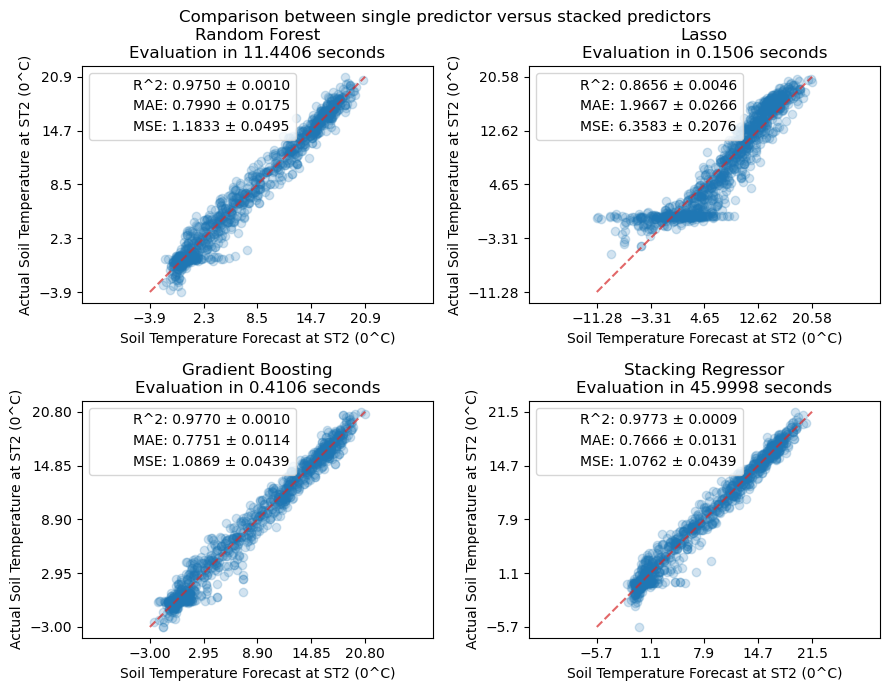

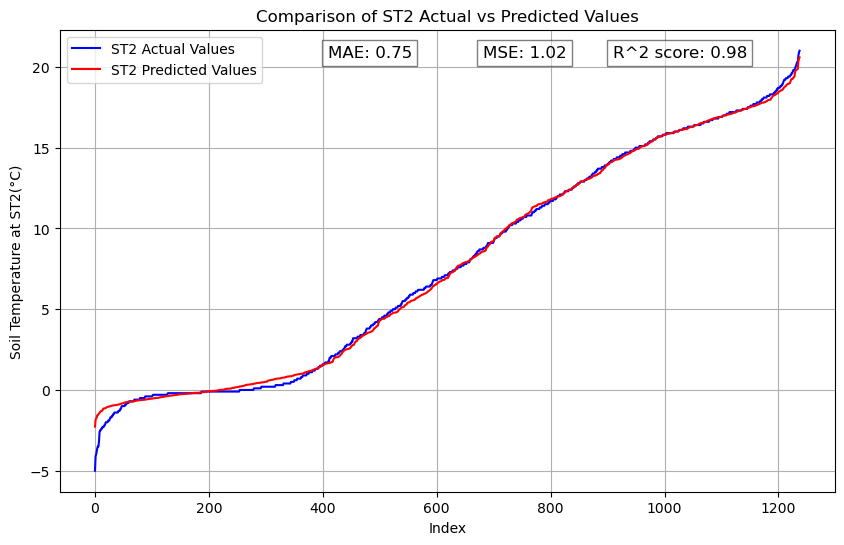

================================= Stacking Regressor Metrics ST5 with ST2 as a feature for forecast testing ==============================

{'Training Set R^2 Score': 0.9992719122896233, 'Validation Set R^2 Score': 0.9992239311847388, 'Training Set MAE': 0.1353232453096427, 'Validation Set MAE': 0.13688123253444032, 'Training Set MSE': 0.03297882193339973, 'Validation Set MSE': 0.03561040158881664, 'Training Set Median Absolute Error': 0.10348077145102634, 'Validation Set Median Absolute Error': 0.1000213063872799, 'Training Set Max Error': 1.1162602489974809, 'Validation Set Max Error': 1.1123062318844363, 'Training Set Explained Variance Score': 0.9992719123097994, 'Validation Set Explained Variance Score': 0.9992243513705326}



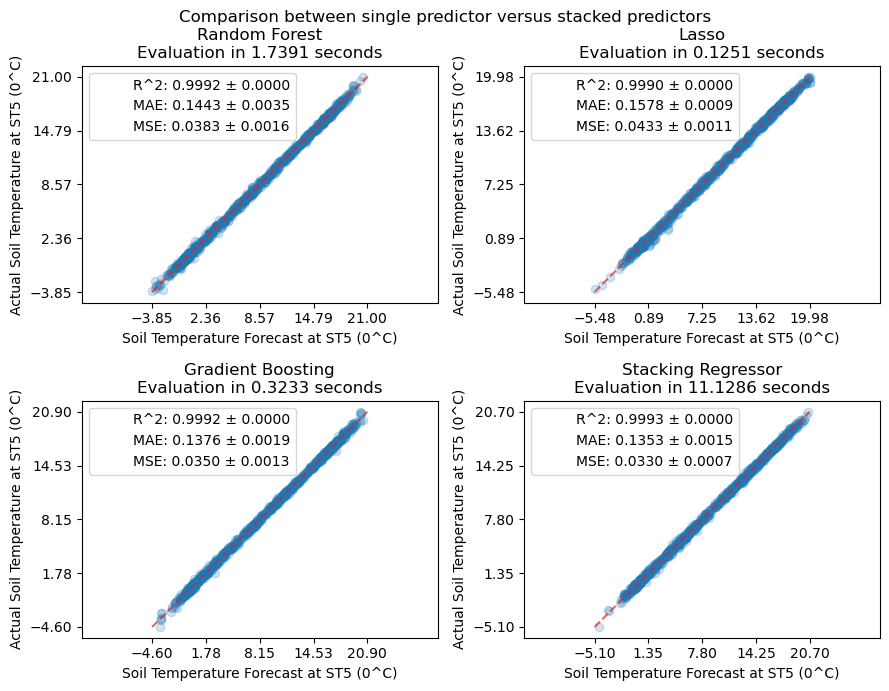

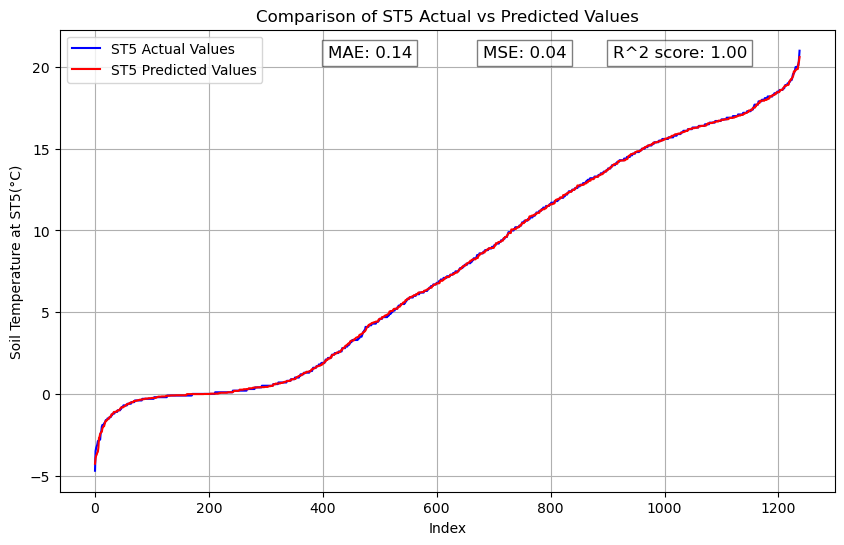

================================= Stacking Regressor Metrics ST10 with ST5 as a feature for forecast testing ==============================

{'Training Set R^2 Score': 0.9980469698557868, 'Validation Set R^2 Score': 0.9981901738483531, 'Training Set MAE': 0.1854724704404975, 'Validation Set MAE': 0.18294942214008778, 'Training Set MSE': 0.08581307947202205, 'Validation Set MSE': 0.07807506080935349, 'Training Set Median Absolute Error': 0.141856209751535, 'Validation Set Median Absolute Error': 0.14128306706609312, 'Training Set Max Error': 6.979863217396671, 'Validation Set Max Error': 3.4232883029701773, 'Training Set Explained Variance Score': 0.9980469763836055, 'Validation Set Explained Variance Score': 0.9981921433223994}



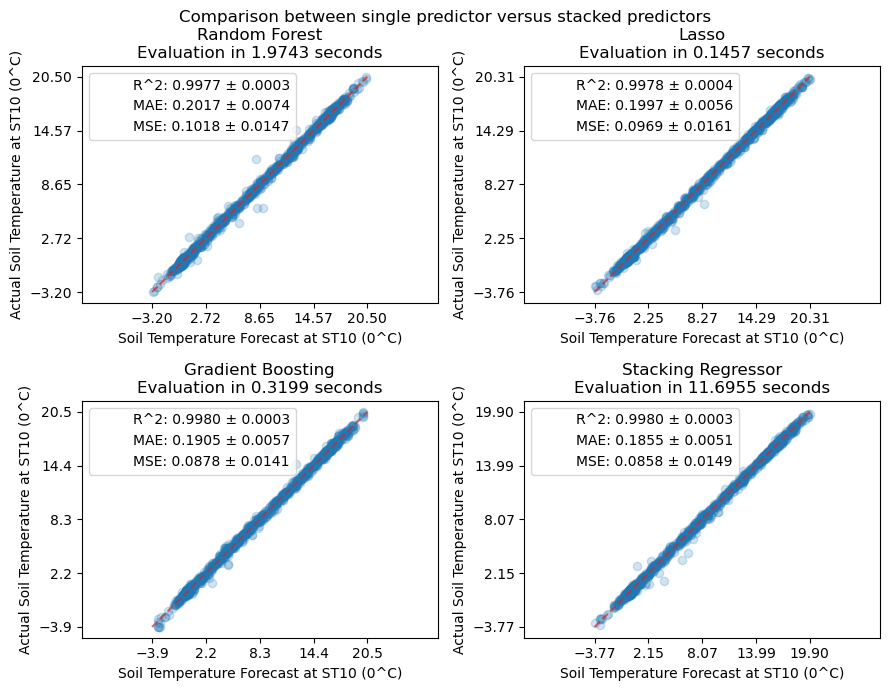

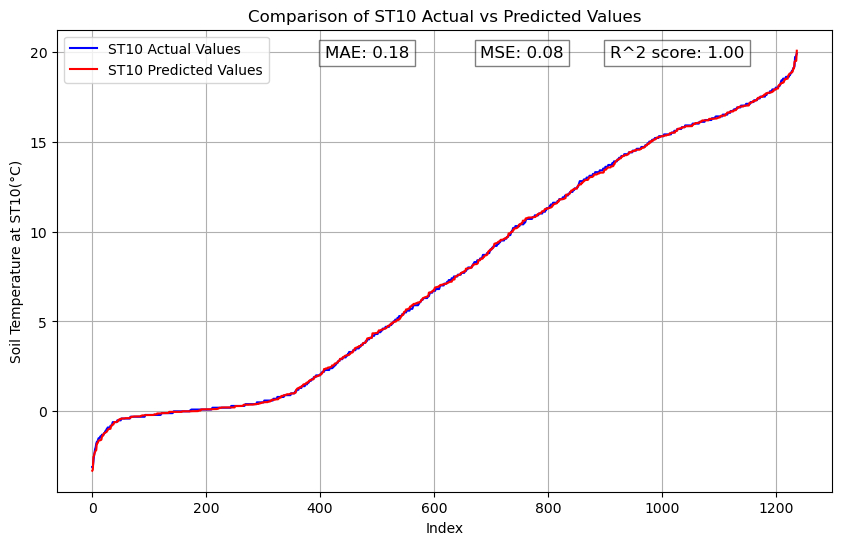

================================= Stacking Regressor Metrics ST20 with ST10 as a feature for forecast testing ==============================

{'Training Set R^2 Score': 0.9956675050868241, 'Validation Set R^2 Score': 0.9963559237881319, 'Training Set MAE': 0.2598891546827417, 'Validation Set MAE': 0.24984446772419205, 'Training Set MSE': 0.17203367627868477, 'Validation Set MSE': 0.14308312799129505, 'Training Set Median Absolute Error': 0.17886897585873518, 'Validation Set Median Absolute Error': 0.1712113724811008, 'Training Set Max Error': 6.6756027624190795, 'Validation Set Max Error': 2.744611166446226, 'Training Set Explained Variance Score': 0.9956675146169526, 'Validation Set Explained Variance Score': 0.9963568469401987}



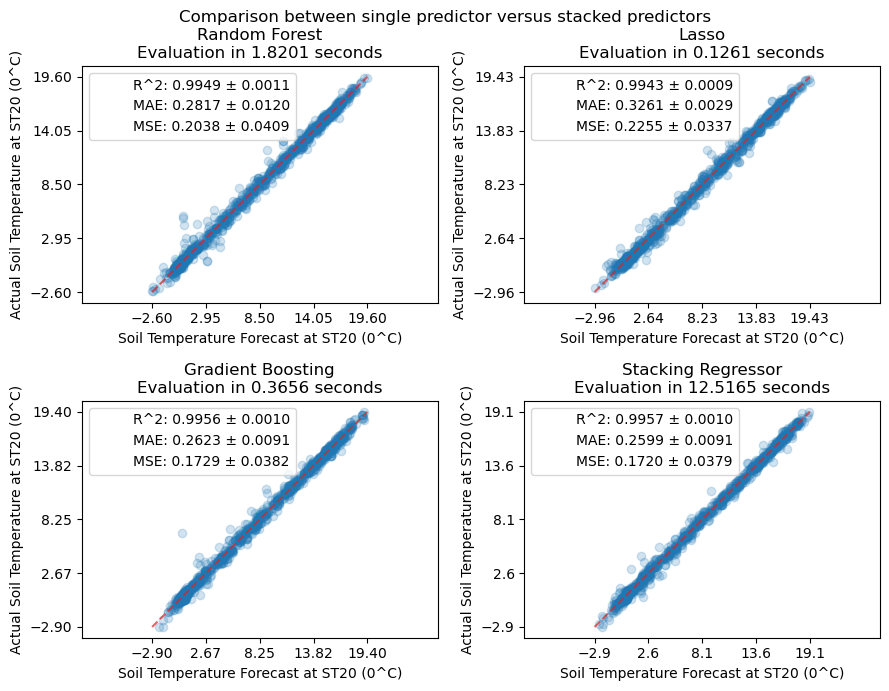

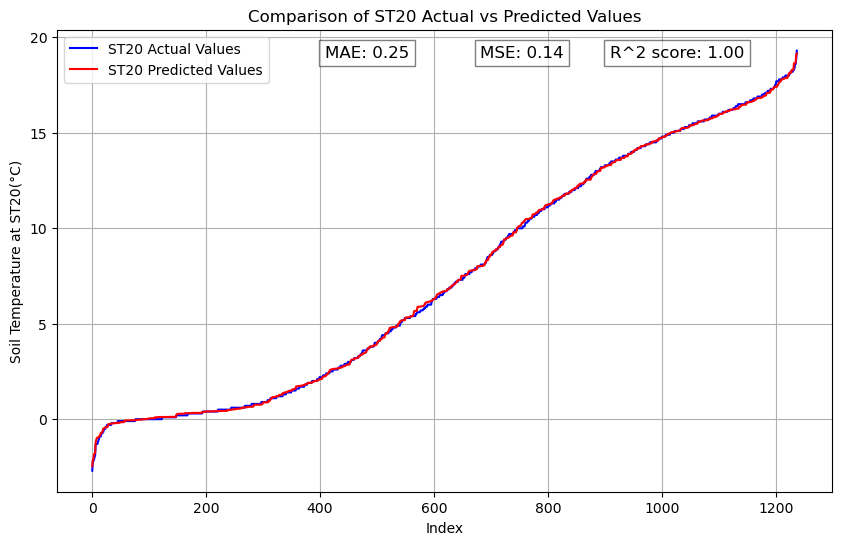

================================= Stacking Regressor Metrics ST50 with ST20 as a feature for forecast testing ==============================

{'Training Set R^2 Score': 0.9872011583558329, 'Validation Set R^2 Score': 0.9887760476905237, 'Training Set MAE': 0.45469687847821577, 'Validation Set MAE': 0.428726849249021, 'Training Set MSE': 0.3849908062949009, 'Validation Set MSE': 0.32240325394921054, 'Training Set Median Absolute Error': 0.3683089050210878, 'Validation Set Median Absolute Error': 0.3583757028909542, 'Training Set Max Error': 16.35520769679109, 'Validation Set Max Error': 3.9366978334979947, 'Training Set Explained Variance Score': 0.9872011588403441, 'Validation Set Explained Variance Score': 0.988781297939783}



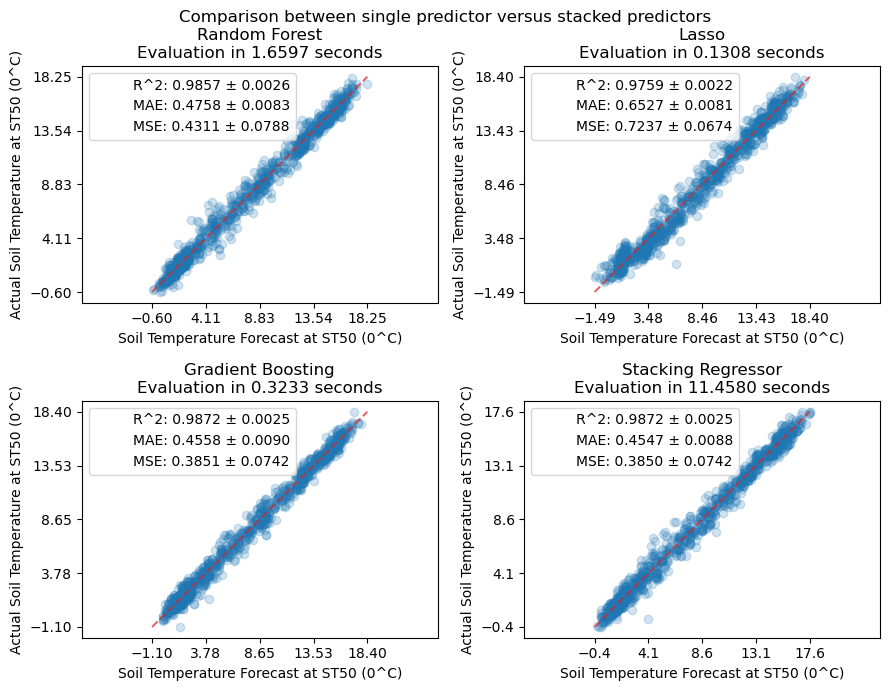

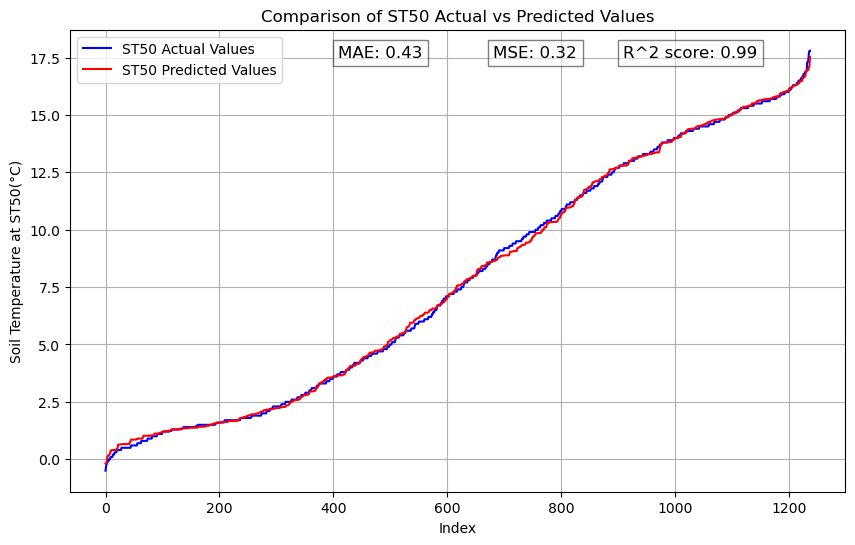

================================= Stacking Regressor Metrics ST100 with ST50 as a feature for forecast testing ==============================

{'Training Set R^2 Score': 0.9900472131296668, 'Validation Set R^2 Score': 0.9909114154498768, 'Training Set MAE': 0.32417165682989857, 'Validation Set MAE': 0.32570422533262916, 'Training Set MSE': 0.19141572600114154, 'Validation Set MSE': 0.17542315504697278, 'Training Set Median Absolute Error': 0.25123601931469874, 'Validation Set Median Absolute Error': 0.257625262990278, 'Training Set Max Error': 9.86275166882136, 'Validation Set Max Error': 1.6482348979914505, 'Training Set Explained Variance Score': 0.990047270319206, 'Validation Set Explained Variance Score': 0.9909227977018032}



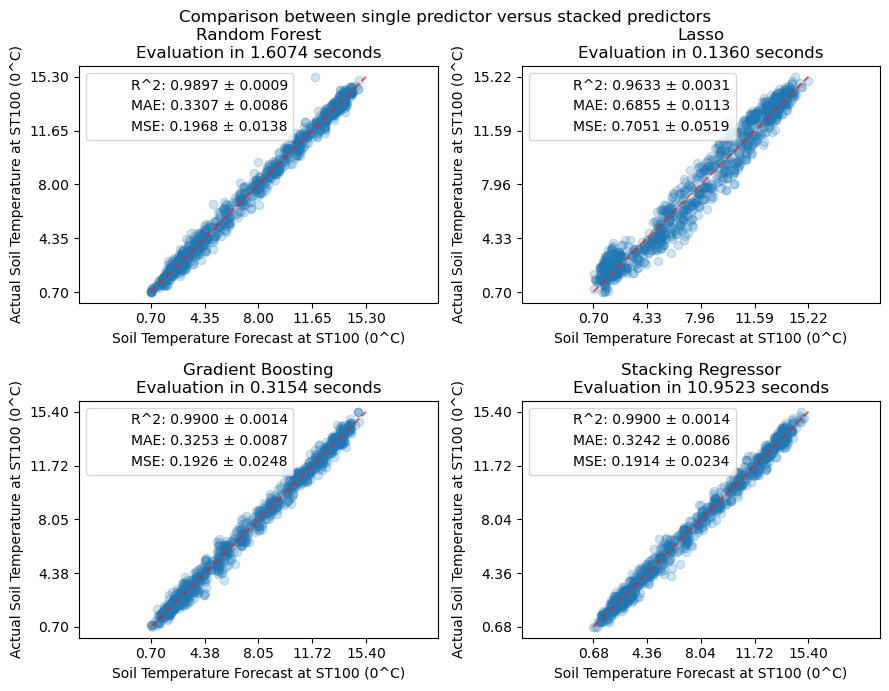

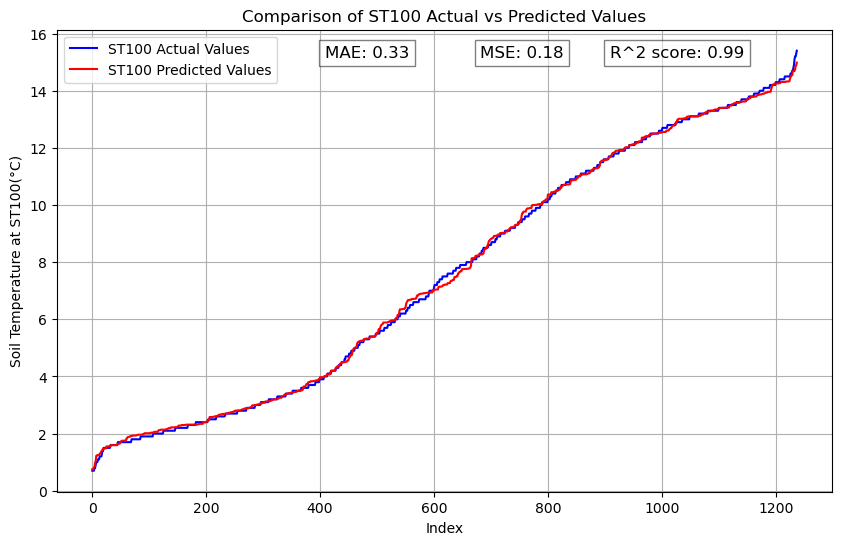

CPU times: total: 15min 58s
Wall time: 12min 22s


,mean_air_temperature_2m,min_air_temperature_2m,max_air_temperature_2m,relative_humidity,air_pressure_2m_mbar,precipitation_mm,snow_depth_cm,month,day,ST2,ST5,ST10,ST20,ST50,ST100
time,,,,,,,,,,,,,,,
2024-06-12,14.600000,9.8,16.9,77.842857,996.069578,0.000,0.0,6,12,15.226813,14.978758,14.794526,14.164250,13.005805,10.506664
2024-06-13,12.650000,8.2,15.6,77.475000,997.272517,0.000,0.0,6,13,14.187547,14.048353,13.953201,13.433892,12.313584,9.834395
2024-06-14,12.926316,8.2,15.8,70.710526,1000.234694,0.000,0.0,6,14,14.288660,14.169733,14.015406,13.564164,12.303151,9.834282
2024-06-15,12.900000,8.0,17.0,82.600000,997.756081,1.975,0.0,6,15,14.370223,14.241613,14.120030,13.570514,12.303341,9.834284
2024-06-16,13.450000,10.6,15.7,87.575000,995.799397,1.475,0.0,6,16,15.011963,14.817938,14.712059,14.148939,12.985756,10.344687
2024-06-17,13.075000,10.8,14.5,90.575000,999.073230,1.875,0.0,6,17,14.318063,14.198652,14.024244,13.565226,12.303183,9.834283
2024-06-18,13.925000,10.8,16.6,79.950000,1000.713181,0.000,0.0,6,18,15.001399,14.815322,14.711260,14.148843,12.985753,10.344687
2024-06-19,13.800000,10.7,16.1,90.150000,997.518868,1.400,0.0,6,19,15.255839,15.007265,14.853915,14.299610,13.028563,10.506910
2024-06-20,14.575000,10.0,16.7,81.225000,993.493643,0.000,0.0,6,20,15.694377,15.411937,15.220338,14.573080,13.172712,10.534200


In [137]:
%%time
import requests as requests
import json as json
import pandas as pd
from datetime import datetime
import math
import numpy as np
from sklearn.linear_model import LassoCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.metrics import PredictionErrorDisplay
from sklearn.model_selection import cross_val_predict, cross_validate
import time
import openmeteo_requests
import requests_cache
from retry_requests import retry

# Initialize the expires and last_modified variables 
expire_time = None
last_modified = None
latitude = 59.6603 # in degrees
longitude = 10.7817 # in degrees
altitude = 93 # in meters

# Extract the month and day
current_datetime = datetime.now()
# Extract date and time information at once
formatted_date = current_datetime.strftime("%Y-%m-%d")
formatted_time = current_datetime.strftime("%H-%M-%S")

# Now let us fetch the meteorological forecast data from MET Norway
request_url = f'https://api.met.no/weatherapi/locationforecast/2.0/complete?lat={latitude}&lon={longitude}&altitude={altitude}'
# Email address to include as User-Agent ID
user_agent = '259646@usn.no'
# Define headers with User-Agent
headers = {'User-Agent': user_agent, 'If-Modified-Since':last_modified}
# Send HTTP GET request with headers
response = requests.get(request_url, headers=headers)

# Check the response status code
if response.status_code == 200:
     # Save the expires and last_modified variables to avoid frequency request to the server
    expires_header = response.headers.get('expires')
    last_modified_header = response.headers.get('last-modified')

    # Convert expires and last_modified to RFC 1123 format
    expire_time = datetime.strptime(expires_header, '%a, %d %b %Y %H:%M:%S GMT').strftime('%a, %d %b %Y %H:%M:%S GMT')
    last_modified = datetime.strptime(last_modified_header, '%a, %d %b %Y %H:%M:%S GMT').strftime('%a, %d %b %Y %H:%M:%S GMT')
    weather_data = response.json()
else:
    # Request failed, print error message
    weather_data = {}
    print(f"Error: {response.status_code}")

# Extract relevant information
rows = []
for entry in weather_data['properties']['timeseries']:
    instant_details = entry['data']['instant']['details']
    next_6_hours_details = entry['data'].get('next_6_hours', {}).get('details', None)
    row = {
        'time': entry['time'],
        'instant_air_temperature': instant_details['air_temperature'],
        'instant_air_pressure_at_sea_level': instant_details['air_pressure_at_sea_level'],
        'instant_relative_humidity': instant_details['relative_humidity'],
        'next_6_hours_air_temperature_max': next_6_hours_details['air_temperature_max'] if next_6_hours_details else None,
        'next_6_hours_air_temperature_min': next_6_hours_details['air_temperature_min'] if next_6_hours_details else None,
        'next_6_hours_precipitation_amount': next_6_hours_details['precipitation_amount'] if next_6_hours_details else None
    }
    rows.append(row)

# Create DataFrame
MET_weather_df = pd.DataFrame(rows)
# Save to file
MET_weather_df.to_csv(f'data/{formatted_date}-{formatted_time}_MET_weather_forecast_10_days.csv')

MET_weather_df['time'] = pd.to_datetime(MET_weather_df['time'])
# Add snow depth with zero values for testing during the summer season as there is no snow but should be automated for all seasons not part of the weather forecast
MET_weather_df['snow_depth_cm'] = 0.0
# # Convert "time" column to datetime object
# MET_weather_df['time'] = pd.to_datetime(MET_weather_df['time'])
# # Extract date from datetime object
# MET_weather_df['date'] = MET_weather_df['time'].dt.date
# # Check if each date has 24 hours
# complete_dates = MET_weather_df['date'].value_counts()[MET_weather_df['date'].value_counts() == 24].index.tolist()
# # Filter rows with complete dates
# MET_weather_df = MET_weather_df[MET_weather_df['date'].isin(complete_dates)]
# # Drop the 'date' column
# MET_weather_df = MET_weather_df.drop(columns=['date'])

# Group DataFrame by date
grouped_df = MET_weather_df.groupby(MET_weather_df['time'].dt.date)

# Calculate daily mean, min, max
MET_daily_stats = grouped_df.agg(
    mean_air_temperature_2m=('instant_air_temperature', 'mean'),
    min_air_temperature_2m=('next_6_hours_air_temperature_min', 'min'),
    max_air_temperature_2m=('next_6_hours_air_temperature_max', 'max'),
    relative_humidity=('instant_relative_humidity', 'mean'),
    air_pressure_2m_mbar=('instant_air_pressure_at_sea_level', 'mean'),
    precipitation_mm=('next_6_hours_precipitation_amount', 'mean'),    
    snow_depth_cm=('snow_depth_cm', 'mean')
)

# Option 2: Fetch weather data from Open Meteo API
# Setup the Open-Meteo API client with cache and retry on error
cache_session = requests_cache.CachedSession('.cache', expire_after = 3600)
retry_session = retry(cache_session, retries = 5, backoff_factor = 0.2)
openmeteo = openmeteo_requests.Client(session = retry_session)

# Make sure all required weather variables are listed here
# The order of variables in hourly or daily is important to assign them correctly below
url = "https://api.open-meteo.com/v1/metno"
params = {
	"latitude": 59.6602,
	"longitude": 10.7817,
	"hourly": ["temperature_2m", "relative_humidity_2m", "precipitation", "rain", "snowfall"],
	"timezone": "auto",
	"past_hours": 24,
	"forecast_hours": 24
}
responses = openmeteo.weather_api(url, params=params)

# Process first location. Add a for-loop for multiple locations or weather models
response = responses[0]
print(f"Coordinates {response.Latitude()}°N {response.Longitude()}°E")
print(f"Elevation {response.Elevation()} m asl")
print(f"Timezone {response.Timezone()} {response.TimezoneAbbreviation()}")
print(f"Timezone difference to GMT+0 {response.UtcOffsetSeconds()} s")

# Process hourly data. The order of variables needs to be the same as requested.
hourly = response.Hourly()
hourly_temperature_2m = hourly.Variables(0).ValuesAsNumpy()
hourly_relative_humidity_2m = hourly.Variables(1).ValuesAsNumpy()
hourly_precipitation = hourly.Variables(2).ValuesAsNumpy()
hourly_rain = hourly.Variables(3).ValuesAsNumpy()
hourly_snowfall = hourly.Variables(4).ValuesAsNumpy()

hourly_data = {"date": pd.date_range(
	start = pd.to_datetime(hourly.Time(), unit = "s", utc = True),
	end = pd.to_datetime(hourly.TimeEnd(), unit = "s", utc = True),
	freq = pd.Timedelta(seconds = hourly.Interval()),
	inclusive = "left"
)}
hourly_data["temperature_2m"] = hourly_temperature_2m
hourly_data["relative_humidity_2m"] = hourly_relative_humidity_2m
hourly_data["precipitation"] = hourly_precipitation
hourly_data["rain"] = hourly_rain
hourly_data["snowfall"] = hourly_snowfall

open_meteo_hourly_df = pd.DataFrame(data = hourly_data)
open_meteo_hourly_df .to_csv(f'data/{formatted_date}_{formatted_time}_Meteo_weather_forecast_2_days.csv')

# Create function to evaluate model on few different levels
def predict_and_score(model, X_train, X_valid, Y_train, Y_valid):
    """
    Calculates and shows the different sklearn evaluation metrics
        
    Parameters:
        model: the model fitted.
        X_train: the input training set.
        X_valid: the input validation or test set.
        Y_train: the target training set.
        Y_valid: the target validation or test set.
            
    Returns:
        scores: the dictionary of the calculated sklearn metrics for train and valid sets.
    """
    
    train_preds = cross_val_predict(model, X_train, Y_train, cv=5)
    val_preds = model.predict(X_valid)
    scores = {"Training Set R^2 Score": r2_score(Y_train, train_preds),
              "Validation Set R^2 Score":r2_score(Y_valid, val_preds),
              "Training Set MAE": mean_absolute_error(Y_train, train_preds),
              "Validation Set MAE": mean_absolute_error(Y_valid, val_preds),             
              "Training Set MSE": mean_squared_error(Y_train, train_preds),
              "Validation Set MSE": mean_squared_error(Y_valid, val_preds),
              "Training Set Median Absolute Error": median_absolute_error(Y_train, train_preds),
              "Validation Set Median Absolute Error": median_absolute_error(Y_valid, val_preds),
              # "Training Set MA Percentage Error": mean_absolute_percentage_error(Y_train, train_preds),
              # "Validation Set MA Percentage Error": mean_absolute_percentage_error(Y_valid, val_preds),
              "Training Set Max Error": max_error(Y_train, train_preds),
              "Validation Set Max Error": max_error(Y_valid, val_preds),
              "Training Set Explained Variance Score": explained_variance_score(Y_train, train_preds),
              "Validation Set Explained Variance Score": explained_variance_score(Y_valid, val_preds)}
    return scores

def fit_model(dataset_df, features_dropped, target, model_type):
    X_f = dataset_df.drop(features_dropped, axis=1)
    Y_f = dataset_df[target]
    # Split the X and Y data in to train and test data
    X_train_2, X_valid_2, Y_train_2, Y_valid_2 = train_test_split(X_f, Y_f, test_size=0.15)
    model_type.fit(X_train_2, Y_train_2)
    scores = predict_and_score(model_type, X_train_2, X_valid_2, Y_train_2, Y_valid_2)
    print(scores)
    return X_train_2, X_valid_2, Y_train_2, Y_valid_2
    
def calculate_pressure(P0, T, altitude):
    # Constants
    g = 9.80665  # Acceleration due to gravity (m/s^2)
    M = 0.0289644  # Molar mass of Earth's air (kg/mol)
    R = 8.31432  # Universal gas constant (J/(mol*K))    
    # Calculate pressure
    pressure = P0 * math.exp((-g * M * altitude) / (R * (T + 273.15)))
    return pressure
# calculate the air_pressure at certain altitude from the sea level air pressure forecast fetched from MET Norway
MET_daily_stats['air_pressure_2m_mbar'] = MET_daily_stats.apply(lambda row: calculate_pressure(row['air_pressure_2m_mbar'], row['mean_air_temperature_2m'], altitude), axis=1)
# Convert index to datetime
MET_daily_stats.index = pd.to_datetime(MET_daily_stats.index)
# Extract month and day from the index
MET_daily_stats['month'] = MET_daily_stats.index.month
MET_daily_stats['day'] = MET_daily_stats.index.day
# Create test set for soil temperature at 2cm as ST_X_test
ST2_X_test = MET_daily_stats

# Define a function that takes test set and validation sets as input and generates prediction curve and returns test set prediction data 
def predict_plot(model, ST_X_test, ST_X_validation, ST_Y_validation, name):
   # Predict the test set which is forecast data
   ST_Y_test_preds = model.predict(ST_X_test)
   # Changes the predicted array values to pandas series
   ST_Y_test_preds_series = pd.Series(ST_Y_test_preds, name=name) 
   # Convert the Series to a DataFrame
   ST_Y_test_preds_df = ST_Y_test_preds_series.to_frame()
   ST_Y_test_preds_df.index =  ST_X_test.index
   # Predict the validation set
   ST_Y_validation_preds = model.predict(ST_X_validation)
   # Change validation predictions to pandas series
   ST_Y_validation_preds_series = pd.Series(ST_Y_validation_preds)
   # Make the original and predicted series to have the same index
   ST_Y_validation_preds_series.index =ST_Y_validation.index
   # Sort Y_valid and Y_valid_preds in ascending order and reset indices
   ST_Y_validation_sorted = ST_Y_validation.sort_values().reset_index(drop=True)
   ST_Y_validation_preds_sorted = ST_Y_validation_preds_series[ST_Y_validation.index].sort_values().reset_index(drop=True)
  
   # Calculate mean absolute error
   ST_mae = mean_absolute_error(ST_Y_validation,ST_Y_validation_preds)
   # Calculate mean squared error
   ST_mse = mean_squared_error(ST_Y_validation,ST_Y_validation_preds)
   # Calculate the R^2 score
   ST_r2_score = r2_score(ST_Y_validation,ST_Y_validation_preds)
   # Plot the sorted values
   plt.figure(figsize=(10, 6))
   plt.plot(ST_Y_validation_sorted.index,ST_Y_validation_sorted, color='blue', label=f'{name} Actual Values')
   plt.plot(ST_Y_validation_preds_sorted.index,ST_Y_validation_preds_sorted, color='red', label=f'{name} Predicted Values')
   # Display the mean absolute error as text annotation
   plt.text(0.4, 0.95, f'MAE: {ST_mae:.2f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
   plt.text(0.6, 0.95, f'MSE: {ST_mse:.2f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
   plt.text(0.8, 0.95, f'R^2 score: {ST_r2_score:.2f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
   plt.xlabel('Index')
   plt.ylabel(f'Soil Temperature at {name}(°C)')
   plt.title(f'Comparison of {name} Actual vs Predicted Values')
   plt.legend()
   plt.grid(True)
   plt.show()
   return ST_Y_test_preds_df

def plot_stacking_models(estimators_array, X_train, Y_train, target):
    # Measure and plot the results
    fig, axs = plt.subplots(2, 2, figsize=(9, 7))
    axs = np.ravel(axs)
    
    for ax, (name, est) in zip(axs, estimators_array):
        scorers = {"R^2": "r2", "MAE": "neg_mean_absolute_error", "MSE":"neg_mean_squared_error"}
    
        start_time = time.time()
        scores = cross_validate(est, X_train, Y_train, scoring=list(scorers.values()), n_jobs=-1, verbose=0)
        elapsed_time = time.time() - start_time
    
        y_pred = cross_val_predict(est, X_train, Y_train, n_jobs=-1, verbose=0)
        scores = {
            key: (
                f"{np.abs(np.mean(scores[f'test_{value}'])):.4f} ± "
                f"{np.std(scores[f'test_{value}']):.4f}"
            )
            for key, value in scorers.items()
        }
    
        display = PredictionErrorDisplay.from_predictions(
            y_true=Y_train,
            y_pred=y_pred,
            kind="actual_vs_predicted",
            ax=ax,
            scatter_kwargs={"alpha": 0.2, "color": "tab:blue"},
            line_kwargs={"color": "tab:red"},
        )
        ax.set_title(f"{name}\nEvaluation in {elapsed_time:.4f} seconds")
        # Set custom x-label and y-label
        ax.set_xlabel(f"Soil Temperature Forecast at {target} (0^C)")
        ax.set_ylabel(f"Actual Soil Temperature at {target} (0^C)")
        for name, score in scores.items():
            ax.plot([], [], " ", label=f"{name}: {score}")
        ax.legend(loc="upper left")
    
    plt.suptitle("Comparison between single predictor versus stacked predictors")
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.savefig(f'images/{target}_stacking_regressors_forecast_vs_actual_values.png')  # Save as PNG format
    plt.show()

global_estimators = []
# ============================ Fit the soil temperature at 2cm from the forecast weather data ===================================== 
def initialize_stacking_regressor():
    # Stack of predictors on a single data set
    rf_regressor = RandomForestRegressor(n_estimators=300, 
                                           min_samples_leaf=1,
                                           min_samples_split=2,
                                           max_features='sqrt',
                                           max_depth=20,
                                           bootstrap=False,
                                           random_state=42)
    lasso_regressor = LassoCV()
    gbdt_regresssor = HistGradientBoostingRegressor(random_state=42)
    # Define the estimators to be used in the stacking regressor
    local_estimators = [
        ("Random Forest", rf_regressor),
        ("Lasso", lasso_regressor),
        ("Gradient Boosting", gbdt_regresssor),
    ]
    
    # Initialize the stacking regressor
    stackingRegressorModel = StackingRegressor(estimators=local_estimators, final_estimator=RidgeCV())
    # Append to estimators
    global_estimators.extend(local_estimators)
    global_estimators.append(("Stacking Regressor", stackingRegressorModel))
    return stackingRegressorModel

# Initialize the Stacking regressor
ST2_stacking_regressor = initialize_stacking_regressor()
ST2_X_test.to_excel('models/test_data/ST2_X_test.xlsx')

# Fit and predict the validation set
print("================================= Stacking Regressor Metrics ST2 with weather data selected features for forecast testing ==============================\n")
ST2_X_training, ST2_X_validation, ST2_Y_training, ST2_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
                                                                                           ['earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','ST100','ST50','ST20','ST10','ST5','ST2','ID'], 
                                                                                           'ST2', 
                                                                                           ST2_stacking_regressor)
print('===========================================================================================\n')

# The stacked models evaluation plots
plot_stacking_models(global_estimators, ST2_X_training, ST2_Y_training, 'ST2')
# Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
ST2_Y_test_preds_df = predict_plot(ST2_stacking_regressor, ST2_X_test, ST2_X_validation, ST2_Y_validation, 'ST2')
dump(ST2_stacking_regressor, filename="models/soil_temps/ST2.joblib");

# Merge the Original DataFrame with the new predicted dataframe
ST2_forecast_df = pd.concat([ST2_X_test, ST2_Y_test_preds_df], axis=1)
# ======================= Fit the soil temperature at 5cm from the predictions at 2cm ================================
# Copy the ST2 predicted values as test data input for ST5
ST5_features = ['ST2', 'month']
ST5_X_test = ST2_forecast_df[ST5_features]
ST5_X_test.index = ST2_forecast_df.index

# Initialize the Stacking regressor
global_estimators = []
ST5_stacking_regressor= initialize_stacking_regressor()
ST5_X_test.to_excel('models/test_data/ST5_X_test.xlsx')
# Fit and predict the validation set
print("================================= Stacking Regressor Metrics ST5 with ST2 as a feature for forecast testing ==============================\n")
ST5_X_training, ST5_X_validation, ST5_Y_training, ST5_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
                                                                                           ['mean_air_temperature_2m','min_air_temperature_2m','max_air_temperature_2m','relative_humidity','air_pressure_2m_mbar','precipitation_mm','earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','snow_depth_cm','day','ST100','ST50','ST20','ST10','ST5','ID'], 
                                                                                           'ST5', 
                                                                                           ST5_stacking_regressor)
print('===========================================================================================\n')

# The stacked models evaluation plots
plot_stacking_models(global_estimators, ST5_X_training, ST5_Y_training, 'ST5')
# Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
ST5_Y_test_preds_df = predict_plot(ST5_stacking_regressor, ST5_X_test, ST5_X_validation, ST5_Y_validation, 'ST5')
dump(ST5_stacking_regressor, filename="models/soil_temps/ST5.joblib");
# Merge the previous DataFrame with the new predicted dataframe
ST5_forecast_df = pd.concat([ST2_forecast_df, ST5_Y_test_preds_df], axis=1)

# ======================= Fit the soil temperature at 10cm from the predictions at 5cm ================================
# Copy the ST5 predicted values as test data input for ST10
ST10_features = ['ST5', 'month']
ST10_X_test = ST5_forecast_df[ST10_features]
ST10_X_test.index = ST5_forecast_df.index

# Initialize the Stacking regressor
global_estimators = []
ST10_stacking_regressor = initialize_stacking_regressor()
ST10_X_test.to_excel('models/test_data/ST10_X_test.xlsx')
# Fit and predict the validation set
print("================================= Stacking Regressor Metrics ST10 with ST5 as a feature for forecast testing ==============================\n")
ST10_X_training, ST10_X_validation, ST10_Y_training, ST10_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
                                                                                           ['mean_air_temperature_2m','min_air_temperature_2m','max_air_temperature_2m','relative_humidity','air_pressure_2m_mbar','precipitation_mm','earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','snow_depth_cm','day','ST100','ST50','ST20','ST10','ST2','ID'], 
                                                                                           'ST10', 
                                                                                           ST10_stacking_regressor)
print('===========================================================================================\n')

# The stacked model evaluation plots
plot_stacking_models(global_estimators, ST10_X_training, ST10_Y_training, 'ST10')
# Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
ST10_Y_test_preds_df = predict_plot(ST10_stacking_regressor, ST10_X_test, ST10_X_validation, ST10_Y_validation, 'ST10')
dump(ST10_stacking_regressor, filename="models/soil_temps/ST10.joblib");
# Merge the previous DataFrame with the new predicted dataframe
ST10_forecast_df = pd.concat([ST5_forecast_df, ST10_Y_test_preds_df], axis=1)

# ======================= Fit the soil temperature at 20cm from the predictions at 10cm and month ================================
# Copy the ST10 predicted values as test data input for ST20
ST20_features = ['ST10', 'month']
ST20_X_test = ST10_forecast_df[ST20_features]
ST20_X_test.index = ST10_forecast_df.index

# Initialize the Stacking regressor
global_estimators = []
ST20_stacking_regressor = initialize_stacking_regressor()
ST20_X_test.to_excel('models/test_data/ST20_X_test.xlsx')
# Fit and predict the validation set
print("================================= Stacking Regressor Metrics ST20 with ST10 as a feature for forecast testing ==============================\n")
ST20_X_training, ST20_X_validation, ST20_Y_training, ST20_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
                                                                                           ['mean_air_temperature_2m','min_air_temperature_2m','max_air_temperature_2m','relative_humidity','air_pressure_2m_mbar','precipitation_mm','earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','snow_depth_cm','day','ST100','ST50','ST20','ST5','ST2','ID'], 
                                                                                           'ST20', 
                                                                                           ST20_stacking_regressor)
print('===========================================================================================\n')

# The stacked model evaluation plots
plot_stacking_models(global_estimators, ST20_X_training, ST20_Y_training, 'ST20')
# Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
ST20_Y_test_preds_df = predict_plot(ST20_stacking_regressor, ST20_X_test, ST20_X_validation, ST20_Y_validation, 'ST20')
dump(ST20_stacking_regressor, filename="models/soil_temps/ST20.joblib");
# Merge the previous DataFrame with the new predicted dataframe
ST20_forecast_df = pd.concat([ST10_forecast_df, ST20_Y_test_preds_df], axis=1)

# ======================= Fit the soil temperature at 50cm from the predictions at 20cm and month ================================
# Copy the ST20 predicted values as test data input for ST50
ST50_features = ['ST20', 'month']
ST50_X_test = ST20_forecast_df[ST50_features]
ST50_X_test.index = ST20_forecast_df.index

# Initialize the Stacking regressor
global_estimators = []
ST50_stacking_regressor = initialize_stacking_regressor()
ST50_X_test.to_excel('models/test_data/ST50_X_test.xlsx')
# Fit and predict the validation set
print("================================= Stacking Regressor Metrics ST50 with ST20 as a feature for forecast testing ==============================\n")
ST50_X_training, ST50_X_validation, ST50_Y_training, ST50_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
                                                                                           ['mean_air_temperature_2m','min_air_temperature_2m','max_air_temperature_2m','relative_humidity','air_pressure_2m_mbar','precipitation_mm','earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','snow_depth_cm','day','ST100','ST50','ST10','ST5','ST2','ID'], 
                                                                                           'ST50', 
                                                                                           ST50_stacking_regressor)
print('===========================================================================================\n')

# The stacked model evaluation plots
plot_stacking_models(global_estimators, ST50_X_training, ST50_Y_training, 'ST50')
# Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
ST50_Y_test_preds_df = predict_plot(ST50_stacking_regressor, ST50_X_test, ST50_X_validation, ST50_Y_validation, 'ST50')
dump(ST50_stacking_regressor, filename="models/soil_temps/ST50.joblib");
# Merge the previous DataFrame with the new predicted dataframe
ST50_forecast_df = pd.concat([ST20_forecast_df, ST50_Y_test_preds_df], axis=1)

# ======================= Fit the soil temperature at 100cm from the predictions at 50cm and month ================================
# Copy the ST50 predicted values as test data input for ST100
ST100_features = ['ST50', 'month']
ST100_X_test = ST50_forecast_df[ST100_features]
ST100_X_test.index = ST50_forecast_df.index

# Initialize the Stacking regressor
global_estimators = []
ST100_stacking_regressor = initialize_stacking_regressor()
ST100_X_test.to_excel('models/test_data/ST100_X_test.xlsx')
# Fit and predict the validation set
print("================================= Stacking Regressor Metrics ST100 with ST50 as a feature for forecast testing ==============================\n")
ST100_X_training, ST100_X_validation, ST100_Y_training, ST100_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
                                                                                           ['mean_air_temperature_2m','min_air_temperature_2m','max_air_temperature_2m','relative_humidity','air_pressure_2m_mbar','precipitation_mm','earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','snow_depth_cm','day','ST100','ST20','ST10','ST5','ST2','ID'], 
                                                                                           'ST100', 
                                                                                           ST100_stacking_regressor)
print('===========================================================================================\n')

# The stacked model evaluation plots
plot_stacking_models(global_estimators, ST100_X_training, ST100_Y_training, 'ST100')
# Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
ST100_Y_test_preds_df = predict_plot(ST100_stacking_regressor, ST100_X_test, ST100_X_validation, ST100_Y_validation, 'ST100')
dump(ST100_stacking_regressor, filename="models/soil_temps/ST100.joblib");
# Merge the previous DataFrame with the new predicted dataframe
ST100_forecast_df = pd.concat([ST50_forecast_df, ST100_Y_test_preds_df], axis=1)

# Merge the Original DataFrame with the predicted Series DataFrames
ST_forecast_df = ST100_forecast_df.copy()

# Save the merged DataFrame to an Excel file
ST_forecast_df.to_excel(f'data/{formatted_date}-{formatted_time}_Soil_temperature_forecast_10_days.xlsx', index=True)
ST_forecast_df

In [138]:
dataset_denormalized_outlier_filtered

,mean_air_temperature_2m,min_air_temperature_2m,max_air_temperature_2m,relative_humidity,air_pressure_2m_mbar,precipitation_mm,evaporation_mm,earth_heat_flux_MJ_m2,radiation_balance_w_m2,phosynthetic_active_radiation_mE_m2,...,snow_depth_cm,ST2,ST5,ST10,ST20,ST50,ST100,month,day,ID
0,-5.0,-7.6,-3.0,100.0,1001.5,2.635294,0.0,-0.3,-0.12,1.17,...,4.666667,-2.000000e-01,-0.1,0.1,0.4,1.9,3.4,1.0,1.0,1
1,0.6,-5.0,4.0,88.6,997.7,2.334783,0.0,-0.2,-2.21,1.62,...,6.444444,-1.000000e-01,-0.1,0.0,0.4,1.9,3.4,1.0,2.0,2
2,2.1,-1.1,4.6,88.6,991.5,8.800000,0.0,-0.1,-1.80,0.71,...,6.500000,-1.000000e-01,-0.1,0.0,0.5,1.9,3.4,1.0,3.0,3
3,1.8,-3.3,4.4,67.3,987.0,2.100000,0.0,-0.1,-4.83,2.49,...,6.437500,-8.881784e-16,0.0,0.1,0.5,1.9,3.4,1.0,4.0,4
4,0.6,-3.6,4.4,98.2,993.3,1.200000,0.0,-0.2,-0.44,1.68,...,8.187500,-8.881784e-16,0.0,0.1,0.5,1.9,3.4,1.0,5.0,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8247,5.2,2.4,7.9,90.0,976.7,7.600000,0.0,0.6,0.45,13.34,...,0.000000,1.600000e+00,1.3,1.0,0.9,1.2,2.0,3.0,28.0,8852
8248,5.9,4.7,7.4,93.6,978.3,2.600000,0.0,0.8,0.29,9.17,...,0.000000,2.900000e+00,2.6,2.1,1.7,1.5,2.1,3.0,29.0,8853
8249,5.9,4.0,7.4,94.4,990.1,2.000000,0.0,0.7,0.61,9.32,...,4.428571,3.500000e+00,3.3,2.8,2.5,1.9,2.2,3.0,30.0,8854
8250,6.2,2.4,8.0,93.6,988.1,2.900000,0.0,0.6,0.02,8.09,...,4.571429,4.200000e+00,4.1,3.6,3.1,2.4,2.3,3.0,31.0,8855


### b. Second option to optimize the prediction algorithm is using stacking regressors with all features considered for each target

In [276]:
# %%time
# import requests as requests
# import json as json
# import pandas as pd
# from datetime import datetime
# import math
# import numpy as np
# from sklearn.linear_model import LassoCV
# from sklearn.ensemble import RandomForestRegressor
# from sklearn.ensemble import HistGradientBoostingRegressor
# from sklearn.ensemble import StackingRegressor
# from sklearn.linear_model import RidgeCV
# from sklearn.metrics import PredictionErrorDisplay
# from sklearn.model_selection import cross_val_predict, cross_validate
# import time
# import openmeteo_requests
# import requests_cache
# from retry_requests import retry

# # Initialize the expires and last_modified variables 
# expire_time = None
# last_modified = None
# latitude = 59.6603 # in degrees
# longitude = 10.7817 # in degrees
# altitude = 93 # in meters

# # Extract the month and day
# current_datetime = datetime.now()
# # Extract date and time information at once
# formatted_date = current_datetime.strftime("%Y-%m-%d")
# formatted_time = current_datetime.strftime("%H-%M-%S")

# # Now let us fetch the meteorological forecast data from MET Norway
# request_url = f'https://api.met.no/weatherapi/locationforecast/2.0/complete?lat={latitude}&lon={longitude}&altitude={altitude}'
# # Email address to include as User-Agent ID
# user_agent = '259646@usn.no'
# # Define headers with User-Agent
# headers = {'User-Agent': user_agent, 'If-Modified-Since':last_modified}
# # Send HTTP GET request with headers
# response = requests.get(request_url, headers=headers)

# # Check the response status code
# if response.status_code == 200:
#      # Save the expires and last_modified variables to avoid frequency request to the server
#     expires_header = response.headers.get('expires')
#     last_modified_header = response.headers.get('last-modified')

#     # Convert expires and last_modified to RFC 1123 format
#     expire_time = datetime.strptime(expires_header, '%a, %d %b %Y %H:%M:%S GMT').strftime('%a, %d %b %Y %H:%M:%S GMT')
#     last_modified = datetime.strptime(last_modified_header, '%a, %d %b %Y %H:%M:%S GMT').strftime('%a, %d %b %Y %H:%M:%S GMT')
#     weather_data = response.json()
# else:
#     # Request failed, print error message
#     weather_data = {}
#     print(f"Error: {response.status_code}")

# # Extract relevant information
# rows = []
# for entry in weather_data['properties']['timeseries']:
#     instant_details = entry['data']['instant']['details']
#     next_6_hours_details = entry['data'].get('next_6_hours', {}).get('details', None)
#     row = {
#         'time': entry['time'],
#         'instant_air_temperature': instant_details['air_temperature'],
#         'instant_air_pressure_at_sea_level': instant_details['air_pressure_at_sea_level'],
#         'instant_relative_humidity': instant_details['relative_humidity'],
#         'next_6_hours_air_temperature_max': next_6_hours_details['air_temperature_max'] if next_6_hours_details else None,
#         'next_6_hours_air_temperature_min': next_6_hours_details['air_temperature_min'] if next_6_hours_details else None,
#         'next_6_hours_precipitation_amount': next_6_hours_details['precipitation_amount'] if next_6_hours_details else None
#     }
#     rows.append(row)

# # Create DataFrame
# MET_weather_df = pd.DataFrame(rows)
# # Save to file
# MET_weather_df.to_csv(f'data/{formatted_date}-{formatted_time}_MET_weather_forecast_10_days.csv')

# MET_weather_df['time'] = pd.to_datetime(MET_weather_df['time'])
# # Add snow depth with zero values for testing during the summer season as there is no snow but should be automated for all seasons not part of the weather forecast
# MET_weather_df['snow_depth_cm'] = 0.0
# # # Convert "time" column to datetime object
# # MET_weather_df['time'] = pd.to_datetime(MET_weather_df['time'])
# # # Extract date from datetime object
# # MET_weather_df['date'] = MET_weather_df['time'].dt.date
# # # Check if each date has 24 hours
# # complete_dates = MET_weather_df['date'].value_counts()[MET_weather_df['date'].value_counts() == 24].index.tolist()
# # # Filter rows with complete dates
# # MET_weather_df = MET_weather_df[MET_weather_df['date'].isin(complete_dates)]
# # # Drop the 'date' column
# # MET_weather_df = MET_weather_df.drop(columns=['date'])

# # Group DataFrame by date
# grouped_df = MET_weather_df.groupby(MET_weather_df['time'].dt.date)

# # Calculate daily mean, min, max
# MET_daily_stats = grouped_df.agg(
#     mean_air_temperature_2m=('instant_air_temperature', 'mean'),
#     min_air_temperature_2m=('next_6_hours_air_temperature_min', 'min'),
#     max_air_temperature_2m=('next_6_hours_air_temperature_max', 'max'),
#     relative_humidity=('instant_relative_humidity', 'mean'),
#     air_pressure_2m_mbar=('instant_air_pressure_at_sea_level', 'mean'),
#     precipitation_mm=('next_6_hours_precipitation_amount', 'mean'),    
#     snow_depth_cm=('snow_depth_cm', 'mean')
# )

# # Option 2: Fetch weather data from Open Meteo API
# # Setup the Open-Meteo API client with cache and retry on error
# cache_session = requests_cache.CachedSession('.cache', expire_after = 3600)
# retry_session = retry(cache_session, retries = 5, backoff_factor = 0.2)
# openmeteo = openmeteo_requests.Client(session = retry_session)

# # Make sure all required weather variables are listed here
# # The order of variables in hourly or daily is important to assign them correctly below
# url = "https://api.open-meteo.com/v1/metno"
# params = {
# 	"latitude": 59.6602,
# 	"longitude": 10.7817,
# 	"hourly": ["temperature_2m", "relative_humidity_2m", "precipitation", "rain", "snowfall"],
# 	"timezone": "auto",
# 	"past_hours": 24,
# 	"forecast_hours": 24
# }
# responses = openmeteo.weather_api(url, params=params)

# # Process first location. Add a for-loop for multiple locations or weather models
# response = responses[0]
# print(f"Coordinates {response.Latitude()}°N {response.Longitude()}°E")
# print(f"Elevation {response.Elevation()} m asl")
# print(f"Timezone {response.Timezone()} {response.TimezoneAbbreviation()}")
# print(f"Timezone difference to GMT+0 {response.UtcOffsetSeconds()} s")

# # Process hourly data. The order of variables needs to be the same as requested.
# hourly = response.Hourly()
# hourly_temperature_2m = hourly.Variables(0).ValuesAsNumpy()
# hourly_relative_humidity_2m = hourly.Variables(1).ValuesAsNumpy()
# hourly_precipitation = hourly.Variables(2).ValuesAsNumpy()
# hourly_rain = hourly.Variables(3).ValuesAsNumpy()
# hourly_snowfall = hourly.Variables(4).ValuesAsNumpy()

# hourly_data = {"date": pd.date_range(
# 	start = pd.to_datetime(hourly.Time(), unit = "s", utc = True),
# 	end = pd.to_datetime(hourly.TimeEnd(), unit = "s", utc = True),
# 	freq = pd.Timedelta(seconds = hourly.Interval()),
# 	inclusive = "left"
# )}
# hourly_data["temperature_2m"] = hourly_temperature_2m
# hourly_data["relative_humidity_2m"] = hourly_relative_humidity_2m
# hourly_data["precipitation"] = hourly_precipitation
# hourly_data["rain"] = hourly_rain
# hourly_data["snowfall"] = hourly_snowfall

# open_meteo_hourly_df = pd.DataFrame(data = hourly_data)
# open_meteo_hourly_df .to_csv(f'data/{formatted_date}_{formatted_time}_Meteo_weather_forecast_2_days.csv')

# # Create function to evaluate model on few different levels
# def predict_and_score(model, X_train, X_valid, Y_train, Y_valid):
#     """
#     Calculates and shows the different sklearn evaluation metrics
        
#     Parameters:
#         model: the model fitted.
#         X_train: the input training set.
#         X_valid: the input validation or test set.
#         Y_train: the target training set.
#         Y_valid: the target validation or test set.
            
#     Returns:
#         scores: the dictionary of the calculated sklearn metrics for train and valid sets.
#     """
    
#     train_preds = cross_val_predict(model, X_train, Y_train, cv=5)
#     val_preds = model.predict(X_valid)
#     scores = {"Training Set R^2 Score": r2_score(Y_train, train_preds),
#               "Validation Set R^2 Score":r2_score(Y_valid, val_preds),
#               "Training Set MAE": mean_absolute_error(Y_train, train_preds),
#               "Validation Set MAE": mean_absolute_error(Y_valid, val_preds),             
#               "Training Set MSE": mean_squared_error(Y_train, train_preds),
#               "Validation Set MSE": mean_squared_error(Y_valid, val_preds),
#               "Training Set Median Absolute Error": median_absolute_error(Y_train, train_preds),
#               "Validation Set Median Absolute Error": median_absolute_error(Y_valid, val_preds),
#               # "Training Set MA Percentage Error": mean_absolute_percentage_error(Y_train, train_preds),
#               # "Validation Set MA Percentage Error": mean_absolute_percentage_error(Y_valid, val_preds),
#               "Training Set Max Error": max_error(Y_train, train_preds),
#               "Validation Set Max Error": max_error(Y_valid, val_preds),
#               "Training Set Explained Variance Score": explained_variance_score(Y_train, train_preds),
#               "Validation Set Explained Variance Score": explained_variance_score(Y_valid, val_preds)}
#     return scores

# def fit_model(dataset_df, features_dropped, target, model_type):
#     X_f = dataset_df.drop(features_dropped, axis=1)
#     Y_f = dataset_df[target]
#     # Split the X and Y data in to train and test data
#     X_train_2, X_valid_2, Y_train_2, Y_valid_2 = train_test_split(X_f, Y_f, test_size=0.15)
#     model_type.fit(X_train_2, Y_train_2)
#     scores = predict_and_score(model_type, X_train_2, X_valid_2, Y_train_2, Y_valid_2)
#     print(scores)
#     return X_train_2, X_valid_2, Y_train_2, Y_valid_2
    
# def calculate_pressure(P0, T, altitude):
#     # Constants
#     g = 9.80665  # Acceleration due to gravity (m/s^2)
#     M = 0.0289644  # Molar mass of Earth's air (kg/mol)
#     R = 8.31432  # Universal gas constant (J/(mol*K))    
#     # Calculate pressure
#     pressure = P0 * math.exp((-g * M * altitude) / (R * (T + 273.15)))
#     return pressure
# # calculate the air_pressure at certain altitude from the sea level air pressure forecast fetched from MET Norway
# MET_daily_stats['air_pressure_2m_mbar'] = MET_daily_stats.apply(lambda row: calculate_pressure(row['air_pressure_2m_mbar'], row['mean_air_temperature_2m'], altitude), axis=1)
# # Convert index to datetime
# MET_daily_stats.index = pd.to_datetime(MET_daily_stats.index)
# # Extract month and day from the index
# MET_daily_stats['month'] = MET_daily_stats.index.month
# MET_daily_stats['day'] = MET_daily_stats.index.day
# # Create test set for soil temperature at 2cm as ST_X_test
# ST2_X_test = MET_daily_stats

# # Define a function that takes test set and validation sets as input and generates prediction curve and returns test set prediction data 
# def predict_plot(model, ST_X_test, ST_X_validation, ST_Y_validation, name):
#    # Predict the test set which is forecast data
#    ST_Y_test_preds = model.predict(ST_X_test)
#    # Changes the predicted array values to pandas series
#    ST_Y_test_preds_series = pd.Series(ST_Y_test_preds, name=name) 
#    # Convert the Series to a DataFrame
#    ST_Y_test_preds_df = ST_Y_test_preds_series.to_frame()
#    ST_Y_test_preds_df.index =  ST_X_test.index
#    # Predict the validation set
#    ST_Y_validation_preds = model.predict(ST_X_validation)
#    # Change validation predictions to pandas series
#    ST_Y_validation_preds_series = pd.Series(ST_Y_validation_preds)
#    # Make the original and predicted series to have the same index
#    ST_Y_validation_preds_series.index =ST_Y_validation.index
#    # Sort Y_valid and Y_valid_preds in ascending order and reset indices
#    ST_Y_validation_sorted = ST_Y_validation.sort_values().reset_index(drop=True)
#    ST_Y_validation_preds_sorted = ST_Y_validation_preds_series[ST_Y_validation.index].sort_values().reset_index(drop=True)
  
#    # Calculate mean absolute error
#    ST_mae = mean_absolute_error(ST_Y_validation,ST_Y_validation_preds)
#    # Calculate mean squared error
#    ST_mse = mean_squared_error(ST_Y_validation,ST_Y_validation_preds)
#    # Calculate the R^2 score
#    ST_r2_score = r2_score(ST_Y_validation,ST_Y_validation_preds)
#    # Plot the sorted values
#    plt.figure(figsize=(10, 6))
#    plt.plot(ST_Y_validation_sorted.index,ST_Y_validation_sorted, color='blue', label=f'{name} Actual Values')
#    plt.plot(ST_Y_validation_preds_sorted.index,ST_Y_validation_preds_sorted, color='red', label=f'{name} Predicted Values')
#    # Display the mean absolute error as text annotation
#    plt.text(0.4, 0.95, f'MAE: {ST_mae:.2f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
#    plt.text(0.6, 0.95, f'MSE: {ST_mse:.2f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
#    plt.text(0.8, 0.95, f'R^2 score: {ST_r2_score:.2f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
#    plt.xlabel('Index')
#    plt.ylabel(f'Soil Temperature at {name}(°C)')
#    plt.title(f'Comparison of {name} Actual vs Predicted Values')
#    plt.legend()
#    plt.grid(True)
#    plt.show()
#    return ST_Y_test_preds_df

# def plot_stacking_models(estimators_array, X_train, Y_train, target):
#     # Measure and plot the results
#     fig, axs = plt.subplots(2, 2, figsize=(9, 7))
#     axs = np.ravel(axs)
    
#     for ax, (name, est) in zip(axs, estimators_array):
#         scorers = {"R^2": "r2", "MAE": "neg_mean_absolute_error", "MSE":"neg_mean_squared_error"}
    
#         start_time = time.time()
#         scores = cross_validate(est, X_train, Y_train, scoring=list(scorers.values()), n_jobs=-1, verbose=0)
#         elapsed_time = time.time() - start_time
    
#         y_pred = cross_val_predict(est, X_train, Y_train, n_jobs=-1, verbose=0)
#         scores = {
#             key: (
#                 f"{np.abs(np.mean(scores[f'test_{value}'])):.4f} ± "
#                 f"{np.std(scores[f'test_{value}']):.4f}"
#             )
#             for key, value in scorers.items()
#         }
    
#         display = PredictionErrorDisplay.from_predictions(
#             y_true=Y_train,
#             y_pred=y_pred,
#             kind="actual_vs_predicted",
#             ax=ax,
#             scatter_kwargs={"alpha": 0.2, "color": "tab:blue"},
#             line_kwargs={"color": "tab:red"},
#         )
#         ax.set_title(f"{name}\nEvaluation in {elapsed_time:.4f} seconds")
#         # Set custom x-label and y-label
#         ax.set_xlabel(f"Soil Temperature Forecast at {target} (0^C)")
#         ax.set_ylabel(f"Actual Soil Temperature at {target} (0^C)")
#         for name, score in scores.items():
#             # if(name=='MSE'):
#             #     score = score/std
#             ax.plot([], [], " ", label=f"{name}: {score}")
#         ax.legend(loc="upper left")
    
#     plt.suptitle("Comparison between single predictor versus stacked predictors")
#     plt.tight_layout()
#     plt.subplots_adjust(top=0.9)
#     plt.savefig(f'images/{target}_stacking_regressors_forecast_vs_actual_values.png')  # Save as PNG format
#     plt.show()

# global_estimators = []
# # ============================ Fit the soil temperature at 2cm from the forecast weather data ===================================== 
# def initialize_stacking_regressor():
#     # Stack of predictors on a single data set
#     rf_regressor = RandomForestRegressor(n_estimators=300, 
#                                            min_samples_leaf=1,
#                                            min_samples_split=2,
#                                            max_features='sqrt',
#                                            max_depth=None,
#                                            bootstrap=False,
#                                            random_state=42)
#     lasso_regressor = LassoCV()
#     gbdt_regresssor = HistGradientBoostingRegressor(random_state=42)
#     # Define the estimators to be used in the stacking regressor
#     local_estimators = [
#         ("Random Forest", rf_regressor),
#         ("Lasso", lasso_regressor),
#         ("Gradient Boosting", gbdt_regresssor),
#     ]
    
#     # Initialize the stacking regressor
#     stackingRegressorModel = StackingRegressor(estimators=local_estimators, final_estimator=RidgeCV())
#     # Append to estimators
#     global_estimators.extend(local_estimators)
#     global_estimators.append(("Stacking Regressor", stackingRegressorModel))
#     return stackingRegressorModel

# # Initialize the Stacking regressor
# ST2_stacking_regressor = initialize_stacking_regressor()
# ST2_X_test.to_excel('models/test_data/ST2_X_test_all.xlsx')

# # Fit and predict the validation set
# print("================================= Stacking Regressor Metrics ST2 with weather data selected features for forecast testing ==============================\n")
# ST2_X_training, ST2_X_validation, ST2_Y_training, ST2_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
#                                                                                            ['earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','ST100','ST50','ST20','ST10','ST5','ST2','ID'], 
#                                                                                            'ST2', 
#                                                                                            ST2_stacking_regressor)
# print('===========================================================================================\n')
# # Make sure the columns in the X data are ordered
# ST2_X_columns = ST2_X_training.columns
# ST2_X_validation = ST2_X_validation[ST2_X_columns]
# ST2_X_test = ST2_X_test[ST2_X_columns]
# # The stacked models evaluation plots
# plot_stacking_models(global_estimators, ST2_X_training, ST2_Y_training, 'ST2')
# # Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
# ST2_Y_test_preds_df = predict_plot(ST2_stacking_regressor, ST2_X_test, ST2_X_validation, ST2_Y_validation, 'ST2')
# dump(ST2_stacking_regressor, filename="models/soil_temps/ST2_all.joblib");

# # Merge the Original DataFrame with the new predicted dataframe
# ST2_forecast_df = pd.concat([ST2_X_test, ST2_Y_test_preds_df], axis=1)
# # ======================= Fit the soil temperature at 5cm from the predictions at 2cm ================================
# # Copy the ST2 predicted values as test data input for ST5
# # ST5_features = ['ST2', 'month']
# ST5_X_test = ST2_forecast_df.copy()
# ST5_X_test.index = ST2_forecast_df.index

# # Initialize the Stacking regressor
# global_estimators = []
# ST5_stacking_regressor= initialize_stacking_regressor()
# ST5_X_test.to_excel('models/test_data/ST5_X_test_all.xlsx')
# # Fit and predict the validation set
# print("================================= Stacking Regressor Metrics ST5 with ST2 as a feature for forecast testing ==============================\n")
# ST5_X_training, ST5_X_validation, ST5_Y_training, ST5_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
#                                                                                            ['earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','ST100','ST50','ST20','ST10','ST5','ID'], 
#                                                                                            'ST5', 
#                                                                                            ST5_stacking_regressor)
# print('===========================================================================================\n')
# # Make sure the columns in the X data are ordered
# ST5_X_columns = ST5_X_training.columns
# ST5_X_validation = ST5_X_validation[ST5_X_columns]
# ST5_X_test = ST5_X_test[ST5_X_columns]
# # The stacked models evaluation plots
# plot_stacking_models(global_estimators, ST5_X_training, ST5_Y_training, 'ST5')
# # Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
# ST5_Y_test_preds_df = predict_plot(ST5_stacking_regressor, ST5_X_test, ST5_X_validation, ST5_Y_validation, 'ST5')
# dump(ST5_stacking_regressor, filename="models/soil_temps/ST5_all.joblib");
# # Merge the previous DataFrame with the new predicted dataframe
# ST5_forecast_df = pd.concat([ST2_forecast_df, ST5_Y_test_preds_df], axis=1)

# # ======================= Fit the soil temperature at 10cm from the predictions at 5cm ================================
# # Copy the ST5 predicted values as test data input for ST10
# # ST10_features = ['ST5', 'month']
# ST10_X_test = ST5_forecast_df.copy()
# ST10_X_test.index = ST5_forecast_df.index

# # Initialize the Stacking regressor
# global_estimators = []
# ST10_stacking_regressor = initialize_stacking_regressor()
# ST10_X_test.to_excel('models/test_data/ST10_X_test_all.xlsx')
# # Fit and predict the validation set
# print("================================= Stacking Regressor Metrics ST10 with ST5 as a feature for forecast testing ==============================\n")
# ST10_X_training, ST10_X_validation, ST10_Y_training, ST10_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
#                                                                                            ['earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','ST100','ST50','ST20','ST10','ID'], 
#                                                                                            'ST10', 
#                                                                                            ST10_stacking_regressor)
# print('===========================================================================================\n')
# # Make sure the columns in the X data are ordered
# ST10_X_columns = ST10_X_training.columns
# ST10_X_validation = ST10_X_validation[ST10_X_columns]
# ST10_X_test = ST10_X_test[ST10_X_columns]
# # The stacked model evaluation plots
# plot_stacking_models(global_estimators, ST10_X_training, ST10_Y_training, 'ST10')
# # Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
# ST10_Y_test_preds_df = predict_plot(ST10_stacking_regressor, ST10_X_test, ST10_X_validation, ST10_Y_validation, 'ST10')
# dump(ST10_stacking_regressor, filename="models/soil_temps/ST10_all.joblib");
# # Merge the previous DataFrame with the new predicted dataframe
# ST10_forecast_df = pd.concat([ST5_forecast_df, ST10_Y_test_preds_df], axis=1)

# # ======================= Fit the soil temperature at 20cm from the predictions at 10cm and month ==============================
# # Copy the ST10 predicted values as test data input for ST20
# # ST20_features = ['ST10', 'month']
# ST20_X_test = ST10_forecast_df.copy()
# ST20_X_test.index = ST10_forecast_df.index

# # Initialize the Stacking regressor
# global_estimators = []
# ST20_stacking_regressor = initialize_stacking_regressor()
# ST20_X_test.to_excel('models/test_data/ST20_X_test_all.xlsx')
# # Fit and predict the validation set
# print("================================= Stacking Regressor Metrics ST20 with ST10 as a feature for forecast testing ==============================\n")
# ST20_X_training, ST20_X_validation, ST20_Y_training, ST20_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
#                                                                                            ['earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','ST100','ST50','ST20','ID'], 
#                                                                                            'ST20', 
#                                                                                            ST20_stacking_regressor)
# print('===========================================================================================\n')
# # Make sure the columns in the X data are ordered
# ST20_X_columns = ST20_X_training.columns
# ST20_X_validation = ST20_X_validation[ST20_X_columns]
# ST20_X_test = ST20_X_test[ST20_X_columns]
# # The stacked model evaluation plots
# plot_stacking_models(global_estimators, ST20_X_training, ST20_Y_training, 'ST20')
# # Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
# ST20_Y_test_preds_df = predict_plot(ST20_stacking_regressor, ST20_X_test, ST20_X_validation, ST20_Y_validation, 'ST20')
# dump(ST20_stacking_regressor, filename="models/soil_temps/ST20_all.joblib");
# # Merge the previous DataFrame with the new predicted dataframe
# ST20_forecast_df = pd.concat([ST10_forecast_df, ST20_Y_test_preds_df], axis=1)

# # ======================= Fit the soil temperature at 50cm from the predictions at 20cm and month ================================
# # Copy the ST20 predicted values as test data input for ST50
# # ST50_features = ['ST20', 'month']
# ST50_X_test = ST20_forecast_df.copy()
# ST50_X_test.index = ST20_forecast_df.index

# # Initialize the Stacking regressor
# global_estimators = []
# ST50_stacking_regressor = initialize_stacking_regressor()
# ST50_X_test.to_excel('models/test_data/ST50_X_test_all.xlsx')
# # Fit and predict the validation set
# print("================================= Stacking Regressor Metrics ST50 with ST20 as a feature for forecast testing ==============================\n")
# ST50_X_training, ST50_X_validation, ST50_Y_training, ST50_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
#                                                                                            ['earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','ST100','ST50','ID'], 
#                                                                                            'ST50', 
#                                                                                            ST50_stacking_regressor)
# print('===========================================================================================\n')
# # Make sure the columns in the X data are ordered
# ST50_X_columns = ST50_X_training.columns
# ST50_X_validation = ST50_X_validation[ST50_X_columns]
# ST50_X_test = ST50_X_test[ST50_X_columns]
# # The stacked model evaluation plots
# plot_stacking_models(global_estimators, ST50_X_training, ST50_Y_training, 'ST50')
# # Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
# ST50_Y_test_preds_df = predict_plot(ST50_stacking_regressor, ST50_X_test, ST50_X_validation, ST50_Y_validation, 'ST50')
# dump(ST50_stacking_regressor, filename="models/soil_temps/ST50_all.joblib");
# # Merge the previous DataFrame with the new predicted dataframe
# ST50_forecast_df = pd.concat([ST20_forecast_df, ST50_Y_test_preds_df], axis=1)

# # ======================= Fit the soil temperature at 100cm from the predictions at 50cm and month ================================
# # Copy the ST50 predicted values as test data input for ST100
# # ST100_features = ['ST50', 'month']
# ST100_X_test = ST50_forecast_df.copy()
# ST100_X_test.index = ST50_forecast_df.index

# # Initialize the Stacking regressor
# global_estimators = []
# ST100_stacking_regressor = initialize_stacking_regressor()
# ST100_X_test.to_excel('models/test_data/ST100_X_test_all.xlsx')
# # Fit and predict the validation set
# print("================================= Stacking Regressor Metrics ST100 with ST50 as a feature for forecast testing ==============================\n")
# ST100_X_training, ST100_X_validation, ST100_Y_training, ST100_Y_validation = fit_model(dataset_denormalized_outlier_filtered, 
#                                                                                            ['earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','evaporation_mm','ST100','ID'], 
#                                                                                            'ST100', 
#                                                                                            ST100_stacking_regressor)
# print('===========================================================================================\n')

# # Make sure the columns in the X data are ordered
# ST100_X_columns = ST100_X_training.columns
# ST100_X_validation = ST100_X_validation[ST100_X_columns]
# ST100_X_test = ST100_X_test[ST100_X_columns]
# # The stacked model evaluation plots
# plot_stacking_models(global_estimators, ST100_X_training, ST100_Y_training, 'ST100')
# # Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
# ST100_Y_test_preds_df = predict_plot(ST100_stacking_regressor, ST100_X_test, ST100_X_validation, ST100_Y_validation, 'ST100')
# dump(ST100_stacking_regressor, filename="models/soil_temps/ST100_all.joblib");
# # Merge the previous DataFrame with the new predicted dataframe
# ST100_forecast_df = pd.concat([ST50_forecast_df, ST100_Y_test_preds_df], axis=1)

# # Merge the Original DataFrame with the predicted Series DataFrames
# ST_forecast_df = ST100_forecast_df.copy()

# # Save the merged DataFrame to an Excel file
# ST_forecast_df.to_excel(f'data/{formatted_date}-{formatted_time}_Soil_temperature_forecast_10_days.xlsx', index=True)
# ST_forecast_df

# 7. Combine Predictors using stacking 
## A. Stacking Regressor for Soil temperature at 2cm

### Multicollinearity analysis using correlation and covariance matrices for ST2

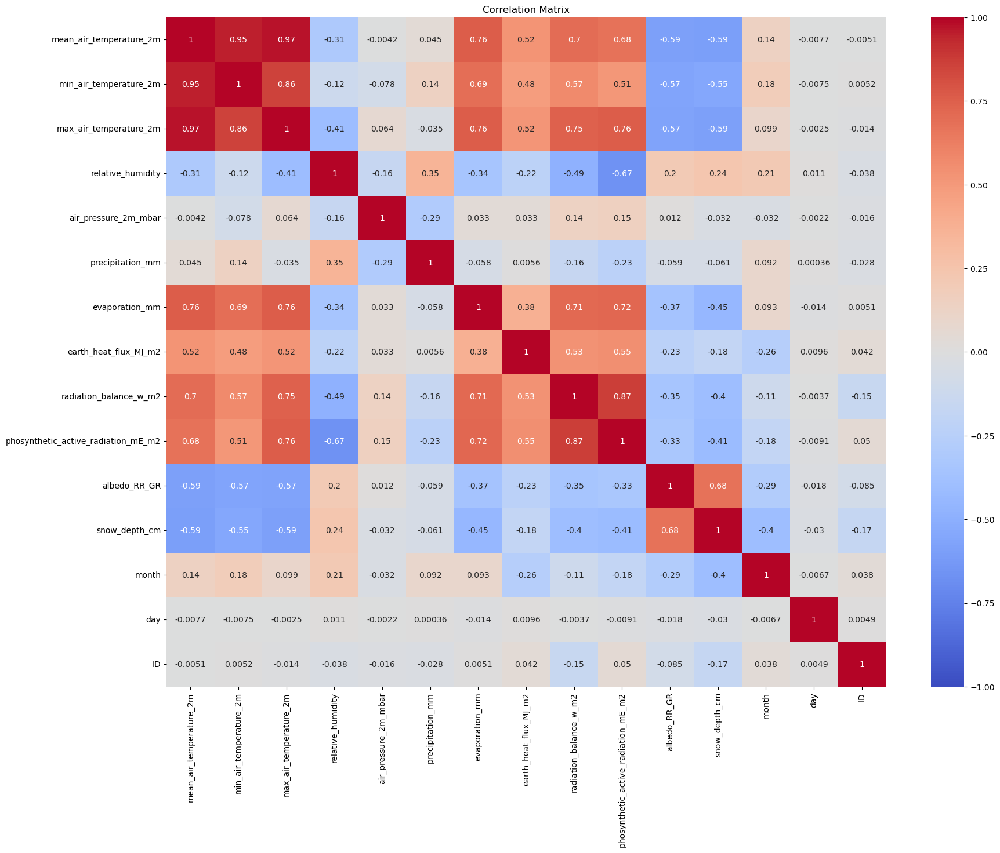

Highly correlated pairs (above threshold):
('mean_air_temperature_2m', 'max_air_temperature_2m')
Removed features: {'max_air_temperature_2m'}
Shape of the reduced dataset: (7366, 14)


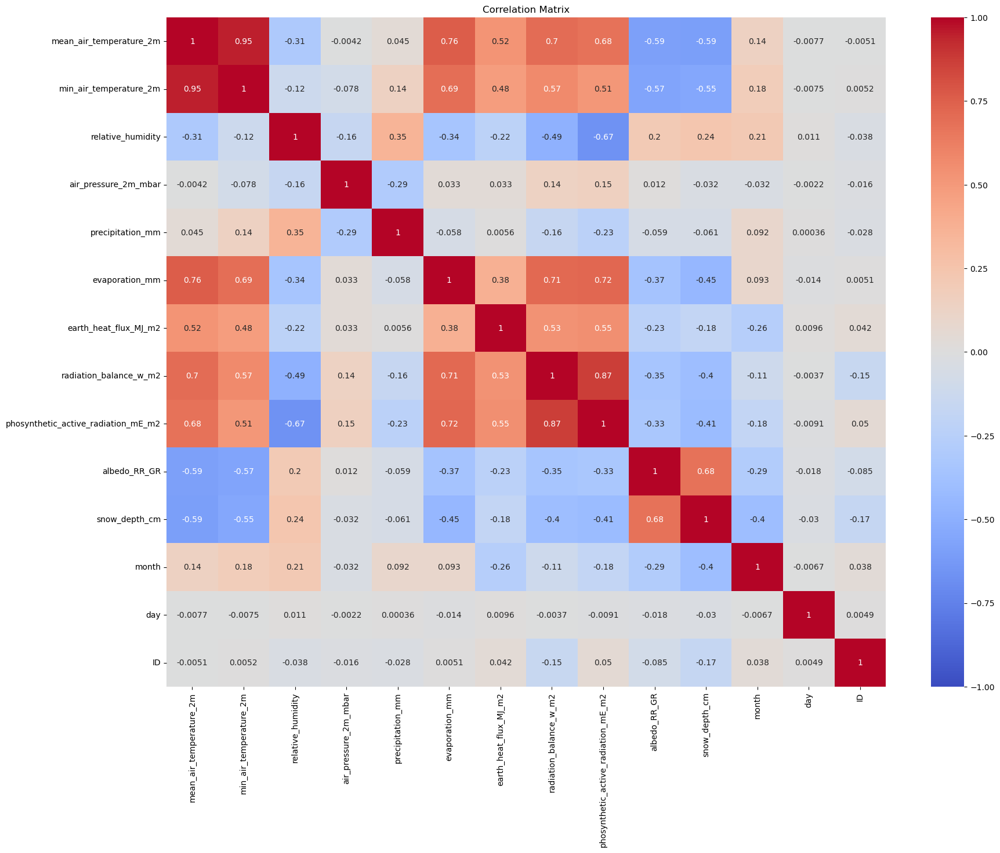

Removing feature 'const' with VIF: 9332.054739870095
Removing feature 'air_pressure_2m_mbar' with VIF: 133.3733020686558
Removing feature 'mean_air_temperature_2m' with VIF: 42.20182442854143
Final VIF data:
                                feature        VIF
0                min_air_temperature_2m   3.883785
1                     relative_humidity  19.815997
2                      precipitation_mm   1.584510
3                        evaporation_mm   5.522236
4                 earth_heat_flux_MJ_m2   1.963418
5                radiation_balance_w_m2   6.666393
6   phosynthetic_active_radiation_mE_m2  11.087224
7                          albedo_RR_GR   8.382338
8                         snow_depth_cm   3.223136
9                                 month   8.009257
10                                  day   4.071695


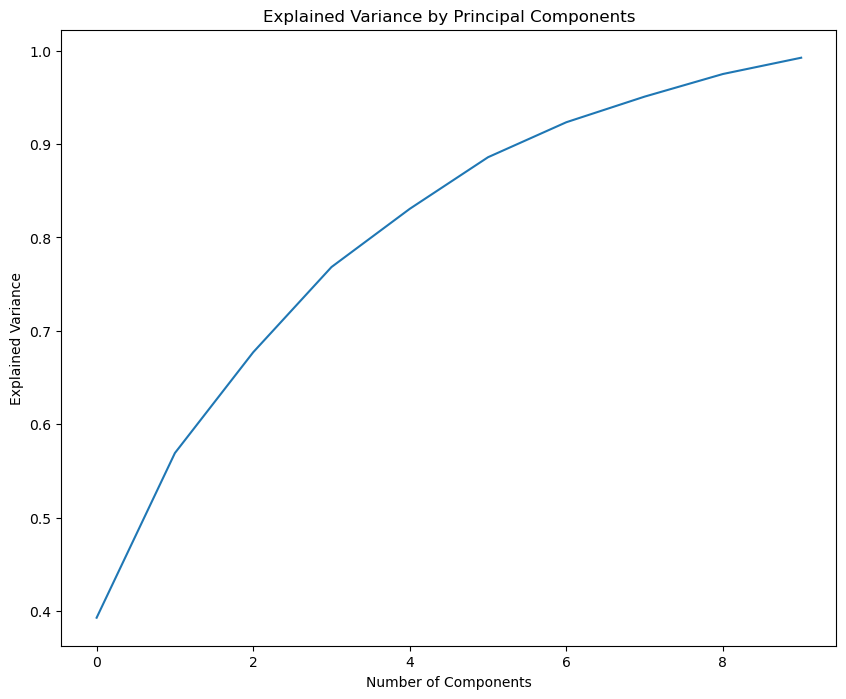

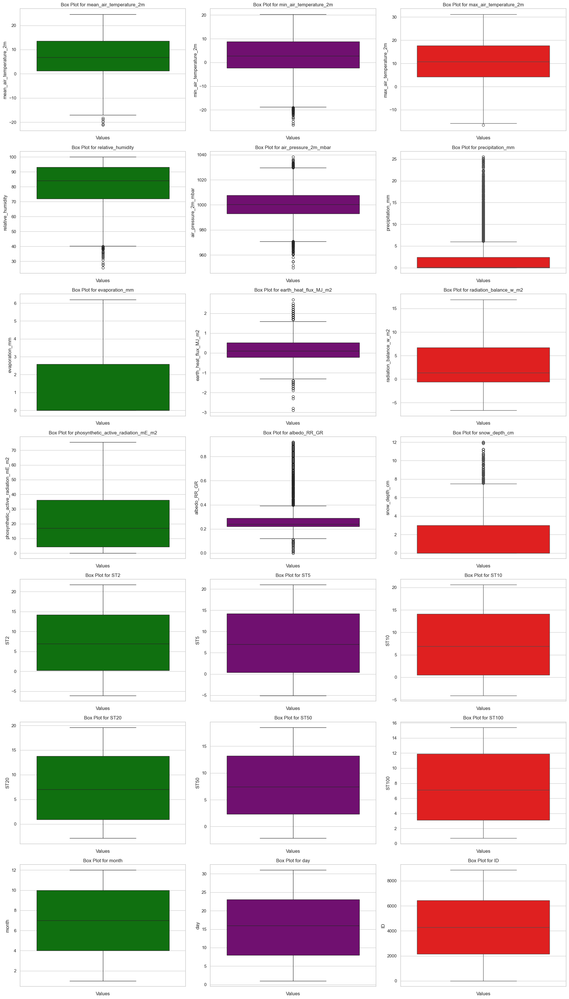

In [279]:
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
import seaborn as sns

# Calculate the covariance matrix for target ST100
ST2_dataset_correlation = ST2_clean_dataset_denormalized.drop(['ST100', 'ST50','ST20','ST10','ST5','ST2'], axis=1)
ST2_covariance_matrix = ST2_dataset_correlation.cov()

# Calculate the correlation matrix
ST2_correlation_matrix = ST2_dataset_correlation.corr()

# Visualize the correlation matrix
plt.figure(figsize=(20, 15))
sns.heatmap(ST2_correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.savefig("images/ST2_denormalized_before_correlation_matrix.png")
plt.show()

# Set the threshold
threshold = 0.95
# Find pairs of features with correlation above the threshold
highly_correlated = np.where(np.abs(ST2_correlation_matrix) > threshold)
highly_correlated_pairs = [(ST2_correlation_matrix.index[x], ST2_correlation_matrix.columns[y]) 
                           for x, y in zip(*highly_correlated) if x != y and x < y]

print("Highly correlated pairs (above threshold):")
for pair in highly_correlated_pairs:
    print(pair)
# Example: Removing one feature from each highly correlated pair
features_to_remove = set()
for pair in highly_correlated_pairs:
    features_to_remove.add(pair[1])  # You can choose to remove pair[0] or pair[1]

# Drop the features from the dataframe
ST2_dataset_denormalized_outlier_filtered_uncorrelated = ST2_dataset_correlation.drop(columns=features_to_remove)

print(f"Removed features: {features_to_remove}")
print("Shape of the reduced dataset:", ST2_dataset_denormalized_outlier_filtered_uncorrelated.shape)

# After removing the correlated features
# Calculate the correlation matrix
ST2_correlation_matrix_new = ST2_dataset_denormalized_outlier_filtered_uncorrelated.corr()

# Visualize the correlation matrix
plt.figure(figsize=(20, 15))
sns.heatmap(ST2_correlation_matrix_new, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.savefig("images/ST2_denormalized_after_correlation_matrix.png")
plt.show()

# Assuming dataset_denormalized_outlier_filtered is your DataFrame
ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = ST2_dataset_denormalized_outlier_filtered_uncorrelated.copy()

# Add a constant term for the intercept
ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = sm.add_constant(ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif)
ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop('ID', axis=1, inplace=True)

# Function to calculate VIF
def calculate_vif(data):
    vif_data = pd.DataFrame()
    vif_data["feature"] = data.columns
    vif_data["VIF"] = [variance_inflation_factor(data.values, i) for i in range(data.shape[1])]
    return vif_data

# Iteratively remove features with VIF above the threshold
def remove_high_vif_features(data, threshold=40.0):
    while True:
        vif_data = calculate_vif(data)
        max_vif = vif_data['VIF'].max()
        if max_vif > threshold:
            # Identify the feature with the highest VIF
            feature_to_remove = vif_data.sort_values('VIF', ascending=False)['feature'].iloc[0]
            print(f"Removing feature '{feature_to_remove}' with VIF: {max_vif}")
            data = data.drop(columns=[feature_to_remove])
        else:
            break
    return data, vif_data

# Remove high VIF features
ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif, ST2_final_vif_data = remove_high_vif_features(ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif)

print("Final VIF data:")
print(ST2_final_vif_data)
ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ID'] = ST2_clean_dataset_denormalized['ID']
ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ST2'] = ST2_clean_dataset_denormalized['ST2']
ST2_dataset_denormalized_outlier_filtered_uncorrelated['ID'] = ST2_clean_dataset_denormalized['ID']
ST2_dataset_denormalized_outlier_filtered_uncorrelated['ST2'] = ST2_clean_dataset_denormalized['ST2']
# Remove the constant term before creating the final DataFrame
if 'const' in ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.columns:
    ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop(columns=['const'])

# Store the 'ID' and 'ST2' columns with their corresponding index before PCA
ID_index_mapping = ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ID']
ST2_index_mapping = ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ST2']

# Assume X is your feature dataframe
ST2_X_pca = ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop(['ST2', 'ID'], axis=1)

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(ST2_X_pca)

# Apply PCA
pca = PCA(n_components=0.99)  # Choose the number of components
principal_components = pca.fit_transform(X_scaled)

# Create a DataFrame with the principal components
ST2_pca_df = pd.DataFrame(data=principal_components, columns=[f"PC{i}" for i in range(principal_components.shape[1])])

# Merge PCA DataFrame with original DataFrame to maintain original index order
ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca = pd.merge(ID_index_mapping, ST2_index_mapping, left_index=True, right_index=True)
ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca = pd.merge(ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca, ST2_pca_df, left_index=True, right_index=True)

# Plot the explained variance
plt.figure(figsize=(10,8))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Explained Variance')
plt.title('Explained Variance by Principal Components')
plt.savefig('images/ST2_PCA_analysis.png')
plt.show()

# Plot the Box Plot of all features
# Set the style of the visualization
sns.set(style="whitegrid")
# Number of features in the DataFrame
num_features = dataset_denormalized_outlier_filtered.shape[1]
# Calculate the number of rows needed to plot all features in 3 columns
num_cols = 3
num_rows = math.ceil(num_features / num_cols)
# Set up the matplotlib figure
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(20, num_rows * 5))
# Flatten the axes array for easy iteration
axes = axes.flatten()
# Define colors for each column
colors = ['green', 'purple', 'red']
# Create a Box Plot for each feature
for i, column in enumerate(dataset_denormalized_outlier_filtered.columns):
    col_index = i % num_cols  # Determine the column index (0, 1, or 2)
    sns.boxplot(data=dataset_denormalized_outlier_filtered[column], ax=axes[i], color=colors[col_index])
    axes[i].set_title(f'Box Plot for {column}')
    axes[i].set_xlabel('Values')
# Remove any empty subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])
# Adjust layout
plt.tight_layout()
# Show the plot
plt.show()

In [280]:
ST2_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca

,ID,ST2,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9
0,1,-2.000000e-01,-3.348767,-1.584692,1.026901,-1.648809,0.404218,0.378386,-0.383700,-1.308352,-0.509557,0.075000
1,2,-1.000000e-01,-3.337611,-2.051418,0.958286,-1.557335,0.331169,0.471703,-0.233233,-0.286230,-0.842079,-0.102185
2,3,-1.000000e-01,-2.542509,-0.546745,2.004989,-1.399285,-1.121891,0.831867,-0.791476,0.475538,0.120719,0.131039
3,4,-8.881784e-16,-2.503160,-1.916533,0.206291,-1.254766,-1.124209,0.382725,-0.451730,1.082206,-0.820602,0.201615
4,5,-8.881784e-16,-2.470671,-0.948331,0.777255,-1.125664,-0.708613,-0.859415,-1.838218,0.381253,1.148074,0.534614
...,...,...,...,...,...,...,...,...,...,...,...,...
7361,8852,1.600000e+00,-0.533394,0.607765,1.667218,1.528884,-1.550125,-0.051433,-0.073816,-0.460169,-0.237306,0.160913
7362,8853,2.900000e+00,-0.363950,0.355637,1.132078,1.669416,-1.125535,-1.310145,-0.390449,-0.432392,-0.450969,0.070686
7363,8854,3.500000e+00,-0.893562,-0.249975,1.285808,1.724720,-0.638007,-1.344323,-0.682522,0.372509,0.336641,0.069117
7364,8855,4.200000e+00,-1.123718,-0.190187,1.288648,1.834399,-0.758220,-1.067556,-0.662111,0.401439,0.389264,0.213193


### Option 1:  Dataset used is after correlation analysis for ST2

====================CatBoost The Evaluation Metrics Results For ST2 Denormalized =======================

{'Training Set R^2 Score': 0.9916501519327621, 'Validation Set R^2 Score': 0.9816091711111307, 'Training Set MAE': 0.45260066684315853, 'Validation Set MAE': 0.6636286468468421, 'Training Set MSE': 0.346227808680332, 'Validation Set MSE': 0.7913868945978504, 'Training Set RMSE': 0.051667449342856095, 'Validation Set RMSE': 0.8895992887799822, 'Validation Set Median Absolute Error': 0.5037135178927197, 'Validation Set MA Percentage Error': 66.13646097293498, 'Validation Set Max Error': 5.204680208479702}

====================Random Forest The Evaluation Metrics Results For ST2 Denormalized =======================

{'Training Set R^2 Score': 1.0, 'Validation Set R^2 Score': 0.9793905682429789, 'Training Set MAE': 2.013002554449062e-14, 'Validation Set MAE': 0.6858116393244993, 'Training Set MSE': 6.830589117806769e-28, 'Validation Set MSE': 0.8868569381060691, 'Training Set RMSE': 1.

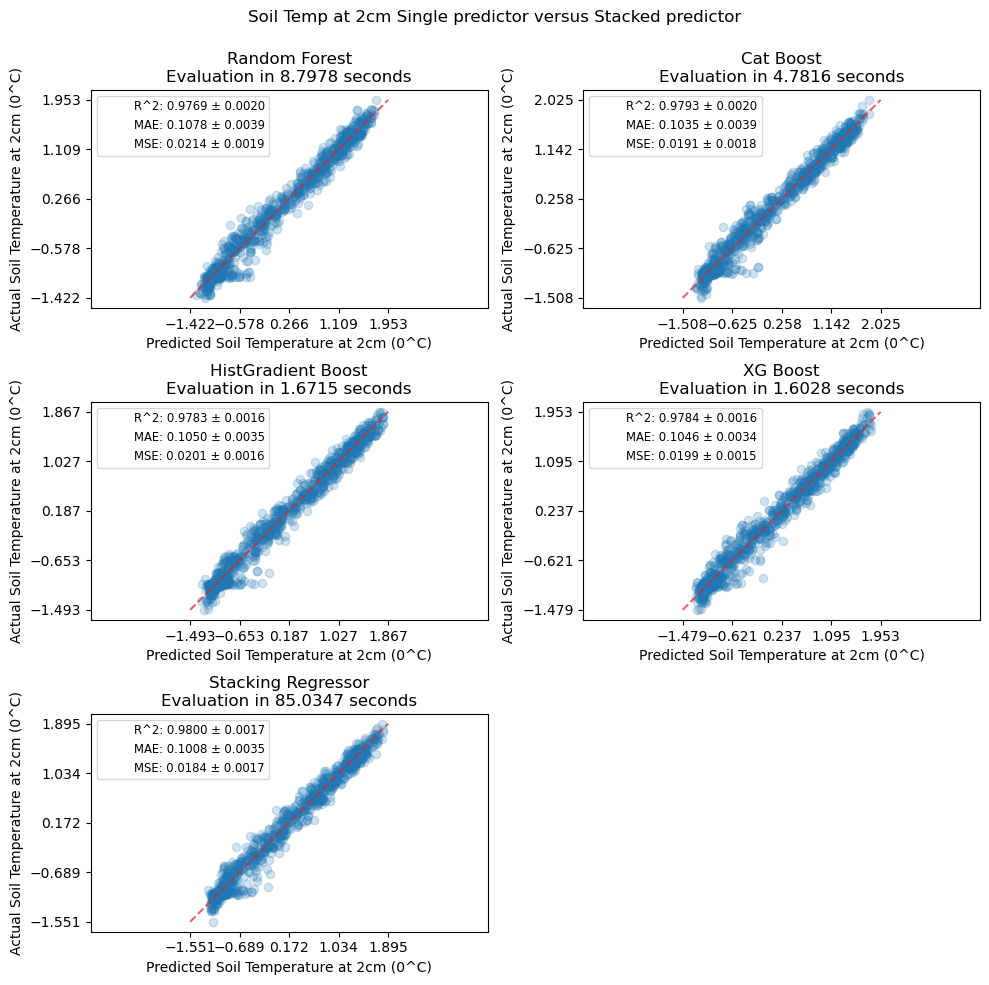

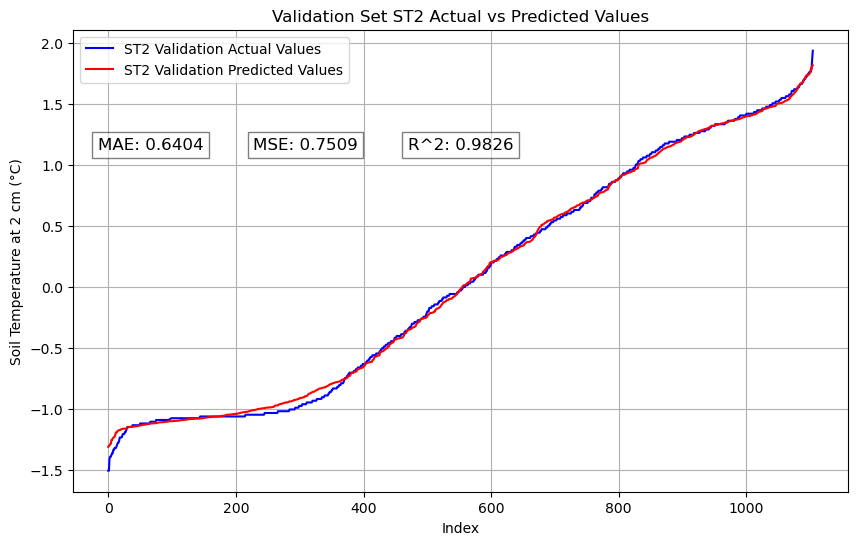

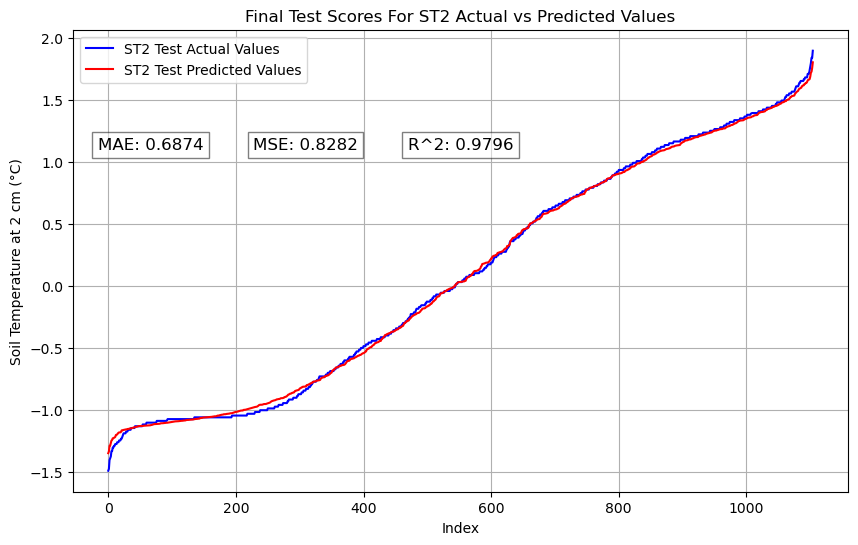

CPU times: total: 1min 47s
Wall time: 3min 56s


In [146]:
%%time
import numpy as np
from sklearn.linear_model import LassoCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.metrics import PredictionErrorDisplay
from sklearn.model_selection import cross_val_predict, cross_validate
from catboost import CatBoostRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, root_mean_squared_error, mean_absolute_error
import time

np.random.seed(42)
  
# Create function to evaluate model on few different levels
def show_scores(model, X_train, X_valid, Y_train, Y_valid, std, target='ST2', model_name='RF'):
    """
    Calculates and shows the different sklearn evaluation metrics
        
    Parameters:
        model: the model fitted.
        X_train: the input training set.
        X_valid: the input validation or test set.
        Y_train: the target training set.
        Y_valid: the target validation or test set.
            
    Returns:
        scores: the dictionary of the calculated sklearn metrics for train and valid sets.
    """
    
    train_preds = model.predict(X_train)
    val_preds = model.predict(X_valid)
    scores = {
              "Training Set R^2 Score": r2_score(Y_train, train_preds),
              "Validation Set R^2 Score":r2_score(Y_valid, val_preds),
              "Training Set MAE": mean_absolute_error(Y_train, train_preds)* std,
              "Validation Set MAE": mean_absolute_error(Y_valid, val_preds)* std,             
              "Training Set MSE": mean_squared_error(Y_train, train_preds)* std* std,
              "Validation Set MSE": mean_squared_error(Y_valid, val_preds)* std* std,
              "Training Set RMSE": mean_squared_error(Y_train, train_preds)* std,
              "Validation Set RMSE": root_mean_squared_error(Y_valid, val_preds)* std,
              # "Training Set Median Absolute Error": median_absolute_error(Y_train, train_preds),
              "Validation Set Median Absolute Error": median_absolute_error(Y_valid, val_preds)* std,
              # "Training Set MA Percentage Error": mean_absolute_percentage_error(Y_train, train_preds),
              "Validation Set MA Percentage Error": mean_absolute_percentage_error(Y_valid, val_preds)* std,
              # "Training Set Max Error": max_error(Y_train, train_preds),
              "Validation Set Max Error": max_error(Y_valid, val_preds)* std,
              # "Training Set Explained Variance Score": explained_variance_score(Y_train, train_preds),
              # "Validation Set Explained Variance Score": explained_variance_score(Y_valid, val_preds)
    }
    # Convert the dictionary to a DataFrame
    df = pd.DataFrame(list(scores.items()), columns=['Metric', 'Value'])    
    # Export the DataFrame to an Excel file
    df.to_excel(f'data/results/{target}_{model_name}_scores_after_vif_40.xlsx', index=False)
    return scores

# Define a function that takes test set and validation sets as input and generates prediction curve and returns test set prediction data 
def predict_plot(model, ST_X_test, ST_Y_test, ST_X_validation, ST_Y_validation, name, std):
    
    # Predict the validation set
    ST_Y_validation_preds = model.predict(ST_X_validation)
    # Change validation predictions to pandas series
    ST_Y_validation_preds_series = pd.Series(ST_Y_validation_preds)
    # Make the original and predicted series to have the same index
    ST_Y_validation_preds_series.index =ST_Y_validation.index
    # Sort Y_valid and Y_valid_preds in ascending order and reset indices
    ST_Y_validation_sorted = ST_Y_validation.sort_values().reset_index(drop=True)
    ST_Y_validation_preds_sorted = ST_Y_validation_preds_series[ST_Y_validation.index].sort_values().reset_index(drop=True)
  
    # Calculate mean absolute error
    ST_valid_mae = mean_absolute_error(ST_Y_validation,ST_Y_validation_preds) * std
    # Calculate mean squared error
    ST_valid_mse = mean_squared_error(ST_Y_validation,ST_Y_validation_preds) * std * std
    # Calculate the R^2 score
    ST_valid_r2_score = r2_score(ST_Y_validation,ST_Y_validation_preds)

    # Predict the test set which is forecast data
    ST_Y_test_preds = model.predict(ST_X_test)
    # Changes the predicted array values to pandas series
    ST_Y_test_preds_series = pd.Series(ST_Y_test_preds, name=name) 
    ST_Y_test_preds_series.index =ST_Y_test.index
    # Sort Y_valid and Y_valid_preds in ascending order and reset indices
    ST_Y_test_sorted = ST_Y_test.sort_values().reset_index(drop=True)
    ST_Y_test_preds_sorted = ST_Y_test_preds_series[ST_Y_test.index].sort_values().reset_index(drop=True)
    
    # Calculate mean absolute error
    ST_test_mae = mean_absolute_error(ST_Y_test,ST_Y_test_preds) * std
    # Calculate mean squared error
    ST_test_mse = mean_squared_error(ST_Y_test,ST_Y_test_preds) * std * std
    # Calculate the R^2 score
    ST_test_r2_score = r2_score(ST_Y_test,ST_Y_test_preds)
    
    # Convert the Series to a DataFrame to return as dataframe
    ST_Y_test_preds_df = ST_Y_test_preds_series.to_frame()
    ST_Y_test_preds_df.index =  ST_X_test.index
    
    # Plot the validation sorted values
    plt.figure(figsize=(10, 6))
    plt.plot(ST_Y_validation_sorted.index,ST_Y_validation_sorted, color='blue', label=f'{name} Validation Actual Values')
    plt.plot(ST_Y_validation_preds_sorted.index,ST_Y_validation_preds_sorted, color='red', label=f'{name} Validation Predicted Values')
    # Display the mean absolute error as text annotation
    plt.text(0.1, 0.75, f'MAE: {ST_valid_mae:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.text(0.3, 0.75, f'MSE: {ST_valid_mse:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.text(0.5, 0.75, f'R^2: {ST_valid_r2_score:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.xlabel('Index')
    plt.ylabel(f'Soil Temperature at 2 cm (°C)')
    plt.title(f'Validation Set {name} Actual vs Predicted Values')
    plt.legend()
    plt.grid(True)
    plt.savefig(f'data/results/{name}_valid_set_predicted_vs_actual_values_line_plot.png')  # Save as PNG format
    plt.show()
    
    # Plot the test sorted values
    plt.figure(figsize=(10, 6))
    plt.plot(ST_Y_test_sorted.index,ST_Y_test_sorted, color='blue', label=f'{name} Test Actual Values')
    plt.plot(ST_Y_test_preds_sorted.index,ST_Y_test_preds_sorted, color='red', label=f'{name} Test Predicted Values')
    # Display the metrics as text annotation
    plt.text(0.1, 0.75, f'MAE: {ST_test_mae:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.text(0.3, 0.75, f'MSE: {ST_test_mse:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.text(0.5, 0.75, f'R^2: {ST_test_r2_score:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.xlabel('Index')
    plt.ylabel(f'Soil Temperature at 2 cm (°C)')
    plt.title(f'Final Test Scores For {name} Actual vs Predicted Values')
    plt.legend()
    plt.grid(True)
    plt.savefig(f'data/results/{name}_test_set_predicted_vs_actual_values_line_plot.png')  # Save as PNG format
    plt.show()    
    return ST_Y_test_preds_df
    
# Let us shuffle the entire dataset so that it is randomly arranged
# dataset_shuffled = std_dev.sample(frac=1)
dataset_shuffled = ST2_clean_dataset_normalized.sample(frac=1)
std_dev = ST2_clean_dataset_denormalized['ST2'].std()
# Split the dataset into features and target
many_features_dropped = ['ST2','ST5','ST10','ST20','ST50','ST100','ID']
soil_features_dropped = ['ST2','ST5','ST10','ST20','ST50','ST100','ID']
uncorrelated_dropped = ['ST2','ID']
# ST2_X = dataset_shuffled.drop(many_features_dropped, axis=1)
ST2_X = dataset_shuffled.drop(soil_features_dropped, axis=1)
ST2_Y = dataset_shuffled['ST2']

# Split the dataset in to features (independent variables) and labels(dependent variable = target_soil_temperature_2cm ).
# Then split into train, validation and test sets
train_split = round(0.7*len(dataset_shuffled)) # 70% for train set
valid_split = round(train_split + 0.15*len(dataset_shuffled))
ST2_X_train, ST2_Y_train = ST2_X[:train_split], ST2_Y[:train_split]
ST2_X_valid, ST2_Y_valid =ST2_X[train_split:valid_split], ST2_Y[train_split:valid_split]
ST2_X_test, ST2_Y_test = ST2_X[valid_split:], ST2_Y[valid_split:]

# A. CatBoostRegressor (CB)
# Create CB model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST2_cb_model_stack = CatBoostRegressor(iterations=500,
                                learning_rate=0.1,
                                depth=6,
                                l2_leaf_reg=3,
                                loss_function='RMSE',
                                silent=True,
                                random_state=42)
# Fit the model for ST2 to start with
ST2_cb_model_stack.fit(ST2_X_train, ST2_Y_train, eval_set=(ST2_X_valid, ST2_Y_valid), early_stopping_rounds=100)
# Show the scoring metrics for this model
print("====================CatBoost The Evaluation Metrics Results For ST2 Denormalized =======================\n")

print(show_scores(ST2_cb_model_stack, ST2_X_train, ST2_X_valid, ST2_Y_train, ST2_Y_valid, std_dev,'ST2', 'CB'))
print("==================================================================================================\n")

# B. RandomForestRegressor
# Create RF model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST2_rf_model_stack = RandomForestRegressor(n_estimators=300, 
                                         min_samples_leaf=1,
                                         min_samples_split=2,
                                         max_features='sqrt',
                                         max_depth=None,
                                         bootstrap=False,
                                         random_state=42)
# Fit the model for ST2 to start with
ST2_rf_model_stack.fit(ST2_X_train, ST2_Y_train)
# Show the scoring metrics for this model
print("====================Random Forest The Evaluation Metrics Results For ST2 Denormalized =======================\n")

print(show_scores(ST2_rf_model_stack, ST2_X_train, ST2_X_valid, ST2_Y_train, ST2_Y_valid, std_dev,'ST2', 'RF'))
print("==================================================================================================\n")

# C. Histogram Based Gradient Boosting Regressor
# Setup random seed
np.random.seed(42)
# Create Ridge model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST2_gbr_model_stack = HistGradientBoostingRegressor(learning_rate=0.1, 
                                              max_iter=300, 
                                              max_leaf_nodes=41,
                                              random_state=42)
# Fit the ST2 model for soil temp at 100 cm
ST2_gbr_model_stack.fit(ST2_X_train, ST2_Y_train)
# Show the scoring metrics for this model
print("====================The Histogram-Based Gradient Boosting Evaluation Metrics Results For ST2 Denormalized =======================\n")
print(show_scores(ST2_gbr_model_stack, ST2_X_train, ST2_X_valid, ST2_Y_train, ST2_Y_valid, std_dev,'ST2', 'HGB'))
print("====================================================================================================\n")

# D. XGBoost Regressor
# Setup random seed
np.random.seed(42)
# Create XGBoost for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST2_xgb_model_stack = XGBRegressor(objective='reg:squarederror',
                             learning_rate=0.1, 
                             max_depth=6, 
                             n_estimators=200, 
                             subsample=0.8, 
                             random_state=42)
# Fit the ST2 model for soil temp at 100 cm
ST2_xgb_model_stack.fit(ST2_X_train, ST2_Y_train)
# Show the scoring metrics for this model
print("====================The XGBoost Evaluation Metrics Results For ST2 Denormalized =======================\n")
print(show_scores(ST2_xgb_model_stack, ST2_X_train, ST2_X_valid, ST2_Y_train, ST2_Y_valid, std_dev,'ST2', 'XGB'))
print("====================================================================================================\n")


# E. AdaBoostRegressor 
# Setup random seed
np.random.seed(42)
# Create AdaBoost Regressor for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST2_adb_model_stack = AdaBoostRegressor(learning_rate=0.1, 
                                  n_estimators=100,
                                  random_state=42)
# Fit the ST2 model for soil temp at 100 cm
ST2_adb_model_stack.fit(ST2_X_train, ST2_Y_train)
# Show the scoring metrics for this model
print("====================The AdaBoost Regressor Evaluation Metrics Results For ST2 Denormalized =======================\n")
print(show_scores(ST2_adb_model_stack, ST2_X_train, ST2_X_valid, ST2_Y_train, ST2_Y_valid, std_dev,'ST2', 'ADB'))
print("====================================================================================================\n")


# F. Ridge Regressor
# Setup random seed
np.random.seed(42)
# Create Ridge model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST2_rg_model_stack = Ridge(random_state=42)
# Fit the ST2 model for soil temp at 100 cm
ST2_rg_model_stack.fit(ST2_X_train, ST2_Y_train)
# Show the scoring metrics for this model
print("====================The Ridge Regressor Evaluation Metrics Results For ST2 Denormalized =======================\n")
print(show_scores(ST2_rg_model_stack, ST2_X_train, ST2_X_valid, ST2_Y_train, ST2_Y_valid, std_dev,'ST2', 'RR'))
print("====================================================================================================\n")


# G. Lasso Regressor
# Set up a radom seed
np.random.seed(42)
# Create Lasso model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST2_la_model_stack = Lasso(random_state=42)
# Fit the ST2 model for soil temp at 100cm
ST2_la_model_stack.fit(ST2_X_train, ST2_Y_train)
# Show the scoring metrics for this model
print("====================The Lasso Regressor Evaluation Metrics Results For ST2 Denormalized =======================\n")
print(show_scores(ST2_la_model_stack, ST2_X_train, ST2_X_valid, ST2_Y_train, ST2_Y_valid, std_dev,'ST2', 'LA'))
print("====================================================================================================\n")

# H. ElasticNet Regressor
# Set up a radom seed
np.random.seed(42)
# Create ElasticNet model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST2_en_model_stack = ElasticNet(random_state=42)
# Fit the ST2 model for soil temp at 100cm
ST2_en_model_stack.fit(ST2_X_train, ST2_Y_train)
# Show the scoring metrics for this model
print("====================The ElasticNet Regressor Evaluation Metrics Results For ST2 Denormalized =======================\n")
print(show_scores(ST2_en_model_stack, ST2_X_train, ST2_X_valid, ST2_Y_train, ST2_Y_valid, std_dev,'ST2', 'EN'))
print("=========================================================================================================\n")

# I. SVR-L Regressor
# Set up a radom seed
np.random.seed(42)
# Create SVR-L model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST2_svrl_model_stack = SVR(kernel='linear')
# Fit the ST2 model for soil temp at 100cm
ST2_svrl_model_stack.fit(ST2_X_train, ST2_Y_train)
# Show the scoring metrics for this model
print("====================The SVR with linear model Evaluation Metrics Results For ST2 Denormalized =======================\n")
print(show_scores(ST2_svrl_model_stack, ST2_X_train, ST2_X_valid, ST2_Y_train, ST2_Y_valid, std_dev,'ST2', 'SVR-L'))
print("==========================================================================================================\n")

# J. SVR-R Regressor
# Set up a radom seed
np.random.seed(42)
# Create SVR-R model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST2_svrr_model_stack = SVR(kernel='rbf')
# Fit the ST2 model for soil temp at 100cm
ST2_svrr_model_stack.fit(ST2_X_train, ST2_Y_train)
# Show the scoring metrics for this model
print("====================The SVR with rfb model Evaluation Metrics Results For ST2 Denormalized =======================\n")
print(show_scores(ST2_svrr_model_stack, ST2_X_train, ST2_X_valid, ST2_Y_train, ST2_Y_valid, std_dev,'ST2', 'SVR-R'))
print("=======================================================================================================\n")


# Stack of predictors on a single data set
ST2_rf_regressor = RandomForestRegressor(n_estimators=300, 
                                     min_samples_leaf=1,
                                     min_samples_split=2,
                                     max_features='sqrt',
                                     max_depth=None,
                                     bootstrap=False,
                                     random_state=42)
ST2_gbdt_regresssor = HistGradientBoostingRegressor(learning_rate=0.1, 
                                              max_iter=300, 
                                              max_leaf_nodes=41,
                                              random_state=42)
ST2_xgb_model = XGBRegressor(objective='reg:squarederror',
                             learning_rate=0.1, 
                             max_depth=6, 
                             n_estimators=200, 
                             subsample=0.8, 
                             random_state=42)
ST2_cb_regressor = CatBoostRegressor(iterations=500,
                                learning_rate=0.1,
                                depth=6,
                                l2_leaf_reg=3,
                                loss_function='RMSE',
                                silent=True,
                                random_state=42)
ST2_adb_regressor = AdaBoostRegressor(learning_rate=0.1, 
                                  n_estimators=100,
                                  random_state=42)

estimators = [
    ("Random Forest", ST2_rf_regressor),
    ("Cat Boost", ST2_cb_regressor),
    ("HistGradient Boost", ST2_gbdt_regresssor),
    ("XG Boost", ST2_xgb_model)
]
ST2_stacking_regressor = StackingRegressor(estimators=estimators, final_estimator=RidgeCV())

# Measure and plot the results
fig, axs = plt.subplots(3, 2, figsize=(10, 10))
axs = np.ravel(axs)

for ax, (name, est) in zip(axs, estimators + [("Stacking Regressor", ST2_stacking_regressor)]):
    scorers = {"R^2": "r2", "MAE": "neg_mean_absolute_error", "MSE":"neg_mean_squared_error"}

    start_time = time.time()
    scores = cross_validate(est, ST2_X_train, ST2_Y_train, scoring=list(scorers.values()), n_jobs=-1, verbose=0)
    elapsed_time = time.time() - start_time

    y_pred = cross_val_predict(est, ST2_X_train, ST2_Y_train, n_jobs=-1, verbose=0)
    scores = {
        key: (
            f"{np.abs(np.mean(scores[f'test_{value}'])):.4f} ± "
            f"{np.std(scores[f'test_{value}']):.4f}"
        )
        for key, value in scorers.items()
    }

    display = PredictionErrorDisplay.from_predictions(
        y_true=ST2_Y_train,
        y_pred=y_pred,
        kind="actual_vs_predicted",
        ax=ax,
        scatter_kwargs={"alpha": 0.2, "color": "tab:blue"},
        line_kwargs={"color": "tab:red"},
    )
    ax.set_title(f"{name}\nEvaluation in {elapsed_time:.4f} seconds")
    # Set custom x-label and y-label
    ax.set_xlabel("Predicted Soil Temperature at 2cm (0^C)")
    ax.set_ylabel("Actual Soil Temperature at 2cm (0^C)")
    for name, score in scores.items():
        ax.plot([], [], " ", label=f"{name}: {score}")
    ax.legend(loc="best", fontsize='small')

# Hide any unused subplots
for i in range(len(estimators)+1, len(axs)):
    fig.delaxes(axs[i])

plt.suptitle("Soil Temp at 2cm Single predictor versus Stacked predictor")
plt.tight_layout()
plt.subplots_adjust(top=0.9)
plt.savefig('data/results/ST2_stacking_regressors_predicted_actual_values.png')  # Save as PNG format
plt.show()

# Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
ST2_stacking_regressor.fit(ST2_X_train, ST2_Y_train)
ST2_Y_test_preds_df = predict_plot(ST2_stacking_regressor, ST2_X_test, ST2_Y_test, ST2_X_valid, ST2_Y_valid, 'ST2', std_dev)

### Cross-validation stability check of the stacking regressor for ST2

Cross-Validation Scores (MSE): [0.01646148 0.01795933 0.01876197 0.01799636 0.01708607 0.01984924
 0.01802905 0.01733042 0.01597536 0.01846188]
Mean CV Score (MSE): 0.017791114149564222
Standard Deviation of CV Scores: 0.0010737604963860345


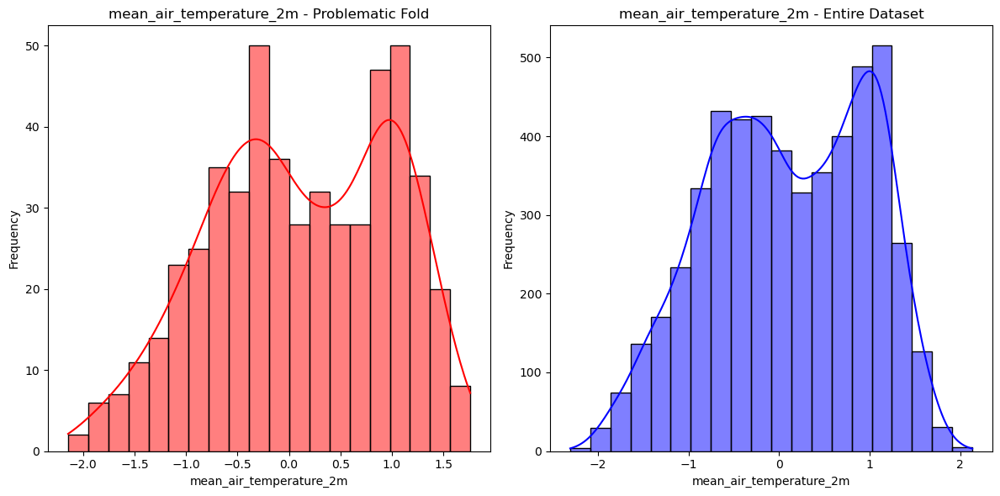

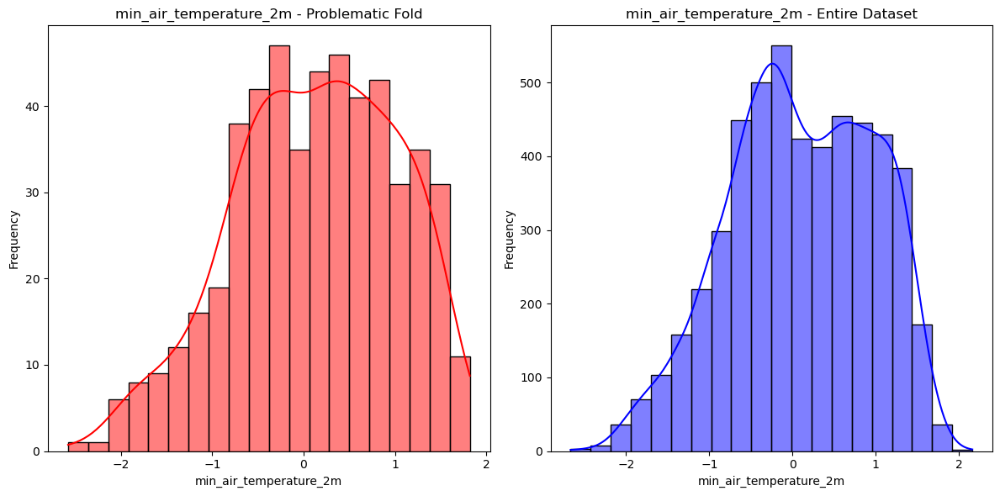

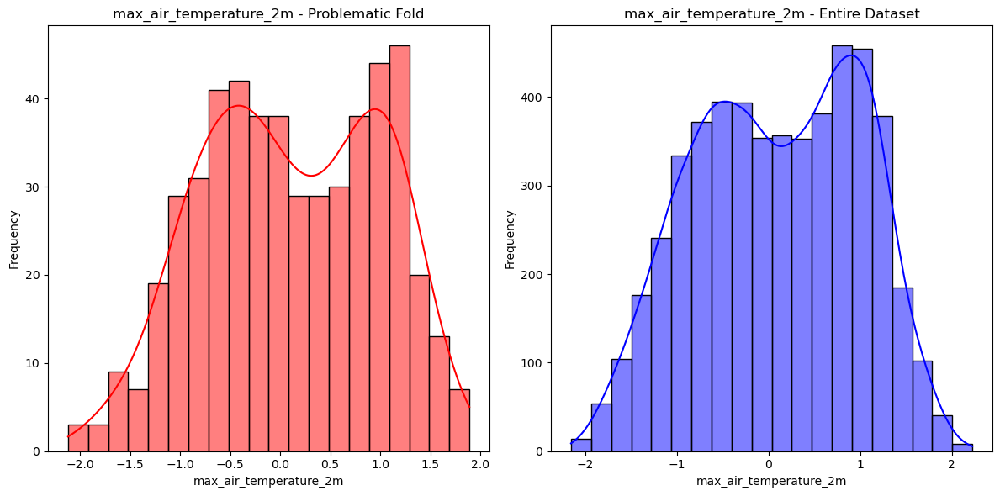

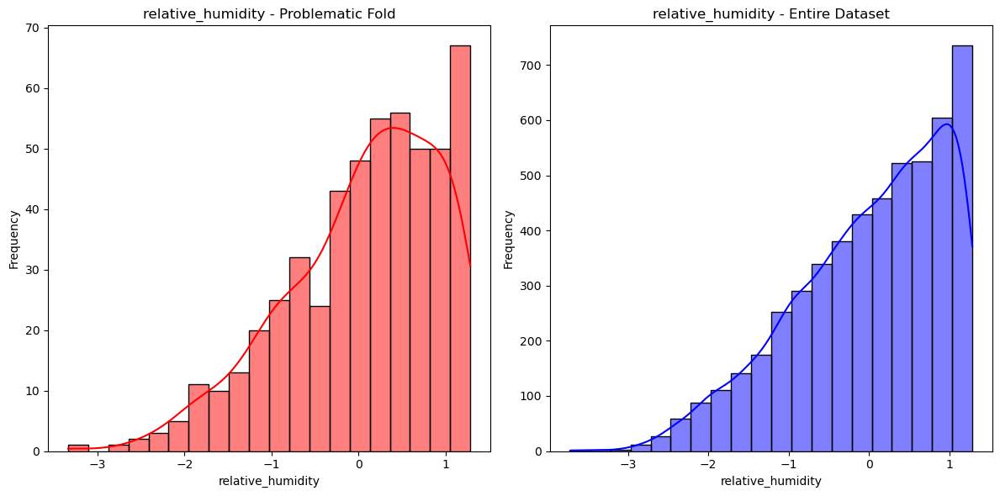

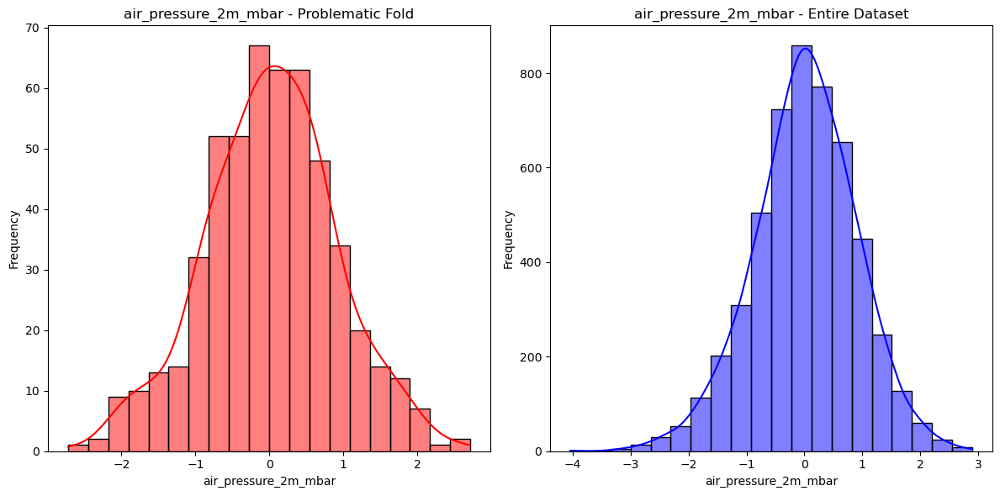

...

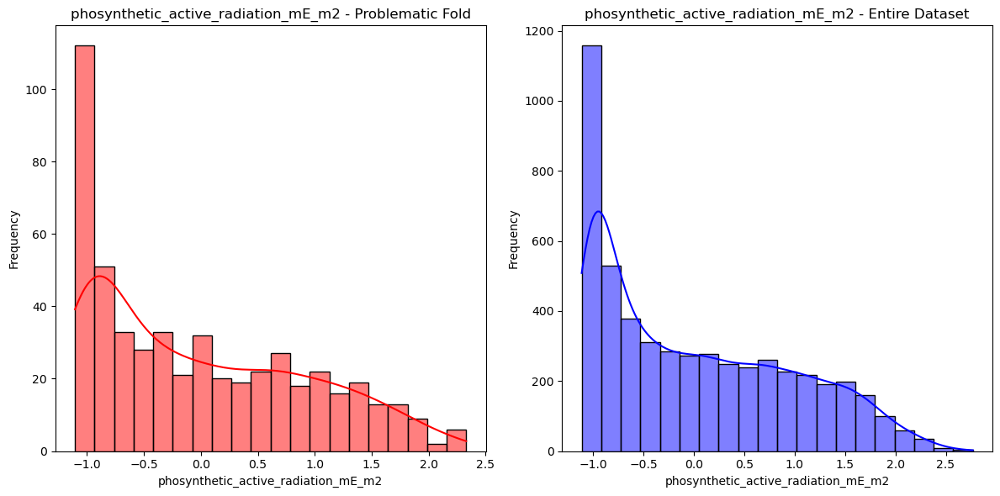

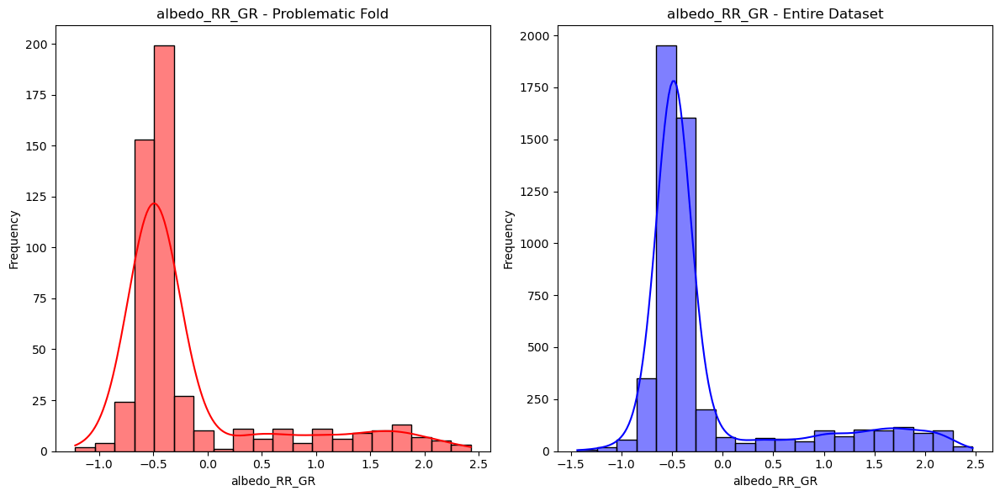

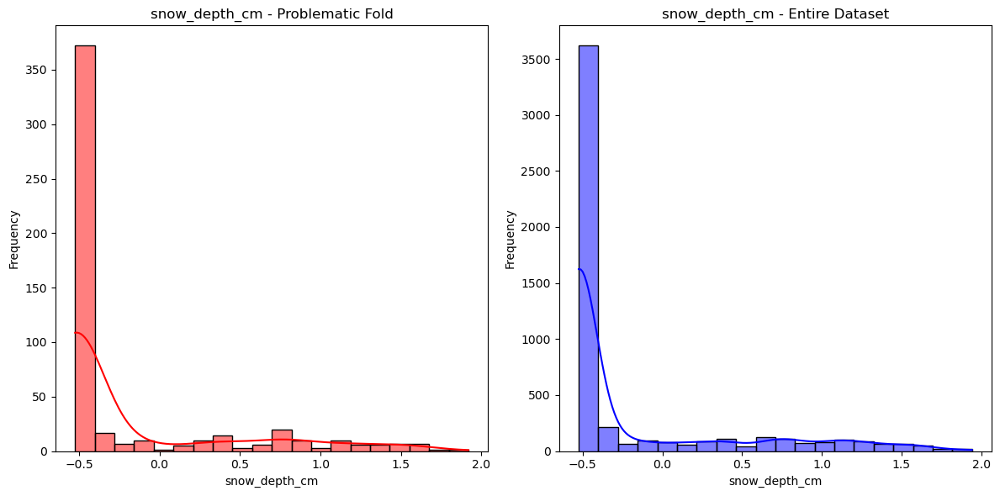

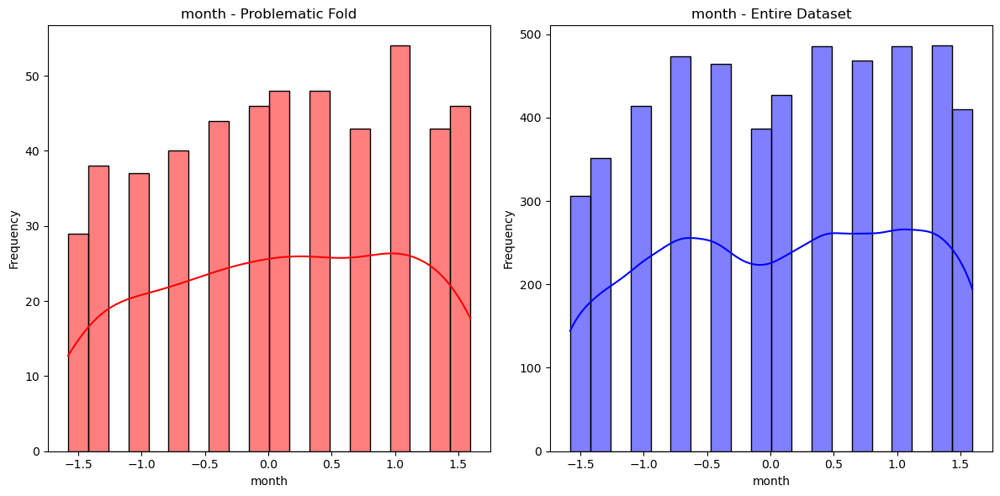

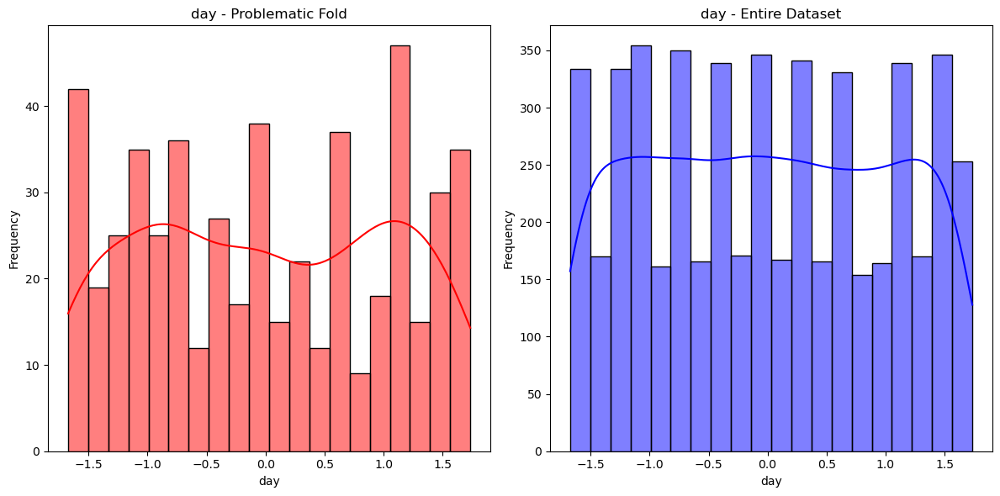

In [147]:
import numpy as np
from sklearn.model_selection import cross_val_score, KFold
from sklearn.metrics import mean_squared_error


# Perform k-fold cross-validation
kf = KFold(n_splits=10, shuffle=True, random_state=42)
ST2_cv_scores = cross_val_score(ST2_stacking_regressor, ST2_X_train, ST2_Y_train, cv=kf, scoring='neg_mean_squared_error')

# Convert scores to positive
ST2_cv_scores = -ST2_cv_scores

# Print cross-validation scores
print("Cross-Validation Scores (MSE):", ST2_cv_scores)
print("Mean CV Score (MSE):", np.mean(ST2_cv_scores))
print("Standard Deviation of CV Scores:", np.std(ST2_cv_scores))
# Save the scores to an Excel file
ST2_cv_scores_df = pd.DataFrame(ST2_cv_scores, columns=['MSE'])
ST2_cv_scores_df.to_excel('data/ST2_cv_scores.xlsx', index=False)

##=========== Visualize the problematic Fold using histogram==================
# Calculate mean MSE
ST2_mean_mse = np.mean(ST2_cv_scores)
# Identify the problematic fold
ST2_problematic_fold_index = np.argmax(np.abs(ST2_cv_scores - ST2_mean_mse))
# Get the indices of the data points in the problematic fold
for fold_index, (train_index, test_index) in enumerate(kf.split(ST2_X_train)):
    if fold_index == ST2_problematic_fold_index:
        problematic_fold_train_indices = train_index
        problematic_fold_test_indices = test_index

# Subset the data for the problematic fold
X_problematic_fold = ST2_X_train.iloc[problematic_fold_test_indices]
y_problematic_fold = ST2_Y_train.iloc[problematic_fold_test_indices]

# Visualize or analyze features for the problematic fold
for feature in ST2_X_train.columns:
    plt.figure(figsize=(12, 6))
    # Histogram for the problematic fold
    plt.subplot(1, 2, 1)
    sns.histplot(X_problematic_fold[feature], kde=True, bins=20, color='red')
    plt.title(f'{feature} - Problematic Fold')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    # Histogram for the entire dataset
    plt.subplot(1, 2, 2)
    sns.histplot(ST2_X_train[feature], kde=True, bins=20, color='blue')
    plt.title(f'{feature} - Entire Dataset')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.tight_layout()
    plt.savefig('images/ST2_CV_problematic_fold_vs_main_dataset_histograms.png')
    plt.show()

In [140]:
ST2_clean_dataset_denormalized['ST2'].std()

6.701081881995475

### Partial Dependence, Individual Conditional Expectation and Residual Analysis Plots for ST2

====================================================== ST2 Partial Dependence Plot


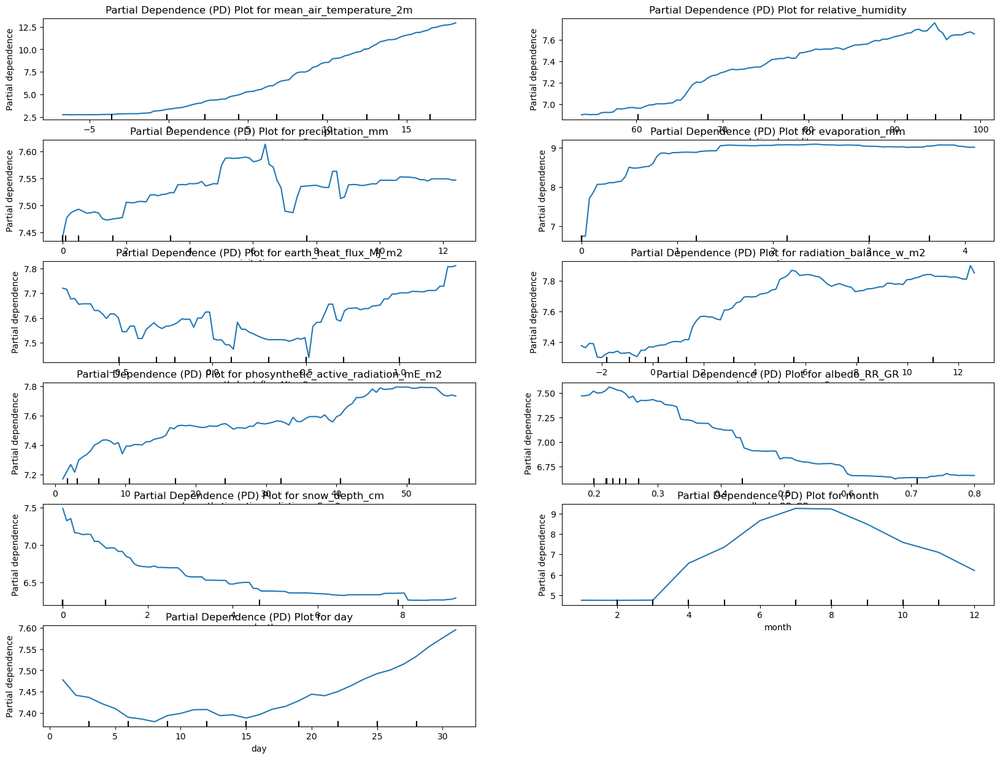

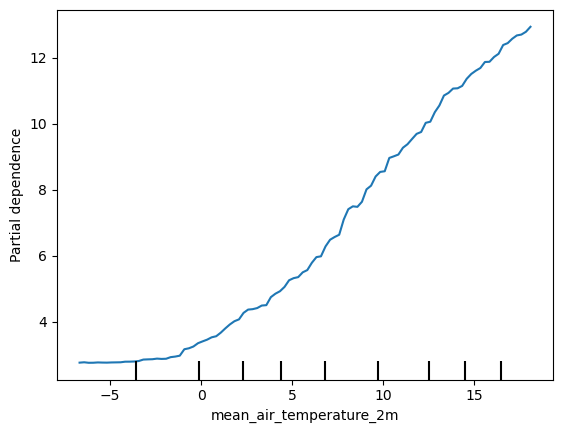

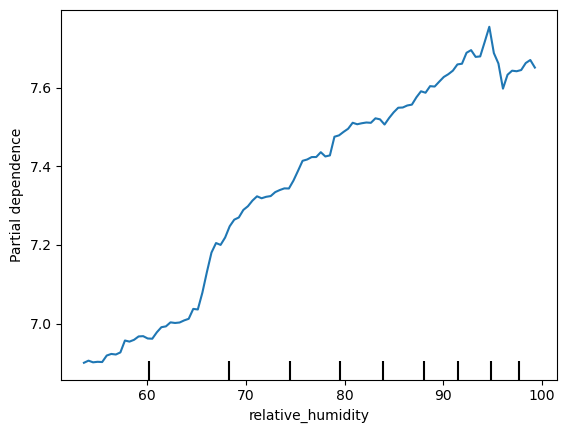

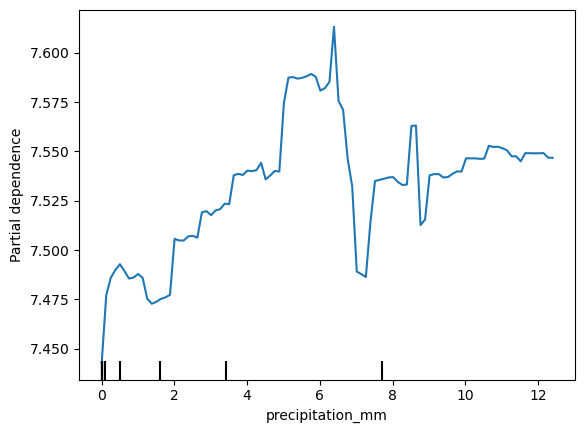

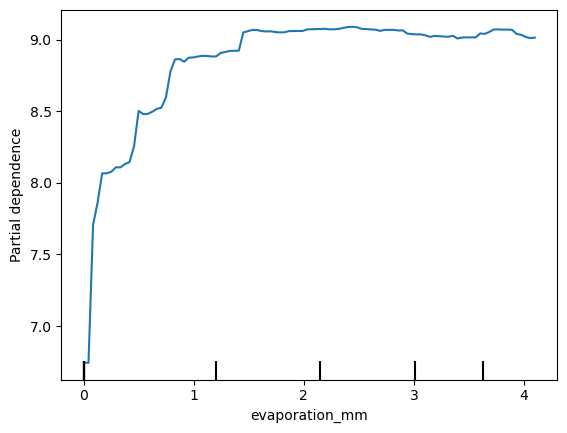

...

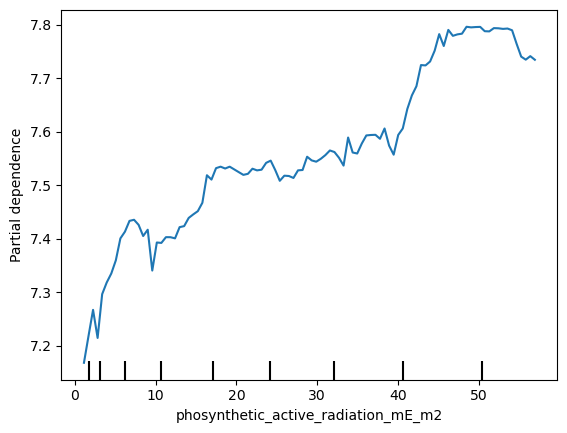

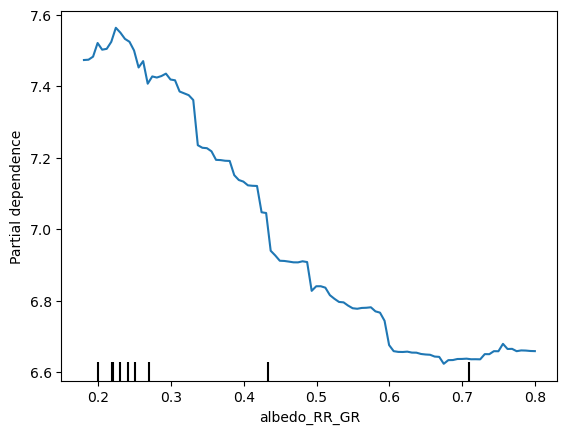

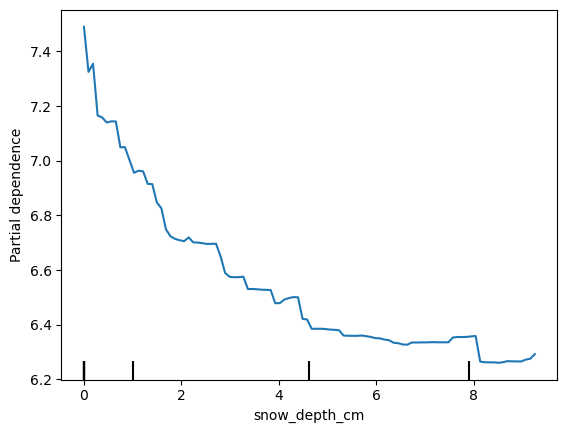

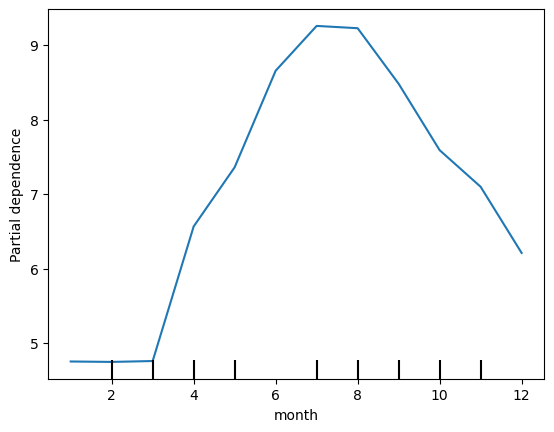

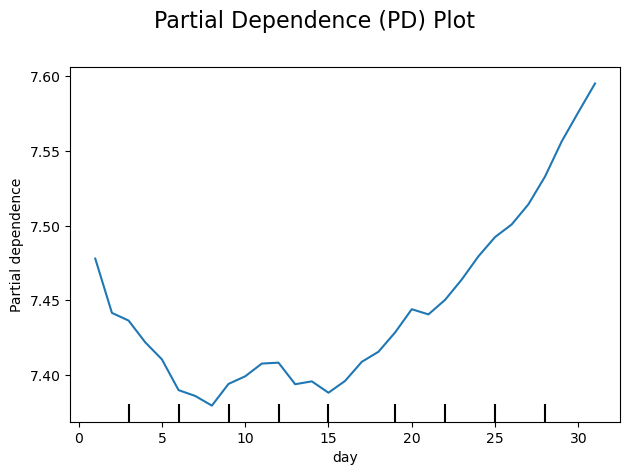

======================== ST2 Individual Conditional Expectation Plot  ===============================


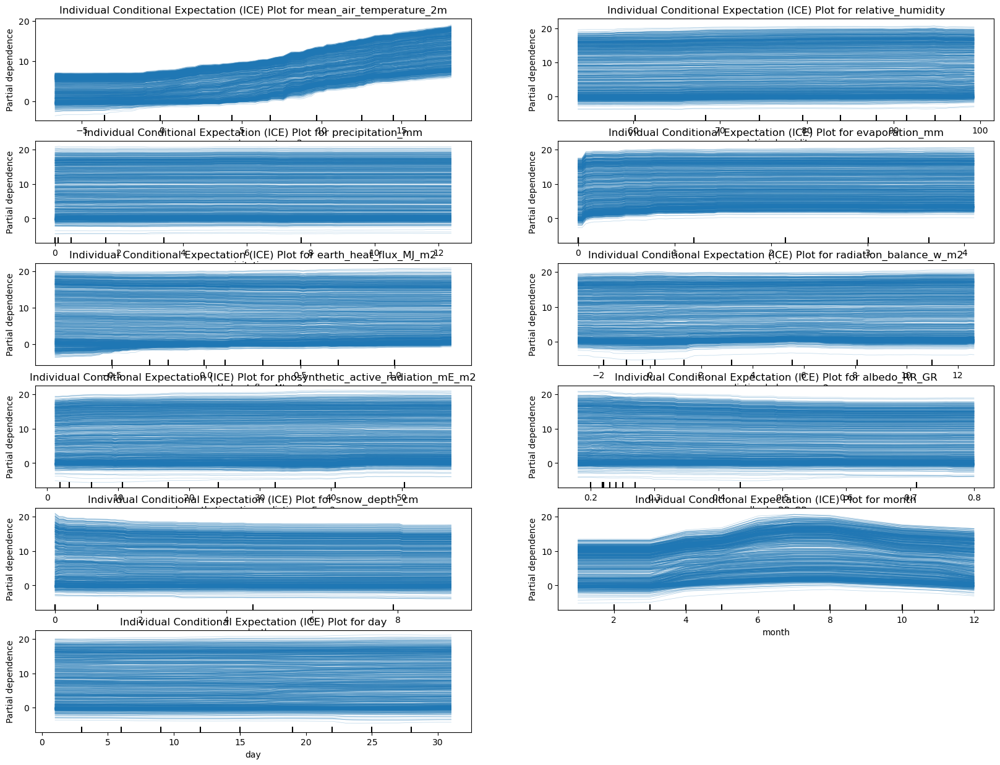

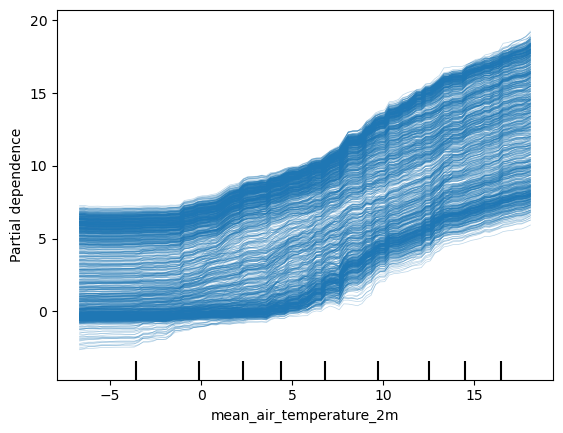

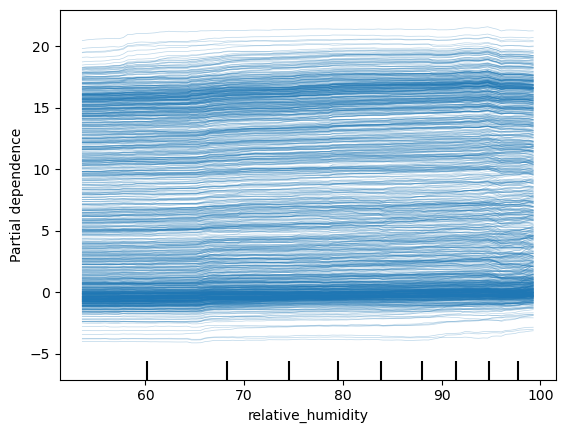

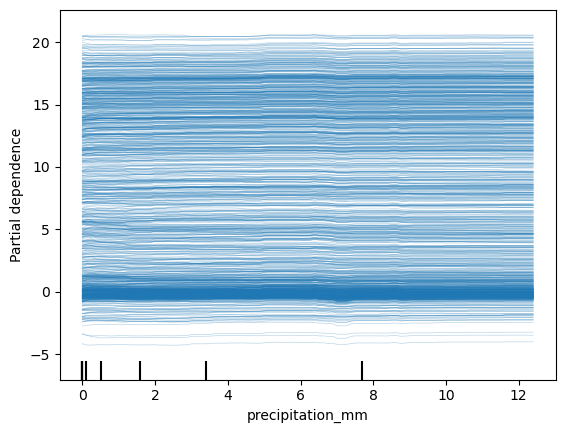

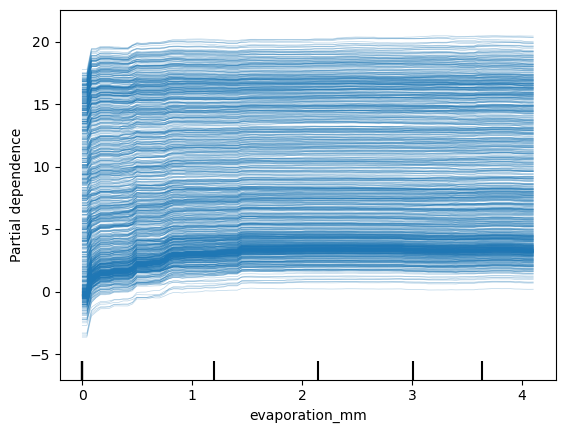

...

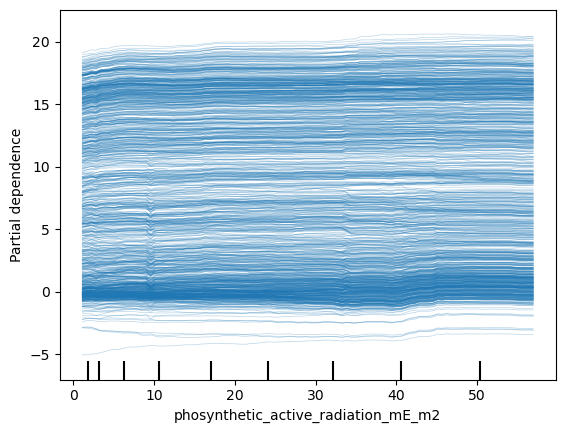

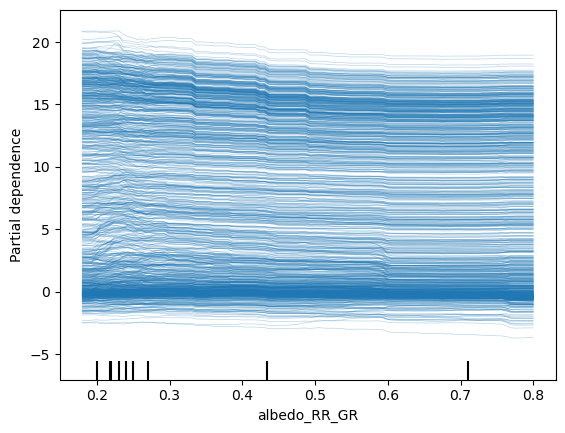

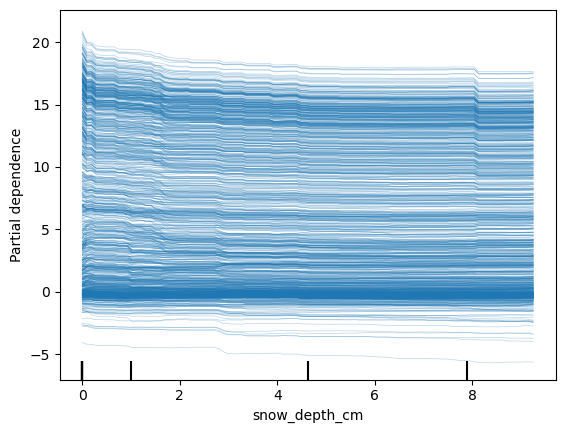

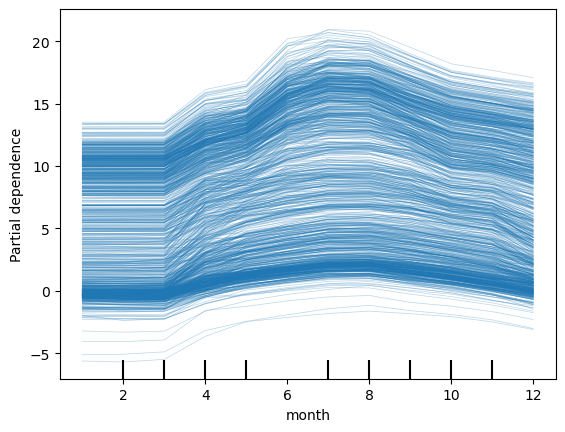

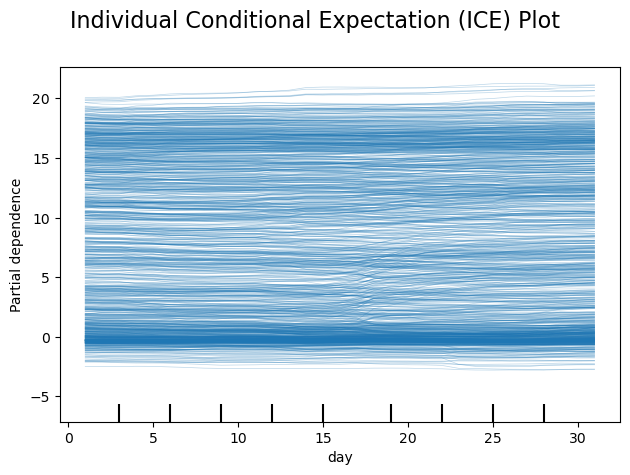

========================= ST2 Residual Analysis Plot ==============================


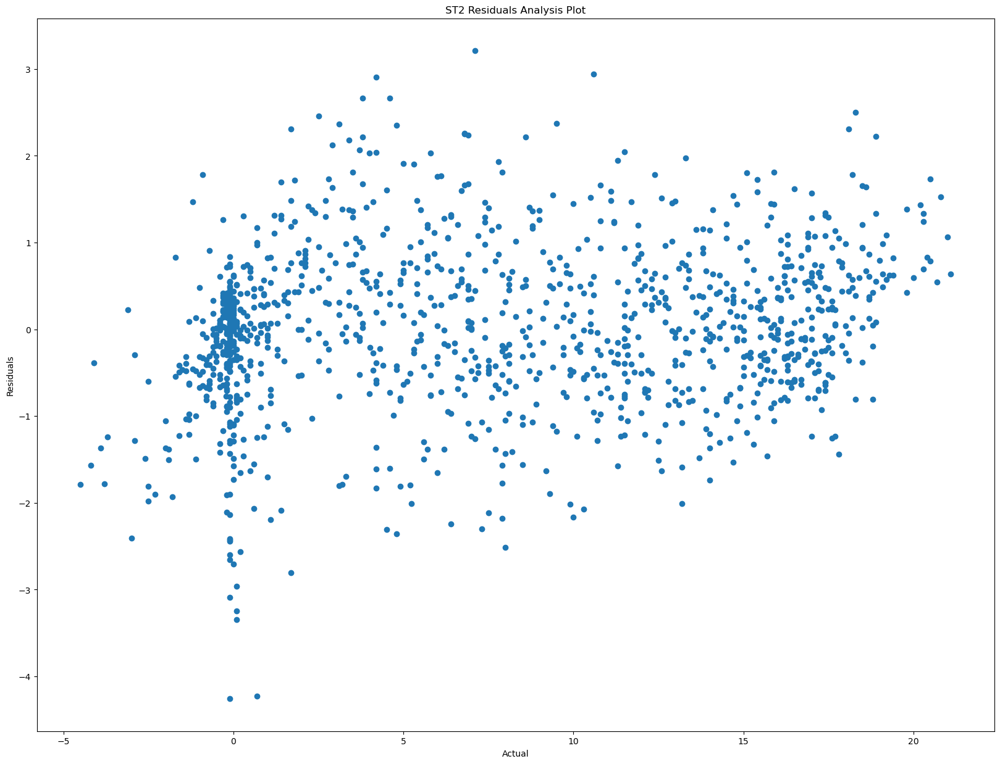

========================= ST2 Q-Q Plot ==============================


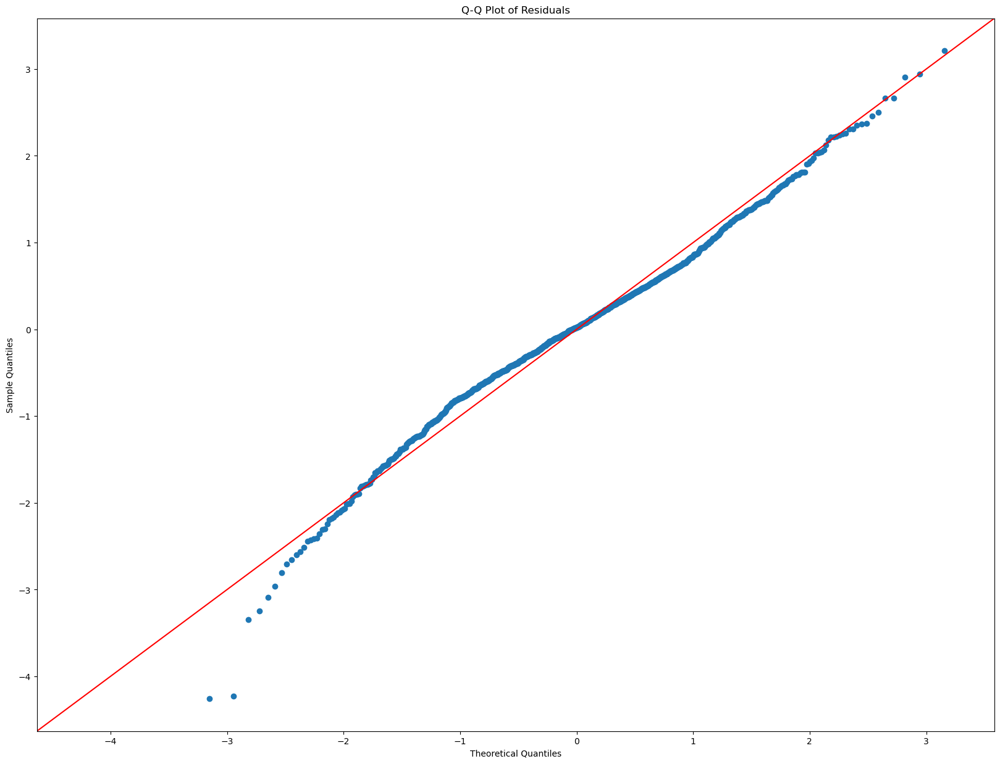

In [165]:
from sklearn.inspection import PartialDependenceDisplay
import statsmodels.api as sm
from pycebox.ice import ice, ice_plot
import matplotlib.pyplot as plt

# Partial Dependence Plot
print('====================================================== ST2 Partial Dependence Plot')
ST2_feature_names = ST2_X_train.columns.tolist()
n_features = len(ST2_feature_names)
n_cols = 2
n_rows = (n_features + n_cols - 1) // n_cols

fig1, ax1 = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 15))
axes_flat = ax1.flatten()

for idx, feature in enumerate(ST2_feature_names):
    display = PartialDependenceDisplay.from_estimator(ST2_stacking_regressor, ST2_X_train, features=[feature])
    display.plot(ax=axes_flat[idx])
    axes_flat[idx].set_title(f'Partial Dependence (PD) Plot for {feature}')
    axes_flat[idx].set_xlabel(feature)

for idx in range(n_features, len(axes_flat)):
    fig1.delaxes(axes_flat[idx])

plt.subplots_adjust(hspace=0.5)
plt.suptitle('Partial Dependence (PD) Plot', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.savefig('images/ST2_final_partial_dependence_plot.png')
plt.show()

# Individual Conditional Expectation Plot (ICE)
print('======================== ST2 Individual Conditional Expectation Plot ===============================')
fig2, axes2 = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 15))
axes_flat2 = axes2.flatten()

for idx, feature in enumerate(ST2_feature_names):
    display = PartialDependenceDisplay.from_estimator(ST2_stacking_regressor, ST2_X_train, features=[feature], kind='individual')
    display.plot(ax=axes_flat2[idx])
    axes_flat2[idx].set_title(f'Individual Conditional Expectation (ICE) Plot for {feature}')
    axes_flat2[idx].set_xlabel(feature)

for idx in range(n_features, len(axes_flat2)):
    fig2.delaxes(axes_flat2[idx])

plt.subplots_adjust(hspace=0.7)
plt.suptitle('Individual Conditional Expectation (ICE) Plot', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.savefig('images/ST2_final_individual_conditional_expectation_plot.png')
plt.show()

# Residual Analysis
print('========================= ST2 Residual Analysis Plot ==============================')
ST2_Y_predictions = ST2_stacking_regressor.predict(ST2_X_test)
ST2_residuals = ST2_Y_test - ST2_Y_predictions

fig3, ax3 = plt.subplots(figsize=(10, 7))
ax3.scatter(ST2_Y_predictions, ST2_residuals)
ax3.set_xlabel('Predictions')
ax3.set_ylabel('Residuals')
ax3.set_title('ST2 Residuals Analysis Plot')
plt.axhline(y=0, color='r', linestyle='--')
plt.savefig('images/ST2_final_residual_analysis_plot.png')
plt.show()

# Residuals vs. Predictor Variables
print('========================= Residuals vs. Predictor Variables ==============================')
for column in ST2_X_test.columns:
    fig, ax = plt.subplots(figsize=(10, 7))
    ax.scatter(ST2_X_test[column], ST2_residuals)
    ax.axhline(y=0, color='r', linestyle='--')
    ax.set_xlabel(column)
    ax.set_ylabel('Residuals')
    ax.set_title(f'Residuals vs. {column}')
    plt.savefig(f'images/ST2_final_residuals_vs_{column}.png')
    plt.show()

# Q-Q Plot
print('========================= ST2 Q-Q Plot ==============================')
fig5, ax5 = plt.subplots(figsize=(10, 7))
sm.qqplot(ST2_residuals, line='45', ax=ax5)
ax5.set_title('Q-Q Plot of Residuals')
plt.savefig('images/ST2_final_Q-Q_plot.png')
plt.show()

# Histogram of residuals
fig6, ax6 = plt.subplots(figsize=(10, 7))
plt.figure(figsize=(10, 6))
sns.histplot(residuals, kde=True, ax=ax6)
plt.xlabel('Residuals')
plt.title('Histogram of Residuals')
plt.show()


### Feature importances analysis for ST2

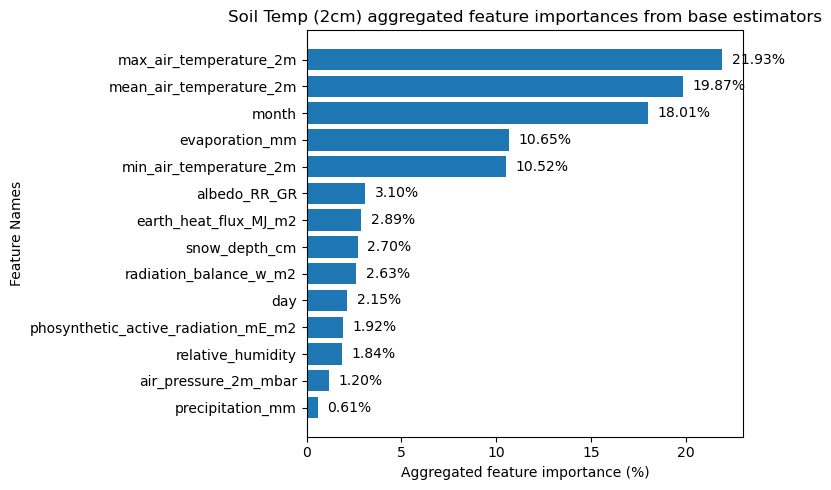

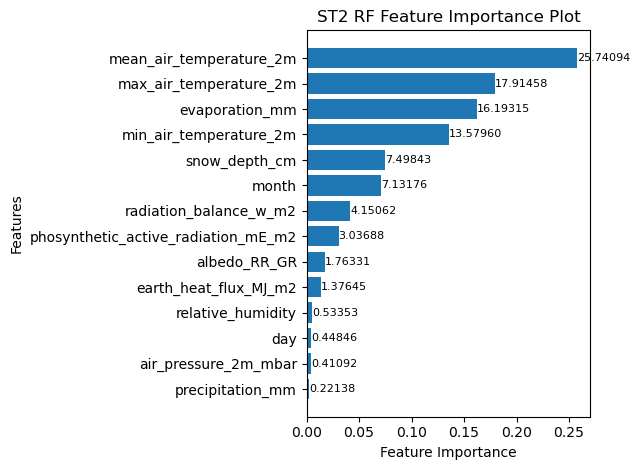

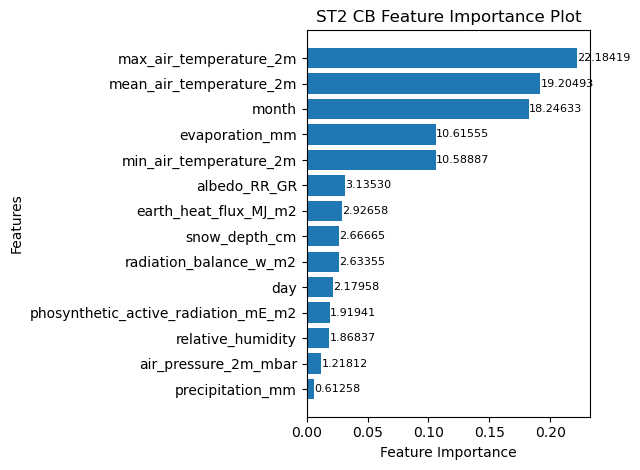

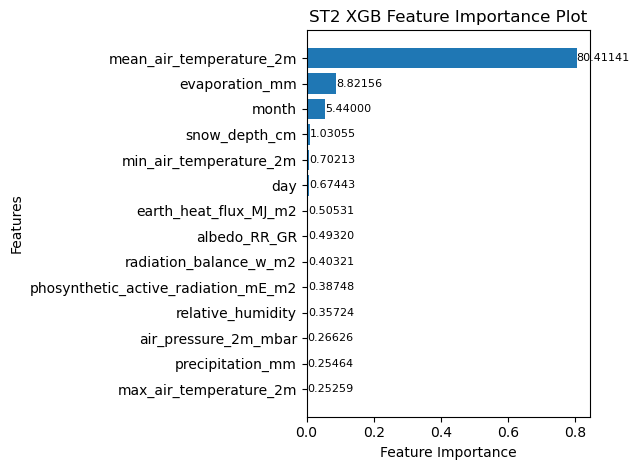

In [164]:
np.random.seed(42)
# Assuming feature_names is a list of your feature names
feature_names = ST2_X_train.columns.tolist()

estimators = [
    ("Random Forest", ST2_rf_model_stack),
    ("Cat Boost", ST2_cb_model_stack),
    ("XG Boost", ST2_xgb_model_stack)
]

# Initialize an array to store aggregated feature importances
num_features = ST2_X_train.shape[1]
feature_importances = np.zeros(num_features, dtype=np.float64)

# Aggregate feature importances from base models
count = 0
for name, model in estimators:
    if hasattr(model, 'feature_importances_'):
        importances = np.array(model.feature_importances_, dtype=np.float64)
        feature_importances += importances
        count += 1
    else:
        print(f"{name} does not have feature_importances_ attribute")

# Normalize the aggregated feature importances
if count > 0:
    feature_importances /= count

# Convert feature importances to percentages
feature_importances_percentage = 100 * (feature_importances / feature_importances.sum())

# Sort the feature importances in descending order
sorted_indices = np.argsort(feature_importances_percentage)[::-1]
sorted_feature_importances_percentage = feature_importances_percentage[sorted_indices]
sorted_feature_names = [feature_names[i] for i in sorted_indices]

# Plot the sorted feature importances
plt.figure(figsize=(8, 5))
bars = plt.barh(sorted_feature_names, sorted_feature_importances_percentage)
plt.xlabel("Aggregated feature importance (%)")
plt.ylabel("Feature Names")
plt.title("Soil Temp (2cm) aggregated feature importances from base estimators")
plt.gca().invert_yaxis()  # Highest importance at the top

# Add annotations to the bars
for bar in bars:
    width = bar.get_width()
    plt.text(
        width + 0.5,  # Offset slightly to the right of the bar
        bar.get_y() + bar.get_height() / 2,  # Vertical center of the bar
        f'{width:.2f}%',  # Display the width (importance value) formatted to 2 decimal places
        va='center'
    )
# Save the figure
plt.tight_layout()
plt.savefig('data/results/ST2_stacking_regressors_feature_importances.png')
plt.show()

plot_features(ST2_X_train.columns, ST2_rf_model_stack.feature_importances_, 'images/ST2_RF_feature_analysis.png', 'ST2 RF Feature Importance Plot')
plot_features(ST2_X_train.columns, ST2_cb_model_stack.feature_importances_/100, 'images/ST2_CB_feature_analysis.png', 'ST2 CB Feature Importance Plot')
plot_features(ST2_X_train.columns, ST2_xgb_model_stack.feature_importances_, 'images/ST2_XGB_feature_analysis.png', 'ST2 XGB Feature Importance Plot')

### GridSearhCV Evaluation for all models used in the stacked regressor for ST2

In [165]:
ST2_xgb_model_stack.feature_importances_

array([0.8041141 , 0.00702126, 0.00252592, 0.00357237, 0.0026626 ,
       0.00254644, 0.08821557, 0.00505308, 0.00403212, 0.00387479,
       0.00493197, 0.01030547, 0.05439997, 0.0067443 ], dtype=float32)

In [ ]:
%%time
import time
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor, HistGradientBoostingRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.model_selection import cross_val_predict, cross_validate
from catboost import CatBoostRegressor



# Define parameter grids for each model
param_grid_cb = {
    'iterations': [100, 200, 500],
    'learning_rate': [0.01, 0.1, 0.05],
    'depth': [4, 6, 10],
    'l2_leaf_reg': [1, 3, 5, 7, 9],
    'border_count': [32, 50, 100]
}
param_grid_rf = {
    'n_estimators': [100, 300, 500],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

param_grid_hgb = {
    'learning_rate': [0.01, 0.1, 0.05],
    'max_iter': [100, 200, 500],
    'max_leaf_nodes': [31, 50, 100],
    'max_depth': [None, 10, 20],
    'min_samples_leaf': [20, 50, 100],
    'l2_regularization': [0, 0.1, 1]
}

param_grid_xgb = {
    'n_estimators': [100, 200, 500],
    'learning_rate': [0.01, 0.1, 0.05],
    'max_depth': [3, 5, 7],
    'subsample': [1.0, 0.8, 0.6],
    'colsample_bytree': [1.0, 0.8, 0.6],
    'gamma': [0, 1, 5],
    'reg_alpha': [0, 0.1, 1],
    'reg_lambda': [1, 0.1, 0.01],
    'tree_method': ['gpu_hist']  # Use GPU
}
param_grid_ada = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.05],
    'loss': ['linear', 'square', 'exponential']
}
# stacking_param_grid ={
#     'rf__n_estimators': [100, 300, 500],
#     'rf__max_depth': [None, 10, 20, 30],
#     'hgb__learning_rate': [0.01, 0.1, 0.05],
#     'hgb__max_iter': [100, 200, 500],
#     'catboost__iterations': [100, 200, 500],
#     'catboost__learning_rate': [0.01, 0.1, 0.05],
#     'catboost__depth': [4, 6, 10],
#     'xgb__n_estimators': [100, 200],
#     'xgb__max_depth': [3, 5]
# }


# Initialize models
cb = CatBoostRegressor(random_state=42)
rf = RandomForestRegressor(random_state=42)
hgb = HistGradientBoostingRegressor(random_state=42)
ada = AdaBoostRegressor(random_state=42)
xgb = XGBRegressor(random_state=42, objective='reg:squarederror')

# estimators = [
#     ('rf', RandomForestRegressor()),
#     ('cb', CatBoostRegressor()),
#     ('hgb', HistGradientBoostingRegressor()),    
#     ('xgb', XGBRegressor())
# ]

# stacking_regressor = StackingRegressor(
#     estimators=estimators,
#     final_estimator=RidgeCV()
# )

# Initialize GridSearchCV for RF model
start_time_rf = time.time()
ST2_grid_search_rf = GridSearchCV(estimator=rf, param_grid=param_grid_rf, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_rf_search = time.time()
ST2_grid_search_rf.fit(ST2_X_train, ST2_Y_train)
end_time_rf_fit = time.time()
elapsed_time_search_rf = end_time_rf_search - start_time_rf
elapsed_time_fit_rf = end_time_rf_fit - end_time_rf_search
# Get the best parameters and scores
print("Best parameters for RandomForestRegressor:", ST2_grid_search_rf.best_params_)
print("Best score for RandomForestRegressor:", -ST2_grid_search_rf.best_score_)
print("RandomForestRegressor GridSearchCV Time:", elapsed_time_search_rf)
print("RandomForestRegressor Fitting Time:", elapsed_time_fit_rf)

# Initialize GridSearchCV for HGB model
start_time_hgb = time.time()
ST2_grid_search_hgb = GridSearchCV(estimator=hgb, param_grid=param_grid_hgb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_hgb_search = time.time()
ST2_grid_search_hgb.fit(ST2_X_train, ST2_Y_train)
end_time_hgb_fit = time.time()
elapsed_time_search_hgb = end_time_hgb_search - start_time_hgb
elapsed_time_fit_hgb = end_time_hgb_fit - end_time_hgb_search
# Get the best parameters and scores
print("Best parameters for HistGradientBoostingRegressor:", ST2_grid_search_hgb.best_params_)
print("Best score for HistGradientBoostingRegressor:", -ST2_grid_search_hgb.best_score_)
print("HistGradientBoostingRegressor GridSearchCV Time:", elapsed_time_search_hgb)
print("HistGradientBoostingRegressor Fitting Time:", elapsed_time_fit_hgb)

# Initialize GridSearchCV for XGB model
start_time_xgb = time.time()
ST2_grid_search_xgb = GridSearchCV(estimator=xgb, param_grid=param_grid_xgb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_xgb_search = time.time()
ST2_grid_search_xgb.fit(ST2_X_train, ST2_Y_train)
end_time_xgb_fit = time.time()
elapsed_time_search_xgb = end_time_xgb_search - start_time_xgb
elapsed_time_fit_xgb = end_time_xgb_fit - end_time_xgb_search
# Get the best parameters and scores
print("Best parameters for XGBRegressor:", ST2_grid_search_xgb.best_params_)
print("Best score for XGBRegressor:", -ST2_grid_search_xgb.best_score_)
print("XGBRegressor GridSearchCV Time:", elapsed_time_search_xgb)
print("XGBRegressor Fitting Time:", elapsed_time_fit_xgb)

# Initialize GridSearchCV for ADA model
start_time_ada = time.time()
ST2_grid_search_ada = GridSearchCV(estimator=ada, param_grid=param_grid_ada, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_ada_search = time.time()
ST2_grid_search_ada.fit(ST2_X_train, ST2_Y_train)
end_time_ada_fit = time.time()
elapsed_time_search_ada = end_time_ada_search - start_time_ada
elapsed_time_fit_ada = end_time_ada_fit - end_time_ada_search
# Get the best parameters and scores
print("Best parameters for AdaBoostRegressor:", ST2_grid_search_ada.best_params_)
print("Best score for AdaBoostRegressor:", -ST2_grid_search_ada.best_score_)
print("AdaBoostRegressor GridSearchCV Time:", elapsed_time_search_ada)
print("AdaBoostRegressor Fitting Time:", elapsed_time_fit_ada)

# Initialize GridSearchCV for CB model
start_time_cb = time.time()
ST2_grid_search_cb = GridSearchCV(estimator=cb, param_grid=param_grid_cb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_cb_search = time.time()
ST2_grid_search_cb.fit(ST2_X_train, ST2_Y_train)
end_time_cb_fit = time.time()
elapsed_time_search_cb = end_time_cb_search - start_time_cb
elapsed_time_fit_cb = end_time_cb_fit - end_time_cb_search
# Get the best parameters and scores
print("Best parameters for CatBoostRegressor:", ST2_grid_search_cb.best_params_)
print("Best score for CatBoost:", -ST2_grid_search_cb.best_score_)
print("CatBoostRegressor GridSearchCV Time:", elapsed_time_search_cb)
print("CatBoostRegressor Fitting Time:", elapsed_time_fit_cb)

# # Initialize GridSearchCV for Stacking model
# start_time_stacking = time.time()
# ST2_grid_search_stacking = GridSearchCV(estimator=stacking_regressor, param_grid=stacking_param_grid, cv=5, n_jobs=-1, verbose=0,scoring='neg_mean_absolute_error')
# end_time_stacking_search = time.time()
# ST2_grid_search_stacking.fit(ST2_X_train, ST2_Y_train)
# end_time_stacking = time.time()
# elapsed_time_search_stacking = end_time_stacking_search - start_time_stacking
# elapsed_time_fit_stacking = end_time_stacking_fit - end_time_stacking_search

# print("Best parameters for StackingRegressor:", ST2_grid_search_stacking.best_params_)
# print("Best score for StackingRegressor:", -ST2_grid_search_stacking.best_score_)
# print("StackingRegressor GridSearchCV Time:", elapsed_time_search_stacking)
# print("StackingRegressor Fitting Time:", elapsed_time_fit_stacking)

# Define the results of print statements as variables
ST2_grid_search_and_fitting_results = {
    'Model': ['RandomForestRegressor', 'HistGradientBoostingRegressor', 'AdaBoostRegressor', 'XGBRegressor'],
    'Best Parameters': [ST2_grid_search_rf.best_params_, ST2_grid_search_hgb.best_params_, ST2_grid_search_ada.best_params_, ST2_grid_search_xgb.best_params_],
    'Best Score': [-ST2_grid_search_rf.best_score_, -ST2_grid_search_hgb.best_score_, -ST2_grid_search_ada.best_score_, -ST2_grid_search_xgb.best_score_],
    'GridSearchCV Time': [elapsed_time_search_rf, elapsed_time_search_hgb, elapsed_time_search_ada, elapsed_time_search_xgb],
    'Fitting Time': [elapsed_time_fit_rf, elapsed_time_fit_hgb, elapsed_time_fit_ada, elapsed_time_fit_xgb]
}

# Create a DataFrame
df_results = pd.DataFrame(ST2_grid_search_and_fitting_results)

# Export DataFrame to Excel
df_results.to_excel('data/ST2_ST2_grid_search_and_fitting_results.xlsx', index=False)

### B. Stacking Regressor for Soil temperature at 5cm

### Correlation analysis

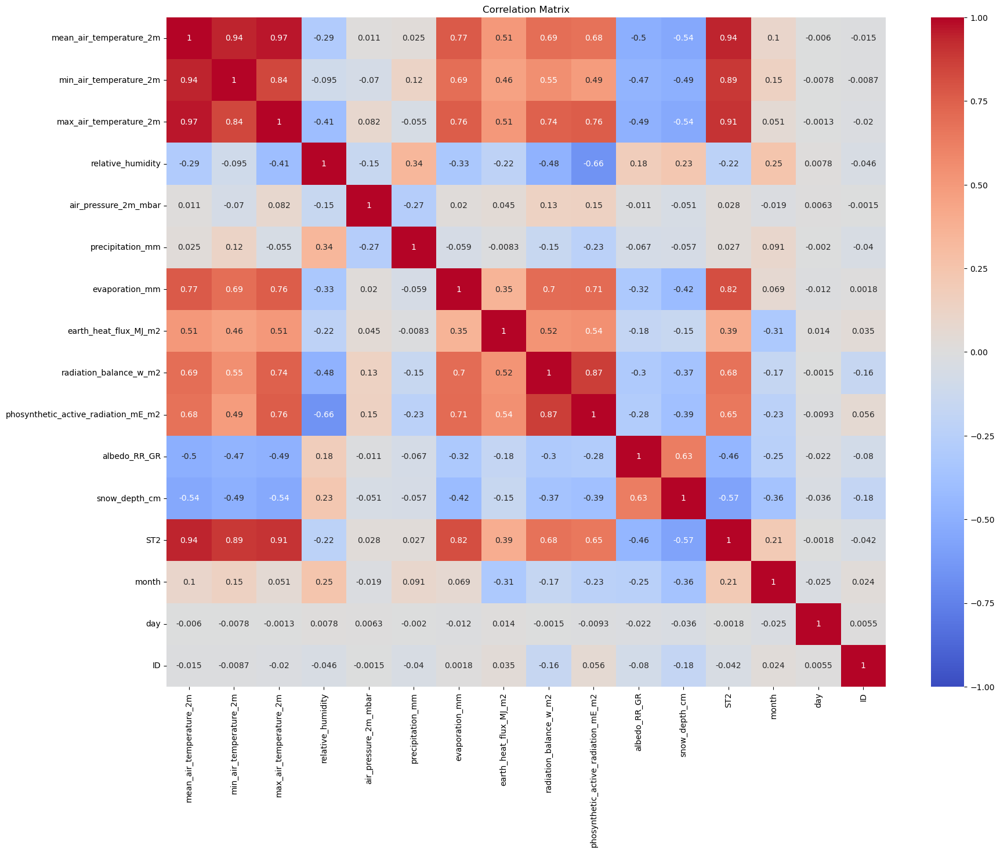

Highly correlated pairs (above threshold):
('mean_air_temperature_2m', 'max_air_temperature_2m')
Removed features: {'max_air_temperature_2m'}
Shape of the reduced dataset: (6550, 15)


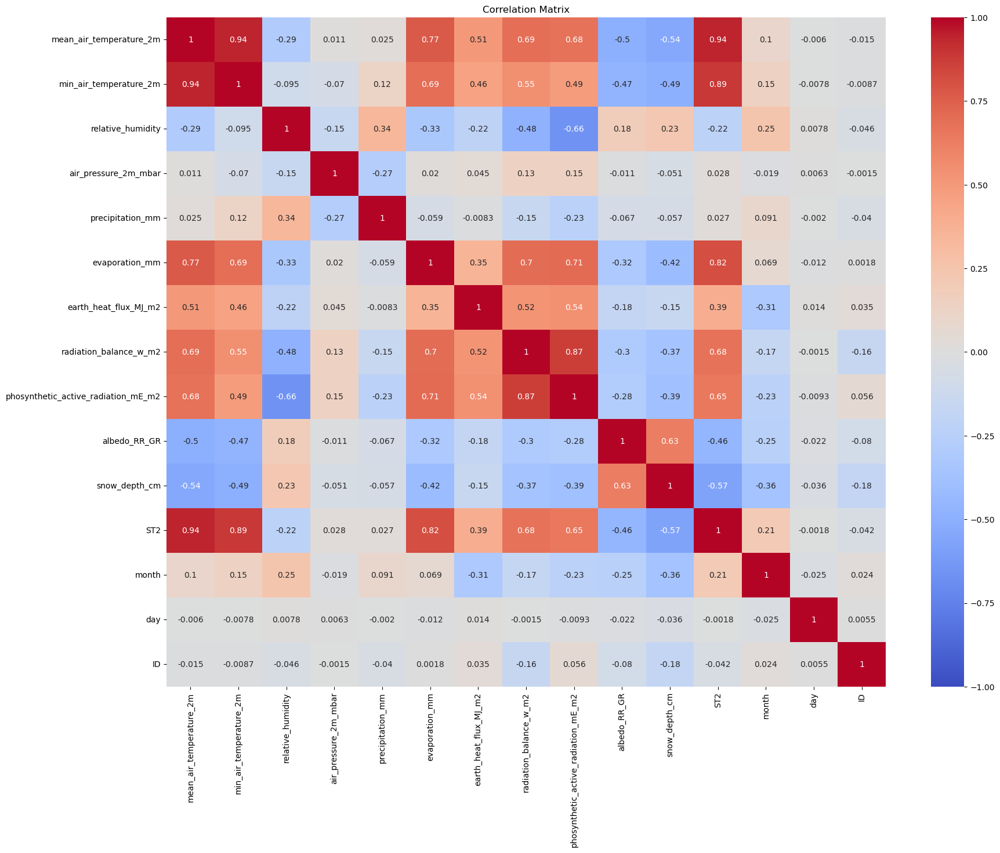

Removing feature 'const' with VIF: 10260.896681247887
Removing feature 'air_pressure_2m_mbar' with VIF: 141.25809091970802
Removing feature 'mean_air_temperature_2m' with VIF: 55.43018245346391
Final VIF data:
                                feature        VIF
0                min_air_temperature_2m   8.778846
1                     relative_humidity  20.961781
2                      precipitation_mm   1.543080
3                        evaporation_mm   6.541142
4                 earth_heat_flux_MJ_m2   2.010828
5                radiation_balance_w_m2   6.954699
6   phosynthetic_active_radiation_mE_m2  12.540863
7                          albedo_RR_GR   8.339093
8                         snow_depth_cm   2.853839
9                                   ST2  26.943023
10                                month   9.467795
11                                  day   4.085601


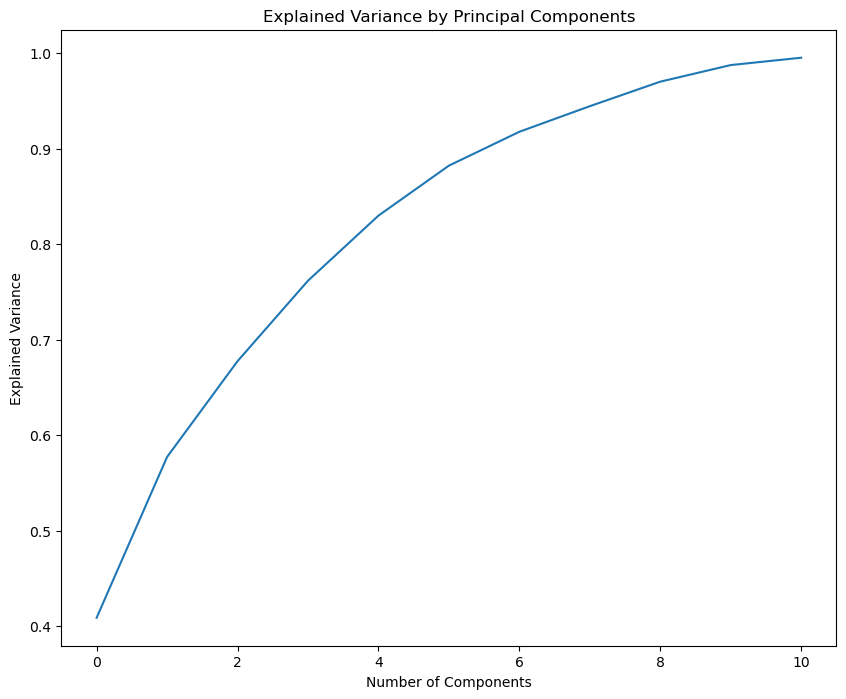

In [202]:
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Calculate the covariance matrix for target ST100
ST5_dataset_correlation = ST5_clean_dataset_denormalized.drop(['ST100', 'ST50','ST20','ST10','ST5'], axis=1)
ST5_covariance_matrix = ST5_dataset_correlation.cov()

# Calculate the correlation matrix
ST5_correlation_matrix = ST5_dataset_correlation.corr()

# Visualize the correlation matrix
plt.figure(figsize=(20, 15))
sns.heatmap(ST5_correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.savefig("images/ST5_denormalized_before_correlation_matrix.png")
plt.show()

# Set the threshold
threshold = 0.95
# Find pairs of features with correlation above the threshold
highly_correlated = np.where(np.abs(ST5_correlation_matrix) > threshold)
highly_correlated_pairs = [(ST5_correlation_matrix.index[x], ST5_correlation_matrix.columns[y]) 
                           for x, y in zip(*highly_correlated) if x != y and x < y]

print("Highly correlated pairs (above threshold):")
for pair in highly_correlated_pairs:
    print(pair)
# Example: Removing one feature from each highly correlated pair
features_to_remove = set()
for pair in highly_correlated_pairs:
    features_to_remove.add(pair[1])  # You can choose to remove pair[0] or pair[1]

# Drop the features from the dataframe
ST5_dataset_denormalized_outlier_filtered_uncorrelated = ST5_dataset_correlation.drop(columns=features_to_remove)

print(f"Removed features: {features_to_remove}")
print("Shape of the reduced dataset:", ST5_dataset_denormalized_outlier_filtered_uncorrelated.shape)

# After removing the correlated features
# Calculate the correlation matrix
ST5_correlation_matrix_new = ST5_dataset_denormalized_outlier_filtered_uncorrelated.corr()

# Visualize the correlation matrix
plt.figure(figsize=(20, 15))
sns.heatmap(ST5_correlation_matrix_new, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.savefig("images/ST5_denormalized_after_correlation_matrix.png")
plt.show()

# Assuming dataset_denormalized_outlier_filtered is your DataFrame
ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = ST5_dataset_denormalized_outlier_filtered_uncorrelated.copy()

# Add a constant term for the intercept
ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = sm.add_constant(ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif)
ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop('ID', axis=1, inplace=True)

# Function to calculate VIF
def calculate_vif(data):
    vif_data = pd.DataFrame()
    vif_data["feature"] = data.columns
    vif_data["VIF"] = [variance_inflation_factor(data.values, i) for i in range(data.shape[1])]
    return vif_data

# Iteratively remove features with VIF above the threshold
def remove_high_vif_features(data, threshold=40.0):
    while True:
        vif_data = calculate_vif(data)
        max_vif = vif_data['VIF'].max()
        if max_vif > threshold:
            # Identify the feature with the highest VIF
            feature_to_remove = vif_data.sort_values('VIF', ascending=False)['feature'].iloc[0]
            print(f"Removing feature '{feature_to_remove}' with VIF: {max_vif}")
            data = data.drop(columns=[feature_to_remove])
        else:
            break
    return data, vif_data

# Remove high VIF features
ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif, ST5_final_vif_data = remove_high_vif_features(ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif)

print("Final VIF data:")
print(ST5_final_vif_data)
ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ID'] = ST5_clean_dataset_denormalized['ID']
ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ST5'] = ST5_clean_dataset_denormalized['ST5']
ST5_dataset_denormalized_outlier_filtered_uncorrelated['ID'] = ST5_clean_dataset_denormalized['ID']
ST5_dataset_denormalized_outlier_filtered_uncorrelated['ST5'] = ST5_clean_dataset_denormalized['ST5']
# Remove the constant term before creating the final DataFrame
if 'const' in ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.columns:
    ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop(columns=['const'])

# Store the 'ID' and 'ST5' columns with their corresponding index before PCA
ID_index_mapping = ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ID']
ST5_index_mapping = ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ST5']

# Assume X is your feature dataframe
ST5_X_pca = ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop(['ST5', 'ID'], axis=1)

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(ST5_X_pca)

# Apply PCA
pca = PCA(n_components=0.99)  # Choose the number of components
principal_components = pca.fit_transform(X_scaled)

# Create a DataFrame with the principal components
ST5_pca_df = pd.DataFrame(data=principal_components, columns=[f"PC{i}" for i in range(principal_components.shape[1])])

# Merge PCA DataFrame with original DataFrame to maintain original index order
ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca = pd.merge(ID_index_mapping, ST5_index_mapping, left_index=True, right_index=True)
ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca = pd.merge(ST5_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca, ST5_pca_df, left_index=True, right_index=True)

# Plot the explained variance
plt.figure(figsize=(10,8))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Explained Variance')
plt.title('Explained Variance by Principal Components')
plt.savefig('images/ST5_PCA_analysis.png')
plt.show()

### Option 1: Dataset used is after correlation analysis

====================Random Forest The Evaluation Metrics Results For ST5 Denormalized =======================

Out of Bag Score:  0.9994625566748755
{'Validation Set R^2 Score': 0.9995611580243103, 'Validation Set MAE': 0.0970414399870257, 'Validation Set MSE': 0.0182845780200442, 'Validation Set Median Absolute Error': 0.07136363636363185, 'Validation Set Max Error': 0.7419999999999993, 'Validation Set Explained Variance Score': 0.9995613875972327}

====================CatBoost The Evaluation Metrics Results For ST5 Denormalized =======================

{'Validation Set R^2 Score': 0.9995102773423163, 'Validation Set MAE': 0.10639466635024174, 'Validation Set MSE': 0.02040454796633271, 'Validation Set Median Absolute Error': 0.08197146490300078, 'Validation Set Max Error': 0.6365792309258325, 'Validation Set Explained Variance Score': 0.999511507284515}

====================Random Forest The Evaluation Metrics Results For ST5 Denormalized =======================

{'Validation Set R^2 

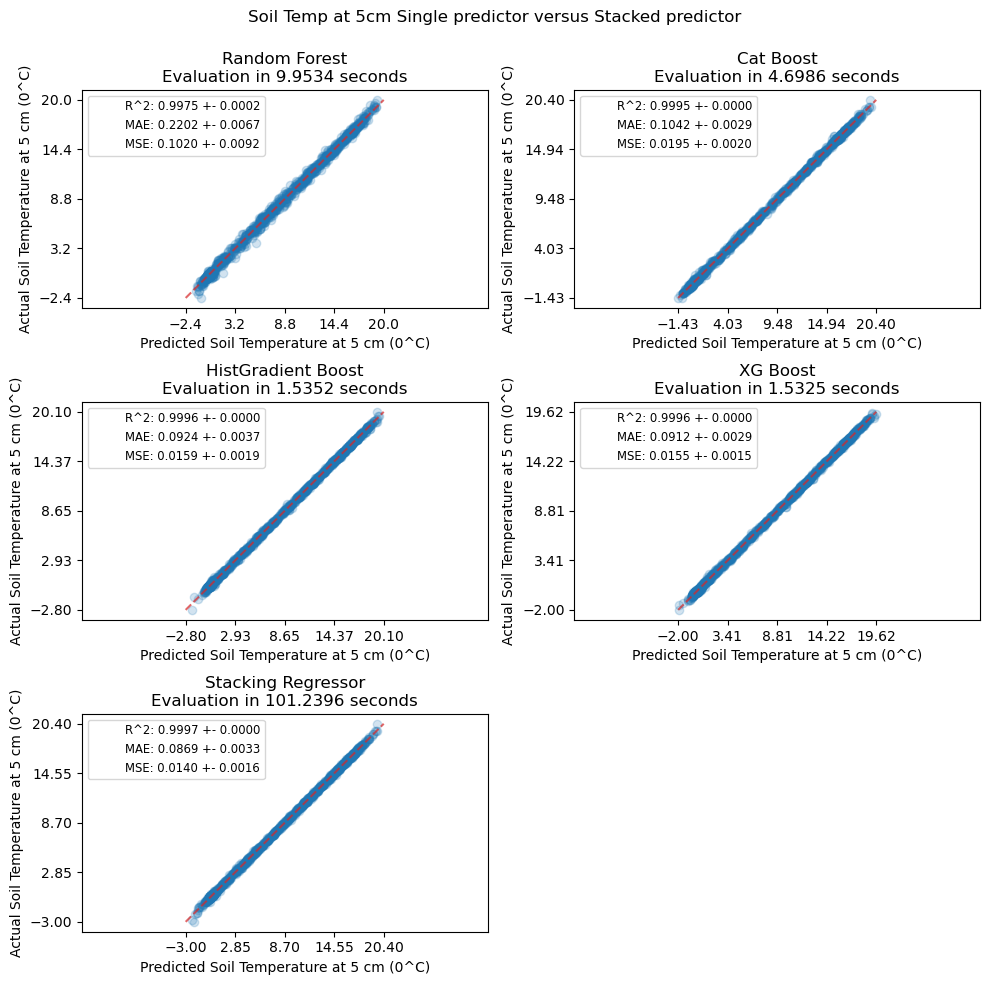

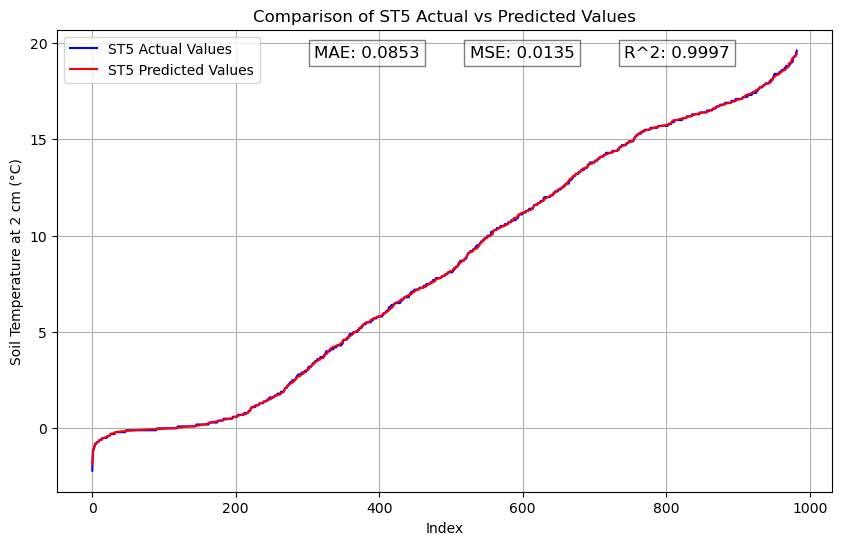

CPU times: total: 2min 23s
Wall time: 4min 46s


In [203]:
%%time
import numpy as np
from sklearn.linear_model import LassoCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.metrics import PredictionErrorDisplay
from sklearn.model_selection import cross_val_predict, cross_validate
import time

np.random.seed(42)
  
# Create function to evaluate model on few different levels
def show_scores(model, X_train, X_valid, Y_train, Y_valid, target='ST5', model_name='RF'):
    """
    Calculates and shows the different sklearn evaluation metrics
        
    Parameters:
        model: the model fitted.
        X_train: the input training set.
        X_valid: the input validation or test set.
        Y_train: the target training set.
        Y_valid: the target validation or test set.
            
    Returns:
        scores: the dictionary of the calculated sklearn metrics for train and valid sets.
    """
    
    train_preds = model.predict(X_train)
    val_preds = model.predict(X_valid)
    scores = {
              # "Training Set R^2 Score": r2_score(Y_train, train_preds),
              "Validation Set R^2 Score":r2_score(Y_valid, val_preds),
              # "Training Set MAE": mean_absolute_error(Y_train, train_preds),
              "Validation Set MAE": mean_absolute_error(Y_valid, val_preds),             
              # "Training Set MSE": mean_squared_error(Y_train, train_preds),
              "Validation Set MSE": mean_squared_error(Y_valid, val_preds),
              # "Training Set Median Absolute Error": median_absolute_error(Y_train, train_preds),
              "Validation Set Median Absolute Error": median_absolute_error(Y_valid, val_preds),
              # "Training Set MA Percentage Error": mean_absolute_percentage_error(Y_train, train_preds),
              # "Validation Set MA Percentage Error": mean_absolute_percentage_error(Y_valid, val_preds),
              # "Training Set Max Error": max_error(Y_train, train_preds),
              "Validation Set Max Error": max_error(Y_valid, val_preds),
              # "Training Set Explained Variance Score": explained_variance_score(Y_train, train_preds),
              "Validation Set Explained Variance Score": explained_variance_score(Y_valid, val_preds)}
    # Convert the dictionary to a DataFrame
    df = pd.DataFrame(list(scores.items()), columns=['Metric', 'Value'])    
    # Export the DataFrame to an Excel file
    df.to_excel(f'data/results/{target}_{model_name}_scores.xlsx', index=False)
    return scores

# Define a function that takes test set and validation sets as input and generates prediction curve and returns test set prediction data 
def predict_plot(model, ST_X_test, ST_X_validation, ST_Y_validation, name):
    # Predict the test set which is forecast data
    ST_Y_test_preds = model.predict(ST_X_test)
    # Changes the predicted array values to pandas series
    ST_Y_test_preds_series = pd.Series(ST_Y_test_preds, name=name) 
    # Convert the Series to a DataFrame
    ST_Y_test_preds_df = ST_Y_test_preds_series.to_frame()
    ST_Y_test_preds_df.index =  ST_X_test.index
    # Predict the validation set
    ST_Y_validation_preds = model.predict(ST_X_validation)
    # Change validation predictions to pandas series
    ST_Y_validation_preds_series = pd.Series(ST_Y_validation_preds)
    # Make the original and predicted series to have the same index
    ST_Y_validation_preds_series.index =ST_Y_validation.index
    # Sort Y_valid and Y_valid_preds in ascending order and reset indices
    ST_Y_validation_sorted = ST_Y_validation.sort_values().reset_index(drop=True)
    ST_Y_validation_preds_sorted = ST_Y_validation_preds_series[ST_Y_validation.index].sort_values().reset_index(drop=True)
  
    # Calculate mean absolute error
    ST_mae = mean_absolute_error(ST_Y_validation,ST_Y_validation_preds)
    # Calculate mean squared error
    ST_mse = mean_squared_error(ST_Y_validation,ST_Y_validation_preds)
    # Calculate the R^2 score
    ST_r2_score = r2_score(ST_Y_validation,ST_Y_validation_preds)
    # Plot the sorted values
    plt.figure(figsize=(10, 6))
    plt.plot(ST_Y_validation_sorted.index,ST_Y_validation_sorted, color='blue', label=f'{name} Actual Values')
    plt.plot(ST_Y_validation_preds_sorted.index,ST_Y_validation_preds_sorted, color='red', label=f'{name} Predicted Values')
    # Display the mean absolute error as text annotation
    plt.text(0.4, 0.95, f'MAE: {ST_mae:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.text(0.6, 0.95, f'MSE: {ST_mse:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.text(0.8, 0.95, f'R^2: {ST_r2_score:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.xlabel('Index')
    plt.ylabel(f'Soil Temperature at 2 cm (°C)')
    plt.title(f'Comparison of {name} Actual vs Predicted Values')
    plt.legend()
    plt.grid(True)
    plt.savefig(f'data/results/{name}_predicted_vs_actual_values_line_plot.png')  # Save as PNG format
    plt.show()
    return ST_Y_test_preds_df
    
# Let us shuffle the entire dataset so that it is randomly arranged
dataset_shuffled = ST5_clean_dataset_normalized.sample(frac=1)
# Split the dataset into features and target
many_features_dropped = ['mean_air_temperature_2m', 'relative_humidity','precipitation_mm','evaporation_mm','earth_heat_flux_MJ_m2', 'radiation_balance_w_m2', 'phosynthetic_active_radiation_mE_m2', 'albedo_RR_GR','snow_depth_cm','month','day']
soil_features_dropped = ['ST100','ST50','ST20','ST10','ST5','ID']
uncorrelated_dropped = ['ST5','ID']
# ST5_X = dataset_shuffled.drop(many_features_dropped, axis=1)
ST5_X = dataset_shuffled.drop(uncorrelated_dropped, axis=1)
ST5_Y = dataset_shuffled['ST5']

# Split the dataset in to features (independent variables) and labels(dependent variable = target_soil_temperature_2cm ).
# Then split into train, validation and test sets
train_split = round(0.7*len(dataset_shuffled)) # 70% for train set
valid_split = round(train_split + 0.15*len(dataset_shuffled))
ST5_X_train, ST5_Y_train = ST5_X[:train_split], ST5_Y[:train_split]
ST5_X_valid, ST5_Y_valid =ST5_X[train_split:valid_split], ST5_Y[train_split:valid_split]
ST5_X_test, ST5_Y_test = ST5_X[valid_split:], ST5_Y[valid_split:]

# A. RandomForestRegressor
# Create RF model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST5_rf_model_stack = RandomForestRegressor(n_jobs=-1, random_state=42, oob_score=True)
# Fit the model for ST5 to start with
ST5_rf_model_stack.fit(ST5_X_train, ST5_Y_train)
# Show the scoring metrics for this model
print("====================Random Forest The Evaluation Metrics Results For ST5 Denormalized =======================\n")
# Access the OOB Score
oob_score = ST5_rf_model_stack.oob_score_
print('Out of Bag Score: ', oob_score)
print(show_scores(ST5_rf_model_stack, ST5_X_train, ST5_X_valid, ST5_Y_train, ST5_Y_valid))
print("==================================================================================================\n")

# A. CatBoostRegressor (CB)
# Create CB model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST5_cb_model_stack = CatBoostRegressor(iterations=500,
                                learning_rate=0.1,
                                depth=6,
                                l2_leaf_reg=3,
                                loss_function='RMSE',
                                silent=True,
                                random_state=42)
# Fit the model for ST5 to start with
ST5_cb_model_stack.fit(ST5_X_train, ST5_Y_train, eval_set=(ST5_X_valid, ST5_Y_valid), early_stopping_rounds=100)
# Show the scoring metrics for this model
print("====================CatBoost The Evaluation Metrics Results For ST5 Denormalized =======================\n")

print(show_scores(ST5_cb_model_stack, ST5_X_train, ST5_X_valid, ST5_Y_train, ST5_Y_valid, 'ST5', 'CB'))
print("==================================================================================================\n")

# B. RandomForestRegressor
# Create RF model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST5_rf_model_stack = RandomForestRegressor(n_estimators=300, 
                                     min_samples_leaf=1,
                                     min_samples_split=2,
                                     max_features='sqrt',
                                     max_depth=None,
                                     bootstrap=False,
                                     random_state=42)
# Fit the model for ST5 to start with
ST5_rf_model_stack.fit(ST5_X_train, ST5_Y_train)
# Show the scoring metrics for this model
print("====================Random Forest The Evaluation Metrics Results For ST5 Denormalized =======================\n")

print(show_scores(ST5_rf_model_stack, ST5_X_train, ST5_X_valid, ST5_Y_train, ST5_Y_valid,'ST5', 'RF'))
print("==================================================================================================\n")

# C. Histogram Based Gradient Boosting Regressor
# Setup random seed
np.random.seed(42)
# Create Ridge model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST5_gbr_model_stack = HistGradientBoostingRegressor(learning_rate=0.1, 
                                              max_iter=300, 
                                              max_leaf_nodes=41,
                                              random_state=42)
# Fit the ST5 model for soil temp at 100 cm
ST5_gbr_model_stack.fit(ST5_X_train, ST5_Y_train)
# Show the scoring metrics for this model
print("====================The Histogram-Based Gradient Boosting Evaluation Metrics Results For ST5 Denormalized =======================\n")
print(show_scores(ST5_gbr_model_stack, ST5_X_train, ST5_X_valid, ST5_Y_train, ST5_Y_valid,'ST5', 'HGB'))
print("====================================================================================================\n")

# D. XGBoost Regressor
# Setup random seed
np.random.seed(42)
# Create XGBoost for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST5_xgb_model_stack = XGBRegressor(objective='reg:squarederror',
                             learning_rate=0.1, 
                             max_depth=6, 
                             n_estimators=200, 
                             subsample=0.8, 
                             random_state=42)
# Fit the ST5 model for soil temp at 100 cm
ST5_xgb_model_stack.fit(ST5_X_train, ST5_Y_train)
# Show the scoring metrics for this model
print("====================The XGBoost Evaluation Metrics Results For ST5 Denormalized =======================\n")
print(show_scores(ST5_xgb_model_stack, ST5_X_train, ST5_X_valid, ST5_Y_train, ST5_Y_valid,'ST5', 'XGB'))
print("====================================================================================================\n")


# E. AdaBoostRegressor 
# Setup random seed
np.random.seed(42)
# Create AdaBoost Regressor for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST5_adb_model_stack = AdaBoostRegressor(learning_rate=0.1, 
                                  n_estimators=100,
                                  random_state=42)
# Fit the ST5 model for soil temp at 100 cm
ST5_adb_model_stack.fit(ST5_X_train, ST5_Y_train)
# Show the scoring metrics for this model
print("====================The AdaBoost Regressor Evaluation Metrics Results For ST5 Denormalized =======================\n")
print(show_scores(ST5_adb_model_stack, ST5_X_train, ST5_X_valid, ST5_Y_train, ST5_Y_valid,'ST5', 'ADB'))
print("====================================================================================================\n")


# F. Ridge Regressor
# Setup random seed
np.random.seed(42)
# Create Ridge model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST5_rg_model_stack = Ridge(random_state=42)
# Fit the ST5 model for soil temp at 100 cm
ST5_rg_model_stack.fit(ST5_X_train, ST5_Y_train)
# Show the scoring metrics for this model
print("====================The Ridge Regressor Evaluation Metrics Results For ST5 Denormalized =======================\n")
print(show_scores(ST5_rg_model_stack, ST5_X_train, ST5_X_valid, ST5_Y_train, ST5_Y_valid,'ST5', 'RR'))
print("====================================================================================================\n")


# G. Lasso Regressor
# Set up a radom seed
np.random.seed(42)
# Create Lasso model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST5_la_model_stack = Lasso(random_state=42)
# Fit the ST5 model for soil temp at 100cm
ST5_la_model_stack.fit(ST5_X_train, ST5_Y_train)
# Show the scoring metrics for this model
print("====================The Lasso Regressor Evaluation Metrics Results For ST5 Denormalized =======================\n")
print(show_scores(ST5_la_model_stack, ST5_X_train, ST5_X_valid, ST5_Y_train, ST5_Y_valid,'ST5', 'LA'))
print("====================================================================================================\n")

# H. ElasticNet Regressor
# Set up a radom seed
np.random.seed(42)
# Create ElasticNet model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST5_en_model_stack = ElasticNet(random_state=42)
# Fit the ST5 model for soil temp at 100cm
ST5_en_model_stack.fit(ST5_X_train, ST5_Y_train)
# Show the scoring metrics for this model
print("====================The ElasticNet Regressor Evaluation Metrics Results For ST5 Denormalized =======================\n")
print(show_scores(ST5_en_model_stack, ST5_X_train, ST5_X_valid, ST5_Y_train, ST5_Y_valid,'ST5', 'EN'))
print("=========================================================================================================\n")

# I. SVR-L Regressor
# Set up a radom seed
np.random.seed(42)
# Create SVR-L model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST5_svrl_model_stack = SVR(kernel='linear')
# Fit the ST5 model for soil temp at 100cm
ST5_svrl_model_stack.fit(ST5_X_train, ST5_Y_train)
# Show the scoring metrics for this model
print("====================The SVR with linear model Evaluation Metrics Results For ST5 Denormalized =======================\n")
print(show_scores(ST5_svrl_model_stack, ST5_X_train, ST5_X_valid, ST5_Y_train, ST5_Y_valid,'ST5', 'SVR-L'))
print("==========================================================================================================\n")

# J. SVR-R Regressor
# Set up a radom seed
np.random.seed(42)
# Create SVR-R model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST5_svrr_model_stack = SVR(kernel='rbf')
# Fit the ST5 model for soil temp at 100cm
ST5_svrr_model_stack.fit(ST5_X_train, ST5_Y_train)
# Show the scoring metrics for this model
print("====================The SVR with rfb model Evaluation Metrics Results For ST5 Denormalized =======================\n")
print(show_scores(ST5_svrr_model_stack, ST5_X_train, ST5_X_valid, ST5_Y_train, ST5_Y_valid,'ST5', 'SVR-R'))
print("=======================================================================================================\n")


# Stack of predictors on a single data set
ST2_rf_regressor = RandomForestRegressor(n_estimators=300, 
                                     min_samples_leaf=1,
                                     min_samples_split=2,
                                     max_features='sqrt',
                                     max_depth=None,
                                     bootstrap=False,
                                     random_state=42)
ST2_gbdt_regresssor = HistGradientBoostingRegressor(learning_rate=0.1, 
                                              max_iter=300, 
                                              max_leaf_nodes=41,
                                              random_state=42)
ST2_xgb_model = XGBRegressor(objective='reg:squarederror',
                             learning_rate=0.1, 
                             max_depth=6, 
                             n_estimators=200, 
                             subsample=0.8, 
                             random_state=42)
ST2_cb_regressor = CatBoostRegressor(iterations=500,
                                learning_rate=0.1,
                                depth=6,
                                l2_leaf_reg=3,
                                loss_function='RMSE',
                                silent=True,
                                random_state=42)
ST2_adb_regressor = AdaBoostRegressor(learning_rate=0.1, 
                                  n_estimators=100,
                                  random_state=42)

estimators = [
    ("Random Forest", ST2_rf_regressor),
    ("Cat Boost", ST2_cb_regressor),
    ("HistGradient Boost", ST2_gbdt_regresssor),
    ("XG Boost", ST2_xgb_model)
]
ST5_stacking_regressor = StackingRegressor(estimators=estimators, final_estimator=RidgeCV())

# Measure and plot the results
fig, axs = plt.subplots(3, 2, figsize=(10, 10))
axs = np.ravel(axs)

for ax, (name, est) in zip(axs, estimators + [("Stacking Regressor", ST5_stacking_regressor)]):
    scorers = {"R^2": "r2", "MAE": "neg_mean_absolute_error", "MSE":"neg_mean_squared_error"}

    start_time = time.time()
    scores = cross_validate(est, ST5_X, ST5_Y, scoring=list(scorers.values()), n_jobs=-1, verbose=0)
    elapsed_time = time.time() - start_time

    y_pred = cross_val_predict(est, ST5_X, ST5_Y, n_jobs=-1, verbose=0)
    scores = {
        key: (
            f"{np.abs(np.mean(scores[f'test_{value}'])):.4f} +- "
            f"{np.std(scores[f'test_{value}']):.4f}"
        )
        for key, value in scorers.items()
    }

    display = PredictionErrorDisplay.from_predictions(
        y_true=ST5_Y,
        y_pred=y_pred,
        kind="actual_vs_predicted",
        ax=ax,
        scatter_kwargs={"alpha": 0.2, "color": "tab:blue"},
        line_kwargs={"color": "tab:red"},
    )
    ax.set_title(f"{name}\nEvaluation in {elapsed_time:.4f} seconds")
    # Set custom x-label and y-label
    ax.set_xlabel("Predicted Soil Temperature at 5 cm (0^C)")
    ax.set_ylabel("Actual Soil Temperature at 5 cm (0^C)")
    for name, score in scores.items():
        ax.plot([], [], " ", label=f"{name}: {score}")
    ax.legend(loc="best", fontsize='small')
# Hide any unused subplots
for i in range(len(estimators)+1, len(axs)):
    fig.delaxes(axs[i])
plt.suptitle("Soil Temp at 5cm Single predictor versus Stacked predictor")
plt.tight_layout()
plt.subplots_adjust(top=0.9)
plt.savefig('data/results/ST5_stacking_regressors_predicted_actual_values.png')  # Save as PNG format
plt.show()

# Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
ST5_stacking_regressor.fit(ST5_X_train, ST5_Y_train)
ST5_Y_test_preds_df = predict_plot(ST5_stacking_regressor, ST5_X_test, ST5_X_valid, ST5_Y_valid, 'ST5')

### Cross-validation to check stability of the stacking regressor for ST5

In [204]:
import numpy as np
from sklearn.model_selection import cross_val_score, KFold
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error


# Perform k-fold cross-validation
kf = KFold(n_splits=10, shuffle=True, random_state=42)
ST5_cv_scores = cross_val_score(ST5_stacking_regressor, ST5_X_train, ST5_Y_train, cv=kf, scoring='neg_mean_squared_error')

# Convert scores to positive
ST5_cv_scores = -ST5_cv_scores

# Print cross-validation scores
print("Cross-Validation Scores (MSE):", ST5_cv_scores)
print("Mean CV Score (MSE):", np.mean(ST5_cv_scores))
print("Standard Deviation of CV Scores:", np.std(ST5_cv_scores))
# Save the scores to an Excel file
ST5_cv_scores_df = pd.DataFrame(ST5_cv_scores, columns=['MSE'])
ST5_cv_scores_df.to_excel('data/ST5_cv_scores.xlsx', index=False)

##=========== Visualize the problematic Fold using histogram==================
# Calculate mean MSE
ST5_mean_mse = np.mean(ST5_cv_scores)
# Identify the problematic fold
ST5_problematic_fold_index = np.argmax(np.abs(ST5_cv_scores - ST5_mean_mse))
# Get the indices of the data points in the problematic fold
for fold_index, (train_index, test_index) in enumerate(kf.split(ST5_X_train)):
    if fold_index == ST5_problematic_fold_index:
        problematic_fold_train_indices = train_index
        problematic_fold_test_indices = test_index

# Subset the data for the problematic fold
X_problematic_fold = ST5_X_train.iloc[problematic_fold_test_indices]
y_problematic_fold = ST5_Y_train.iloc[problematic_fold_test_indices]
# Visualize or analyze features for the problematic fold
for feature in ST5_X_train.columns:
    plt.figure(figsize=(12, 6))
    # Histogram for the problematic fold
    plt.subplot(1, 2, 1)
    sns.histplot(X_problematic_fold[feature], kde=True, bins=20, color='red')
    plt.title(f'{feature} - Problematic Fold')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    # Histogram for the entire dataset
    plt.subplot(1, 2, 2)
    sns.histplot(ST5_X_train[feature], kde=True, bins=20, color='blue')
    plt.title(f'{feature} - Entire Dataset')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.tight_layout()
    plt.savefig('images/ST5_CV_problematic_fold_vs_main_dataset_histograms.png')
    plt.show()

Cross-Validation Scores (MSE): [0.01685493 0.01474576 0.01405117 0.01430006 0.01482518 0.01744962
 0.01376072 0.01652698 0.01464416 0.01610485]
Mean CV Score (MSE): 0.015326341912151546
Standard Deviation of CV Scores: 0.00122786848178916


### Partial Dependence, Individual Conditional Expectation and Residual Analysis Plots for ST5

====================================================== ST5 Partial Dependence Plot


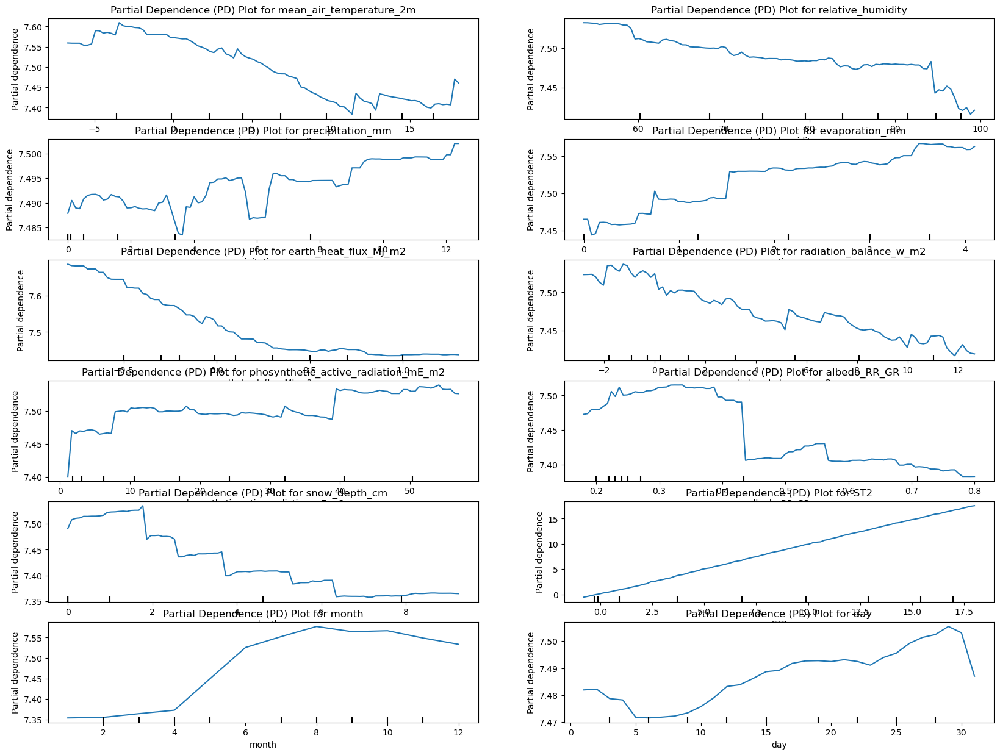

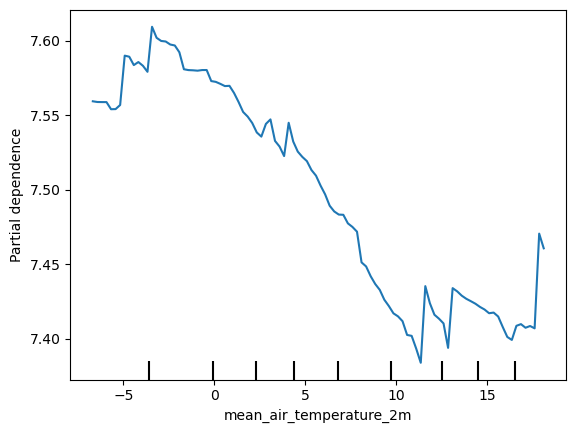

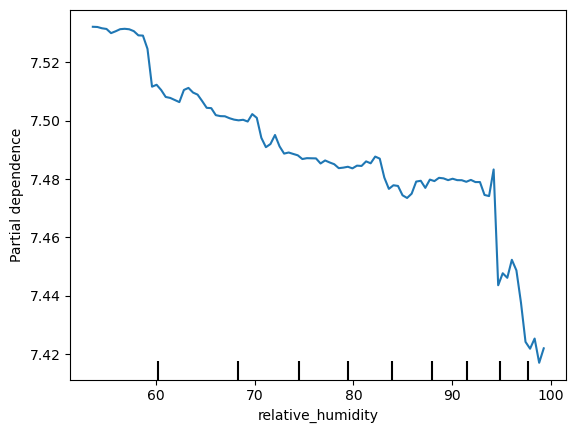

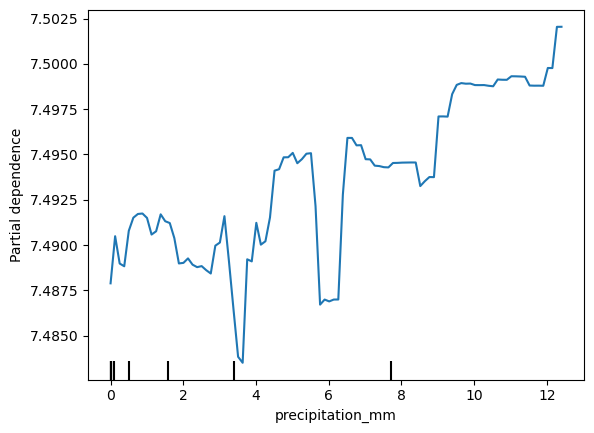

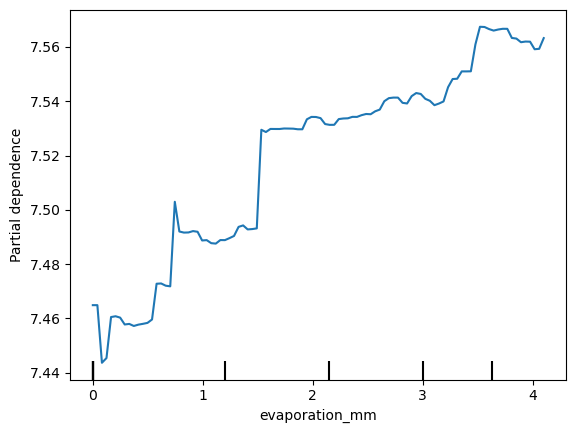

...

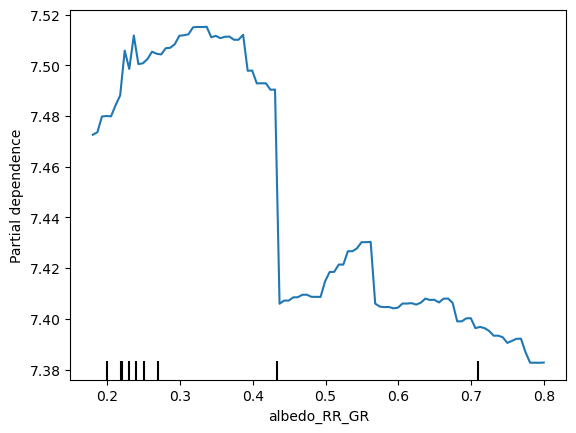

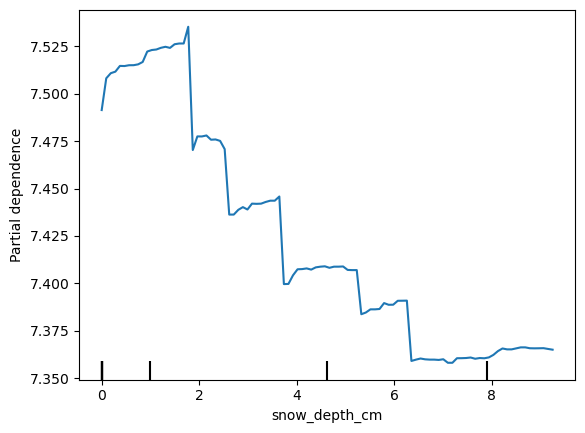

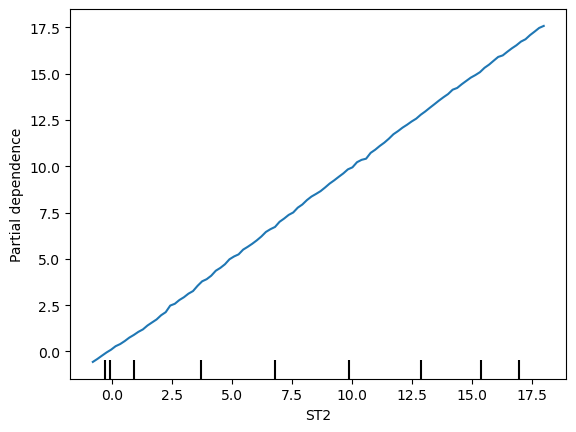

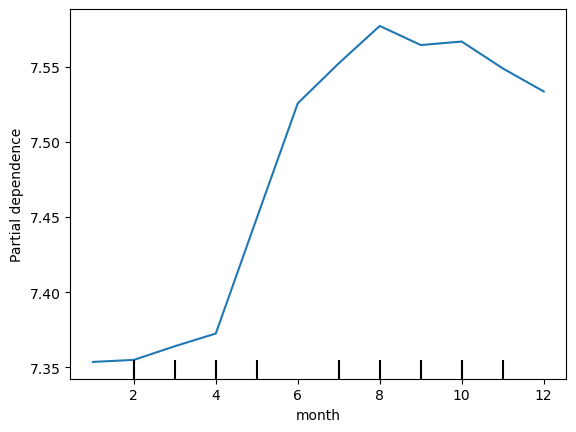

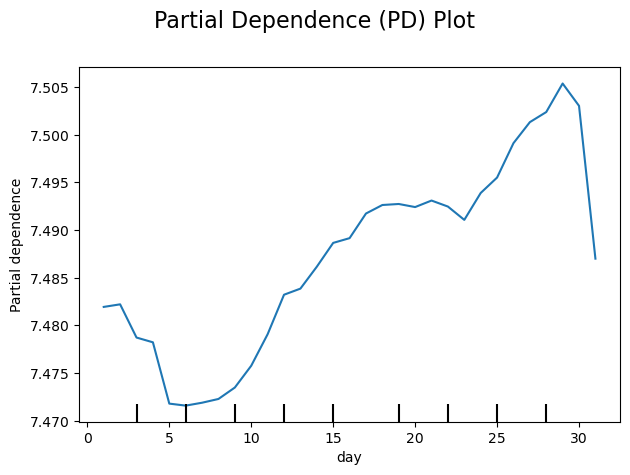

======================== ST5 Individual Conditional Expectation Plot  ===============================


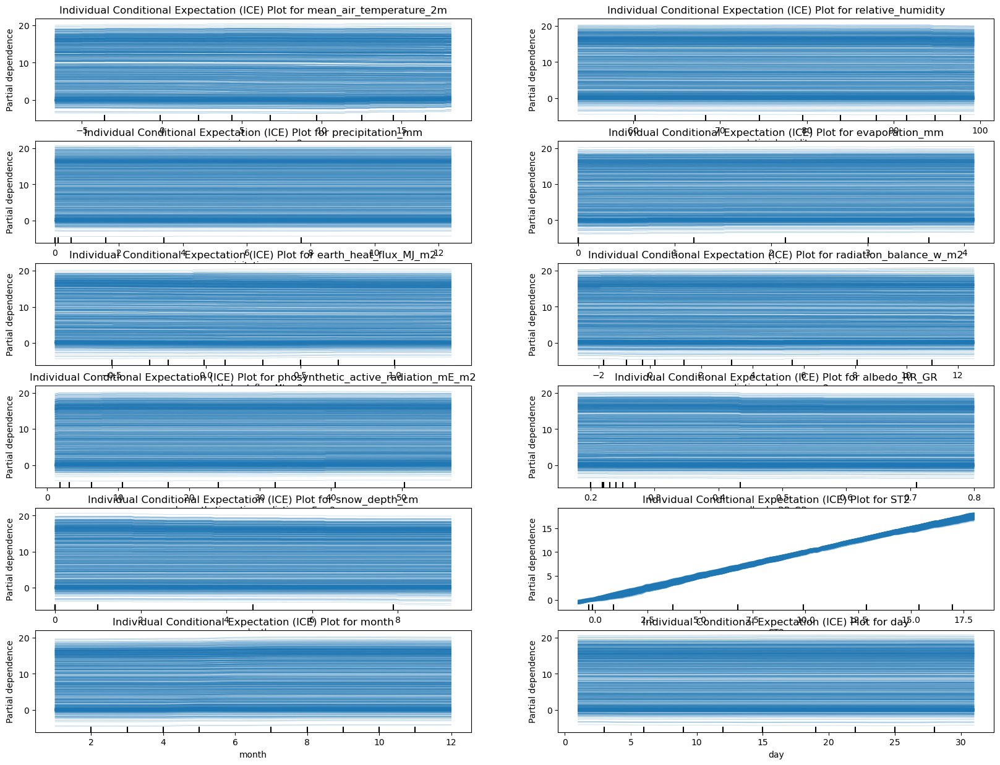

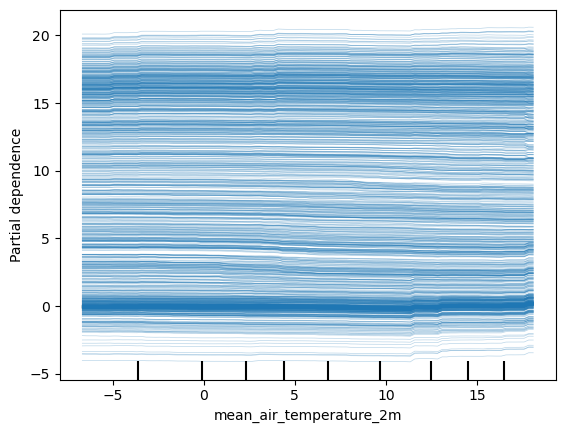

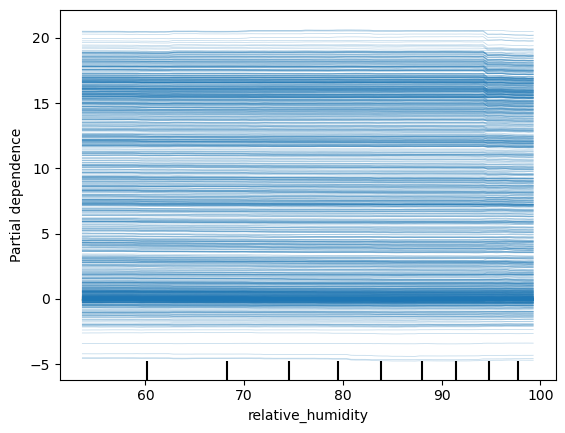

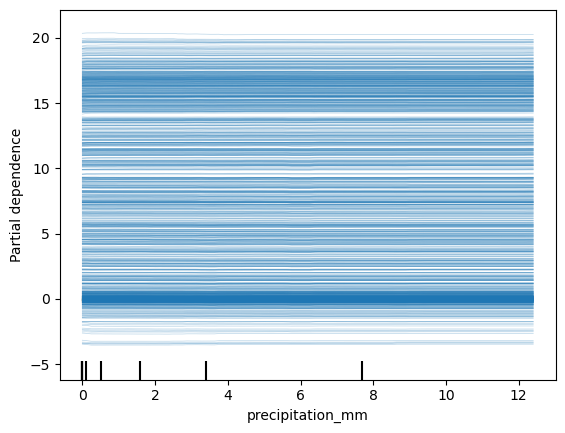

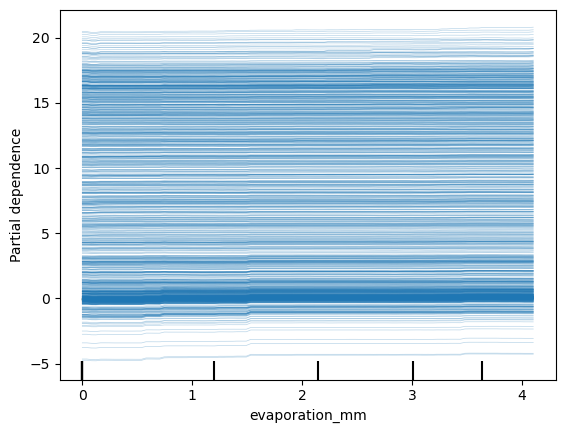

...

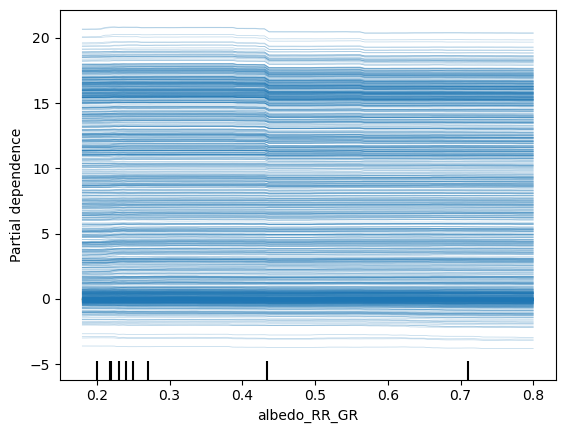

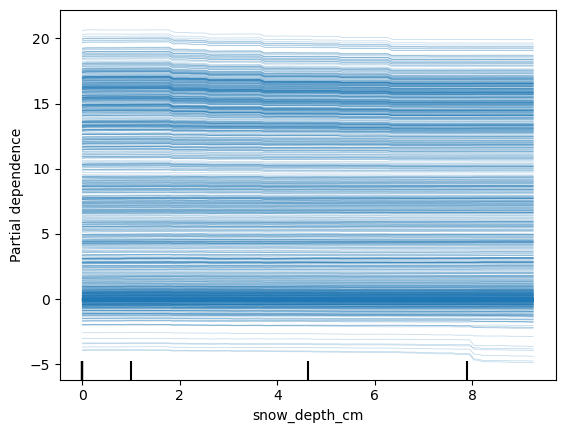

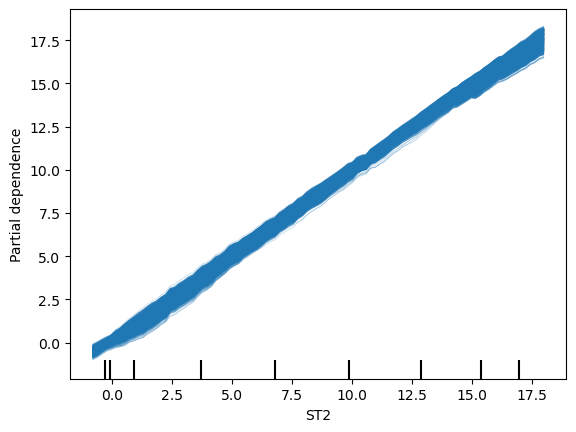

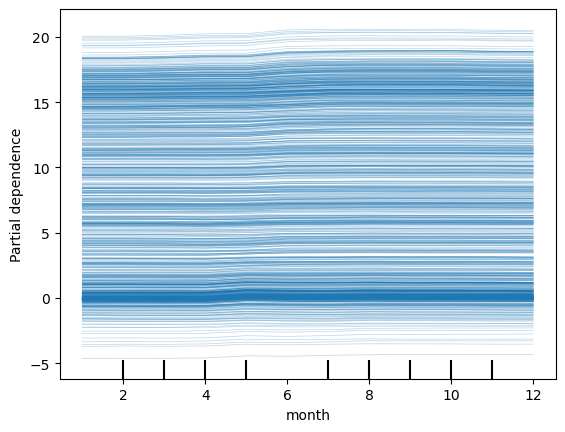

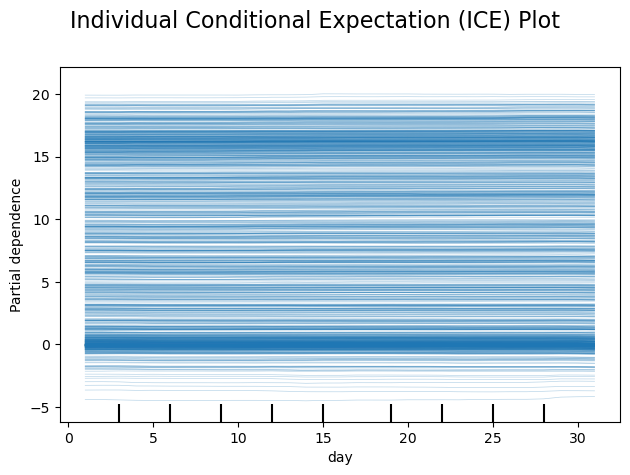

========================= ST5 Residual Analysis Plot ==============================


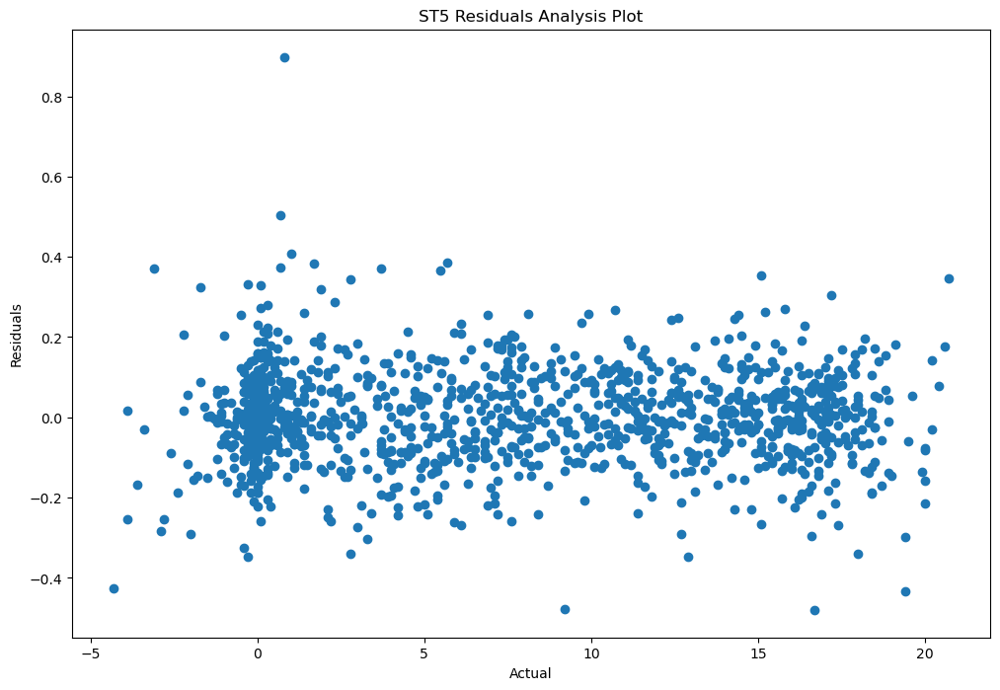

========================= ST5 Q-Q Plot ==============================


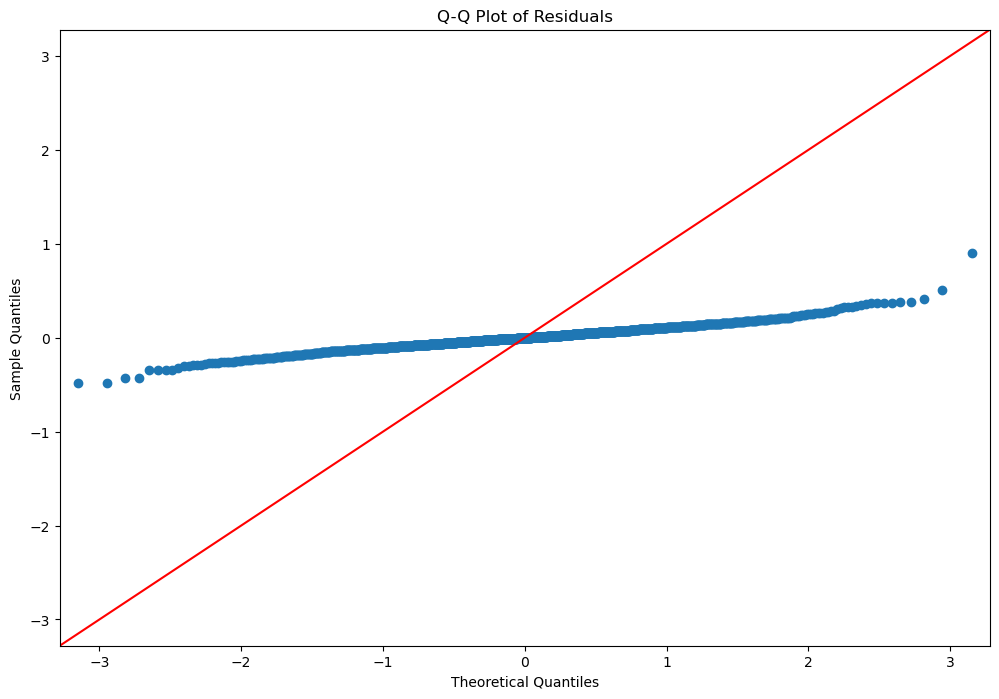

In [171]:
from sklearn.inspection import PartialDependenceDisplay
import statsmodels.api as sm
from pycebox.ice import ice, ice_plot
import matplotlib.pyplot as plt

# Partial Dependence Plot
print('====================================================== ST5 Partial Dependence Plot')
ST5_feature_names = ST5_X_train.columns.tolist()
n_features = len(ST5_feature_names)
n_cols = 2
n_rows = (n_features + n_cols - 1) // n_cols

fig1, ax1 = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 15))
axes_flat = ax1.flatten()

for idx, feature in enumerate(ST5_feature_names):
    display = PartialDependenceDisplay.from_estimator(ST5_stacking_regressor, ST5_X_train, features=[feature])
    display.plot(ax=axes_flat[idx])
    axes_flat[idx].set_title(f'Partial Dependence (PD) Plot for {feature}')
    axes_flat[idx].set_xlabel(feature)

for idx in range(n_features, len(axes_flat)):
    fig1.delaxes(axes_flat[idx])

plt.subplots_adjust(hspace=0.5)
plt.suptitle('Partial Dependence (PD) Plot', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.savefig('images/ST5_final_partial_dependence_plot.png')
plt.show()

# Individual Conditional Expectation Plot (ICE)
print('======================== ST5 Individual Conditional Expectation Plot ===============================')
fig2, axes2 = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 15))
axes_flat2 = axes2.flatten()

for idx, feature in enumerate(ST5_feature_names):
    display = PartialDependenceDisplay.from_estimator(ST5_stacking_regressor, ST5_X_train, features=[feature], kind='individual')
    display.plot(ax=axes_flat2[idx])
    axes_flat2[idx].set_title(f'Individual Conditional Expectation (ICE) Plot for {feature}')
    axes_flat2[idx].set_xlabel(feature)

for idx in range(n_features, len(axes_flat2)):
    fig2.delaxes(axes_flat2[idx])

plt.subplots_adjust(hspace=0.7)
plt.suptitle('Individual Conditional Expectation (ICE) Plot', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.savefig('images/ST5_final_individual_conditional_expectation_plot.png')
plt.show()

# Residual Analysis
print('========================= ST5 Residual Analysis Plot ==============================')
ST5_Y_predictions = ST5_stacking_regressor.predict(ST5_X_test)
ST5_residuals = ST5_Y_test - ST5_Y_predictions

fig3, ax3 = plt.subplots(figsize=(10, 7))
ax3.scatter(ST5_Y_predictions, ST5_residuals)
ax3.set_xlabel('Predictions')
ax3.set_ylabel('Residuals')
ax3.set_title('ST5 Residuals Analysis Plot')
plt.axhline(y=0, color='r', linestyle='--')
plt.savefig('images/ST5_final_residual_analysis_plot.png')
plt.show()

# Residuals vs. Predictor Variables
print('========================= Residuals vs. Predictor Variables ==============================')
for column in ST5_X_test.columns:
    fig, ax = plt.subplots(figsize=(10, 7))
    ax.scatter(ST5_X_test[column], ST5_residuals)
    ax.axhline(y=0, color='r', linestyle='--')
    ax.set_xlabel(column)
    ax.set_ylabel('Residuals')
    ax.set_title(f'Residuals vs. {column}')
    plt.savefig(f'images/ST5_final_residuals_vs_{column}.png')
    plt.show()

# Q-Q Plot
print('========================= ST5 Q-Q Plot ==============================')
fig5, ax5 = plt.subplots(figsize=(10, 7))
sm.qqplot(ST5_residuals, line='45', ax=ax5)
ax5.set_title('Q-Q Plot of Residuals')
plt.savefig('images/ST5_final_Q-Q_plot.png')
plt.show()

# Histogram of residuals
fig6, ax6 = plt.subplots(figsize=(10, 7))
plt.figure(figsize=(10, 6))
sns.histplot(residuals, kde=True, ax=ax6)
plt.xlabel('Residuals')
plt.title('Histogram of Residuals')
plt.show()


### Feature Importance analysis for ST5

In [ ]:
np.random.seed(42)
# Assuming feature_names is a list of your feature names
feature_names = ST5_X_train.columns.tolist()

estimators = [
    ("Random Forest", ST5_rf_model_stack),
    ("Cat Boost", ST5_cb_model_stack),
    ("XG Boost", ST5_xgb_model_stack)
]

# Initialize an array to store aggregated feature importances
num_features = ST5_X_train.shape[1]
feature_importances = np.zeros(num_features, dtype=np.float64)

# Aggregate feature importances from base models
count = 0
for name, model in estimators:
    if hasattr(model, 'feature_importances_'):
        importances = np.array(model.feature_importances_, dtype=np.float64)
        feature_importances += importances
        count += 1
    else:
        print(f"{name} does not have feature_importances_ attribute")

# Normalize the aggregated feature importances
if count > 0:
    feature_importances /= count

# Convert feature importances to percentages
feature_importances_percentage = 100 * (feature_importances / feature_importances.sum())

# Sort the feature importances in descending order
sorted_indices = np.argsort(feature_importances_percentage)[::-1]
sorted_feature_importances_percentage = feature_importances_percentage[sorted_indices]
sorted_feature_names = [feature_names[i] for i in sorted_indices]

# Plot the sorted feature importances
plt.figure(figsize=(8, 5))
bars = plt.barh(sorted_feature_names, sorted_feature_importances_percentage)
plt.xlabel("Aggregated feature importance (%)")
plt.ylabel("Feature Names")
plt.title("Soil Temp (2cm) aggregated feature importances from base estimators")
plt.gca().invert_yaxis()  # Highest importance at the top

# Add annotations to the bars
for bar in bars:
    width = bar.get_width()
    plt.text(
        width + 0.5,  # Offset slightly to the right of the bar
        bar.get_y() + bar.get_height() / 2,  # Vertical center of the bar
        f'{width:.2f}%',  # Display the width (importance value) formatted to 2 decimal places
        va='center'
    )
# Save the figure
plt.tight_layout()
plt.savefig('data/results/ST5_stacking_regressors_feature_importances.png')
plt.show()

plot_features(ST5_X_train.columns, ST5_rf_model_stack.feature_importances_, 'images/ST5_RF_feature_analysis.png', 'ST5 RF Feature Importance Plot')
plot_features(ST5_X_train.columns, ST5_cb_model_stack.feature_importances_/100, 'images/ST5_CB_feature_analysis.png', 'ST5 CB Feature Importance Plot')
plot_features(ST5_X_train.columns, ST5_xgb_model_stack.feature_importances_, 'images/ST5_XGB_feature_analysis.png', 'ST5 XGB Feature Importance Plot')

### GridSearhCV Evaluation for all models used in the stacked regressor for ST5

In [140]:
%%time
import time
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor, HistGradientBoostingRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.model_selection import cross_val_predict, cross_validate
from catboost import CatBoostRegressor



# Define parameter grids for each model
param_grid_cb = {
    'iterations': [100, 200, 500],
    'learning_rate': [0.01, 0.1, 0.05],
    'depth': [4, 6, 10],
    'l2_leaf_reg': [1, 3, 5, 7, 9],
    'border_count': [32, 50, 100]
}
param_grid_rf = {
    'n_estimators': [100, 300, 500],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

param_grid_hgb = {
    'learning_rate': [0.01, 0.1, 0.05],
    'max_iter': [100, 200, 500],
    'max_leaf_nodes': [31, 50, 100],
    'max_depth': [None, 10, 20],
    'min_samples_leaf': [20, 50, 100],
    'l2_regularization': [0, 0.1, 1]
}

param_grid_xgb = {
    'n_estimators': [100, 200, 500],
    'learning_rate': [0.01, 0.1, 0.05],
    'max_depth': [3, 5, 7],
    'subsample': [1.0, 0.8, 0.6],
    'colsample_bytree': [1.0, 0.8, 0.6],
    'gamma': [0, 1, 5],
    'reg_alpha': [0, 0.1, 1],
    'reg_lambda': [1, 0.1, 0.01],
    'tree_method': ['gpu_hist']  # Use GPU
}
param_grid_ada = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.05],
    'loss': ['linear', 'square', 'exponential']
}
# stacking_param_grid ={
#     'rf__n_estimators': [100, 300, 500],
#     'rf__max_depth': [None, 10, 20, 30],
#     'hgb__learning_rate': [0.01, 0.1, 0.05],
#     'hgb__max_iter': [100, 200, 500],
#     'catboost__iterations': [100, 200, 500],
#     'catboost__learning_rate': [0.01, 0.1, 0.05],
#     'catboost__depth': [4, 6, 10],
#     'xgb__n_estimators': [100, 200],
#     'xgb__max_depth': [3, 5]
# }


# Initialize models
cb = CatBoostRegressor(random_state=42)
rf = RandomForestRegressor(random_state=42)
hgb = HistGradientBoostingRegressor(random_state=42)
ada = AdaBoostRegressor(random_state=42)
xgb = XGBRegressor(random_state=42, objective='reg:squarederror')

# estimators = [
#     ('rf', RandomForestRegressor()),
#     ('cb', CatBoostRegressor()),
#     ('hgb', HistGradientBoostingRegressor()),    
#     ('xgb', XGBRegressor())
# ]

# stacking_regressor = StackingRegressor(
#     estimators=estimators,
#     final_estimator=RidgeCV()
# )

# Initialize GridSearchCV for RF model
start_time_rf = time.time()
ST5_grid_search_rf = GridSearchCV(estimator=rf, param_grid=param_grid_rf, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_rf_search = time.time()
ST5_grid_search_rf.fit(ST5_X_train, ST5_Y_train)
end_time_rf_fit = time.time()
elapsed_time_search_rf = end_time_rf_search - start_time_rf
elapsed_time_fit_rf = end_time_rf_fit - end_time_rf_search
# Get the best parameters and scores
print("Best parameters for RandomForestRegressor:", ST5_grid_search_rf.best_params_)
print("Best score for RandomForestRegressor:", -ST5_grid_search_rf.best_score_)
print("RandomForestRegressor GridSearchCV Time:", elapsed_time_search_rf)
print("RandomForestRegressor Fitting Time:", elapsed_time_fit_rf)

# Initialize GridSearchCV for HGB model
start_time_hgb = time.time()
ST5_grid_search_hgb = GridSearchCV(estimator=hgb, param_grid=param_grid_hgb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_hgb_search = time.time()
ST5_grid_search_hgb.fit(ST5_X_train, ST5_Y_train)
end_time_hgb_fit = time.time()
elapsed_time_search_hgb = end_time_hgb_search - start_time_hgb
elapsed_time_fit_hgb = end_time_hgb_fit - end_time_hgb_search
# Get the best parameters and scores
print("Best parameters for HistGradientBoostingRegressor:", ST5_grid_search_hgb.best_params_)
print("Best score for HistGradientBoostingRegressor:", -ST5_grid_search_hgb.best_score_)
print("HistGradientBoostingRegressor GridSearchCV Time:", elapsed_time_search_hgb)
print("HistGradientBoostingRegressor Fitting Time:", elapsed_time_fit_hgb)

# Initialize GridSearchCV for XGB model
# start_time_xgb = time.time()
# ST5_grid_search_xgb = GridSearchCV(estimator=xgb, param_grid=param_grid_xgb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
# end_time_xgb_search = time.time()
# ST5_grid_search_xgb.fit(ST5_X_train, ST5_Y_train)
# end_time_xgb_fit = time.time()
# elapsed_time_search_xgb = end_time_xgb_search - start_time_xgb
# elapsed_time_fit_xgb = end_time_xgb_fit - end_time_xgb_search
# # Get the best parameters and scores
# print("Best parameters for XGBRegressor:", ST5_grid_search_xgb.best_params_)
# print("Best score for XGBRegressor:", -ST5_grid_search_xgb.best_score_)
# print("XGBRegressor GridSearchCV Time:", elapsed_time_search_xgb)
# print("XGBRegressor Fitting Time:", elapsed_time_fit_xgb)

# Initialize GridSearchCV for ADA model
start_time_ada = time.time()
ST5_grid_search_ada = GridSearchCV(estimator=ada, param_grid=param_grid_ada, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_ada_search = time.time()
ST5_grid_search_ada.fit(ST5_X_train, ST5_Y_train)
end_time_ada_fit = time.time()
elapsed_time_search_ada = end_time_ada_search - start_time_ada
elapsed_time_fit_ada = end_time_ada_fit - end_time_ada_search
# Get the best parameters and scores
print("Best parameters for AdaBoostRegressor:", ST5_grid_search_ada.best_params_)
print("Best score for AdaBoostRegressor:", -ST5_grid_search_ada.best_score_)
print("AdaBoostRegressor GridSearchCV Time:", elapsed_time_search_ada)
print("AdaBoostRegressor Fitting Time:", elapsed_time_fit_ada)

# Initialize GridSearchCV for CB model
# start_time_cb = time.time()
# ST5_grid_search_cb = GridSearchCV(estimator=cb, param_grid=param_grid_cb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
# end_time_cb_search = time.time()
# ST5_grid_search_cb.fit(ST5_X_train, ST5_Y_train)
# end_time_cb_fit = time.time()
# elapsed_time_search_cb = end_time_cb_search - start_time_cb
# elapsed_time_fit_cb = end_time_cb_fit - end_time_cb_search
# # Get the best parameters and scores
# print("Best parameters for CatBoostRegressor:", ST5_grid_search_cb.best_params_)
# print("Best score for CatBoost:", -ST5_grid_search_cb.best_score_)
# print("CatBoostRegressor GridSearchCV Time:", elapsed_time_search_cb)
# print("CatBoostRegressor Fitting Time:", elapsed_time_fit_cb)

# # Initialize GridSearchCV for Stacking model
# start_time_stacking = time.time()
# ST5_grid_search_stacking = GridSearchCV(estimator=stacking_regressor, param_grid=stacking_param_grid, cv=5, n_jobs=-1, verbose=0,scoring='neg_mean_absolute_error')
# end_time_stacking_search = time.time()
# ST5_grid_search_stacking.fit(ST5_X_train, ST5_Y_train)
# end_time_stacking = time.time()
# elapsed_time_search_stacking = end_time_stacking_search - start_time_stacking
# elapsed_time_fit_stacking = end_time_stacking_fit - end_time_stacking_search

# print("Best parameters for StackingRegressor:", ST5_grid_search_stacking.best_params_)
# print("Best score for StackingRegressor:", -ST5_grid_search_stacking.best_score_)
# print("StackingRegressor GridSearchCV Time:", elapsed_time_search_stacking)
# print("StackingRegressor Fitting Time:", elapsed_time_fit_stacking)

# Define the results of print statements as variables
# ST5_grid_search_and_fitting_results = {
#     'Model': ['RandomForestRegressor', 'HistGradientBoostingRegressor', 'AdaBoostRegressor', 'XGBRegressor'],
#     'Best Parameters': [ST5_grid_search_rf.best_params_, ST5_grid_search_hgb.best_params_, ST5_grid_search_ada.best_params_, ST5_grid_search_xgb.best_params_],
#     'Best Score': [-ST5_grid_search_rf.best_score_, -ST5_grid_search_hgb.best_score_, -ST5_grid_search_ada.best_score_, -ST5_grid_search_xgb.best_score_],
#     'GridSearchCV Time': [elapsed_time_search_rf, elapsed_time_search_hgb, elapsed_time_search_ada, elapsed_time_search_xgb],
#     'Fitting Time': [elapsed_time_fit_rf, elapsed_time_fit_hgb, elapsed_time_fit_ada, elapsed_time_fit_xgb]
# }

# # Create a DataFrame
# df_results = pd.DataFrame(ST5_grid_search_and_fitting_results)

# # Export DataFrame to Excel
# df_results.to_excel('data/ST5_grid_search_and_fitting_results.xlsx', index=False)

### C. Stacking Regressor for Soil temperature at 10cm

### Correlation analysis

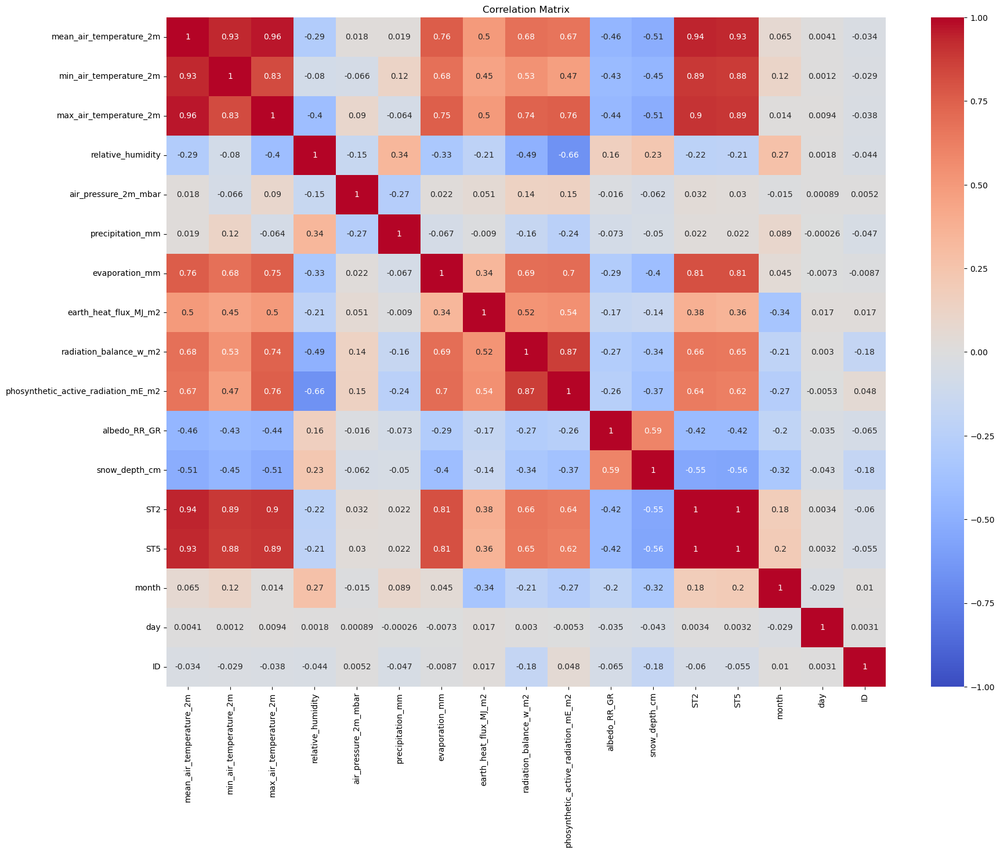

Highly correlated pairs (above threshold):
('mean_air_temperature_2m', 'max_air_temperature_2m')
('ST2', 'ST5')
Removed features: {'max_air_temperature_2m', 'ST5'}
Shape of the reduced dataset: (6168, 15)


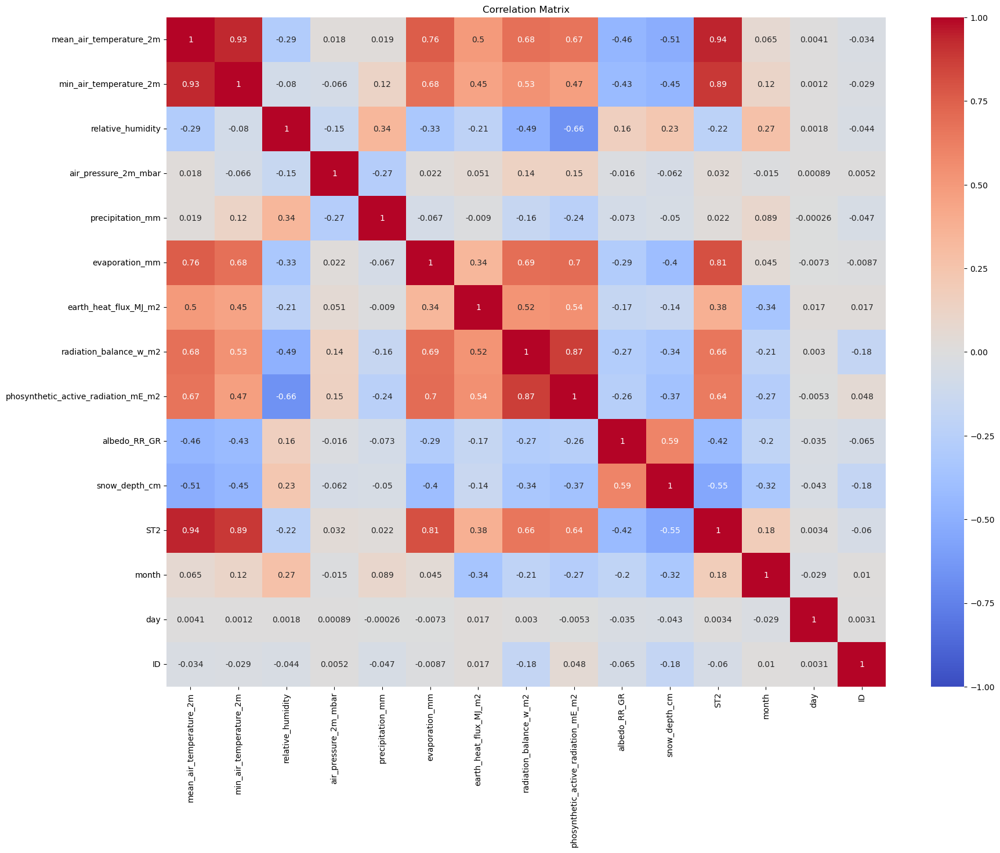

Removing feature 'const' with VIF: 10553.784890987825
Removing feature 'air_pressure_2m_mbar' with VIF: 143.26043313156126
Removing feature 'mean_air_temperature_2m' with VIF: 56.62717887085822
Final VIF data:
                                feature        VIF
0                min_air_temperature_2m   9.077693
1                     relative_humidity  21.368619
2                      precipitation_mm   1.539066
3                        evaporation_mm   6.447378
4                 earth_heat_flux_MJ_m2   2.026112
5                radiation_balance_w_m2   7.068602
6   phosynthetic_active_radiation_mE_m2  12.958266
7                          albedo_RR_GR   8.375646
8                         snow_depth_cm   2.571845
9                                   ST2  28.132252
10                                month  10.048309
11                                  day   4.076804


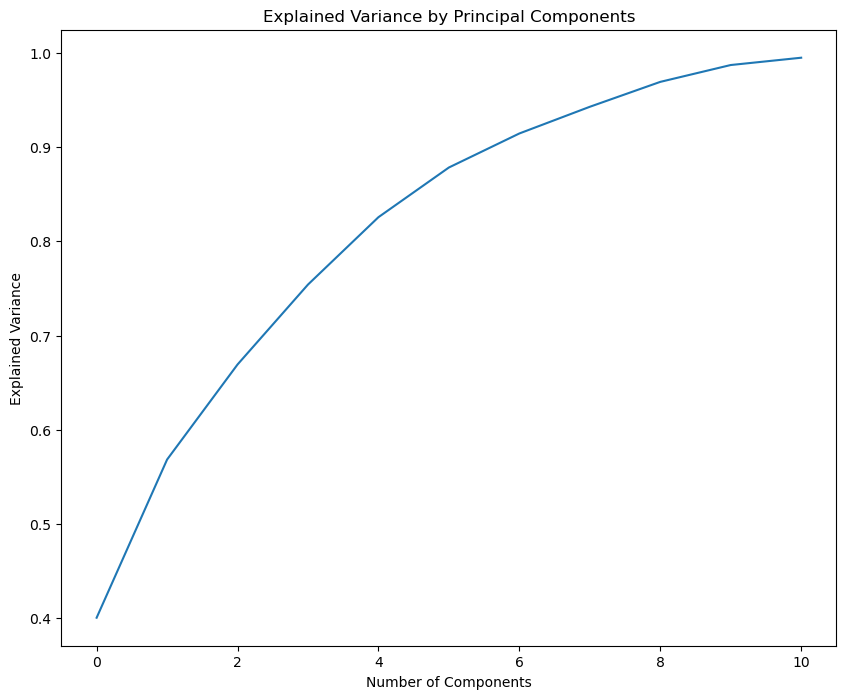

In [206]:
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Calculate the covariance matrix for target ST100
ST10_dataset_correlation = ST10_clean_dataset_denormalized.drop(['ST100', 'ST50','ST20','ST10'], axis=1)
ST10_covariance_matrix = ST10_dataset_correlation.cov()

# Calculate the correlation matrix
ST10_correlation_matrix = ST10_dataset_correlation.corr()

# Visualize the correlation matrix
plt.figure(figsize=(20, 15))
sns.heatmap(ST10_correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.savefig("images/ST10_denormalized_before_correlation_matrix.png")
plt.show()

# Set the threshold
threshold = 0.95
# Find pairs of features with correlation above the threshold
highly_correlated = np.where(np.abs(ST10_correlation_matrix) > threshold)
highly_correlated_pairs = [(ST10_correlation_matrix.index[x], ST10_correlation_matrix.columns[y]) 
                           for x, y in zip(*highly_correlated) if x != y and x < y]

print("Highly correlated pairs (above threshold):")
for pair in highly_correlated_pairs:
    print(pair)
# Example: Removing one feature from each highly correlated pair
features_to_remove = set()
for pair in highly_correlated_pairs:
    features_to_remove.add(pair[1])  # You can choose to remove pair[0] or pair[1]

# Drop the features from the dataframe
ST10_dataset_denormalized_outlier_filtered_uncorrelated = ST10_dataset_correlation.drop(columns=features_to_remove)

print(f"Removed features: {features_to_remove}")
print("Shape of the reduced dataset:", ST10_dataset_denormalized_outlier_filtered_uncorrelated.shape)

# After removing the correlated features
# Calculate the correlation matrix
ST10_correlation_matrix_new = ST10_dataset_denormalized_outlier_filtered_uncorrelated.corr()

# Visualize the correlation matrix
plt.figure(figsize=(20, 15))
sns.heatmap(ST10_correlation_matrix_new, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.savefig("images/ST10_denormalized_after_correlation_matrix.png")
plt.show()

# Assuming dataset_denormalized_outlier_filtered is your DataFrame
ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = ST10_dataset_denormalized_outlier_filtered_uncorrelated.copy()

# Add a constant term for the intercept
ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = sm.add_constant(ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif)
ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop('ID', axis=1, inplace=True)

# Function to calculate VIF
def calculate_vif(data):
    vif_data = pd.DataFrame()
    vif_data["feature"] = data.columns
    vif_data["VIF"] = [variance_inflation_factor(data.values, i) for i in range(data.shape[1])]
    return vif_data

# Iteratively remove features with VIF above the threshold
def remove_high_vif_features(data, threshold=40.0):
    while True:
        vif_data = calculate_vif(data)
        max_vif = vif_data['VIF'].max()
        if max_vif > threshold:
            # Identify the feature with the highest VIF
            feature_to_remove = vif_data.sort_values('VIF', ascending=False)['feature'].iloc[0]
            print(f"Removing feature '{feature_to_remove}' with VIF: {max_vif}")
            data = data.drop(columns=[feature_to_remove])
        else:
            break
    return data, vif_data

# Remove high VIF features
ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif, ST10_final_vif_data = remove_high_vif_features(ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif)

print("Final VIF data:")
print(ST10_final_vif_data)
ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ID'] = ST10_clean_dataset_denormalized['ID']
ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ST10'] = ST10_clean_dataset_denormalized['ST10']
ST10_dataset_denormalized_outlier_filtered_uncorrelated['ID'] = ST10_clean_dataset_denormalized['ID']
ST10_dataset_denormalized_outlier_filtered_uncorrelated['ST10'] = ST10_clean_dataset_denormalized['ST10']
# Remove the constant term before creating the final DataFrame
if 'const' in ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.columns:
    ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop(columns=['const'])

# Store the 'ID' and 'ST10' columns with their corresponding index before PCA
ID_index_mapping = ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ID']
ST10_index_mapping = ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ST10']

# Assume X is your feature dataframe
ST10_X_pca = ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop(['ST10', 'ID'], axis=1)

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(ST10_X_pca)

# Apply PCA
pca = PCA(n_components=0.99)  # Choose the number of components
principal_components = pca.fit_transform(X_scaled)

# Create a DataFrame with the principal components
ST10_pca_df = pd.DataFrame(data=principal_components, columns=[f"PC{i}" for i in range(principal_components.shape[1])])

# Merge PCA DataFrame with original DataFrame to maintain original index order
ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca = pd.merge(ID_index_mapping, ST10_index_mapping, left_index=True, right_index=True)
ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca = pd.merge(ST10_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca, ST10_pca_df, left_index=True, right_index=True)

# Plot the explained variance
plt.figure(figsize=(10,8))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Explained Variance')
plt.title('Explained Variance by Principal Components')
plt.savefig('images/ST10_PCA_analysis.png')
plt.show()


### Option 1: Dataset used is after correlation analysis

====================Random Forest The Evaluation Metrics Results For ST10 Denormalized =======================

Out of Bag Score:  0.16790942850019297
{'Validation Set R^2 Score': 0.17234183761470867, 'Validation Set MAE': 5.31099903858969, 'Validation Set MSE': 36.47643039005647, 'Validation Set Median Absolute Error': 5.294272727272727, 'Validation Set Max Error': 14.243, 'Validation Set Explained Variance Score': 0.1731018996358049}

====================CatBoost The Evaluation Metrics Results For ST10 Denormalized =======================

{'Validation Set R^2 Score': 0.17343662229486967, 'Validation Set MAE': 5.2208440817823085, 'Validation Set MSE': 36.428181198551, 'Validation Set Median Absolute Error': 5.135168897964901, 'Validation Set Max Error': 15.309302914770804, 'Validation Set Explained Variance Score': 0.1747829949324886}

====================Random Forest The Evaluation Metrics Results For ST10 Denormalized =======================

{'Validation Set R^2 Score': 0.2064241

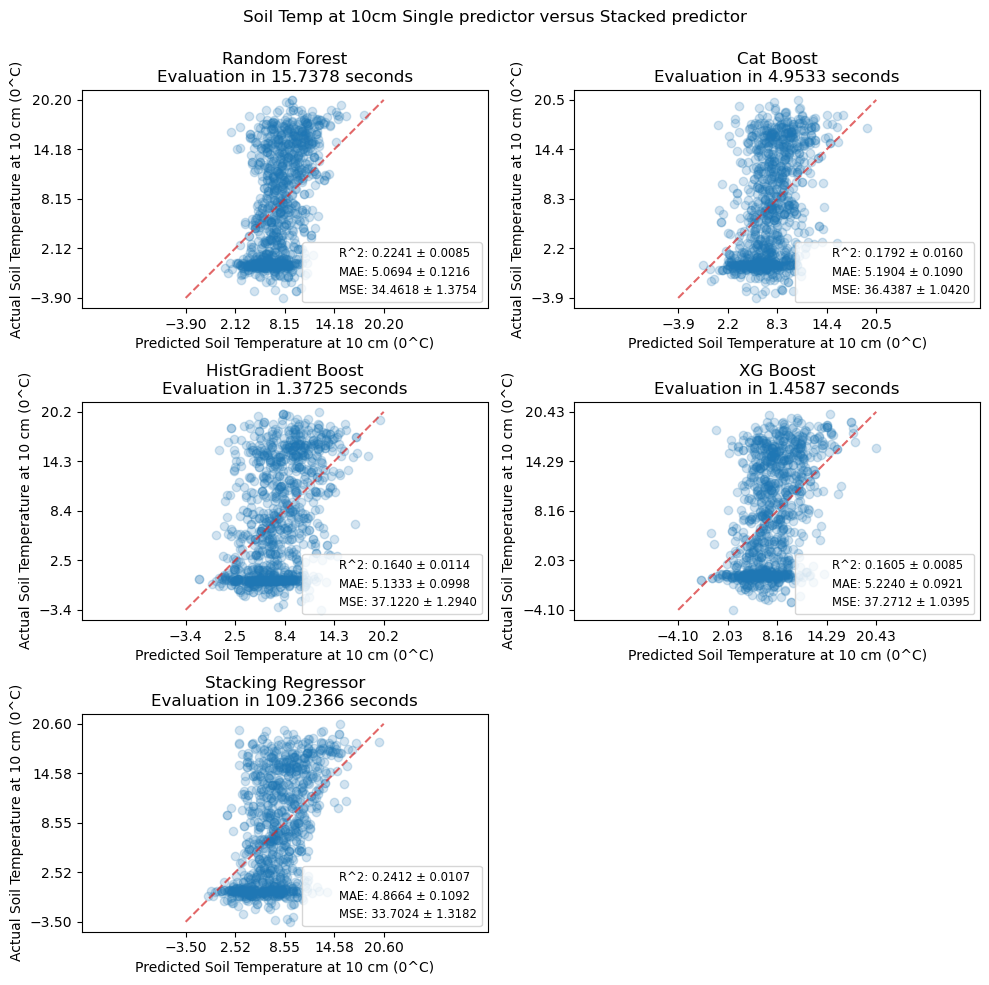

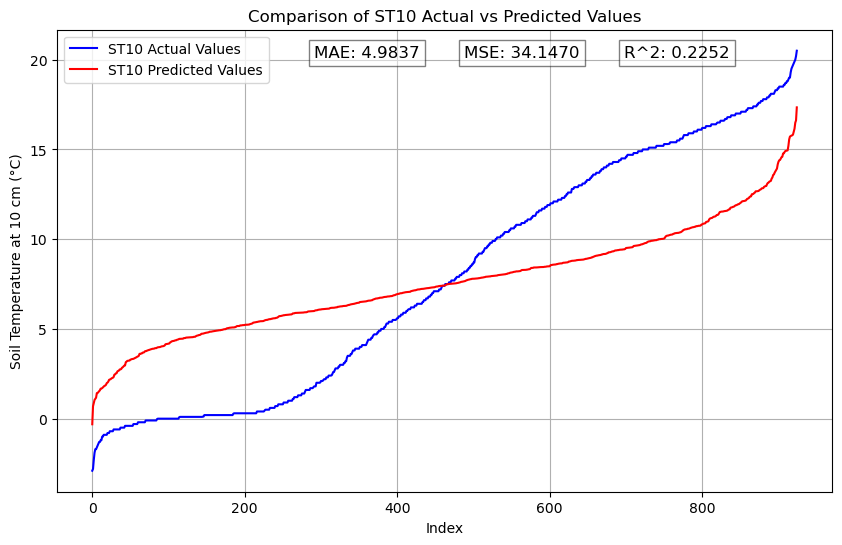

CPU times: total: 2min 24s
Wall time: 4min 54s


In [207]:
%%time
import numpy as np
from sklearn.linear_model import LassoCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.metrics import PredictionErrorDisplay
from sklearn.model_selection import cross_val_predict, cross_validate
import time

np.random.seed(42)
  
# Create function to evaluate model on few different levels
def show_scores(model, X_train, X_valid, Y_train, Y_valid, target='ST10', model_name='RF'):
    """
    Calculates and shows the different sklearn evaluation metrics
        
    Parameters:
        model: the model fitted.
        X_train: the input training set.
        X_valid: the input validation or test set.
        Y_train: the target training set.
        Y_valid: the target validation or test set.
            
    Returns:
        scores: the dictionary of the calculated sklearn metrics for train and valid sets.
    """
    
    train_preds = model.predict(X_train)
    val_preds = model.predict(X_valid)
    scores = {
              # "Training Set R^2 Score": r2_score(Y_train, train_preds),
              "Validation Set R^2 Score":r2_score(Y_valid, val_preds),
              # "Training Set MAE": mean_absolute_error(Y_train, train_preds),
              "Validation Set MAE": mean_absolute_error(Y_valid, val_preds),             
              # "Training Set MSE": mean_squared_error(Y_train, train_preds),
              "Validation Set MSE": mean_squared_error(Y_valid, val_preds),
              # "Training Set Median Absolute Error": median_absolute_error(Y_train, train_preds),
              "Validation Set Median Absolute Error": median_absolute_error(Y_valid, val_preds),
              # "Training Set MA Percentage Error": mean_absolute_percentage_error(Y_train, train_preds),
              # "Validation Set MA Percentage Error": mean_absolute_percentage_error(Y_valid, val_preds),
              # "Training Set Max Error": max_error(Y_train, train_preds),
              "Validation Set Max Error": max_error(Y_valid, val_preds),
              # "Training Set Explained Variance Score": explained_variance_score(Y_train, train_preds),
              "Validation Set Explained Variance Score": explained_variance_score(Y_valid, val_preds)}
    # Convert the dictionary to a DataFrame
    df = pd.DataFrame(list(scores.items()), columns=['Metric', 'Value'])    
    # Export the DataFrame to an Excel file
    df.to_excel(f'data/results/{target}_{model_name}_scores.xlsx', index=False)
    return scores

# Define a function that takes test set and validation sets as input and generates prediction curve and returns test set prediction data 
def predict_plot(model, ST_X_test, ST_X_validation, ST_Y_validation, name):
    # Predict the test set which is forecast data
    ST_Y_test_preds = model.predict(ST_X_test)
    # Changes the predicted array values to pandas series
    ST_Y_test_preds_series = pd.Series(ST_Y_test_preds, name=name) 
    # Convert the Series to a DataFrame
    ST_Y_test_preds_df = ST_Y_test_preds_series.to_frame()
    ST_Y_test_preds_df.index =  ST_X_test.index
    # Predict the validation set
    ST_Y_validation_preds = model.predict(ST_X_validation)
    # Change validation predictions to pandas series
    ST_Y_validation_preds_series = pd.Series(ST_Y_validation_preds)
    # Make the original and predicted series to have the same index
    ST_Y_validation_preds_series.index =ST_Y_validation.index
    # Sort Y_valid and Y_valid_preds in ascending order and reset indices
    ST_Y_validation_sorted = ST_Y_validation.sort_values().reset_index(drop=True)
    ST_Y_validation_preds_sorted = ST_Y_validation_preds_series[ST_Y_validation.index].sort_values().reset_index(drop=True)
  
    # Calculate mean absolute error
    ST_mae = mean_absolute_error(ST_Y_validation,ST_Y_validation_preds)
    # Calculate mean squared error
    ST_mse = mean_squared_error(ST_Y_validation,ST_Y_validation_preds)
    # Calculate the R^2 score
    ST_r2_score = r2_score(ST_Y_validation,ST_Y_validation_preds)
    # Plot the sorted values
    plt.figure(figsize=(10, 6))
    plt.plot(ST_Y_validation_sorted.index,ST_Y_validation_sorted, color='blue', label=f'{name} Actual Values')
    plt.plot(ST_Y_validation_preds_sorted.index,ST_Y_validation_preds_sorted, color='red', label=f'{name} Predicted Values')
    # Display the mean absolute error as text annotation
    plt.text(0.4, 0.95, f'MAE: {ST_mae:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.text(0.6, 0.95, f'MSE: {ST_mse:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.text(0.8, 0.95, f'R^2: {ST_r2_score:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.xlabel('Index')
    plt.ylabel(f'Soil Temperature at 10 cm (°C)')
    plt.title(f'Comparison of {name} Actual vs Predicted Values')
    plt.legend()
    plt.grid(True)
    plt.savefig(f'data/results/{name}_predicted_vs_actual_values_line_plot.png')  # Save as PNG format
    plt.show()
    return ST_Y_test_preds_df
    
# Let us shuffle the entire dataset so that it is randomly arranged
dataset_shuffled = ST10_dataset_denormalized_outlier_filtered_uncorrelated.sample(frac=1)
# Split the dataset into features and target
many_features_dropped = ['earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','ST100','ST50','ST20','ST10','ST2','ID']
soil_features_dropped = ['ST100','ST50','ST20','ST10','ID']
uncorrelated_dropped = ['ST10','ID']
# ST10_X = dataset_shuffled.drop(many_features_dropped, axis=1)
ST10_X = dataset_shuffled.drop(uncorrelated_dropped, axis=1)
ST10_Y = dataset_shuffled['ST10']

# Split the dataset in to features (independent variables) and labels(dependent variable = target_soil_temperature_2cm ).
# Then split into train, validation and test sets
train_split = round(0.7*len(dataset_shuffled)) # 70% for train set
valid_split = round(train_split + 0.15*len(dataset_shuffled))
ST10_X_train, ST10_Y_train = ST10_X[:train_split], ST10_Y[:train_split]
ST10_X_valid, ST10_Y_valid =ST10_X[train_split:valid_split], ST10_Y[train_split:valid_split]
ST10_X_test, ST10_Y_test = ST10_X[valid_split:], ST10_Y[valid_split:]

# A. RandomForestRegressor
# Create RF model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST10_rf_model = RandomForestRegressor(n_jobs=-1, random_state=42, oob_score=True)
# Fit the model for ST10 to start with
ST10_rf_model.fit(ST10_X_train, ST10_Y_train)
# Show the scoring metrics for this model
print("====================Random Forest The Evaluation Metrics Results For ST10 Denormalized =======================\n")
# Access the OOB Score
oob_score = ST10_rf_model.oob_score_
print('Out of Bag Score: ', oob_score)
print(show_scores(ST10_rf_model, ST10_X_train, ST10_X_valid, ST10_Y_train, ST10_Y_valid))
print("==================================================================================================\n")

# A. CatBoostRegressor (CB)
# Create CB model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST10_cb_model = CatBoostRegressor(iterations=500,
                                learning_rate=0.1,
                                depth=6,
                                l2_leaf_reg=3,
                                loss_function='RMSE',
                                silent=True,
                                random_state=42)
# Fit the model for ST10 to start with
ST10_cb_model.fit(ST10_X_train, ST10_Y_train, eval_set=(ST10_X_valid, ST10_Y_valid), early_stopping_rounds=100)
# Show the scoring metrics for this model
print("====================CatBoost The Evaluation Metrics Results For ST10 Denormalized =======================\n")

print(show_scores(ST10_cb_model, ST10_X_train, ST10_X_valid, ST10_Y_train, ST10_Y_valid, 'ST10', 'CB'))
print("==================================================================================================\n")

# B. RandomForestRegressor
# Create RF model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST10_rf_model = RandomForestRegressor(n_estimators=300, 
                                     min_samples_leaf=1,
                                     min_samples_split=2,
                                     max_features='sqrt',
                                     max_depth=None,
                                     bootstrap=False,
                                     random_state=42)
# Fit the model for ST10 to start with
ST10_rf_model.fit(ST10_X_train, ST10_Y_train)
# Show the scoring metrics for this model
print("====================Random Forest The Evaluation Metrics Results For ST10 Denormalized =======================\n")

print(show_scores(ST10_rf_model, ST10_X_train, ST10_X_valid, ST10_Y_train, ST10_Y_valid,'ST10', 'RF'))
print("==================================================================================================\n")

# C. Histogram Based Gradient Boosting Regressor
# Setup random seed
np.random.seed(42)
# Create Ridge model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST10_gbr_model = HistGradientBoostingRegressor(learning_rate=0.1, 
                                              max_iter=300, 
                                              max_leaf_nodes=41,
                                              random_state=42)
# Fit the ST10 model for soil temp at 100 cm
ST10_gbr_model.fit(ST10_X_train, ST10_Y_train)
# Show the scoring metrics for this model
print("====================The Histogram-Based Gradient Boosting Evaluation Metrics Results For ST10 Denormalized =======================\n")
print(show_scores(ST10_gbr_model, ST10_X_train, ST10_X_valid, ST10_Y_train, ST10_Y_valid,'ST10', 'HGB'))
print("====================================================================================================\n")

# D. XGBoost Regressor
# Setup random seed
np.random.seed(42)
# Create XGBoost for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST10_xgb_model = XGBRegressor(objective='reg:squarederror',
                             learning_rate=0.1, 
                             max_depth=6, 
                             n_estimators=200, 
                             subsample=0.8, 
                             random_state=42)
# Fit the ST10 model for soil temp at 100 cm
ST10_xgb_model.fit(ST10_X_train, ST10_Y_train)
# Show the scoring metrics for this model
print("====================The XGBoost Evaluation Metrics Results For ST10 Denormalized =======================\n")
print(show_scores(ST10_xgb_model, ST10_X_train, ST10_X_valid, ST10_Y_train, ST10_Y_valid,'ST10', 'XGB'))
print("====================================================================================================\n")


# E. AdaBoostRegressor 
# Setup random seed
np.random.seed(42)
# Create AdaBoost Regressor for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST10_adb_model = AdaBoostRegressor(learning_rate=0.1, 
                                  n_estimators=100,
                                  random_state=42)
# Fit the ST10 model for soil temp at 100 cm
ST10_adb_model.fit(ST10_X_train, ST10_Y_train)
# Show the scoring metrics for this model
print("====================The AdaBoost Regressor Evaluation Metrics Results For ST10 Denormalized =======================\n")
print(show_scores(ST10_adb_model, ST10_X_train, ST10_X_valid, ST10_Y_train, ST10_Y_valid,'ST10', 'ADB'))
print("====================================================================================================\n")


# F. Ridge Regressor
# Setup random seed
np.random.seed(42)
# Create Ridge model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST10_rg_model = Ridge(random_state=42)
# Fit the ST10 model for soil temp at 100 cm
ST10_rg_model.fit(ST10_X_train, ST10_Y_train)
# Show the scoring metrics for this model
print("====================The Ridge Regressor Evaluation Metrics Results For ST10 Denormalized =======================\n")
print(show_scores(ST10_rg_model, ST10_X_train, ST10_X_valid, ST10_Y_train, ST10_Y_valid,'ST10', 'RR'))
print("====================================================================================================\n")


# G. Lasso Regressor
# Set up a radom seed
np.random.seed(42)
# Create Lasso model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST10_la_model = Lasso(random_state=42)
# Fit the ST10 model for soil temp at 100cm
ST10_la_model.fit(ST10_X_train, ST10_Y_train)
# Show the scoring metrics for this model
print("====================The Lasso Regressor Evaluation Metrics Results For ST10 Denormalized =======================\n")
print(show_scores(ST10_la_model, ST10_X_train, ST10_X_valid, ST10_Y_train, ST10_Y_valid,'ST10', 'LA'))
print("====================================================================================================\n")

# H. ElasticNet Regressor
# Set up a radom seed
np.random.seed(42)
# Create ElasticNet model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST10_en_model = ElasticNet(random_state=42)
# Fit the ST10 model for soil temp at 100cm
ST10_en_model.fit(ST10_X_train, ST10_Y_train)
# Show the scoring metrics for this model
print("====================The ElasticNet Regressor Evaluation Metrics Results For ST10 Denormalized =======================\n")
print(show_scores(ST10_en_model, ST10_X_train, ST10_X_valid, ST10_Y_train, ST10_Y_valid,'ST10', 'EN'))
print("=========================================================================================================\n")

# I. SVR-L Regressor
# Set up a radom seed
np.random.seed(42)
# Create SVR-L model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST10_svrl_model = SVR(kernel='linear')
# Fit the ST10 model for soil temp at 100cm
ST10_svrl_model.fit(ST10_X_train, ST10_Y_train)
# Show the scoring metrics for this model
print("====================The SVR with linear model Evaluation Metrics Results For ST10 Denormalized =======================\n")
print(show_scores(ST10_svrl_model, ST10_X_train, ST10_X_valid, ST10_Y_train, ST10_Y_valid,'ST10', 'SVR-L'))
print("==========================================================================================================\n")

# J. SVR-R Regressor
# Set up a radom seed
np.random.seed(42)
# Create SVR-R model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST10_svrr_model = SVR(kernel='rbf')
# Fit the ST10 model for soil temp at 100cm
ST10_svrr_model.fit(ST10_X_train, ST10_Y_train)
# Show the scoring metrics for this model
print("====================The SVR with rfb model Evaluation Metrics Results For ST10 Denormalized =======================\n")
print(show_scores(ST10_svrr_model, ST10_X_train, ST10_X_valid, ST10_Y_train, ST10_Y_valid,'ST10', 'SVR-R'))
print("=======================================================================================================\n")


# Stack of predictors on a single data set
rf_regressor = RandomForestRegressor(n_estimators=300, 
                                     min_samples_leaf=1,
                                     min_samples_split=2,
                                     max_features='sqrt',
                                     max_depth=None,
                                     bootstrap=False,
                                     random_state=42)
gbdt_regresssor = HistGradientBoostingRegressor(learning_rate=0.1, 
                                              max_iter=300, 
                                              max_leaf_nodes=41,
                                              random_state=42)
xgb_model = XGBRegressor(objective='reg:squarederror',
                             learning_rate=0.1, 
                             max_depth=6, 
                             n_estimators=200, 
                             subsample=0.8, 
                             random_state=42)
cb_regressor = CatBoostRegressor(iterations=500,
                                learning_rate=0.1,
                                depth=6,
                                l2_leaf_reg=3,
                                loss_function='RMSE',
                                silent=True,
                                random_state=42)
adb_regressor = AdaBoostRegressor(learning_rate=0.1, 
                                  n_estimators=100,
                                  random_state=42)

estimators = [
    ("Random Forest", rf_regressor),
    ("Cat Boost", cb_regressor),
    ("HistGradient Boost", gbdt_regresssor),
    ("XG Boost", xgb_model)
]
ST10_stacking_regressor = StackingRegressor(estimators=estimators, final_estimator=RidgeCV())

# Measure and plot the results
fig, axs = plt.subplots(3, 2, figsize=(10, 10))
axs = np.ravel(axs)

for ax, (name, est) in zip(axs, estimators + [("Stacking Regressor", ST10_stacking_regressor)]):
    scorers = {"R^2": "r2", "MAE": "neg_mean_absolute_error", "MSE":"neg_mean_squared_error"}

    start_time = time.time()
    scores = cross_validate(est, ST10_X, ST10_Y, scoring=list(scorers.values()), n_jobs=-1, verbose=0)
    elapsed_time = time.time() - start_time

    y_pred = cross_val_predict(est, ST10_X, ST10_Y, n_jobs=-1, verbose=0)
    scores = {
        key: (
            f"{np.abs(np.mean(scores[f'test_{value}'])):.4f} ± "
            f"{np.std(scores[f'test_{value}']):.4f}"
        )
        for key, value in scorers.items()
    }

    display = PredictionErrorDisplay.from_predictions(
        y_true=ST10_Y,
        y_pred=y_pred,
        kind="actual_vs_predicted",
        ax=ax,
        scatter_kwargs={"alpha": 0.2, "color": "tab:blue"},
        line_kwargs={"color": "tab:red"},
    )
    ax.set_title(f"{name}\nEvaluation in {elapsed_time:.4f} seconds")
    # Set custom x-label and y-label
    ax.set_xlabel("Predicted Soil Temperature at 10 cm (0^C)")
    ax.set_ylabel("Actual Soil Temperature at 10 cm (0^C)")
    for name, score in scores.items():
        ax.plot([], [], " ", label=f"{name}: {score}")
    ax.legend(loc="best", fontsize='small')
# Hide any unused subplots
for i in range(len(estimators)+1, len(axs)):
    fig.delaxes(axs[i])
plt.suptitle("Soil Temp at 10cm Single predictor versus Stacked predictor")
plt.tight_layout()
plt.subplots_adjust(top=0.9)
plt.savefig('data/results/ST10_stacking_regressors_predicted_actual_values.png')  # Save as PNG format
plt.show()

# Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
ST10_stacking_regressor.fit(ST10_X_train, ST10_Y_train)
ST10_Y_test_preds_df = predict_plot(ST10_stacking_regressor, ST10_X_test, ST10_X_valid, ST10_Y_valid, 'ST10')

### Cross-validation to check stability of the stacking regressor for ST10

In [208]:
import numpy as np
from sklearn.model_selection import cross_val_score, KFold
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error


# Perform k-fold cross-validation
kf = KFold(n_splits=10, shuffle=True, random_state=42)
ST10_cv_scores = cross_val_score(ST10_stacking_regressor, ST10_X_train, ST10_Y_train, cv=kf, scoring='neg_mean_squared_error')

# Convert scores to positive
ST10_cv_scores = -ST10_cv_scores

# Print cross-validation scores
print("Cross-Validation Scores (MSE):", ST10_cv_scores)
print("Mean CV Score (MSE):", np.mean(ST10_cv_scores))
print("Standard Deviation of CV Scores:", np.std(ST10_cv_scores))
# Save the scores to an Excel file
ST10_cv_scores_df = pd.DataFrame(ST10_cv_scores, columns=['MSE'])
ST10_cv_scores_df.to_excel('data/ST10_cv_scores.xlsx', index=False)

##=========== Visualize the problematic Fold using histogram==================
# Calculate mean MSE
ST10_mean_mse = np.mean(ST10_cv_scores)
# Identify the problematic fold
ST10_problematic_fold_index = np.argmax(np.abs(ST10_cv_scores - ST10_mean_mse))
# Get the indices of the data points in the problematic fold
for fold_index, (train_index, test_index) in enumerate(kf.split(ST10_X_train)):
    if fold_index == ST10_problematic_fold_index:
        problematic_fold_train_indices = train_index
        problematic_fold_test_indices = test_index

# Subset the data for the problematic fold
X_problematic_fold = ST10_X_train.iloc[problematic_fold_test_indices]
y_problematic_fold = ST10_Y_train.iloc[problematic_fold_test_indices]
# Visualize or analyze features for the problematic fold
for feature in ST10_X_train.columns:
    plt.figure(figsize=(12, 6))
    # Histogram for the problematic fold
    plt.subplot(1, 2, 1)
    sns.histplot(X_problematic_fold[feature], kde=True, bins=20, color='red')
    plt.title(f'{feature} - Problematic Fold')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    # Histogram for the entire dataset
    plt.subplot(1, 2, 2)
    sns.histplot(ST10_X_train[feature], kde=True, bins=20, color='blue')
    plt.title(f'{feature} - Entire Dataset')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.tight_layout()
    plt.savefig('images/ST10_CV_problematic_fold_vs_main_dataset_histograms.png')
    plt.show()

Cross-Validation Scores (MSE): [35.71642867 33.11060541 33.22147865 37.21588428 34.23018534 35.25508295
 36.92627677 36.48193316 35.22882707 42.97365019]
Mean CV Score (MSE): 36.036035247779374
Standard Deviation of CV Scores: 2.6761629637572524


### Partial Dependence, Individual Conditional Expectation and Residual Analysis Plots for ST10

====================================================== ST10 Partial Dependence Plot


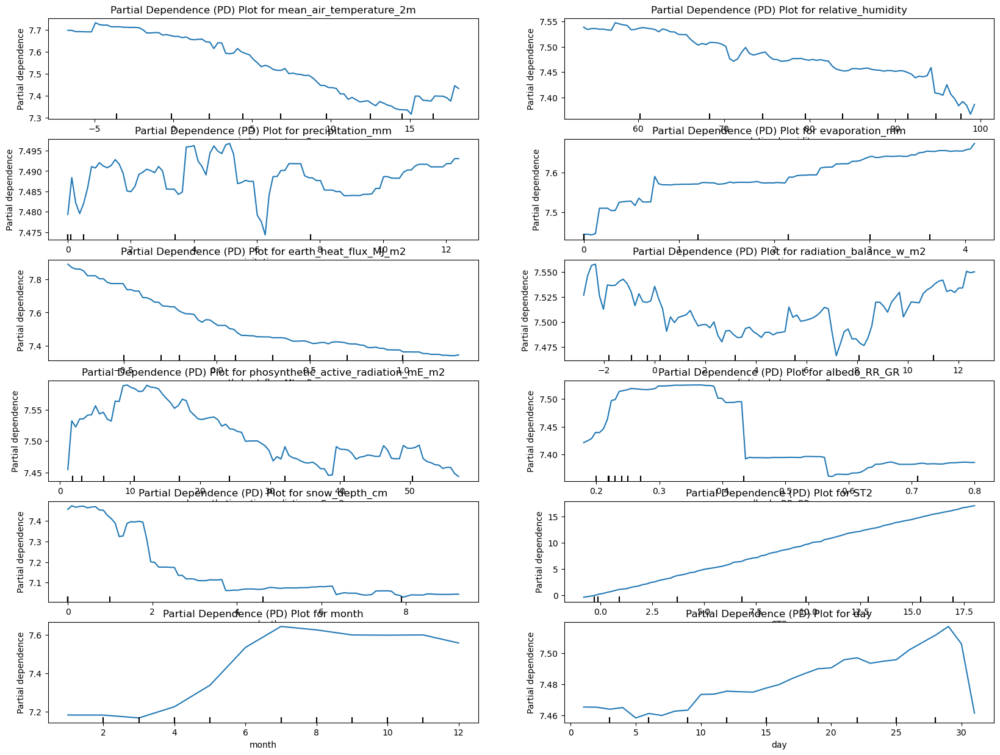

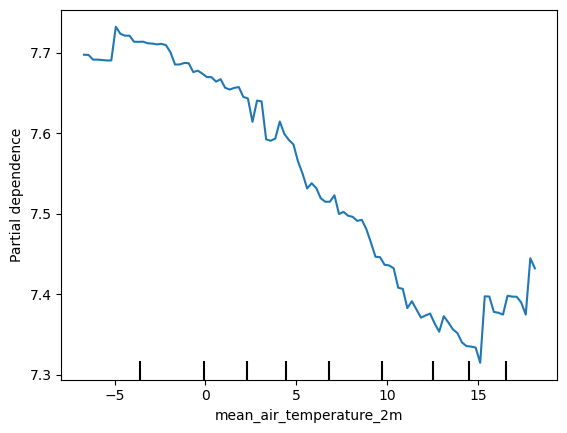

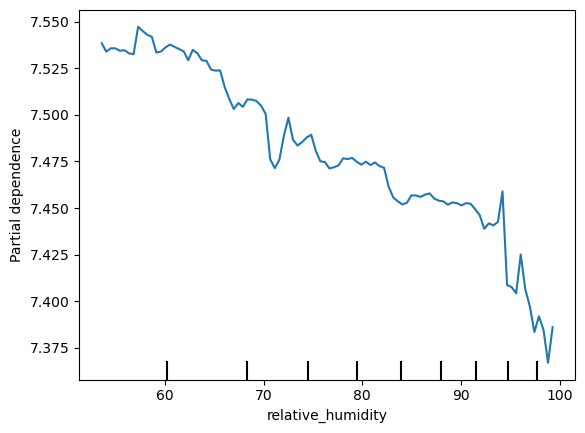

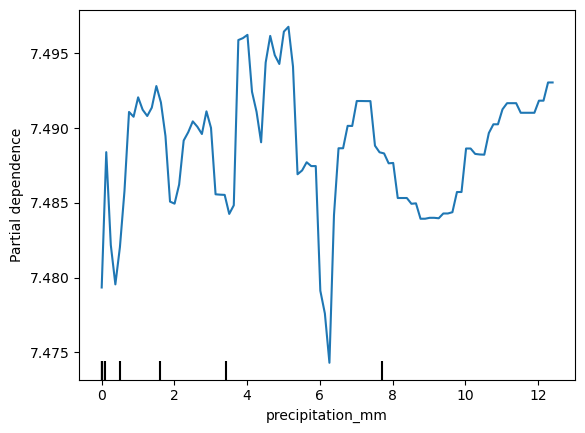

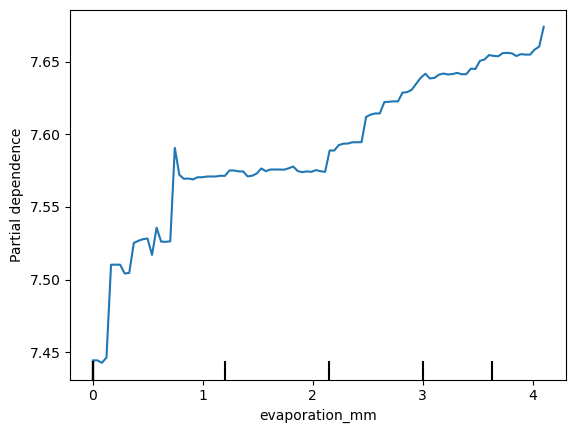

...

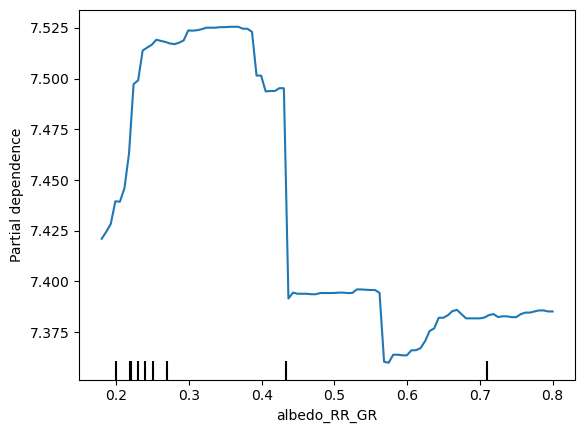

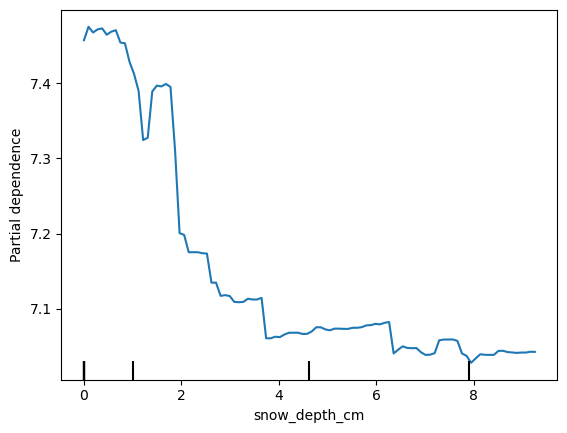

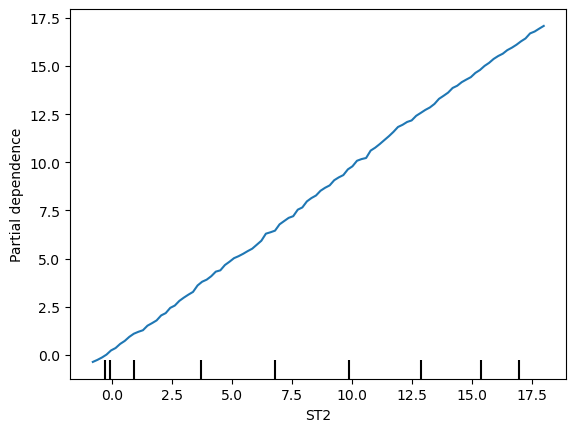

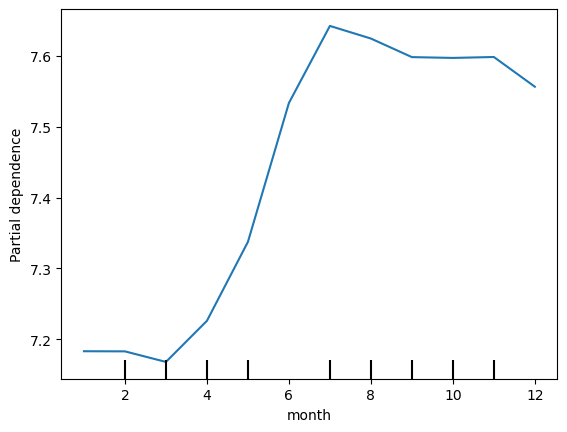

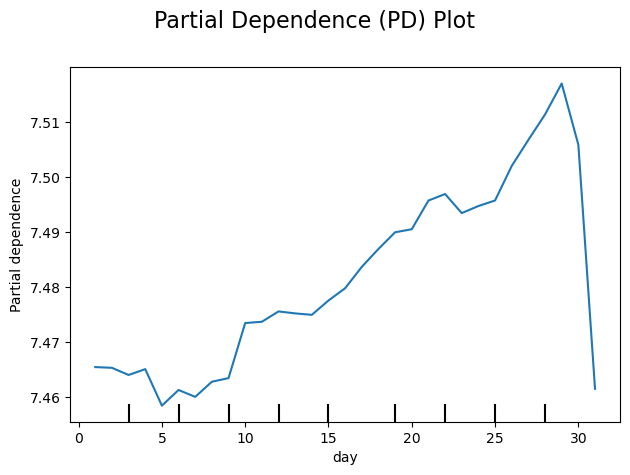

======================== ST10 Individual Conditional Expectation Plot  ===============================


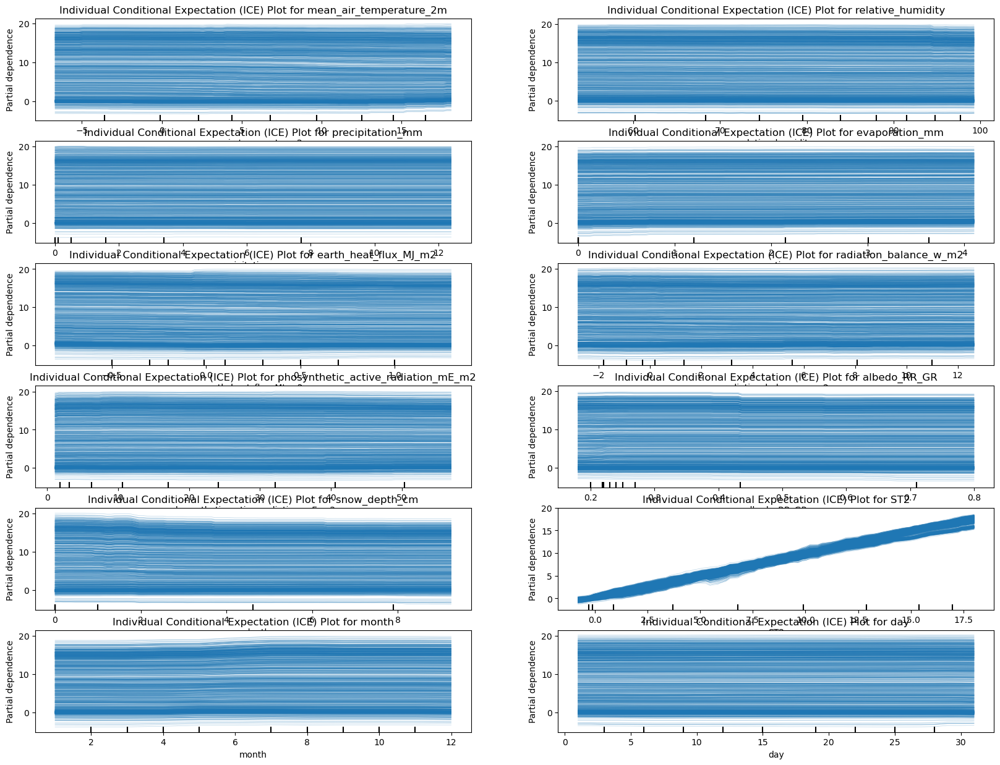

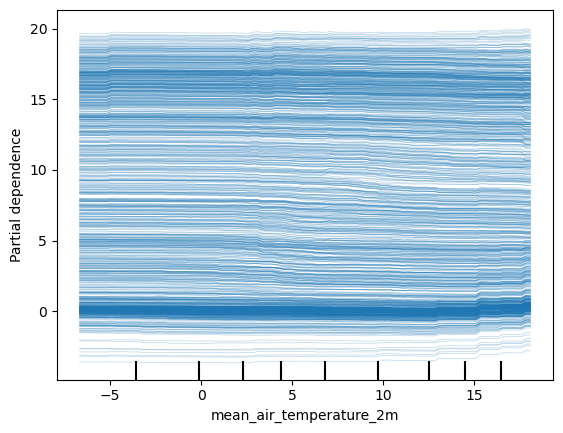

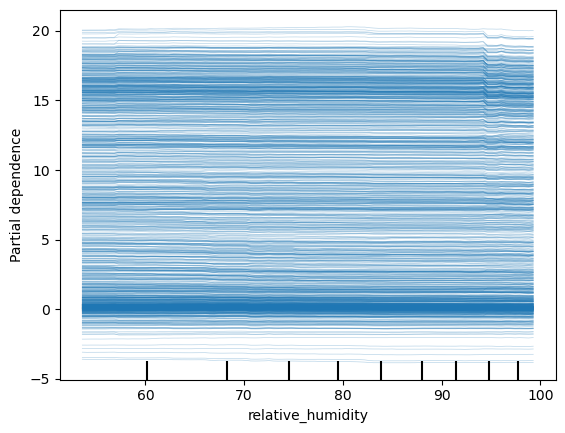

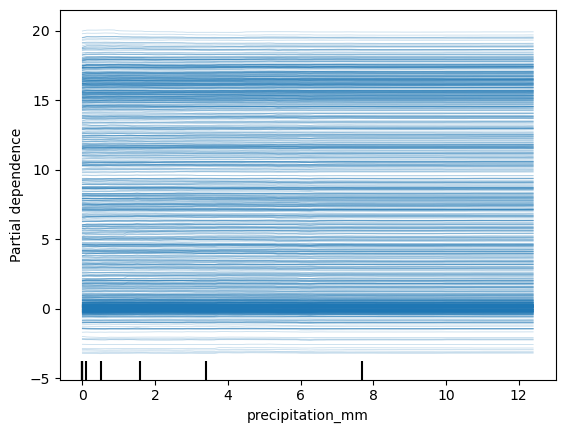

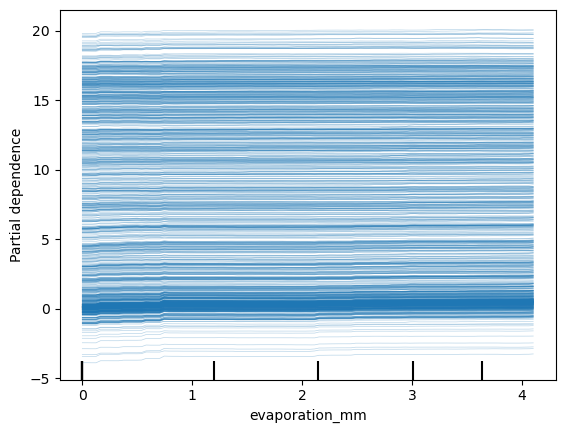

...

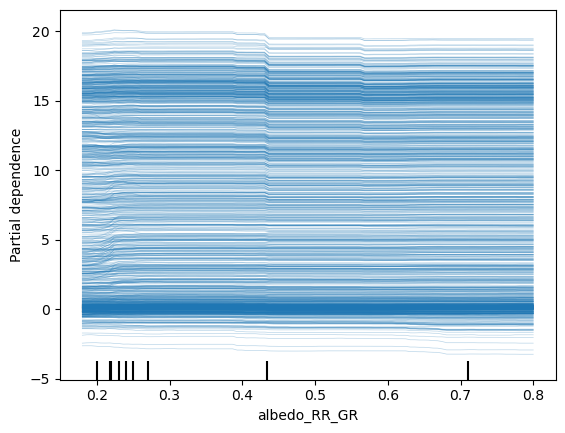

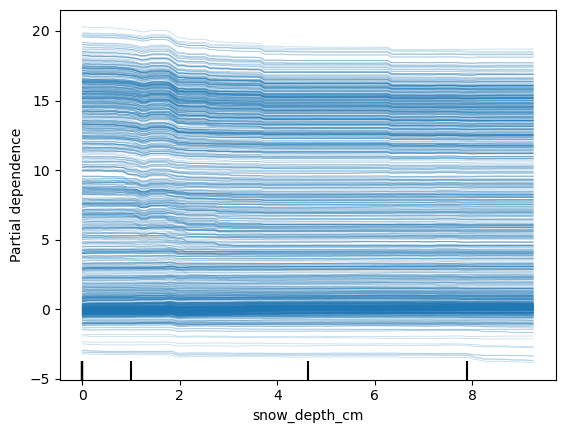

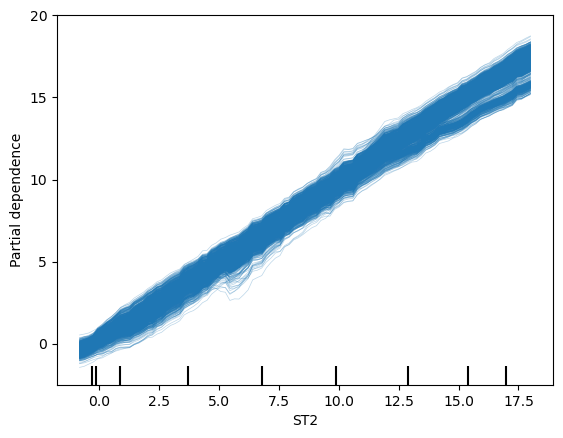

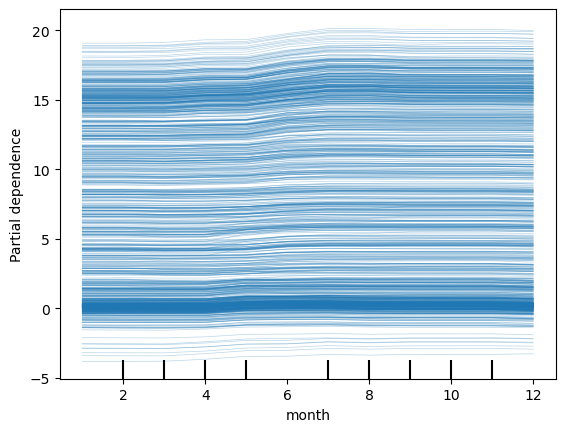

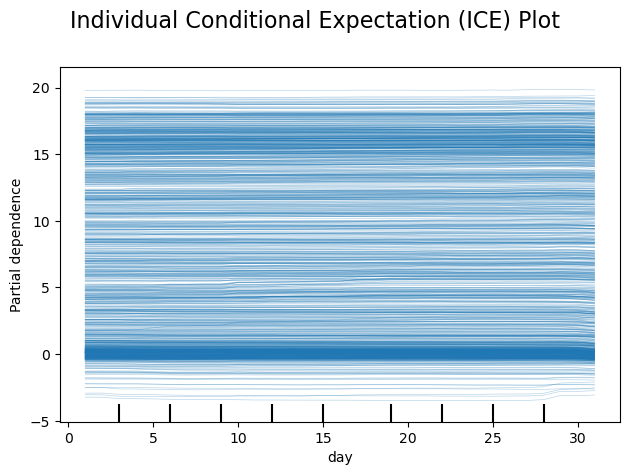

========================= ST10 Residual Analysis Plot ==============================


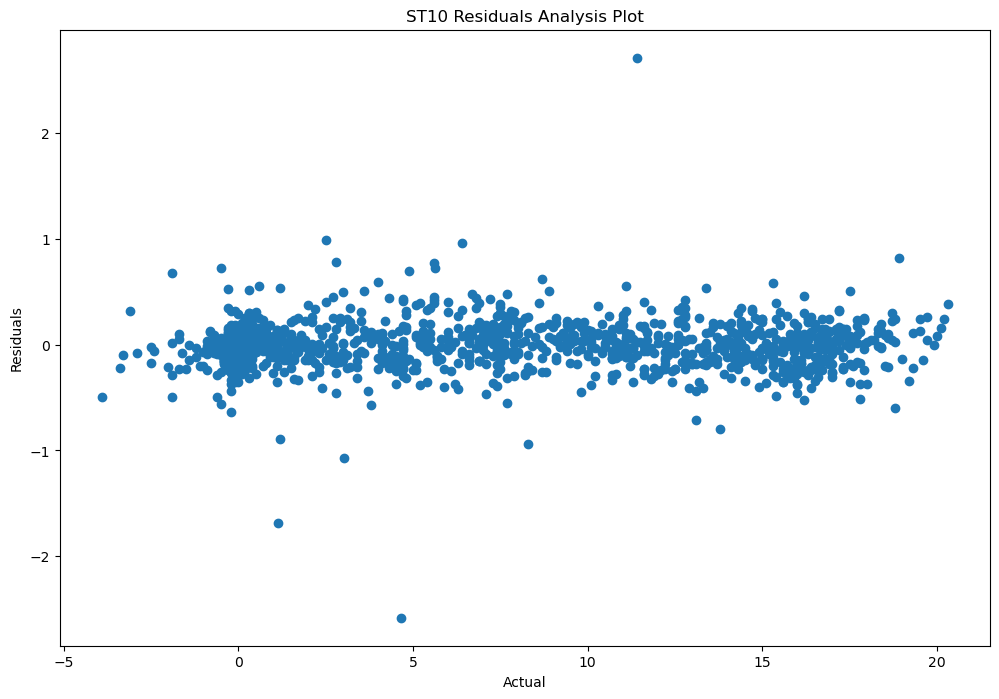

========================= ST10 Q-Q Plot ==============================


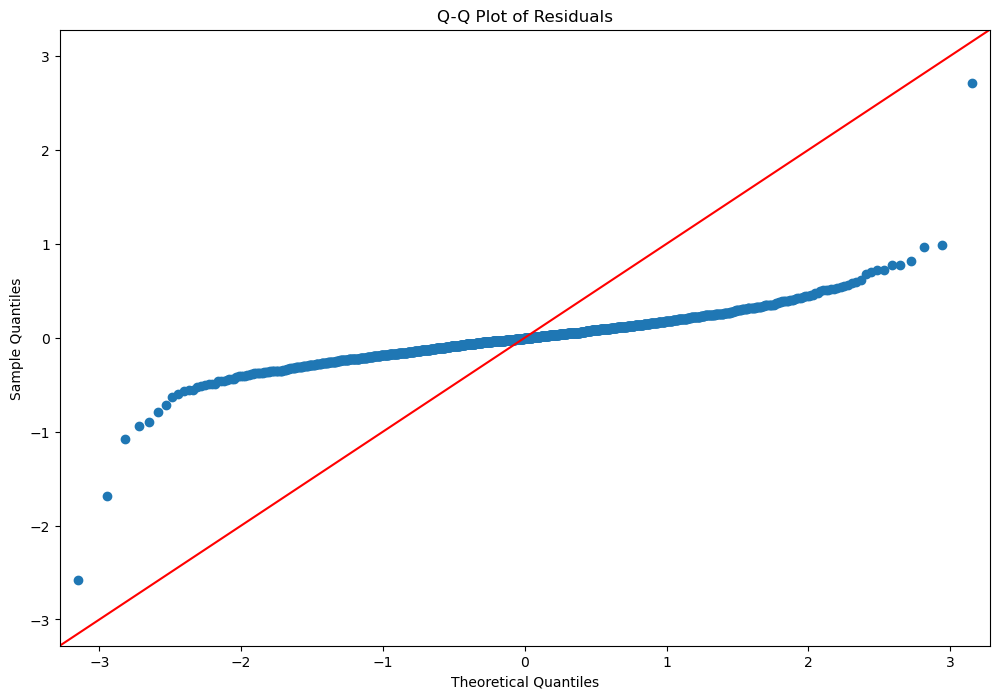

In [138]:
from sklearn.inspection import PartialDependenceDisplay
import statsmodels.api as sm
from pycebox.ice import ice, ice_plot
import matplotlib.pyplot as plt

# Partial Dependence Plot
print('====================================================== ST10 Partial Dependence Plot')
ST10_feature_names = ST10_X_train.columns.tolist()
n_features = len(ST10_feature_names)
n_cols = 2
n_rows = (n_features + n_cols - 1) // n_cols

fig1, ax1 = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 15))
axes_flat = ax1.flatten()

for idx, feature in enumerate(ST10_feature_names):
    display = PartialDependenceDisplay.from_estimator(ST10_stacking_regressor, ST10_X_train, features=[feature])
    display.plot(ax=axes_flat[idx])
    axes_flat[idx].set_title(f'Partial Dependence (PD) Plot for {feature}')
    axes_flat[idx].set_xlabel(feature)

for idx in range(n_features, len(axes_flat)):
    fig1.delaxes(axes_flat[idx])

plt.subplots_adjust(hspace=0.5)
plt.suptitle('Partial Dependence (PD) Plot', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.savefig('images/ST10_final_partial_dependence_plot.png')
plt.show()

# Individual Conditional Expectation Plot (ICE)
print('======================== ST10 Individual Conditional Expectation Plot ===============================')
fig2, axes2 = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 15))
axes_flat2 = axes2.flatten()

for idx, feature in enumerate(ST10_feature_names):
    display = PartialDependenceDisplay.from_estimator(ST10_stacking_regressor, ST10_X_train, features=[feature], kind='individual')
    display.plot(ax=axes_flat2[idx])
    axes_flat2[idx].set_title(f'Individual Conditional Expectation (ICE) Plot for {feature}')
    axes_flat2[idx].set_xlabel(feature)

for idx in range(n_features, len(axes_flat2)):
    fig2.delaxes(axes_flat2[idx])

plt.subplots_adjust(hspace=0.7)
plt.suptitle('Individual Conditional Expectation (ICE) Plot', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.savefig('images/ST10_final_individual_conditional_expectation_plot.png')
plt.show()

# Residual Analysis
print('========================= ST10 Residual Analysis Plot ==============================')
ST10_Y_predictions = ST10_stacking_regressor.predict(ST10_X_test)
ST10_residuals = ST10_Y_test - ST10_Y_predictions

fig3, ax3 = plt.subplots(figsize=(10, 7))
ax3.scatter(ST10_Y_predictions, ST10_residuals)
ax3.set_xlabel('Predictions')
ax3.set_ylabel('Residuals')
ax3.set_title('ST10 Residuals Analysis Plot')
plt.axhline(y=0, color='r', linestyle='--')
plt.savefig('images/ST10_final_residual_analysis_plot.png')
plt.show()

# Residuals vs. Predictor Variables
print('========================= Residuals vs. Predictor Variables ==============================')
for column in ST10_X_test.columns:
    fig, ax = plt.subplots(figsize=(10, 7))
    ax.scatter(ST10_X_test[column], ST10_residuals)
    ax.axhline(y=0, color='r', linestyle='--')
    ax.set_xlabel(column)
    ax.set_ylabel('Residuals')
    ax.set_title(f'Residuals vs. {column}')
    plt.savefig(f'images/ST10_final_residuals_vs_{column}.png')
    plt.show()

# Q-Q Plot
print('========================= ST10 Q-Q Plot ==============================')
fig5, ax5 = plt.subplots(figsize=(10, 7))
sm.qqplot(ST10_residuals, line='45', ax=ax5)
ax5.set_title('Q-Q Plot of Residuals')
plt.savefig('images/ST10_final_Q-Q_plot.png')
plt.show()

# Histogram of residuals
fig6, ax6 = plt.subplots(figsize=(10, 7))
plt.figure(figsize=(10, 6))
sns.histplot(residuals, kde=True, ax=ax6)
plt.xlabel('Residuals')
plt.title('Histogram of Residuals')
plt.show()


### Feature importance analysis for ST10

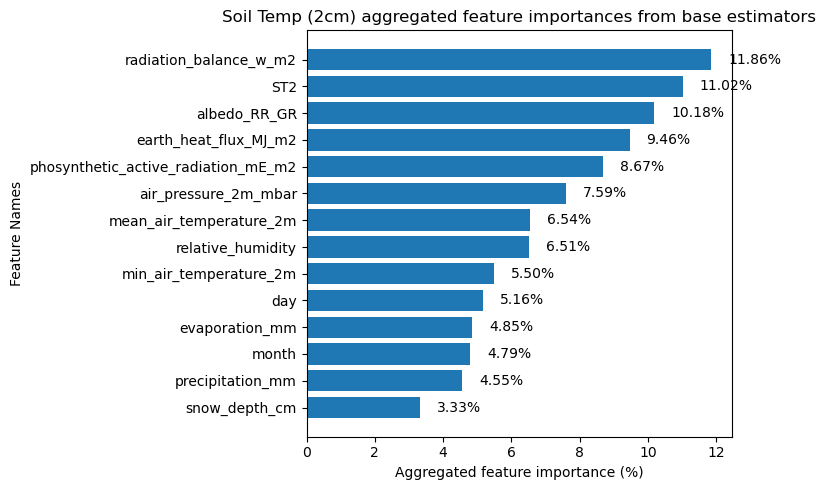

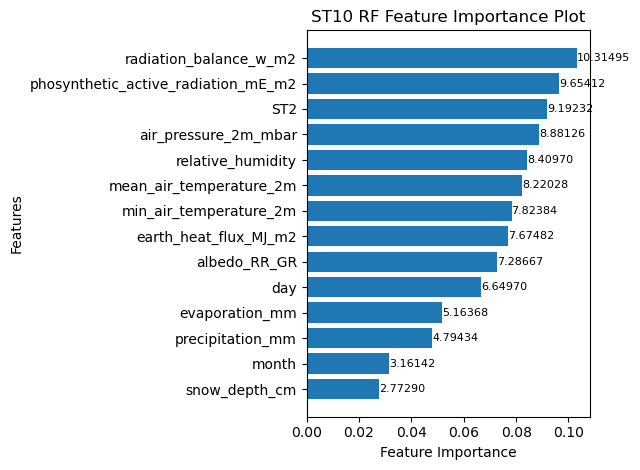

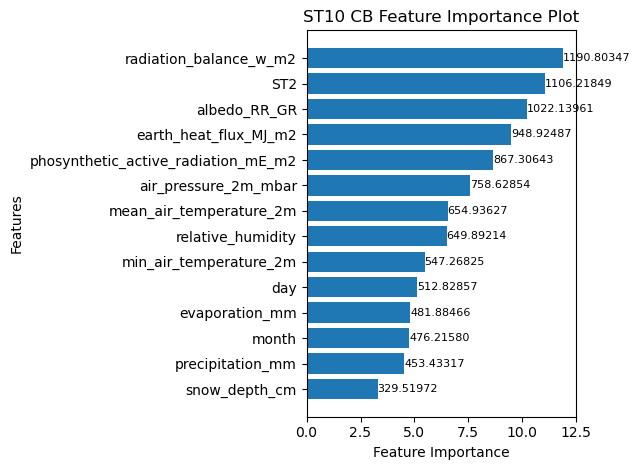

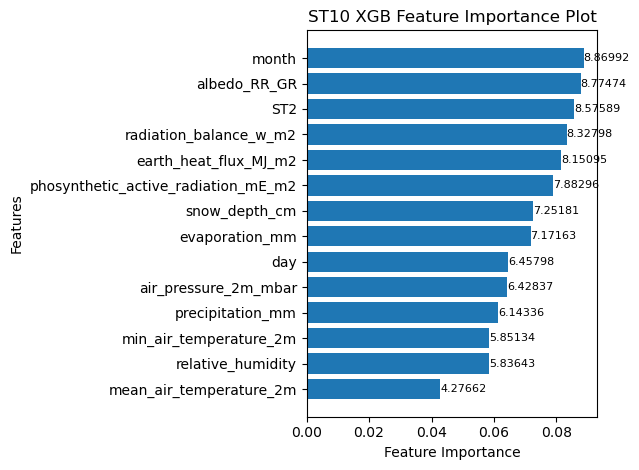

In [209]:
np.random.seed(42)
# Assuming feature_names is a list of your feature names
feature_names = ST10_X_train.columns.tolist()

estimators = [
    ("Random Forest", ST10_rf_model),
    ("Cat Boost", ST10_cb_model),
    ("XG Boost", ST10_xgb_model)
]

# Initialize an array to store aggregated feature importances
num_features = ST10_X_train.shape[1]
feature_importances = np.zeros(num_features, dtype=np.float64)

# Aggregate feature importances from base models
count = 0
for name, model in estimators:
    if hasattr(model, 'feature_importances_'):
        importances = np.array(model.feature_importances_, dtype=np.float64)
        feature_importances += importances
        count += 1
    else:
        print(f"{name} does not have feature_importances_ attribute")

# Normalize the aggregated feature importances
if count > 0:
    feature_importances /= count

# Convert feature importances to percentages
feature_importances_percentage = 100 * (feature_importances / feature_importances.sum())

# Sort the feature importances in descending order
sorted_indices = np.argsort(feature_importances_percentage)[::-1]
sorted_feature_importances_percentage = feature_importances_percentage[sorted_indices]
sorted_feature_names = [feature_names[i] for i in sorted_indices]

# Plot the sorted feature importances
plt.figure(figsize=(8, 5))
bars = plt.barh(sorted_feature_names, sorted_feature_importances_percentage)
plt.xlabel("Aggregated feature importance (%)")
plt.ylabel("Feature Names")
plt.title("Soil Temp (2cm) aggregated feature importances from base estimators")
plt.gca().invert_yaxis()  # Highest importance at the top

# Add annotations to the bars
for bar in bars:
    width = bar.get_width()
    plt.text(
        width + 0.5,  # Offset slightly to the right of the bar
        bar.get_y() + bar.get_height() / 2,  # Vertical center of the bar
        f'{width:.2f}%',  # Display the width (importance value) formatted to 2 decimal places
        va='center'
    )
# Save the figure
plt.tight_layout()
plt.savefig('data/results/ST10_stacking_regressors_feature_importances.png')
plt.show()

plot_features(ST10_X_train.columns, ST10_rf_model.feature_importances_, 'images/ST10_RF_feature_analysis.png', 'ST10 RF Feature Importance Plot')
plot_features(ST10_X_train.columns, ST10_cb_model.feature_importances_/100, 'images/ST10_CB_feature_analysis.png', 'ST10 CB Feature Importance Plot')
plot_features(ST10_X_train.columns, ST10_xgb_model.feature_importances_, 'images/ST10_XGB_feature_analysis.png', 'ST10 XGB Feature Importance Plot')

### GridSearhCV Evaluation for all models used in the stacked regressor for ST10

In [143]:
%%time
import time
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor, HistGradientBoostingRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.model_selection import cross_val_predict, cross_validate
from catboost import CatBoostRegressor



# Define parameter grids for each model
param_grid_cb = {
    'iterations': [100, 200, 500],
    'learning_rate': [0.01, 0.1, 0.05],
    'depth': [4, 6, 10],
    'l2_leaf_reg': [1, 3, 5, 7, 9],
    'border_count': [32, 50, 100]
}
param_grid_rf = {
    'n_estimators': [100, 300, 500],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

param_grid_hgb = {
    'learning_rate': [0.01, 0.1, 0.05],
    'max_iter': [100, 200, 500],
    'max_leaf_nodes': [31, 50, 100],
    'max_depth': [None, 10, 20],
    'min_samples_leaf': [20, 50, 100],
    'l2_regularization': [0, 0.1, 1]
}

param_grid_xgb = {
    'n_estimators': [100, 200, 500],
    'learning_rate': [0.01, 0.1, 0.05],
    'max_depth': [3, 5, 7],
    'subsample': [1.0, 0.8, 0.6],
    'colsample_bytree': [1.0, 0.8, 0.6],
    'gamma': [0, 1, 5],
    'reg_alpha': [0, 0.1, 1],
    'reg_lambda': [1, 0.1, 0.01],
    'tree_method': ['gpu_hist']  # Use GPU
}
param_grid_ada = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.05],
    'loss': ['linear', 'square', 'exponential']
}
# stacking_param_grid ={
#     'rf__n_estimators': [100, 300, 500],
#     'rf__max_depth': [None, 10, 20, 30],
#     'hgb__learning_rate': [0.01, 0.1, 0.05],
#     'hgb__max_iter': [100, 200, 500],
#     'catboost__iterations': [100, 200, 500],
#     'catboost__learning_rate': [0.01, 0.1, 0.05],
#     'catboost__depth': [4, 6, 10],
#     'xgb__n_estimators': [100, 200],
#     'xgb__max_depth': [3, 5]
# }


# Initialize models
cb = CatBoostRegressor(random_state=42)
rf = RandomForestRegressor(random_state=42)
hgb = HistGradientBoostingRegressor(random_state=42)
ada = AdaBoostRegressor(random_state=42)
xgb = XGBRegressor(random_state=42, objective='reg:squarederror')

# estimators = [
#     ('rf', RandomForestRegressor()),
#     ('cb', CatBoostRegressor()),
#     ('hgb', HistGradientBoostingRegressor()),    
#     ('xgb', XGBRegressor())
# ]

# stacking_regressor = StackingRegressor(
#     estimators=estimators,
#     final_estimator=RidgeCV()
# )

# Initialize GridSearchCV for RF model
start_time_rf = time.time()
ST10_grid_search_rf = GridSearchCV(estimator=rf, param_grid=param_grid_rf, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_rf_search = time.time()
ST10_grid_search_rf.fit(ST10_X_train, ST10_Y_train)
end_time_rf_fit = time.time()
elapsed_time_search_rf = end_time_rf_search - start_time_rf
elapsed_time_fit_rf = end_time_rf_fit - end_time_rf_search
# Get the best parameters and scores
print("Best parameters for RandomForestRegressor:", ST10_grid_search_rf.best_params_)
print("Best score for RandomForestRegressor:", -ST10_grid_search_rf.best_score_)
print("RandomForestRegressor GridSearchCV Time:", elapsed_time_search_rf)
print("RandomForestRegressor Fitting Time:", elapsed_time_fit_rf)

# Initialize GridSearchCV for HGB model
start_time_hgb = time.time()
ST10_grid_search_hgb = GridSearchCV(estimator=hgb, param_grid=param_grid_hgb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_hgb_search = time.time()
ST10_grid_search_hgb.fit(ST10_X_train, ST10_Y_train)
end_time_hgb_fit = time.time()
elapsed_time_search_hgb = end_time_hgb_search - start_time_hgb
elapsed_time_fit_hgb = end_time_hgb_fit - end_time_hgb_search
# Get the best parameters and scores
print("Best parameters for HistGradientBoostingRegressor:", ST10_grid_search_hgb.best_params_)
print("Best score for HistGradientBoostingRegressor:", -ST10_grid_search_hgb.best_score_)
print("HistGradientBoostingRegressor GridSearchCV Time:", elapsed_time_search_hgb)
print("HistGradientBoostingRegressor Fitting Time:", elapsed_time_fit_hgb)

# # Initialize GridSearchCV for XGB model
# start_time_xgb = time.time()
# ST10_grid_search_xgb = GridSearchCV(estimator=xgb, param_grid=param_grid_xgb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
# end_time_xgb_search = time.time()
# ST10_grid_search_xgb.fit(ST10_X_train, ST10_Y_train)
# end_time_xgb_fit = time.time()
# elapsed_time_search_xgb = end_time_xgb_search - start_time_xgb
# elapsed_time_fit_xgb = end_time_xgb_fit - end_time_xgb_search
# # Get the best parameters and scores
# print("Best parameters for XGBRegressor:", ST10_grid_search_xgb.best_params_)
# print("Best score for XGBRegressor:", -ST10_grid_search_xgb.best_score_)
# print("XGBRegressor GridSearchCV Time:", elapsed_time_search_xgb)
# print("XGBRegressor Fitting Time:", elapsed_time_fit_xgb)

# Initialize GridSearchCV for ADA model
start_time_ada = time.time()
ST10_grid_search_ada = GridSearchCV(estimator=ada, param_grid=param_grid_ada, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_ada_search = time.time()
ST10_grid_search_ada.fit(ST10_X_train, ST10_Y_train)
end_time_ada_fit = time.time()
elapsed_time_search_ada = end_time_ada_search - start_time_ada
elapsed_time_fit_ada = end_time_ada_fit - end_time_ada_search
# Get the best parameters and scores
print("Best parameters for AdaBoostRegressor:", ST10_grid_search_ada.best_params_)
print("Best score for AdaBoostRegressor:", -ST10_grid_search_ada.best_score_)
print("AdaBoostRegressor GridSearchCV Time:", elapsed_time_search_ada)
print("AdaBoostRegressor Fitting Time:", elapsed_time_fit_ada)

# # Initialize GridSearchCV for CB model
# start_time_cb = time.time()
# ST10_grid_search_cb = GridSearchCV(estimator=cb, param_grid=param_grid_cb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
# end_time_cb_search = time.time()
# ST10_grid_search_cb.fit(ST10_X_train, ST10_Y_train)
# end_time_cb_fit = time.time()
# elapsed_time_search_cb = end_time_cb_search - start_time_cb
# elapsed_time_fit_cb = end_time_cb_fit - end_time_cb_search
# # Get the best parameters and scores
# print("Best parameters for CatBoostRegressor:", ST10_grid_search_cb.best_params_)
# print("Best score for CatBoost:", -ST10_grid_search_cb.best_score_)
# print("CatBoostRegressor GridSearchCV Time:", elapsed_time_search_cb)
# print("CatBoostRegressor Fitting Time:", elapsed_time_fit_cb)

# # Initialize GridSearchCV for Stacking model
# start_time_stacking = time.time()
# ST10_grid_search_stacking = GridSearchCV(estimator=stacking_regressor, param_grid=stacking_param_grid, cv=5, n_jobs=-1, verbose=0,scoring='neg_mean_absolute_error')
# end_time_stacking_search = time.time()
# ST10_grid_search_stacking.fit(ST10_X_train, ST10_Y_train)
# end_time_stacking = time.time()
# elapsed_time_search_stacking = end_time_stacking_search - start_time_stacking
# elapsed_time_fit_stacking = end_time_stacking_fit - end_time_stacking_search

# print("Best parameters for StackingRegressor:", ST10_grid_search_stacking.best_params_)
# print("Best score for StackingRegressor:", -ST10_grid_search_stacking.best_score_)
# print("StackingRegressor GridSearchCV Time:", elapsed_time_search_stacking)
# print("StackingRegressor Fitting Time:", elapsed_time_fit_stacking)

# # Define the results of print statements as variables
# ST10_grid_search_and_fitting_results = {
#     'Model': ['RandomForestRegressor', 'HistGradientBoostingRegressor', 'AdaBoostRegressor', 'XGBRegressor'],
#     'Best Parameters': [ST10_grid_search_rf.best_params_, ST10_grid_search_hgb.best_params_, ST10_grid_search_ada.best_params_, ST10_grid_search_xgb.best_params_],
#     'Best Score': [-ST10_grid_search_rf.best_score_, -ST10_grid_search_hgb.best_score_, -ST10_grid_search_ada.best_score_, -ST10_grid_search_xgb.best_score_],
#     'GridSearchCV Time': [elapsed_time_search_rf, elapsed_time_search_hgb, elapsed_time_search_ada, elapsed_time_search_xgb],
#     'Fitting Time': [elapsed_time_fit_rf, elapsed_time_fit_hgb, elapsed_time_fit_ada, elapsed_time_fit_xgb]
# }

# # Create a DataFrame
# df_results = pd.DataFrame(ST10_grid_search_and_fitting_results)

# # Export DataFrame to Excel
# df_results.to_excel('data/ST10_grid_search_and_fitting_results.xlsx', index=False)

### D. Stacking Regressor for Soil temperature at 20cm

### Correllation analysis

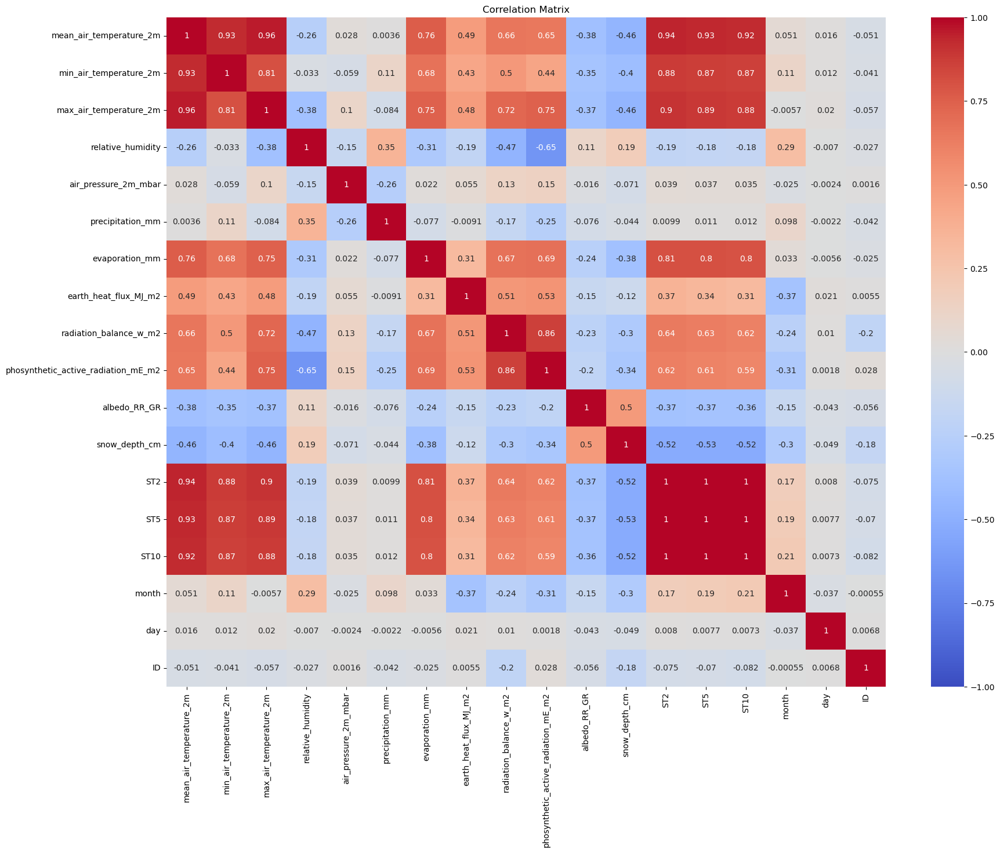

Highly correlated pairs (above threshold):
('mean_air_temperature_2m', 'max_air_temperature_2m')
('ST2', 'ST5')
('ST2', 'ST10')
('ST5', 'ST10')
Removed features: {'max_air_temperature_2m', 'ST5', 'ST10'}
Shape of the reduced dataset: (5729, 15)


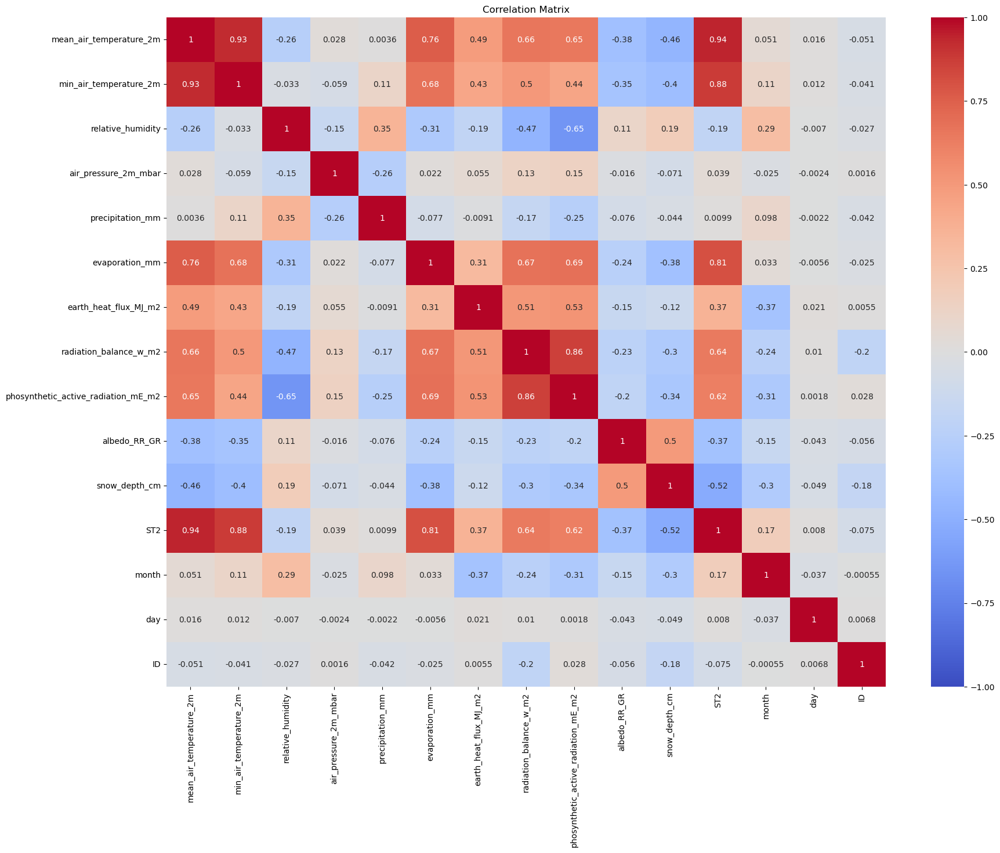

Removing feature 'const' with VIF: 10742.953836787985
Removing feature 'air_pressure_2m_mbar' with VIF: 143.58507568220716
Removing feature 'mean_air_temperature_2m' with VIF: 59.88997665993484
Final VIF data:
                                feature        VIF
0                min_air_temperature_2m   9.602701
1                     relative_humidity  21.861883
2                      precipitation_mm   1.551508
3                        evaporation_mm   6.470213
4                 earth_heat_flux_MJ_m2   2.040181
5                radiation_balance_w_m2   6.881466
6   phosynthetic_active_radiation_mE_m2  13.313039
7                          albedo_RR_GR   8.580169
8                         snow_depth_cm   2.160298
9                                   ST2  29.957729
10                                month  10.842153
11                                  day   4.054785


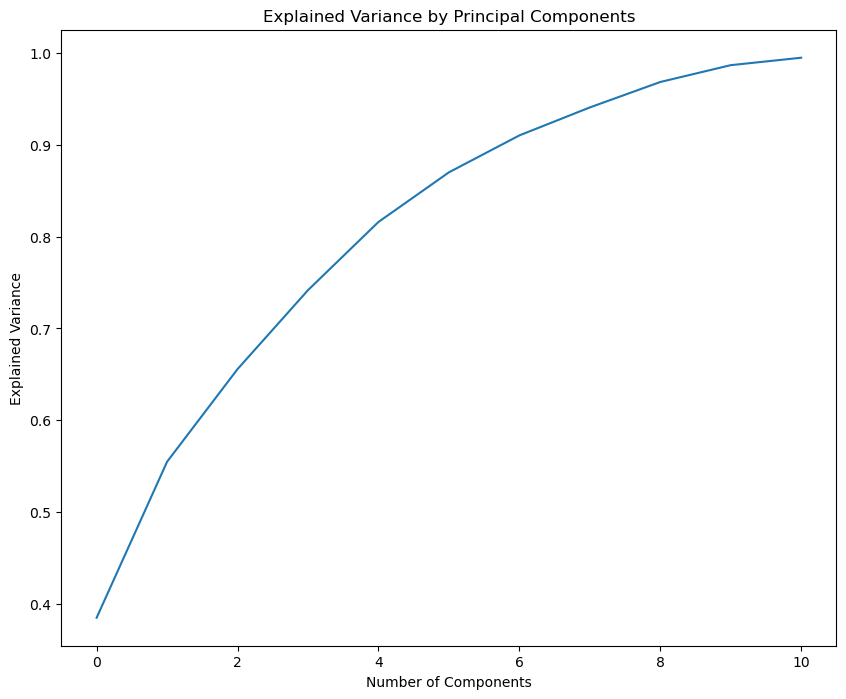

In [210]:
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Calculate the covariance matrix for target ST200
ST20_dataset_correlation = ST20_clean_dataset_denormalized.drop(['ST100', 'ST50','ST20'], axis=1)
ST20_covariance_matrix = ST20_dataset_correlation.cov()

# Calculate the correlation matrix
ST20_correlation_matrix = ST20_dataset_correlation.corr()

# Visualize the correlation matrix
plt.figure(figsize=(20, 15))
sns.heatmap(ST20_correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.savefig("images/ST20_denormalized_before_correlation_matrix.png")
plt.show()

# Set the threshold
threshold = 0.95
# Find pairs of features with correlation above the threshold
highly_correlated = np.where(np.abs(ST20_correlation_matrix) > threshold)
highly_correlated_pairs = [(ST20_correlation_matrix.index[x], ST20_correlation_matrix.columns[y]) 
                           for x, y in zip(*highly_correlated) if x != y and x < y]

print("Highly correlated pairs (above threshold):")
for pair in highly_correlated_pairs:
    print(pair)
# Example: Removing one feature from each highly correlated pair
features_to_remove = set()
for pair in highly_correlated_pairs:
    features_to_remove.add(pair[1])  # You can choose to remove pair[0] or pair[1]

# Drop the features from the dataframe
ST20_dataset_denormalized_outlier_filtered_uncorrelated = ST20_dataset_correlation.drop(columns=features_to_remove)

print(f"Removed features: {features_to_remove}")
print("Shape of the reduced dataset:", ST20_dataset_denormalized_outlier_filtered_uncorrelated.shape)

# After removing the correlated features
# Calculate the correlation matrix
ST20_correlation_matrix_new = ST20_dataset_denormalized_outlier_filtered_uncorrelated.corr()

# Visualize the correlation matrix
plt.figure(figsize=(20, 15))
sns.heatmap(ST20_correlation_matrix_new, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.savefig("images/ST20_denormalized_after_correlation_matrix.png")
plt.show()

# Assuming dataset_denormalized_outlier_filtered is your DataFrame
ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = ST20_dataset_denormalized_outlier_filtered_uncorrelated.copy()

# Add a constant term for the intercept
ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = sm.add_constant(ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif)
ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop('ID', axis=1, inplace=True)

# Function to calculate VIF
def calculate_vif(data):
    vif_data = pd.DataFrame()
    vif_data["feature"] = data.columns
    vif_data["VIF"] = [variance_inflation_factor(data.values, i) for i in range(data.shape[1])]
    return vif_data

# Iteratively remove features with VIF above the threshold
def remove_high_vif_features(data, threshold=40.0):
    while True:
        vif_data = calculate_vif(data)
        max_vif = vif_data['VIF'].max()
        if max_vif > threshold:
            # Identify the feature with the highest VIF
            feature_to_remove = vif_data.sort_values('VIF', ascending=False)['feature'].iloc[0]
            print(f"Removing feature '{feature_to_remove}' with VIF: {max_vif}")
            data = data.drop(columns=[feature_to_remove])
        else:
            break
    return data, vif_data

# Remove high VIF features
ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif, ST20_final_vif_data = remove_high_vif_features(ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif)

print("Final VIF data:")
print(ST20_final_vif_data)
ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ID'] = ST20_clean_dataset_denormalized['ID']
ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ST20'] = ST20_clean_dataset_denormalized['ST20']
ST20_dataset_denormalized_outlier_filtered_uncorrelated['ID'] = ST20_clean_dataset_denormalized['ID']
ST20_dataset_denormalized_outlier_filtered_uncorrelated['ST20'] = ST20_clean_dataset_denormalized['ST20']
# Remove the constant term before creating the final DataFrame
if 'const' in ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.columns:
    ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop(columns=['const'])

# Store the 'ID' and 'ST20' columns with their corresponding index before PCA
ID_index_mapping = ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ID']
ST20_index_mapping = ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ST20']

# Assume X is your feature dataframe
ST20_X_pca = ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop(['ST20', 'ID'], axis=1)

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(ST20_X_pca)

# Apply PCA
pca = PCA(n_components=0.99)  # Choose the number of components
principal_components = pca.fit_transform(X_scaled)

# Create a DataFrame with the principal components
ST20_pca_df = pd.DataFrame(data=principal_components, columns=[f"PC{i}" for i in range(principal_components.shape[1])])

# Merge PCA DataFrame with original DataFrame to maintain original index order
ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca = pd.merge(ID_index_mapping, ST20_index_mapping, left_index=True, right_index=True)
ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca = pd.merge(ST20_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca, ST20_pca_df, left_index=True, right_index=True)

# Plot the explained variance
plt.figure(figsize=(10,8))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Explained Variance')
plt.title('Explained Variance by Principal Components')
plt.savefig('images/ST20_PCA_analysis.png')
plt.show()


### Option 1: Dataset used is after correlation analysis

In [211]:
%%time
import numpy as np
from sklearn.linear_model import LassoCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.metrics import PredictionErrorDisplay
from sklearn.model_selection import cross_val_predict, cross_validate
import time

np.random.seed(42)
  
# Create function to evaluate model on few different levels
def show_scores(model, X_train, X_valid, Y_train, Y_valid, target='ST20', model_name='RF'):
    """
    Calculates and shows the different sklearn evaluation metrics
        
    Parameters:
        model: the model fitted.
        X_train: the input training set.
        X_valid: the input validation or test set.
        Y_train: the target training set.
        Y_valid: the target validation or test set.
            
    Returns:
        scores: the dictionary of the calculated sklearn metrics for train and valid sets.
    """
    
    train_preds = model.predict(X_train)
    val_preds = model.predict(X_valid)
    scores = {
              # "Training Set R^2 Score": r2_score(Y_train, train_preds),
              "Validation Set R^2 Score":r2_score(Y_valid, val_preds),
              # "Training Set MAE": mean_absolute_error(Y_train, train_preds),
              "Validation Set MAE": mean_absolute_error(Y_valid, val_preds),             
              # "Training Set MSE": mean_squared_error(Y_train, train_preds),
              "Validation Set MSE": mean_squared_error(Y_valid, val_preds),
              # "Training Set Median Absolute Error": median_absolute_error(Y_train, train_preds),
              "Validation Set Median Absolute Error": median_absolute_error(Y_valid, val_preds),
              # "Training Set MA Percentage Error": mean_absolute_percentage_error(Y_train, train_preds),
              # "Validation Set MA Percentage Error": mean_absolute_percentage_error(Y_valid, val_preds),
              # "Training Set Max Error": max_error(Y_train, train_preds),
              "Validation Set Max Error": max_error(Y_valid, val_preds),
              # "Training Set Explained Variance Score": explained_variance_score(Y_train, train_preds),
              "Validation Set Explained Variance Score": explained_variance_score(Y_valid, val_preds)}
    # Convert the dictionary to a DataFrame
    df = pd.DataFrame(list(scores.items()), columns=['Metric', 'Value'])    
    # Export the DataFrame to an Excel file
    df.to_excel(f'data/results/{target}_{model_name}_scores.xlsx', index=False)
    return scores

# Define a function that takes test set and validation sets as input and generates prediction curve and returns test set prediction data 
def predict_plot(model, ST_X_test, ST_X_validation, ST_Y_validation, name):
    # Predict the test set which is forecast data
    ST_Y_test_preds = model.predict(ST_X_test)
    # Changes the predicted array values to pandas series
    ST_Y_test_preds_series = pd.Series(ST_Y_test_preds, name=name) 
    # Convert the Series to a DataFrame
    ST_Y_test_preds_df = ST_Y_test_preds_series.to_frame()
    ST_Y_test_preds_df.index =  ST_X_test.index
    # Predict the validation set
    ST_Y_validation_preds = model.predict(ST_X_validation)
    # Change validation predictions to pandas series
    ST_Y_validation_preds_series = pd.Series(ST_Y_validation_preds)
    # Make the original and predicted series to have the same index
    ST_Y_validation_preds_series.index =ST_Y_validation.index
    # Sort Y_valid and Y_valid_preds in ascending order and reset indices
    ST_Y_validation_sorted = ST_Y_validation.sort_values().reset_index(drop=True)
    ST_Y_validation_preds_sorted = ST_Y_validation_preds_series[ST_Y_validation.index].sort_values().reset_index(drop=True)
  
    # Calculate mean absolute error
    ST_mae = mean_absolute_error(ST_Y_validation,ST_Y_validation_preds)
    # Calculate mean squared error
    ST_mse = mean_squared_error(ST_Y_validation,ST_Y_validation_preds)
    # Calculate the R^2 score
    ST_r2_score = r2_score(ST_Y_validation,ST_Y_validation_preds)
    # Plot the sorted values
    plt.figure(figsize=(10, 6))
    plt.plot(ST_Y_validation_sorted.index,ST_Y_validation_sorted, color='blue', label=f'{name} Actual Values')
    plt.plot(ST_Y_validation_preds_sorted.index,ST_Y_validation_preds_sorted, color='red', label=f'{name} Predicted Values')
    # Display the mean absolute error as text annotation
    plt.text(0.4, 0.95, f'MAE: {ST_mae:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.text(0.6, 0.95, f'MSE: {ST_mse:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.text(0.8, 0.95, f'R^2: {ST_r2_score:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.xlabel('Index')
    plt.ylabel(f'Soil Temperature at 20 cm (°C)')
    plt.title(f'Comparison of {name} Actual vs Predicted Values')
    plt.legend()
    plt.grid(True)
    plt.savefig(f'data/results/{name}_predicted_vs_actual_values_line_plot.png')  # Save as PNG format
    plt.show()
    return ST_Y_test_preds_df
    
# Let us shuffle the entire dataset so that it is randomly arranged
dataset_shuffled = ST20_dataset_denormalized_outlier_filtered_uncorrelated.sample(frac=1)
# Split the dataset into features and target
many_features_dropped = ['earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','ST100','ST50','ST20','ID']
soil_features_dropped = ['ST100','ST50','ST20','ID']
uncorrelated_dropped = ['ST20','ID']
# ST20_X = dataset_shuffled.drop(many_features_dropped, axis=1)
ST20_X = dataset_shuffled.drop(uncorrelated_dropped, axis=1)
ST20_Y = dataset_shuffled['ST20']

# Split the dataset in to features (independent variables) and labels(dependent variable = target_soil_temperature_2cm ).
# Then split into train, validation and test sets
train_split = round(0.7*len(dataset_shuffled)) # 70% for train set
valid_split = round(train_split + 0.15*len(dataset_shuffled))
ST20_X_train, ST20_Y_train = ST20_X[:train_split], ST20_Y[:train_split]
ST20_X_valid, ST20_Y_valid =ST20_X[train_split:valid_split], ST20_Y[train_split:valid_split]
ST20_X_test, ST20_Y_test = ST20_X[valid_split:], ST20_Y[valid_split:]

# A. RandomForestRegressor
# Create RF model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST20_rf_model = RandomForestRegressor(n_jobs=-1, random_state=42, oob_score=True)
# Fit the model for ST20 to start with
ST20_rf_model.fit(ST20_X_train, ST20_Y_train)
# Show the scoring metrics for this model
print("====================Random Forest The Evaluation Metrics Results For ST20 Denormalized =======================\n")
# Access the OOB Score
oob_score = ST20_rf_model.oob_score_
print('Out of Bag Score: ', oob_score)
print(show_scores(ST20_rf_model, ST20_X_train, ST20_X_valid, ST20_Y_train, ST20_Y_valid))
print("==================================================================================================\n")

# A. CatBoostRegressor (CB)
# Create CB model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST20_cb_model = CatBoostRegressor(iterations=500,
                                learning_rate=0.1,
                                depth=6,
                                l2_leaf_reg=3,
                                loss_function='RMSE',
                                silent=True,
                                random_state=42)
# Fit the model for ST20 to start with
ST20_cb_model.fit(ST20_X_train, ST20_Y_train, eval_set=(ST20_X_valid, ST20_Y_valid), early_stopping_rounds=100)
# Show the scoring metrics for this model
print("====================CatBoost The Evaluation Metrics Results For ST20 Denormalized =======================\n")

print(show_scores(ST20_cb_model, ST20_X_train, ST20_X_valid, ST20_Y_train, ST20_Y_valid, 'ST20', 'CB'))
print("==================================================================================================\n")

# B. RandomForestRegressor
# Create RF model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST20_rf_model = RandomForestRegressor(n_estimators=300, 
                                     min_samples_leaf=1,
                                     min_samples_split=2,
                                     max_features='sqrt',
                                     max_depth=None,
                                     bootstrap=False,
                                     random_state=42)
# Fit the model for ST20 to start with
ST20_rf_model.fit(ST20_X_train, ST20_Y_train)
# Show the scoring metrics for this model
print("====================Random Forest The Evaluation Metrics Results For ST20 Denormalized =======================\n")

print(show_scores(ST20_rf_model, ST20_X_train, ST20_X_valid, ST20_Y_train, ST20_Y_valid,'ST20', 'RF'))
print("==================================================================================================\n")

# C. Histogram Based Gradient Boosting Regressor
# Setup random seed
np.random.seed(42)
# Create Ridge model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST20_gbr_model = HistGradientBoostingRegressor(learning_rate=0.1, 
                                              max_iter=300, 
                                              max_leaf_nodes=41,
                                              random_state=42)
# Fit the ST20 model for soil temp at 100 cm
ST20_gbr_model.fit(ST20_X_train, ST20_Y_train)
# Show the scoring metrics for this model
print("====================The Histogram-Based Gradient Boosting Evaluation Metrics Results For ST20 Denormalized =======================\n")
print(show_scores(ST20_gbr_model, ST20_X_train, ST20_X_valid, ST20_Y_train, ST20_Y_valid,'ST20', 'HGB'))
print("====================================================================================================\n")

# D. XGBoost Regressor
# Setup random seed
np.random.seed(42)
# Create XGBoost for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST20_xgb_model = XGBRegressor(objective='reg:squarederror',
                             learning_rate=0.1, 
                             max_depth=6, 
                             n_estimators=200, 
                             subsample=0.8, 
                             random_state=42)
# Fit the ST20 model for soil temp at 100 cm
ST20_xgb_model.fit(ST20_X_train, ST20_Y_train)
# Show the scoring metrics for this model
print("====================The XGBoost Evaluation Metrics Results For ST20 Denormalized =======================\n")
print(show_scores(ST20_xgb_model, ST20_X_train, ST20_X_valid, ST20_Y_train, ST20_Y_valid,'ST20', 'XGB'))
print("====================================================================================================\n")


# E. AdaBoostRegressor 
# Setup random seed
np.random.seed(42)
# Create AdaBoost Regressor for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST20_adb_model = AdaBoostRegressor(learning_rate=0.1, 
                                  n_estimators=100,
                                  random_state=42)
# Fit the ST20 model for soil temp at 100 cm
ST20_adb_model.fit(ST20_X_train, ST20_Y_train)
# Show the scoring metrics for this model
print("====================The AdaBoost Regressor Evaluation Metrics Results For ST20 Denormalized =======================\n")
print(show_scores(ST20_adb_model, ST20_X_train, ST20_X_valid, ST20_Y_train, ST20_Y_valid,'ST20', 'ADB'))
print("====================================================================================================\n")


# F. Ridge Regressor
# Setup random seed
np.random.seed(42)
# Create Ridge model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST20_rg_model = Ridge(random_state=42)
# Fit the ST20 model for soil temp at 100 cm
ST20_rg_model.fit(ST20_X_train, ST20_Y_train)
# Show the scoring metrics for this model
print("====================The Ridge Regressor Evaluation Metrics Results For ST20 Denormalized =======================\n")
print(show_scores(ST20_rg_model, ST20_X_train, ST20_X_valid, ST20_Y_train, ST20_Y_valid,'ST20', 'RR'))
print("====================================================================================================\n")


# G. Lasso Regressor
# Set up a radom seed
np.random.seed(42)
# Create Lasso model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST20_la_model = Lasso(random_state=42)
# Fit the ST20 model for soil temp at 100cm
ST20_la_model.fit(ST20_X_train, ST20_Y_train)
# Show the scoring metrics for this model
print("====================The Lasso Regressor Evaluation Metrics Results For ST20 Denormalized =======================\n")
print(show_scores(ST20_la_model, ST20_X_train, ST20_X_valid, ST20_Y_train, ST20_Y_valid,'ST20', 'LA'))
print("====================================================================================================\n")

# H. ElasticNet Regressor
# Set up a radom seed
np.random.seed(42)
# Create ElasticNet model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST20_en_model = ElasticNet(random_state=42)
# Fit the ST20 model for soil temp at 100cm
ST20_en_model.fit(ST20_X_train, ST20_Y_train)
# Show the scoring metrics for this model
print("====================The ElasticNet Regressor Evaluation Metrics Results For ST20 Denormalized =======================\n")
print(show_scores(ST20_en_model, ST20_X_train, ST20_X_valid, ST20_Y_train, ST20_Y_valid,'ST20', 'EN'))
print("=========================================================================================================\n")

# I. SVR-L Regressor
# Set up a radom seed
np.random.seed(42)
# Create SVR-L model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST20_svrl_model = SVR(kernel='linear')
# Fit the ST20 model for soil temp at 100cm
ST20_svrl_model.fit(ST20_X_train, ST20_Y_train)
# Show the scoring metrics for this model
print("====================The SVR with linear model Evaluation Metrics Results For ST20 Denormalized =======================\n")
print(show_scores(ST20_svrl_model, ST20_X_train, ST20_X_valid, ST20_Y_train, ST20_Y_valid,'ST20', 'SVR-L'))
print("==========================================================================================================\n")

# J. SVR-R Regressor
# Set up a radom seed
np.random.seed(42)
# Create SVR-R model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST20_svrr_model = SVR(kernel='rbf')
# Fit the ST20 model for soil temp at 100cm
ST20_svrr_model.fit(ST20_X_train, ST20_Y_train)
# Show the scoring metrics for this model
print("====================The SVR with rfb model Evaluation Metrics Results For ST20 Denormalized =======================\n")
print(show_scores(ST20_svrr_model, ST20_X_train, ST20_X_valid, ST20_Y_train, ST20_Y_valid,'ST20', 'SVR-R'))
print("=======================================================================================================\n")


# Stack of predictors on a single data set
rf_regressor = RandomForestRegressor(n_estimators=300, 
                                     min_samples_leaf=1,
                                     min_samples_split=2,
                                     max_features='sqrt',
                                     max_depth=None,
                                     bootstrap=False,
                                     random_state=42)
gbdt_regresssor = HistGradientBoostingRegressor(learning_rate=0.1, 
                                              max_iter=300, 
                                              max_leaf_nodes=41,
                                              random_state=42)
xgb_model = XGBRegressor(objective='reg:squarederror',
                             learning_rate=0.1, 
                             max_depth=6, 
                             n_estimators=200, 
                             subsample=0.8, 
                             random_state=42)
cb_regressor = CatBoostRegressor(iterations=500,
                                learning_rate=0.1,
                                depth=6,
                                l2_leaf_reg=3,
                                loss_function='RMSE',
                                silent=True,
                                random_state=42)
adb_regressor = AdaBoostRegressor(learning_rate=0.1, 
                                  n_estimators=100,
                                  random_state=42)

estimators = [
    ("Random Forest", rf_regressor),
    ("Cat Boost", cb_regressor),
    ("HistGradient Boost", gbdt_regresssor),
    ("XG Boost", xgb_model)
]
ST20_stacking_regressor = StackingRegressor(estimators=estimators, final_estimator=RidgeCV())

# Measure and plot the results
fig, axs = plt.subplots(3, 2, figsize=(10, 10))
axs = np.ravel(axs)

for ax, (name, est) in zip(axs, estimators + [("Stacking Regressor", ST20_stacking_regressor)]):
    scorers = {"R^2": "r2", "MAE": "neg_mean_absolute_error", "MSE":"neg_mean_squared_error"}

    start_time = time.time()
    scores = cross_validate(est, ST20_X, ST20_Y, scoring=list(scorers.values()), n_jobs=-1, verbose=0)
    elapsed_time = time.time() - start_time

    y_pred = cross_val_predict(est, ST20_X, ST20_Y, n_jobs=-1, verbose=0)
    scores = {
        key: (
            f"{np.abs(np.mean(scores[f'test_{value}'])):.4f} ± "
            f"{np.std(scores[f'test_{value}']):.4f}"
        )
        for key, value in scorers.items()
    }

    display = PredictionErrorDisplay.from_predictions(
        y_true=ST20_Y,
        y_pred=y_pred,
        kind="actual_vs_predicted",
        ax=ax,
        scatter_kwargs={"alpha": 0.2, "color": "tab:blue"},
        line_kwargs={"color": "tab:red"},
    )
    ax.set_title(f"{name}\nEvaluation in {elapsed_time:.4f} seconds")
    # Set custom x-label and y-label
    ax.set_xlabel("Predicted Soil Temperature at 20 cm (0^C)")
    ax.set_ylabel("Actual Soil Temperature at 20 cm (0^C)")
    for name, score in scores.items():
        ax.plot([], [], " ", label=f"{name}: {score}")
    ax.legend(loc="best", fontsize='small')
# Hide any unused subplots
for i in range(len(estimators)+1, len(axs)):
    fig.delaxes(axs[i])
plt.suptitle("Soil Temp at 20cm Single predictor versus Stacked predictor")
plt.tight_layout()
plt.subplots_adjust(top=0.9)
plt.savefig('data/results/ST20_stacking_regressors_predicted_actual_values.png')  # Save as PNG format
plt.show()

# Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
ST20_stacking_regressor.fit(ST20_X_train, ST20_Y_train)
ST20_Y_test_preds_df = predict_plot(ST20_stacking_regressor, ST20_X_test, ST20_X_valid, ST20_Y_valid, 'ST20')

KeyError: "['ST100', 'ST50'] not found in axis"

### Cross-validation for ST20

In [212]:
import numpy as np
from sklearn.model_selection import cross_val_score, KFold
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error


# Perform k-fold cross-validation
kf = KFold(n_splits=10, shuffle=True, random_state=42)
ST20_cv_scores = cross_val_score(ST20_stacking_regressor, ST20_X_train, ST20_Y_train, cv=kf, scoring='neg_mean_squared_error')

# Convert scores to positive
ST20_cv_scores = -ST20_cv_scores

# Print cross-validation scores
print("Cross-Validation Scores (MSE):", ST20_cv_scores)
print("Mean CV Score (MSE):", np.mean(ST20_cv_scores))
print("Standard Deviation of CV Scores:", np.std(ST20_cv_scores))
# Save the scores to an Excel file
ST20_cv_scores_df = pd.DataFrame(ST20_cv_scores, columns=['MSE'])
ST20_cv_scores_df.to_excel('data/ST20_cv_scores.xlsx', index=False)

##=========== Visualize the problematic Fold using histogram==================
# Calculate mean MSE
ST20_mean_mse = np.mean(ST20_cv_scores)
# Identify the problematic fold
ST20_problematic_fold_index = np.argmax(np.abs(ST20_cv_scores - ST20_mean_mse))
# Get the indices of the data points in the problematic fold
for fold_index, (train_index, test_index) in enumerate(kf.split(ST20_X_train)):
    if fold_index == ST20_problematic_fold_index:
        problematic_fold_train_indices = train_index
        problematic_fold_test_indices = test_index

# Subset the data for the problematic fold
X_problematic_fold = ST20_X_train.iloc[problematic_fold_test_indices]
y_problematic_fold = ST20_Y_train.iloc[problematic_fold_test_indices]
# Visualize or analyze features for the problematic fold
for feature in ST20_X_train.columns:
    plt.figure(figsize=(12, 6))
    # Histogram for the problematic fold
    plt.subplot(1, 2, 1)
    sns.histplot(X_problematic_fold[feature], kde=True, bins=20, color='red')
    plt.title(f'{feature} - Problematic Fold')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    # Histogram for the entire dataset
    plt.subplot(1, 2, 2)
    sns.histplot(ST20_X_train[feature], kde=True, bins=20, color='blue')
    plt.title(f'{feature} - Entire Dataset')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.tight_layout()
    plt.savefig('images/ST20_CV_problematic_fold_vs_main_dataset_histograms.png')
    plt.show()

Cross-Validation Scores (MSE): [0.07606667 0.07860348 0.06114801 0.11564104 0.06835977 0.12034184
 0.08391744 0.06387288 0.08272658 0.15481906]
Mean CV Score (MSE): 0.090549677218494
Standard Deviation of CV Scores: 0.028589966265993187


### Partial Dependence, Individual Conditional Expectation and Residual Analysis Plots for ST20

====================================================== ST20 Partial Dependence Plot


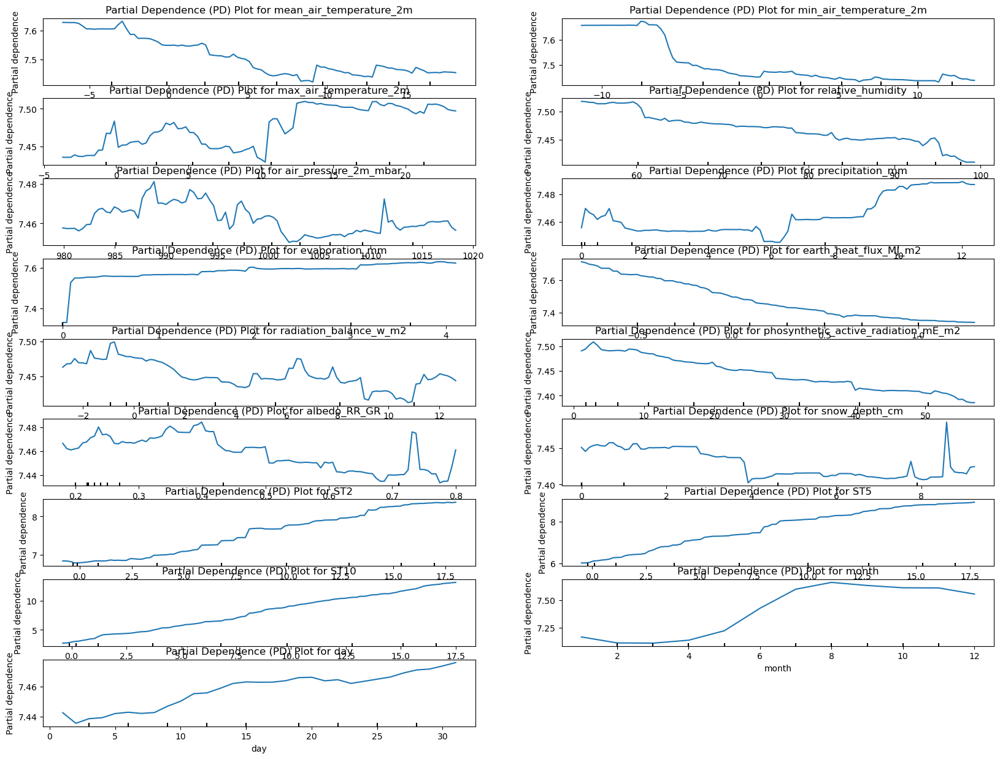

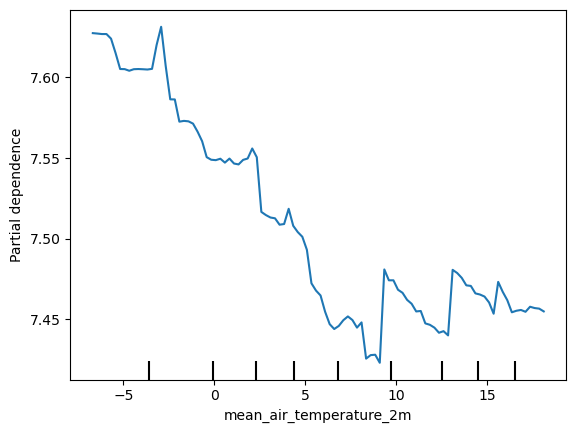

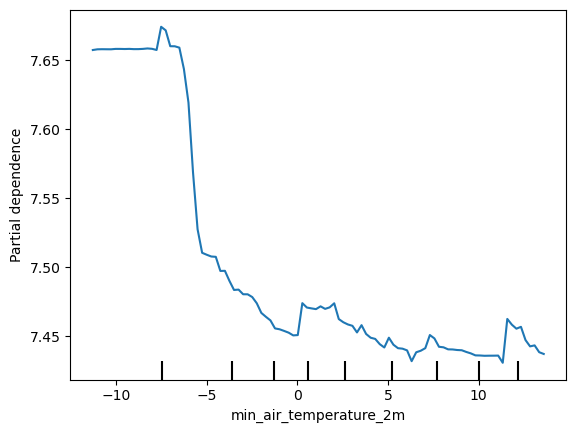

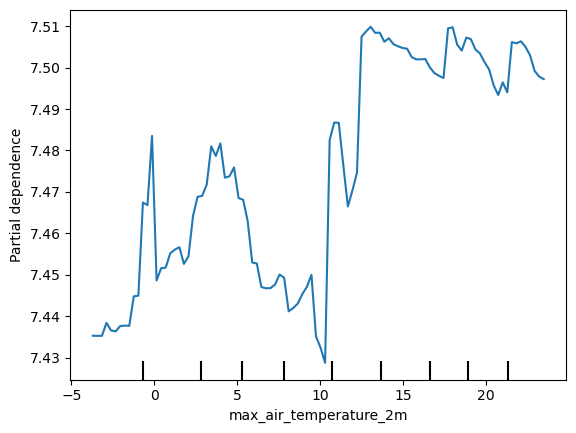

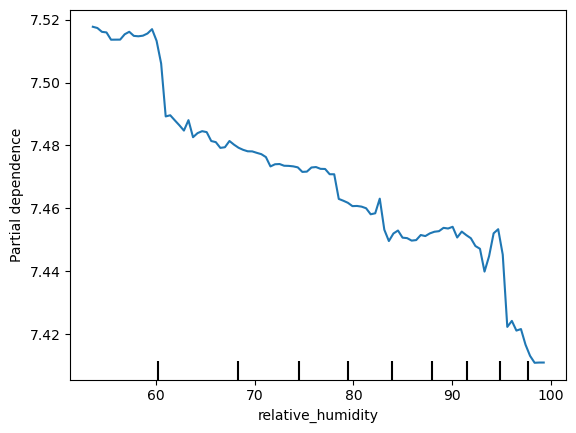

...

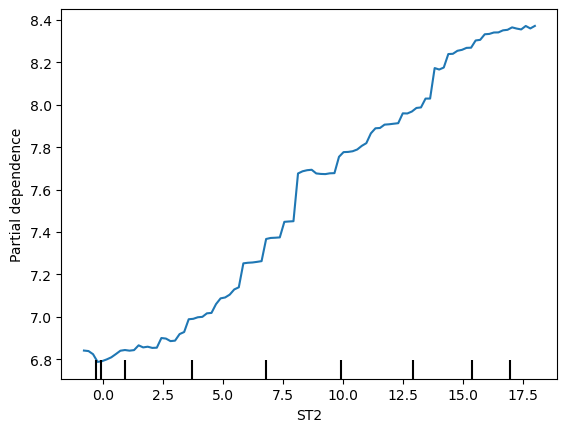

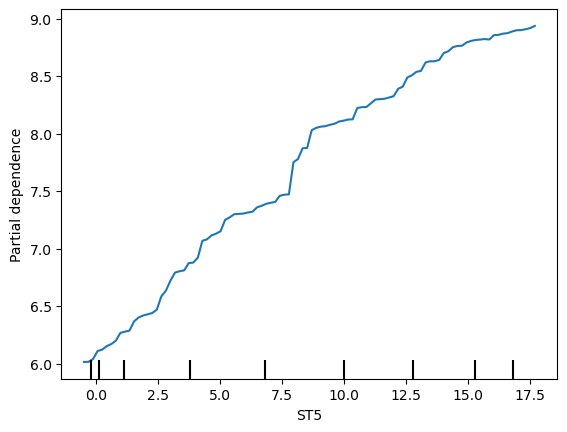

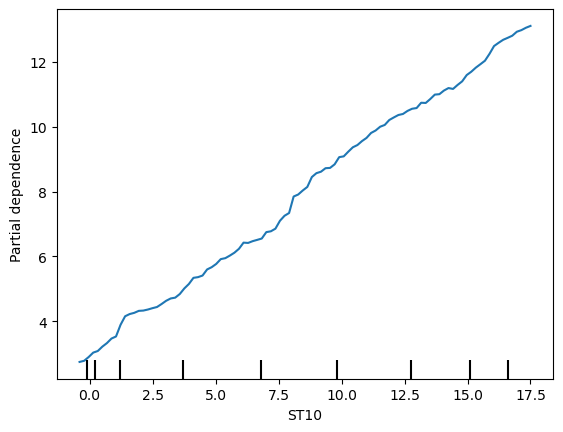

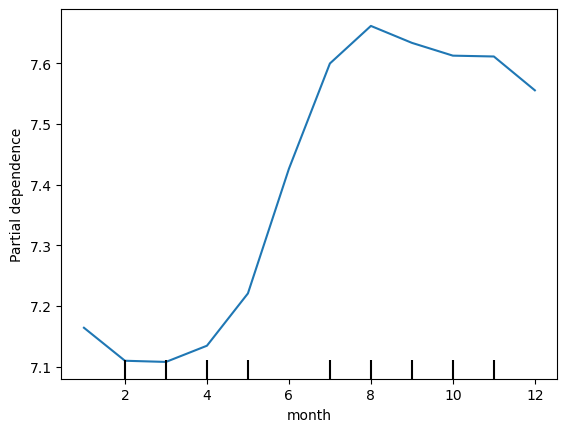

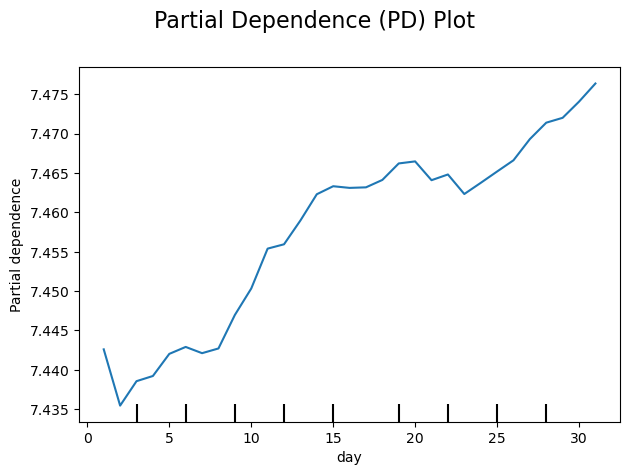

======================== ST20 Individual Conditional Expectation Plot  ===============================


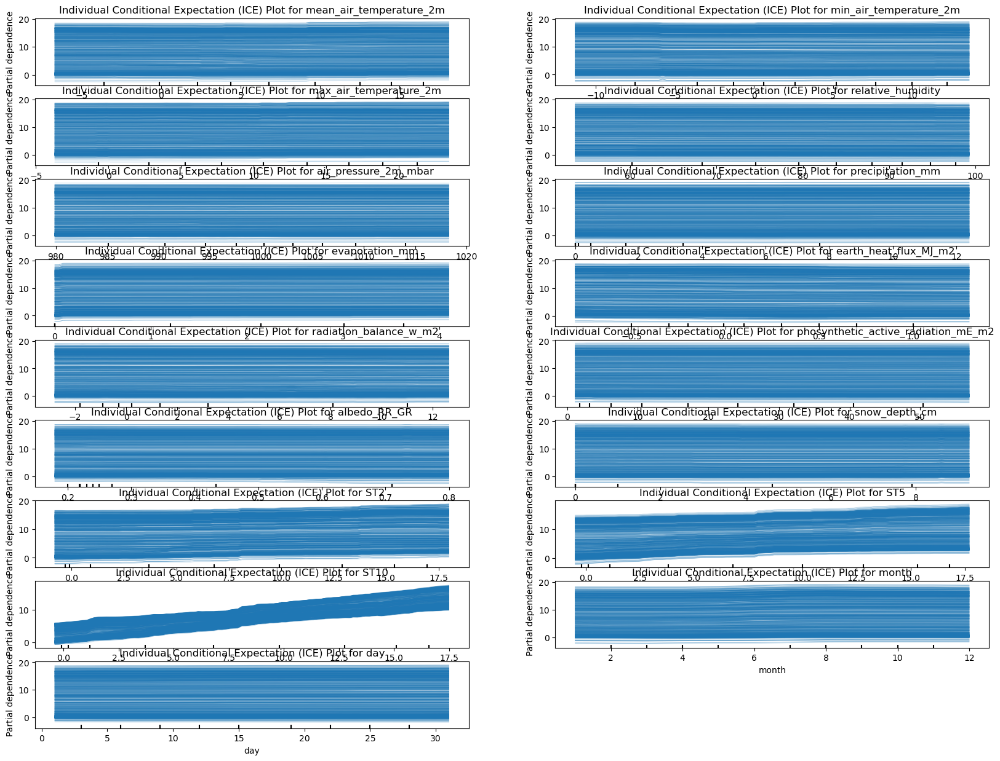

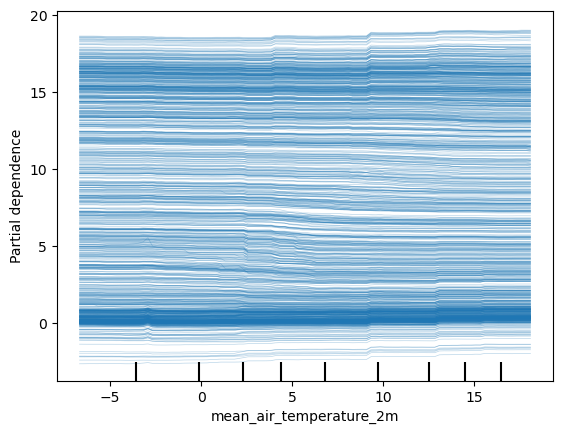

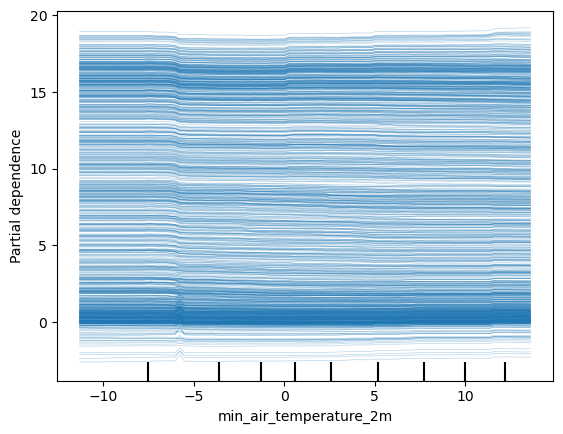

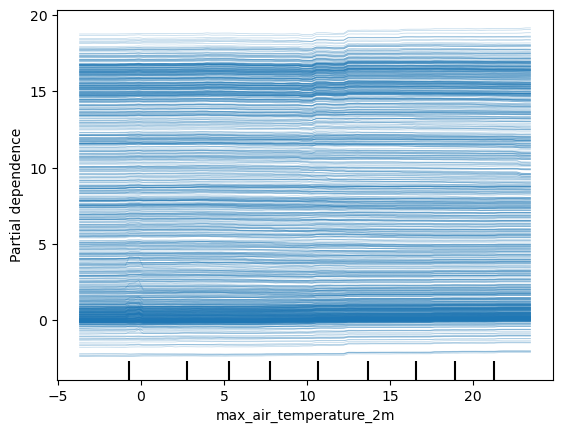

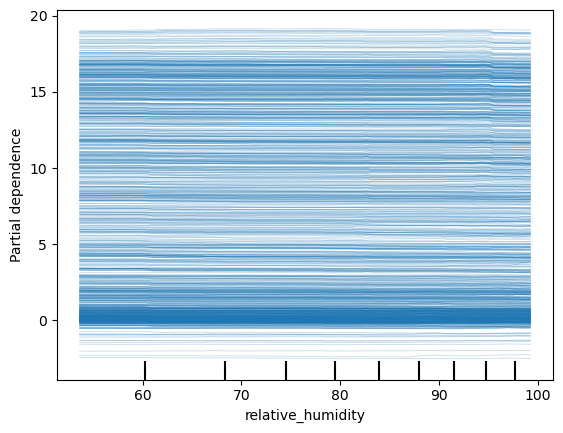

...

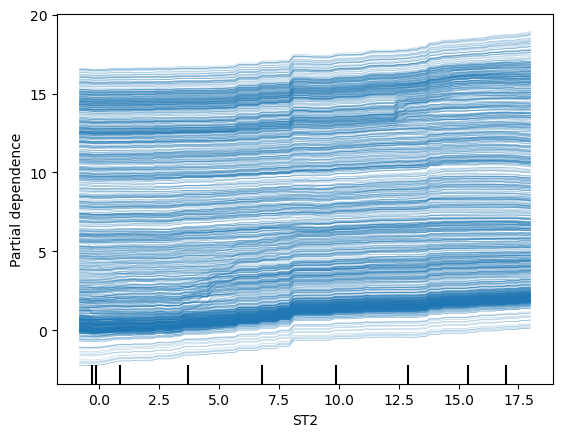

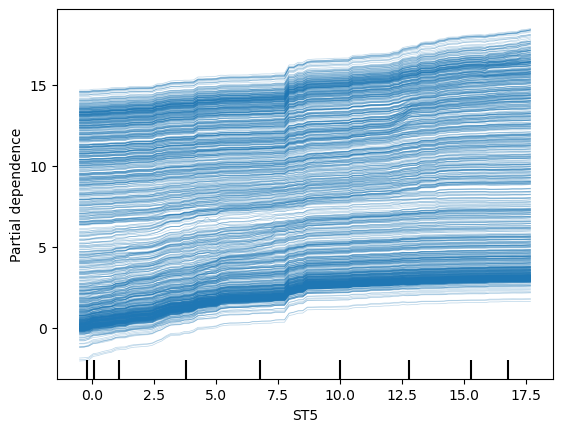

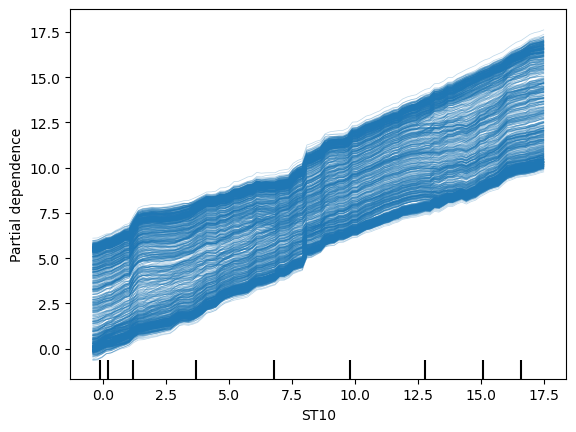

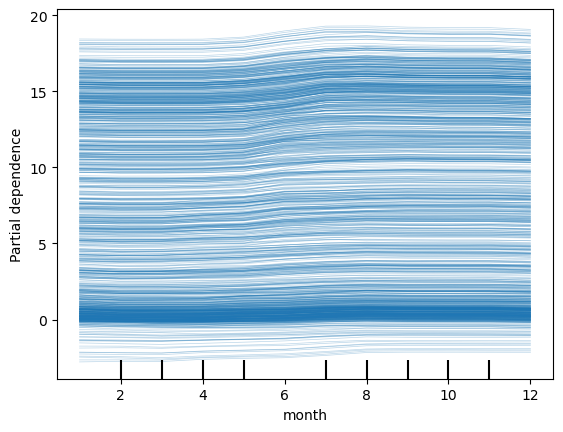

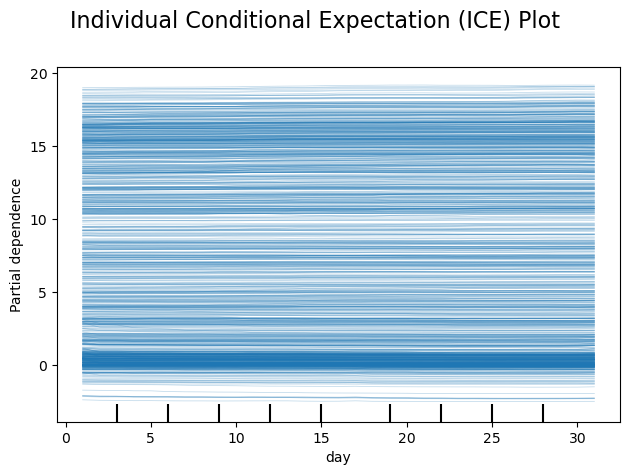

========================= ST20 Residual Analysis Plot ==============================


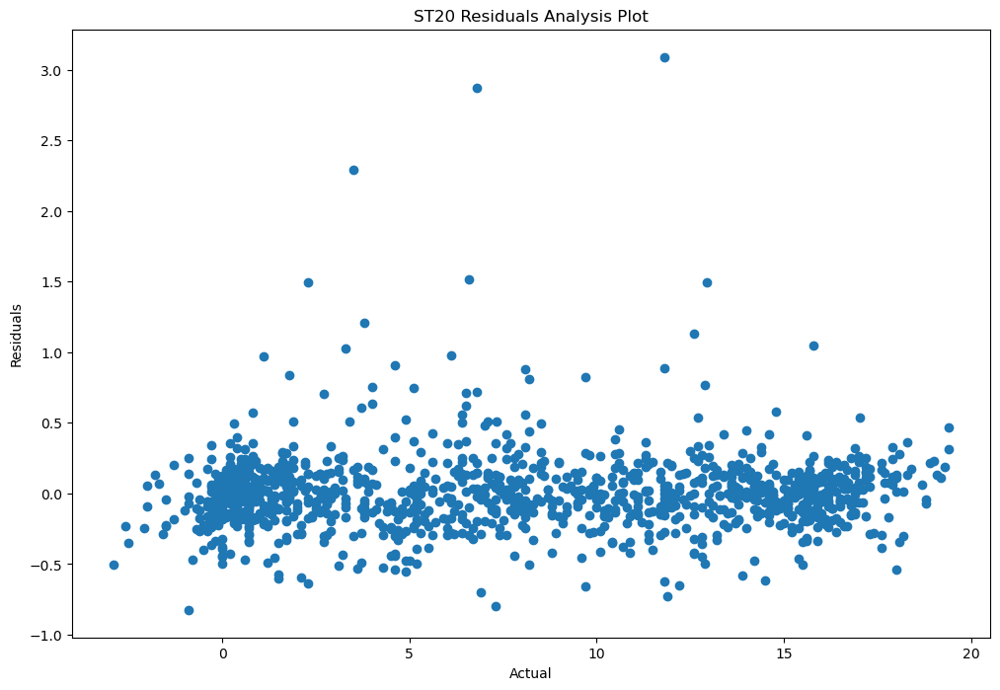

========================= ST20 Q-Q Plot ==============================


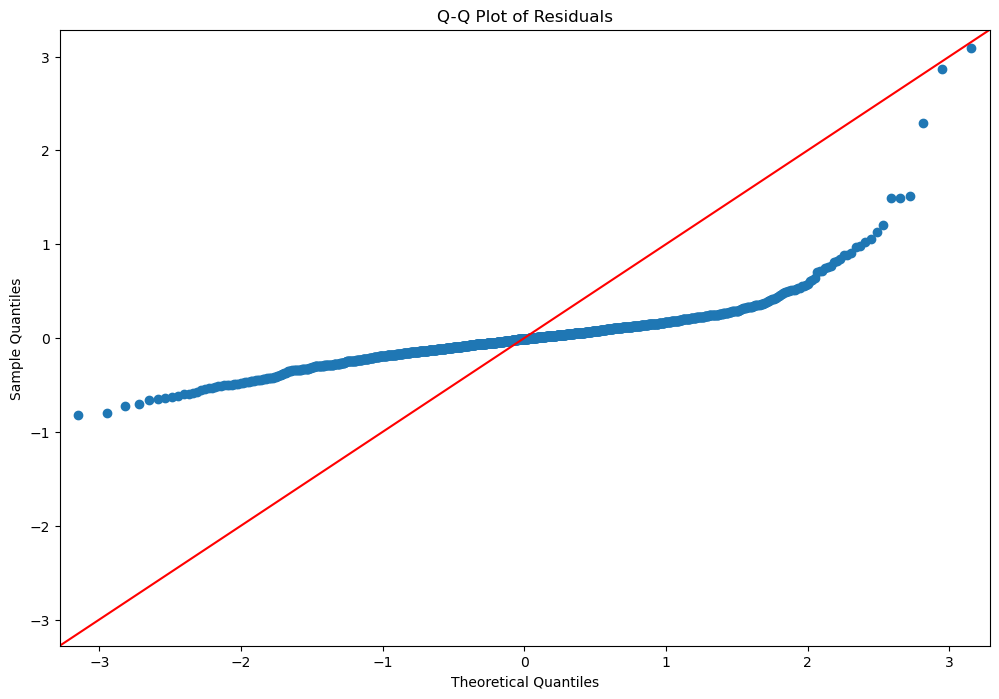

In [146]:
from sklearn.inspection import PartialDependenceDisplay
import statsmodels.api as sm
from pycebox.ice import ice, ice_plot
import matplotlib.pyplot as plt

# Partial Dependence Plot
print('====================================================== ST20 Partial Dependence Plot')
ST20_feature_names = ST20_X_train.columns.tolist()
n_features = len(ST20_feature_names)
n_cols = 2
n_rows = (n_features + n_cols - 1) // n_cols

fig1, ax1 = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 15))
axes_flat = ax1.flatten()

for idx, feature in enumerate(ST20_feature_names):
    display = PartialDependenceDisplay.from_estimator(ST20_stacking_regressor, ST20_X_train, features=[feature])
    display.plot(ax=axes_flat[idx])
    axes_flat[idx].set_title(f'Partial Dependence (PD) Plot for {feature}')
    axes_flat[idx].set_xlabel(feature)

for idx in range(n_features, len(axes_flat)):
    fig1.delaxes(axes_flat[idx])

plt.subplots_adjust(hspace=0.5)
plt.suptitle('Partial Dependence (PD) Plot', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.savefig('images/ST20_final_partial_dependence_plot.png')
plt.show()

# Individual Conditional Expectation Plot (ICE)
print('======================== ST20 Individual Conditional Expectation Plot ===============================')
fig2, axes2 = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 15))
axes_flat2 = axes2.flatten()

for idx, feature in enumerate(ST20_feature_names):
    display = PartialDependenceDisplay.from_estimator(ST20_stacking_regressor, ST20_X_train, features=[feature], kind='individual')
    display.plot(ax=axes_flat2[idx])
    axes_flat2[idx].set_title(f'Individual Conditional Expectation (ICE) Plot for {feature}')
    axes_flat2[idx].set_xlabel(feature)

for idx in range(n_features, len(axes_flat2)):
    fig2.delaxes(axes_flat2[idx])

plt.subplots_adjust(hspace=0.7)
plt.suptitle('Individual Conditional Expectation (ICE) Plot', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.savefig('images/ST20_final_individual_conditional_expectation_plot.png')
plt.show()

# Residual Analysis
print('========================= ST20 Residual Analysis Plot ==============================')
ST20_Y_predictions = ST20_stacking_regressor.predict(ST20_X_test)
ST20_residuals = ST20_Y_test - ST20_Y_predictions

fig3, ax3 = plt.subplots(figsize=(10, 7))
ax3.scatter(ST20_Y_predictions, ST20_residuals)
ax3.set_xlabel('Predictions')
ax3.set_ylabel('Residuals')
ax3.set_title('ST20 Residuals Analysis Plot')
plt.axhline(y=0, color='r', linestyle='--')
plt.savefig('images/ST20_final_residual_analysis_plot.png')
plt.show()

# Residuals vs. Predictor Variables
print('========================= Residuals vs. Predictor Variables ==============================')
for column in ST20_X_test.columns:
    fig, ax = plt.subplots(figsize=(10, 7))
    ax.scatter(ST20_X_test[column], ST20_residuals)
    ax.axhline(y=0, color='r', linestyle='--')
    ax.set_xlabel(column)
    ax.set_ylabel('Residuals')
    ax.set_title(f'Residuals vs. {column}')
    plt.savefig(f'images/ST20_final_residuals_vs_{column}.png')
    plt.show()

# Q-Q Plot
print('========================= ST20 Q-Q Plot ==============================')
fig5, ax5 = plt.subplots(figsize=(10, 7))
sm.qqplot(ST20_residuals, line='45', ax=ax5)
ax5.set_title('Q-Q Plot of Residuals')
plt.savefig('images/ST20_final_Q-Q_plot.png')
plt.show()

# Histogram of residuals
fig6, ax6 = plt.subplots(figsize=(10, 7))
plt.figure(figsize=(10, 6))
sns.histplot(residuals, kde=True, ax=ax6)
plt.xlabel('Residuals')
plt.title('Histogram of Residuals')
plt.show()


### Feature Importance analysis ST20

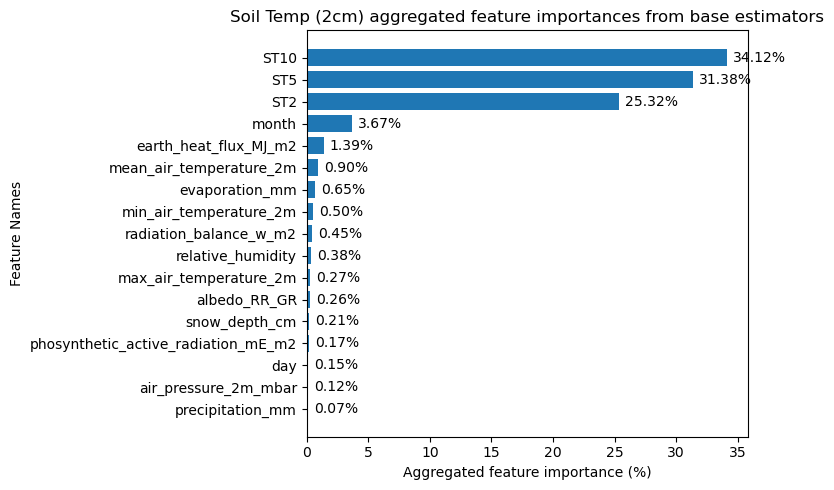

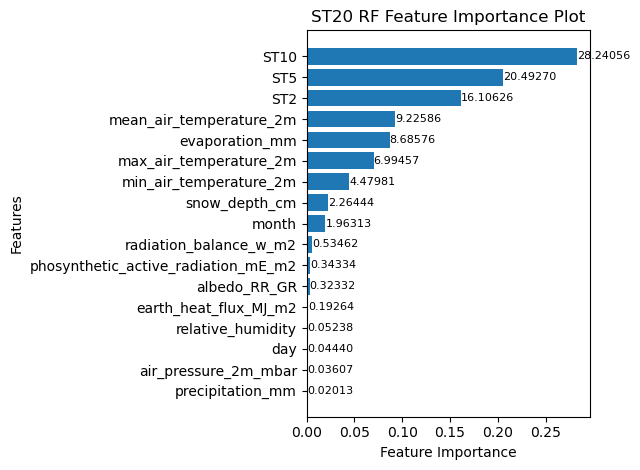

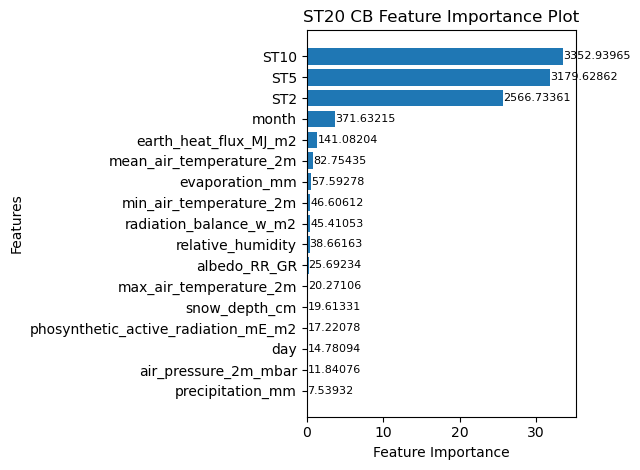

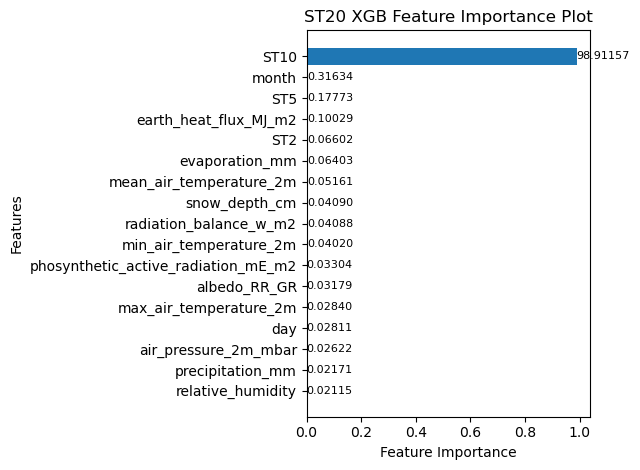

In [213]:
np.random.seed(42)
# Assuming feature_names is a list of your feature names
feature_names = ST20_X_train.columns.tolist()

estimators = [
    ("Random Forest", ST20_rf_model),
    ("Cat Boost", ST20_cb_model),
    ("XG Boost", ST20_xgb_model)
]

# Initialize an array to store aggregated feature importances
num_features = ST20_X_train.shape[1]
feature_importances = np.zeros(num_features, dtype=np.float64)

# Aggregate feature importances from base models
count = 0
for name, model in estimators:
    if hasattr(model, 'feature_importances_'):
        importances = np.array(model.feature_importances_, dtype=np.float64)
        feature_importances += importances
        count += 1
    else:
        print(f"{name} does not have feature_importances_ attribute")

# Normalize the aggregated feature importances
if count > 0:
    feature_importances /= count

# Convert feature importances to percentages
feature_importances_percentage = 100 * (feature_importances / feature_importances.sum())

# Sort the feature importances in descending order
sorted_indices = np.argsort(feature_importances_percentage)[::-1]
sorted_feature_importances_percentage = feature_importances_percentage[sorted_indices]
sorted_feature_names = [feature_names[i] for i in sorted_indices]

# Plot the sorted feature importances
plt.figure(figsize=(8, 5))
bars = plt.barh(sorted_feature_names, sorted_feature_importances_percentage)
plt.xlabel("Aggregated feature importance (%)")
plt.ylabel("Feature Names")
plt.title("Soil Temp (2cm) aggregated feature importances from base estimators")
plt.gca().invert_yaxis()  # Highest importance at the top

# Add annotations to the bars
for bar in bars:
    width = bar.get_width()
    plt.text(
        width + 0.5,  # Offset slightly to the right of the bar
        bar.get_y() + bar.get_height() / 2,  # Vertical center of the bar
        f'{width:.2f}%',  # Display the width (importance value) formatted to 2 decimal places
        va='center'
    )
# Save the figure
plt.tight_layout()
plt.savefig('data/results/ST20_stacking_regressors_feature_importances.png')
plt.show()

plot_features(ST20_X_train.columns, ST20_rf_model.feature_importances_, 'images/ST20_RF_feature_analysis.png', 'ST20 RF Feature Importance Plot')
plot_features(ST20_X_train.columns, ST20_cb_model.feature_importances_/100, 'images/ST20_CB_feature_analysis.png', 'ST20 CB Feature Importance Plot')
plot_features(ST20_X_train.columns, ST20_xgb_model.feature_importances_, 'images/ST20_XGB_feature_analysis.png', 'ST20 XGB Feature Importance Plot')

### GridSearhCV Evaluation for all models used in the stacked regressor for ST20

In [146]:
%%time
import time
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor, HistGradientBoostingRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.model_selection import cross_val_predict, cross_validate
from catboost import CatBoostRegressor



# Define parameter grids for each model
param_grid_cb = {
    'iterations': [100, 200, 500],
    'learning_rate': [0.01, 0.1, 0.05],
    'depth': [4, 6, 10],
    'l2_leaf_reg': [1, 3, 5, 7, 9],
    'border_count': [32, 50, 100]
}
param_grid_rf = {
    'n_estimators': [100, 300, 500],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

param_grid_hgb = {
    'learning_rate': [0.01, 0.1, 0.05],
    'max_iter': [100, 200, 500],
    'max_leaf_nodes': [31, 50, 100],
    'max_depth': [None, 10, 20],
    'min_samples_leaf': [20, 50, 100],
    'l2_regularization': [0, 0.1, 1]
}

param_grid_xgb = {
    'n_estimators': [100, 200, 500],
    'learning_rate': [0.01, 0.1, 0.05],
    'max_depth': [3, 5, 7],
    'subsample': [1.0, 0.8, 0.6],
    'colsample_bytree': [1.0, 0.8, 0.6],
    'gamma': [0, 1, 5],
    'reg_alpha': [0, 0.1, 1],
    'reg_lambda': [1, 0.1, 0.01],
    'tree_method': ['gpu_hist']  # Use GPU
}
param_grid_ada = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.05],
    'loss': ['linear', 'square', 'exponential']
}
# stacking_param_grid ={
#     'rf__n_estimators': [100, 300, 500],
#     'rf__max_depth': [None, 10, 20, 30],
#     'hgb__learning_rate': [0.01, 0.1, 0.05],
#     'hgb__max_iter': [100, 200, 500],
#     'catboost__iterations': [100, 200, 500],
#     'catboost__learning_rate': [0.01, 0.1, 0.05],
#     'catboost__depth': [4, 6, 10],
#     'xgb__n_estimators': [100, 200],
#     'xgb__max_depth': [3, 5]
# }


# Initialize models
cb = CatBoostRegressor(random_state=42)
rf = RandomForestRegressor(random_state=42)
hgb = HistGradientBoostingRegressor(random_state=42)
ada = AdaBoostRegressor(random_state=42)
xgb = XGBRegressor(random_state=42, objective='reg:squarederror')

# estimators = [
#     ('rf', RandomForestRegressor()),
#     ('cb', CatBoostRegressor()),
#     ('hgb', HistGradientBoostingRegressor()),    
#     ('xgb', XGBRegressor())
# ]

# stacking_regressor = StackingRegressor(
#     estimators=estimators,
#     final_estimator=RidgeCV()
# )

# Initialize GridSearchCV for RF model
start_time_rf = time.time()
ST20_grid_search_rf = GridSearchCV(estimator=rf, param_grid=param_grid_rf, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_rf_search = time.time()
ST20_grid_search_rf.fit(ST20_X_train, ST20_Y_train)
end_time_rf_fit = time.time()
elapsed_time_search_rf = end_time_rf_search - start_time_rf
elapsed_time_fit_rf = end_time_rf_fit - end_time_rf_search
# Get the best parameters and scores
print("Best parameters for RandomForestRegressor:", ST20_grid_search_rf.best_params_)
print("Best score for RandomForestRegressor:", -ST20_grid_search_rf.best_score_)
print("RandomForestRegressor GridSearchCV Time:", elapsed_time_search_rf)
print("RandomForestRegressor Fitting Time:", elapsed_time_fit_rf)

# Initialize GridSearchCV for HGB model
start_time_hgb = time.time()
ST20_grid_search_hgb = GridSearchCV(estimator=hgb, param_grid=param_grid_hgb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_hgb_search = time.time()
ST20_grid_search_hgb.fit(ST20_X_train, ST20_Y_train)
end_time_hgb_fit = time.time()
elapsed_time_search_hgb = end_time_hgb_search - start_time_hgb
elapsed_time_fit_hgb = end_time_hgb_fit - end_time_hgb_search
# Get the best parameters and scores
print("Best parameters for HistGradientBoostingRegressor:", ST20_grid_search_hgb.best_params_)
print("Best score for HistGradientBoostingRegressor:", -ST20_grid_search_hgb.best_score_)
print("HistGradientBoostingRegressor GridSearchCV Time:", elapsed_time_search_hgb)
print("HistGradientBoostingRegressor Fitting Time:", elapsed_time_fit_hgb)

# # Initialize GridSearchCV for XGB model
# start_time_xgb = time.time()
# ST20_grid_search_xgb = GridSearchCV(estimator=xgb, param_grid=param_grid_xgb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
# end_time_xgb_search = time.time()
# ST20_grid_search_xgb.fit(ST20_X_train, ST20_Y_train)
# end_time_xgb_fit = time.time()
# elapsed_time_search_xgb = end_time_xgb_search - start_time_xgb
# elapsed_time_fit_xgb = end_time_xgb_fit - end_time_xgb_search
# # Get the best parameters and scores
# print("Best parameters for XGBRegressor:", ST20_grid_search_xgb.best_params_)
# print("Best score for XGBRegressor:", -ST20_grid_search_xgb.best_score_)
# print("XGBRegressor GridSearchCV Time:", elapsed_time_search_xgb)
# print("XGBRegressor Fitting Time:", elapsed_time_fit_xgb)

# Initialize GridSearchCV for ADA model
start_time_ada = time.time()
ST20_grid_search_ada = GridSearchCV(estimator=ada, param_grid=param_grid_ada, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_ada_search = time.time()
ST20_grid_search_ada.fit(ST20_X_train, ST20_Y_train)
end_time_ada_fit = time.time()
elapsed_time_search_ada = end_time_ada_search - start_time_ada
elapsed_time_fit_ada = end_time_ada_fit - end_time_ada_search
# Get the best parameters and scores
print("Best parameters for AdaBoostRegressor:", ST20_grid_search_ada.best_params_)
print("Best score for AdaBoostRegressor:", -ST20_grid_search_ada.best_score_)
print("AdaBoostRegressor GridSearchCV Time:", elapsed_time_search_ada)
print("AdaBoostRegressor Fitting Time:", elapsed_time_fit_ada)

# # Initialize GridSearchCV for CB model
# start_time_cb = time.time()
# ST20_grid_search_cb = GridSearchCV(estimator=cb, param_grid=param_grid_cb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
# end_time_cb_search = time.time()
# ST20_grid_search_cb.fit(ST20_X_train, ST20_Y_train)
# end_time_cb_fit = time.time()
# elapsed_time_search_cb = end_time_cb_search - start_time_cb
# elapsed_time_fit_cb = end_time_cb_fit - end_time_cb_search
# # Get the best parameters and scores
# print("Best parameters for CatBoostRegressor:", ST20_grid_search_cb.best_params_)
# print("Best score for CatBoost:", -ST20_grid_search_cb.best_score_)
# print("CatBoostRegressor GridSearchCV Time:", elapsed_time_search_cb)
# print("CatBoostRegressor Fitting Time:", elapsed_time_fit_cb)

# # Initialize GridSearchCV for Stacking model
# start_time_stacking = time.time()
# ST20_grid_search_stacking = GridSearchCV(estimator=stacking_regressor, param_grid=stacking_param_grid, cv=5, n_jobs=-1, verbose=0,scoring='neg_mean_absolute_error')
# end_time_stacking_search = time.time()
# ST20_grid_search_stacking.fit(ST20_X_train, ST20_Y_train)
# end_time_stacking = time.time()
# elapsed_time_search_stacking = end_time_stacking_search - start_time_stacking
# elapsed_time_fit_stacking = end_time_stacking_fit - end_time_stacking_search

# print("Best parameters for StackingRegressor:", ST20_grid_search_stacking.best_params_)
# print("Best score for StackingRegressor:", -ST20_grid_search_stacking.best_score_)
# print("StackingRegressor GridSearchCV Time:", elapsed_time_search_stacking)
# print("StackingRegressor Fitting Time:", elapsed_time_fit_stacking)

# # Define the results of print statements as variables
# ST20_grid_search_and_fitting_results = {
#     'Model': ['RandomForestRegressor', 'HistGradientBoostingRegressor', 'AdaBoostRegressor', 'XGBRegressor'],
#     'Best Parameters': [ST20_grid_search_rf.best_params_, ST20_grid_search_hgb.best_params_, ST20_grid_search_ada.best_params_, ST20_grid_search_xgb.best_params_],
#     'Best Score': [-ST20_grid_search_rf.best_score_, -ST20_grid_search_hgb.best_score_, -ST20_grid_search_ada.best_score_, -ST20_grid_search_xgb.best_score_],
#     'GridSearchCV Time': [elapsed_time_search_rf, elapsed_time_search_hgb, elapsed_time_search_ada, elapsed_time_search_xgb],
#     'Fitting Time': [elapsed_time_fit_rf, elapsed_time_fit_hgb, elapsed_time_fit_ada, elapsed_time_fit_xgb]
# }

# # Create a DataFrame
# df_results = pd.DataFrame(ST20_grid_search_and_fitting_results)

# # Export DataFrame to Excel
# df_results.to_excel('data/ST20_grid_search_and_fitting_results.xlsx', index=False)

### E. Stacking Regressor for Soil temperature at 50cm

### Correlation Analysis

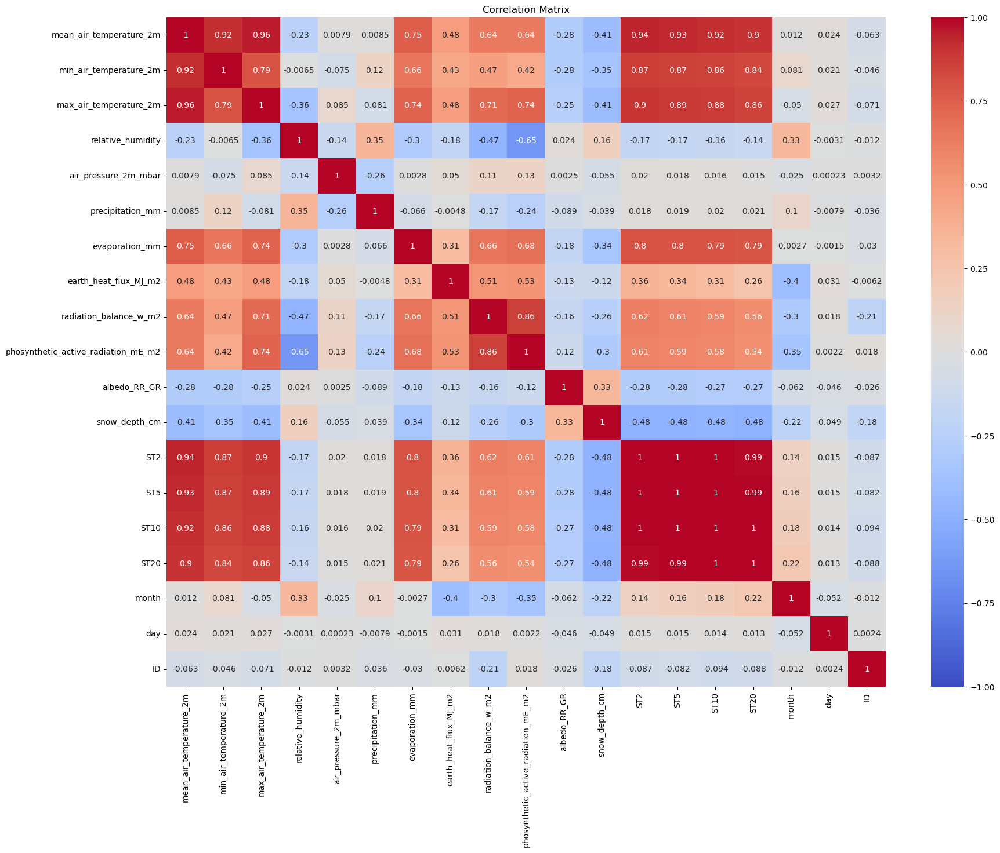

Highly correlated pairs (above threshold):
('mean_air_temperature_2m', 'max_air_temperature_2m')
('ST2', 'ST5')
('ST2', 'ST10')
('ST2', 'ST20')
('ST5', 'ST10')
('ST5', 'ST20')
('ST10', 'ST20')
Removed features: {'max_air_temperature_2m', 'ST5', 'ST10', 'ST20'}
Shape of the reduced dataset: (5193, 15)


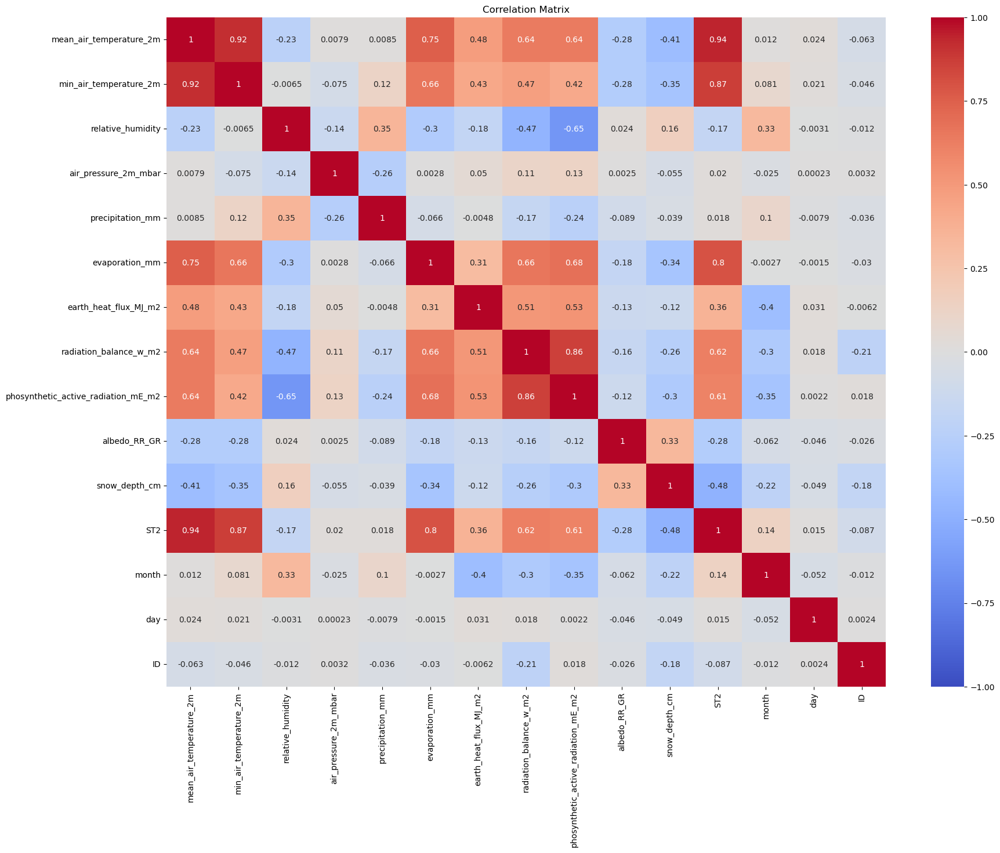

Removing feature 'const' with VIF: 10967.94811471953
Removing feature 'air_pressure_2m_mbar' with VIF: 148.50233810512586
Removing feature 'mean_air_temperature_2m' with VIF: 63.176661735873196
Final VIF data:
                                feature        VIF
0                min_air_temperature_2m   9.809880
1                     relative_humidity  23.715929
2                      precipitation_mm   1.543443
3                        evaporation_mm   6.462821
4                 earth_heat_flux_MJ_m2   2.053133
5                radiation_balance_w_m2   6.920916
6   phosynthetic_active_radiation_mE_m2  14.470093
7                          albedo_RR_GR  12.226767
8                         snow_depth_cm   1.713419
9                                   ST2  31.301160
10                                month  11.938028
11                                  day   4.092235


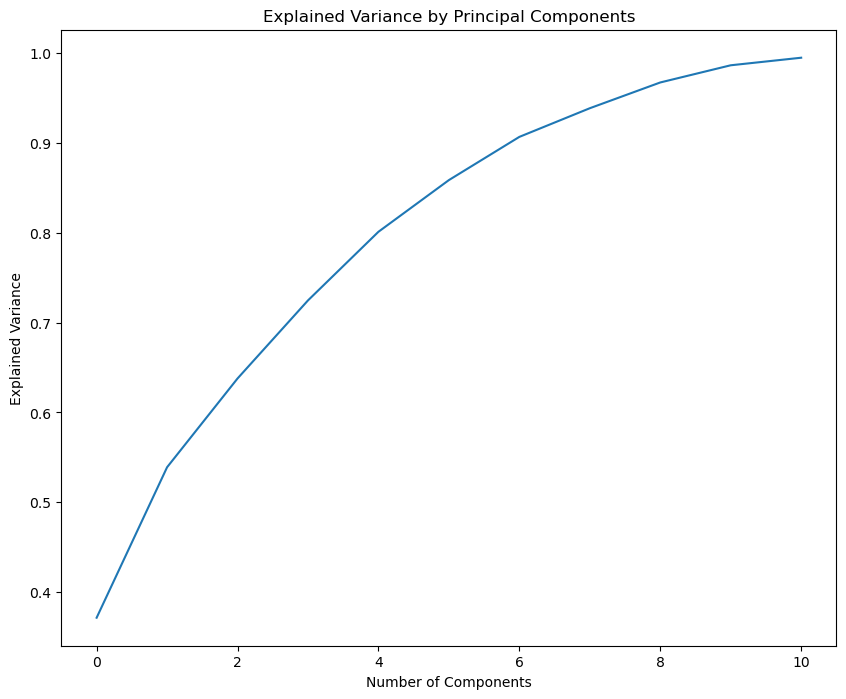

In [214]:
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Calculate the covariance matrix for target ST100
ST50_dataset_correlation = ST50_clean_dataset_denormalized.drop(['ST100', 'ST50'], axis=1)
ST50_covariance_matrix = ST50_dataset_correlation.cov()

# Calculate the correlation matrix
ST50_correlation_matrix = ST50_dataset_correlation.corr()

# Visualize the correlation matrix
plt.figure(figsize=(20, 15))
sns.heatmap(ST50_correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.savefig("images/ST50_denormalized_before_correlation_matrix.png")
plt.show()

# Set the threshold
threshold = 0.95
# Find pairs of features with correlation above the threshold
highly_correlated = np.where(np.abs(ST50_correlation_matrix) > threshold)
highly_correlated_pairs = [(ST50_correlation_matrix.index[x], ST50_correlation_matrix.columns[y]) 
                           for x, y in zip(*highly_correlated) if x != y and x < y]

print("Highly correlated pairs (above threshold):")
for pair in highly_correlated_pairs:
    print(pair)
# Example: Removing one feature from each highly correlated pair
features_to_remove = set()
for pair in highly_correlated_pairs:
    features_to_remove.add(pair[1])  # You can choose to remove pair[0] or pair[1]

# Drop the features from the dataframe
ST50_dataset_denormalized_outlier_filtered_uncorrelated = ST50_dataset_correlation.drop(columns=features_to_remove)

print(f"Removed features: {features_to_remove}")
print("Shape of the reduced dataset:", ST50_dataset_denormalized_outlier_filtered_uncorrelated.shape)

# After removing the correlated features
# Calculate the correlation matrix
ST50_correlation_matrix_new = ST50_dataset_denormalized_outlier_filtered_uncorrelated.corr()

# Visualize the correlation matrix
plt.figure(figsize=(20, 15))
sns.heatmap(ST50_correlation_matrix_new, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.savefig("images/ST50_denormalized_after_correlation_matrix.png")
plt.show()

# Assuming dataset_denormalized_outlier_filtered is your DataFrame
ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = ST50_dataset_denormalized_outlier_filtered_uncorrelated.copy()

# Add a constant term for the intercept
ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = sm.add_constant(ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif)
ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop('ID', axis=1, inplace=True)

# Function to calculate VIF
def calculate_vif(data):
    vif_data = pd.DataFrame()
    vif_data["feature"] = data.columns
    vif_data["VIF"] = [variance_inflation_factor(data.values, i) for i in range(data.shape[1])]
    return vif_data

# Iteratively remove features with VIF above the threshold
def remove_high_vif_features(data, threshold=40.0):
    while True:
        vif_data = calculate_vif(data)
        max_vif = vif_data['VIF'].max()
        if max_vif > threshold:
            # Identify the feature with the highest VIF
            feature_to_remove = vif_data.sort_values('VIF', ascending=False)['feature'].iloc[0]
            print(f"Removing feature '{feature_to_remove}' with VIF: {max_vif}")
            data = data.drop(columns=[feature_to_remove])
        else:
            break
    return data, vif_data

# Remove high VIF features
ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif, ST50_final_vif_data = remove_high_vif_features(ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif)

print("Final VIF data:")
print(ST50_final_vif_data)
ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ID'] = ST50_clean_dataset_denormalized['ID']
ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ST50'] = ST50_clean_dataset_denormalized['ST50']
ST50_dataset_denormalized_outlier_filtered_uncorrelated['ID'] = ST50_clean_dataset_denormalized['ID']
ST50_dataset_denormalized_outlier_filtered_uncorrelated['ST50'] = ST50_clean_dataset_denormalized['ST50']
# Remove the constant term before creating the final DataFrame
if 'const' in ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.columns:
    ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop(columns=['const'])

# Store the 'ID' and 'ST50' columns with their corresponding index before PCA
ID_index_mapping = ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ID']
ST50_index_mapping = ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ST50']

# Assume X is your feature dataframe
ST50_X_pca = ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop(['ST50', 'ID'], axis=1)

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(ST50_X_pca)

# Apply PCA
pca = PCA(n_components=0.99)  # Choose the number of components
principal_components = pca.fit_transform(X_scaled)

# Create a DataFrame with the principal components
ST50_pca_df = pd.DataFrame(data=principal_components, columns=[f"PC{i}" for i in range(principal_components.shape[1])])

# Merge PCA DataFrame with original DataFrame to maintain original index order
ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca = pd.merge(ID_index_mapping, ST50_index_mapping, left_index=True, right_index=True)
ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca = pd.merge(ST50_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca, ST50_pca_df, left_index=True, right_index=True)

# Plot the explained variance
plt.figure(figsize=(10,8))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Explained Variance')
plt.title('Explained Variance by Principal Components')
plt.savefig('images/ST50_PCA_analysis.png')
plt.show()

### Option 1: Dataset used is after correlation analysis

In [215]:
%%time
import numpy as np
from sklearn.linear_model import LassoCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.metrics import PredictionErrorDisplay
from sklearn.model_selection import cross_val_predict, cross_validate
import time

np.random.seed(42)
  
# Create function to evaluate model on few different levels
def show_scores(model, X_train, X_valid, Y_train, Y_valid, target='ST50', model_name='RF'):
    """
    Calculates and shows the different sklearn evaluation metrics
        
    Parameters:
        model: the model fitted.
        X_train: the input training set.
        X_valid: the input validation or test set.
        Y_train: the target training set.
        Y_valid: the target validation or test set.
            
    Returns:
        scores: the dictionary of the calculated sklearn metrics for train and valid sets.
    """
    
    train_preds = model.predict(X_train)
    val_preds = model.predict(X_valid)
    scores = {
              # "Training Set R^2 Score": r2_score(Y_train, train_preds),
              "Validation Set R^2 Score":r2_score(Y_valid, val_preds),
              # "Training Set MAE": mean_absolute_error(Y_train, train_preds),
              "Validation Set MAE": mean_absolute_error(Y_valid, val_preds),             
              # "Training Set MSE": mean_squared_error(Y_train, train_preds),
              "Validation Set MSE": mean_squared_error(Y_valid, val_preds),
              # "Training Set Median Absolute Error": median_absolute_error(Y_train, train_preds),
              "Validation Set Median Absolute Error": median_absolute_error(Y_valid, val_preds),
              # "Training Set MA Percentage Error": mean_absolute_percentage_error(Y_train, train_preds),
              # "Validation Set MA Percentage Error": mean_absolute_percentage_error(Y_valid, val_preds),
              # "Training Set Max Error": max_error(Y_train, train_preds),
              "Validation Set Max Error": max_error(Y_valid, val_preds),
              # "Training Set Explained Variance Score": explained_variance_score(Y_train, train_preds),
              "Validation Set Explained Variance Score": explained_variance_score(Y_valid, val_preds)}
    # Convert the dictionary to a DataFrame
    df = pd.DataFrame(list(scores.items()), columns=['Metric', 'Value'])    
    # Export the DataFrame to an Excel file
    df.to_excel(f'data/results/{target}_{model_name}_scores.xlsx', index=False)
    return scores

# Define a function that takes test set and validation sets as input and generates prediction curve and returns test set prediction data 
def predict_plot(model, ST_X_test, ST_X_validation, ST_Y_validation, name):
    # Predict the test set which is forecast data
    ST_Y_test_preds = model.predict(ST_X_test)
    # Changes the predicted array values to pandas series
    ST_Y_test_preds_series = pd.Series(ST_Y_test_preds, name=name) 
    # Convert the Series to a DataFrame
    ST_Y_test_preds_df = ST_Y_test_preds_series.to_frame()
    ST_Y_test_preds_df.index =  ST_X_test.index
    # Predict the validation set
    ST_Y_validation_preds = model.predict(ST_X_validation)
    # Change validation predictions to pandas series
    ST_Y_validation_preds_series = pd.Series(ST_Y_validation_preds)
    # Make the original and predicted series to have the same index
    ST_Y_validation_preds_series.index =ST_Y_validation.index
    # Sort Y_valid and Y_valid_preds in ascending order and reset indices
    ST_Y_validation_sorted = ST_Y_validation.sort_values().reset_index(drop=True)
    ST_Y_validation_preds_sorted = ST_Y_validation_preds_series[ST_Y_validation.index].sort_values().reset_index(drop=True)
  
    # Calculate mean absolute error
    ST_mae = mean_absolute_error(ST_Y_validation,ST_Y_validation_preds)
    # Calculate mean squared error
    ST_mse = mean_squared_error(ST_Y_validation,ST_Y_validation_preds)
    # Calculate the R^2 score
    ST_r2_score = r2_score(ST_Y_validation,ST_Y_validation_preds)
    # Plot the sorted values
    plt.figure(figsize=(10, 6))
    plt.plot(ST_Y_validation_sorted.index,ST_Y_validation_sorted, color='blue', label=f'{name} Actual Values')
    plt.plot(ST_Y_validation_preds_sorted.index,ST_Y_validation_preds_sorted, color='red', label=f'{name} Predicted Values')
    # Display the mean absolute error as text annotation
    plt.text(0.4, 0.95, f'MAE: {ST_mae:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.text(0.6, 0.95, f'MSE: {ST_mse:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.text(0.8, 0.95, f'R^2: {ST_r2_score:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.xlabel('Index')
    plt.ylabel(f'Soil Temperature at 50 cm (°C)')
    plt.title(f'Comparison of {name} Actual vs Predicted Values')
    plt.legend()
    plt.grid(True)
    plt.savefig(f'data/results/{name}_predicted_vs_actual_values_line_plot.png')  # Save as PNG format
    plt.show()
    return ST_Y_test_preds_df
    
# Let us shuffle the entire dataset so that it is randomly arranged
dataset_shuffled = ST50_dataset_denormalized_outlier_filtered_uncorrelated.sample(frac=1)
# Split the dataset into features and target
many_features_dropped = ['earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','ST100','ST50','ID']
soil_features_dropped = ['ST100','ST50','ID']
uncorrelated_dropped = ['ST50','ID']
# ST50_X = dataset_shuffled.drop(many_features_dropped, axis=1)
ST50_X = dataset_shuffled.drop(uncorrelated_dropped, axis=1)
ST50_Y = dataset_shuffled['ST50']

# Split the dataset in to features (independent variables) and labels(dependent variable = target_soil_temperature_2cm ).
# Then split into train, validation and test sets
train_split = round(0.7*len(dataset_shuffled)) # 70% for train set
valid_split = round(train_split + 0.15*len(dataset_shuffled))
ST50_X_train, ST50_Y_train = ST50_X[:train_split], ST50_Y[:train_split]
ST50_X_valid, ST50_Y_valid =ST50_X[train_split:valid_split], ST50_Y[train_split:valid_split]
ST50_X_test, ST50_Y_test = ST50_X[valid_split:], ST50_Y[valid_split:]

# A. CatBoostRegressor (CB)
# Create CB model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST50_cb_model = CatBoostRegressor(iterations=500,
                                learning_rate=0.1,
                                depth=6,
                                l2_leaf_reg=3,
                                loss_function='RMSE',
                                silent=True,
                                random_state=42)
# Fit the model for ST50 to start with
ST50_cb_model.fit(ST50_X_train, ST50_Y_train, eval_set=(ST50_X_valid, ST50_Y_valid), early_stopping_rounds=100)
# Show the scoring metrics for this model
print("====================CatBoost The Evaluation Metrics Results For ST50 Denormalized =======================\n")

print(show_scores(ST50_cb_model, ST50_X_train, ST50_X_valid, ST50_Y_train, ST50_Y_valid, 'ST50', 'CB'))
print("==================================================================================================\n")

# B. RandomForestRegressor
# Create RF model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST50_rf_model = RandomForestRegressor(n_estimators=300, 
                                     min_samples_leaf=1,
                                     min_samples_split=2,
                                     max_features='sqrt',
                                     max_depth=None,
                                     bootstrap=False,
                                     random_state=42)
# Fit the model for ST50 to start with
ST50_rf_model.fit(ST50_X_train, ST50_Y_train)
# Show the scoring metrics for this model
print("====================Random Forest The Evaluation Metrics Results For ST50 Denormalized =======================\n")

print(show_scores(ST50_rf_model, ST50_X_train, ST50_X_valid, ST50_Y_train, ST50_Y_valid,'ST50', 'RF'))
print("==================================================================================================\n")

# C. Histogram Based Gradient Boosting Regressor
# Setup random seed
np.random.seed(42)
# Create Ridge model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST50_gbr_model = HistGradientBoostingRegressor(learning_rate=0.1, 
                                              max_iter=300, 
                                              max_leaf_nodes=41,
                                              random_state=42)
# Fit the ST50 model for soil temp at 100 cm
ST50_gbr_model.fit(ST50_X_train, ST50_Y_train)
# Show the scoring metrics for this model
print("====================The Histogram-Based Gradient Boosting Evaluation Metrics Results For ST50 Denormalized =======================\n")
print(show_scores(ST50_gbr_model, ST50_X_train, ST50_X_valid, ST50_Y_train, ST50_Y_valid,'ST50', 'HGB'))
print("====================================================================================================\n")

# D. XGBoost Regressor
# Setup random seed
np.random.seed(42)
# Create XGBoost for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST50_xgb_model = XGBRegressor(objective='reg:squarederror',
                             learning_rate=0.1, 
                             max_depth=6, 
                             n_estimators=200, 
                             subsample=0.8, 
                             random_state=42)
# Fit the ST50 model for soil temp at 100 cm
ST50_xgb_model.fit(ST50_X_train, ST50_Y_train)
# Show the scoring metrics for this model
print("====================The XGBoost Evaluation Metrics Results For ST50 Denormalized =======================\n")
print(show_scores(ST50_xgb_model, ST50_X_train, ST50_X_valid, ST50_Y_train, ST50_Y_valid,'ST50', 'XGB'))
print("====================================================================================================\n")


# E. AdaBoostRegressor 
# Setup random seed
np.random.seed(42)
# Create AdaBoost Regressor for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST50_adb_model = AdaBoostRegressor(learning_rate=0.1, 
                                  n_estimators=100,
                                  random_state=42)
# Fit the ST50 model for soil temp at 100 cm
ST50_adb_model.fit(ST50_X_train, ST50_Y_train)
# Show the scoring metrics for this model
print("====================The AdaBoost Regressor Evaluation Metrics Results For ST50 Denormalized =======================\n")
print(show_scores(ST50_adb_model, ST50_X_train, ST50_X_valid, ST50_Y_train, ST50_Y_valid,'ST50', 'ADB'))
print("====================================================================================================\n")


# F. Ridge Regressor
# Setup random seed
np.random.seed(42)
# Create Ridge model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST50_rg_model = Ridge(random_state=42)
# Fit the ST50 model for soil temp at 100 cm
ST50_rg_model.fit(ST50_X_train, ST50_Y_train)
# Show the scoring metrics for this model
print("====================The Ridge Regressor Evaluation Metrics Results For ST50 Denormalized =======================\n")
print(show_scores(ST50_rg_model, ST50_X_train, ST50_X_valid, ST50_Y_train, ST50_Y_valid,'ST50', 'RR'))
print("====================================================================================================\n")


# G. Lasso Regressor
# Set up a radom seed
np.random.seed(42)
# Create Lasso model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST50_la_model = Lasso(random_state=42)
# Fit the ST50 model for soil temp at 100cm
ST50_la_model.fit(ST50_X_train, ST50_Y_train)
# Show the scoring metrics for this model
print("====================The Lasso Regressor Evaluation Metrics Results For ST50 Denormalized =======================\n")
print(show_scores(ST50_la_model, ST50_X_train, ST50_X_valid, ST50_Y_train, ST50_Y_valid,'ST50', 'LA'))
print("====================================================================================================\n")

# H. ElasticNet Regressor
# Set up a radom seed
np.random.seed(42)
# Create ElasticNet model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST50_en_model = ElasticNet(random_state=42)
# Fit the ST50 model for soil temp at 100cm
ST50_en_model.fit(ST50_X_train, ST50_Y_train)
# Show the scoring metrics for this model
print("====================The ElasticNet Regressor Evaluation Metrics Results For ST50 Denormalized =======================\n")
print(show_scores(ST50_en_model, ST50_X_train, ST50_X_valid, ST50_Y_train, ST50_Y_valid,'ST50', 'EN'))
print("=========================================================================================================\n")

# I. SVR-L Regressor
# Set up a radom seed
np.random.seed(42)
# Create SVR-L model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST50_svrl_model = SVR(kernel='linear')
# Fit the ST50 model for soil temp at 100cm
ST50_svrl_model.fit(ST50_X_train, ST50_Y_train)
# Show the scoring metrics for this model
print("====================The SVR with linear model Evaluation Metrics Results For ST50 Denormalized =======================\n")
print(show_scores(ST50_svrl_model, ST50_X_train, ST50_X_valid, ST50_Y_train, ST50_Y_valid,'ST50', 'SVR-L'))
print("==========================================================================================================\n")

# J. SVR-R Regressor
# Set up a radom seed
np.random.seed(42)
# Create SVR-R model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST50_svrr_model = SVR(kernel='rbf')
# Fit the ST50 model for soil temp at 100cm
ST50_svrr_model.fit(ST50_X_train, ST50_Y_train)
# Show the scoring metrics for this model
print("====================The SVR with rfb model Evaluation Metrics Results For ST50 Denormalized =======================\n")
print(show_scores(ST50_svrr_model, ST50_X_train, ST50_X_valid, ST50_Y_train, ST50_Y_valid,'ST50', 'SVR-R'))
print("=======================================================================================================\n")


# Stack of predictors on a single data set
rf_regressor = RandomForestRegressor(n_estimators=300, 
                                     min_samples_leaf=1,
                                     min_samples_split=2,
                                     max_features='sqrt',
                                     max_depth=None,
                                     bootstrap=False,
                                     random_state=42)
gbdt_regresssor = HistGradientBoostingRegressor(learning_rate=0.1, 
                                              max_iter=300, 
                                              max_leaf_nodes=41,
                                              random_state=42)
xgb_model = XGBRegressor(objective='reg:squarederror',
                             learning_rate=0.1, 
                             max_depth=6, 
                             n_estimators=200, 
                             subsample=0.8, 
                             random_state=42)
cb_regressor = CatBoostRegressor(iterations=500,
                                learning_rate=0.1,
                                depth=6,
                                l2_leaf_reg=3,
                                loss_function='RMSE',
                                silent=True,
                                random_state=42)
adb_regressor = AdaBoostRegressor(learning_rate=0.1, 
                                  n_estimators=100,
                                  random_state=42)

estimators = [
    ("Random Forest", rf_regressor),
    ("Cat Boost", cb_regressor),
    ("HistGradient Boost", gbdt_regresssor),
    ("XG Boost", xgb_model)
]
ST50_stacking_regressor = StackingRegressor(estimators=estimators, final_estimator=RidgeCV())

# Measure and plot the results
fig, axs = plt.subplots(3, 2, figsize=(10, 10))
axs = np.ravel(axs)

for ax, (name, est) in zip(axs, estimators + [("Stacking Regressor", ST50_stacking_regressor)]):
    scorers = {"R^2": "r2", "MAE": "neg_mean_absolute_error", "MSE":"neg_mean_squared_error"}

    start_time = time.time()
    scores = cross_validate(est, ST50_X, ST50_Y, scoring=list(scorers.values()), n_jobs=-1, verbose=0)
    elapsed_time = time.time() - start_time

    y_pred = cross_val_predict(est, ST50_X, ST50_Y, n_jobs=-1, verbose=0)
    scores = {
        key: (
            f"{np.abs(np.mean(scores[f'test_{value}'])):.4f} ± "
            f"{np.std(scores[f'test_{value}']):.4f}"
        )
        for key, value in scorers.items()
    }

    display = PredictionErrorDisplay.from_predictions(
        y_true=ST50_Y,
        y_pred=y_pred,
        kind="actual_vs_predicted",
        ax=ax,
        scatter_kwargs={"alpha": 0.2, "color": "tab:blue"},
        line_kwargs={"color": "tab:red"},
    )
    ax.set_title(f"{name}\nEvaluation in {elapsed_time:.4f} seconds")
    # Set custom x-label and y-label
    ax.set_xlabel("Predicted Soil Temperature at 50 cm (0^C)")
    ax.set_ylabel("Actual Soil Temperature at 50 cm (0^C)")
    for name, score in scores.items():
        ax.plot([], [], " ", label=f"{name}: {score}")
    ax.legend(loc="best", fontsize='small')
# Hide any unused subplots
for i in range(len(estimators)+1, len(axs)):
    fig.delaxes(axs[i])
plt.suptitle("Soil Temp at 50cm Single predictor versus Stacked predictor")
plt.tight_layout()
plt.subplots_adjust(top=0.9)
plt.savefig('data/results/ST50_stacking_regressors_predicted_actual_values.png')  # Save as PNG format
plt.show()

# Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
ST50_stacking_regressor.fit(ST50_X_train, ST50_Y_train)
ST50_Y_test_preds_df = predict_plot(ST50_stacking_regressor, ST50_X_test, ST50_X_valid, ST50_Y_valid, 'ST50')

KeyError: "['ST100'] not found in axis"

### Cross-validation to check stability of the stacking regressor for ST50

In [216]:
import numpy as np
from sklearn.model_selection import cross_val_score, KFold
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error


# Perform k-fold cross-validation
kf = KFold(n_splits=10, shuffle=True, random_state=42)
ST50_cv_scores = cross_val_score(ST50_stacking_regressor, ST50_X_train, ST50_Y_train, cv=kf, scoring='neg_mean_squared_error')

# Convert scores to positive
ST50_cv_scores = -ST50_cv_scores

# Print cross-validation scores
print("Cross-Validation Scores (MSE):", ST50_cv_scores)
print("Mean CV Score (MSE):", np.mean(ST50_cv_scores))
print("Standard Deviation of CV Scores:", np.std(ST50_cv_scores))
# Save the scores to an Excel file
ST50_cv_scores_df = pd.DataFrame(ST50_cv_scores, columns=['MSE'])
ST50_cv_scores_df.to_excel('data/ST50_cv_scores.xlsx', index=False)

##=========== Visualize the problematic Fold using histogram==================
# Calculate mean MSE
ST50_mean_mse = np.mean(ST50_cv_scores)
# Identify the problematic fold
ST50_problematic_fold_index = np.argmax(np.abs(ST50_cv_scores - ST50_mean_mse))
# Get the indices of the data points in the problematic fold
for fold_index, (train_index, test_index) in enumerate(kf.split(ST50_X_train)):
    if fold_index == ST50_problematic_fold_index:
        problematic_fold_train_indices = train_index
        problematic_fold_test_indices = test_index

# Subset the data for the problematic fold
X_problematic_fold = ST50_X_train.iloc[problematic_fold_test_indices]
y_problematic_fold = ST50_Y_train.iloc[problematic_fold_test_indices]
# Visualize or analyze features for the problematic fold
for feature in ST50_X_train.columns:
    plt.figure(figsize=(12, 6))
    # Histogram for the problematic fold
    plt.subplot(1, 2, 1)
    sns.histplot(X_problematic_fold[feature], kde=True, bins=20, color='red')
    plt.title(f'{feature} - Problematic Fold')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    # Histogram for the entire dataset
    plt.subplot(1, 2, 2)
    sns.histplot(ST50_X_train[feature], kde=True, bins=20, color='blue')
    plt.title(f'{feature} - Entire Dataset')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.tight_layout()
    plt.savefig('images/ST50_CV_problematic_fold_vs_main_dataset_histograms.png')
    plt.show()

Cross-Validation Scores (MSE): [0.07606667 0.07860348 0.06114801 0.11564104 0.06835977 0.12034184
 0.08391744 0.06387288 0.08272658 0.15481906]
Mean CV Score (MSE): 0.090549677218494
Standard Deviation of CV Scores: 0.028589966265993187


### Partial Dependence, Individual Conditional Expectation and Residual Analysis Plots for ST50

====================================================== ST50 Partial Dependence Plot


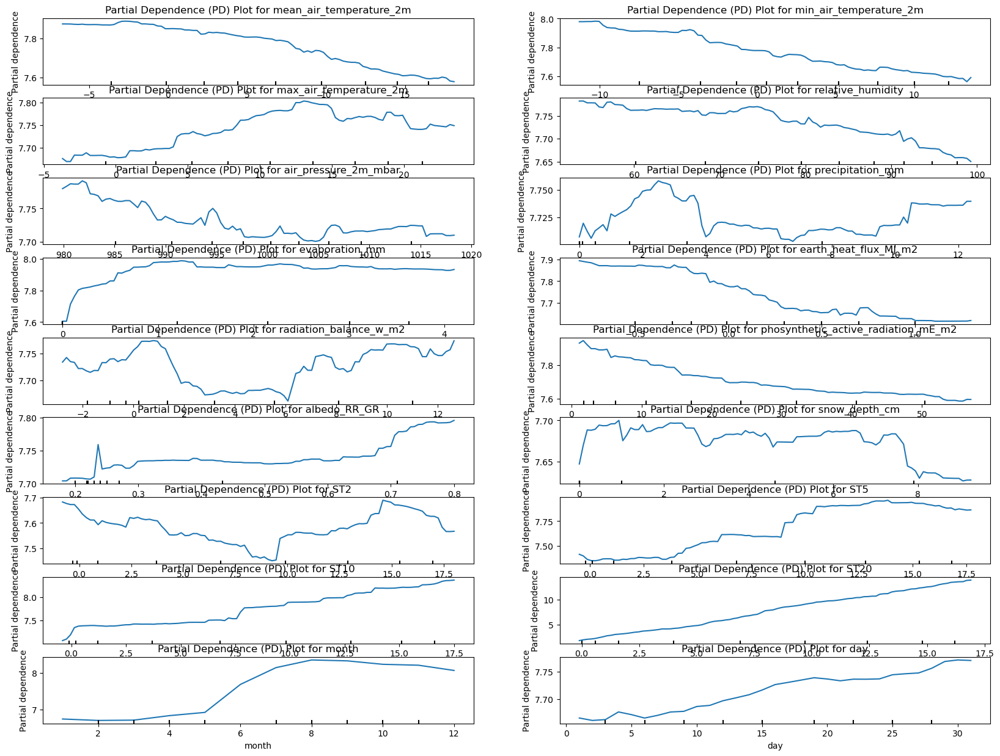

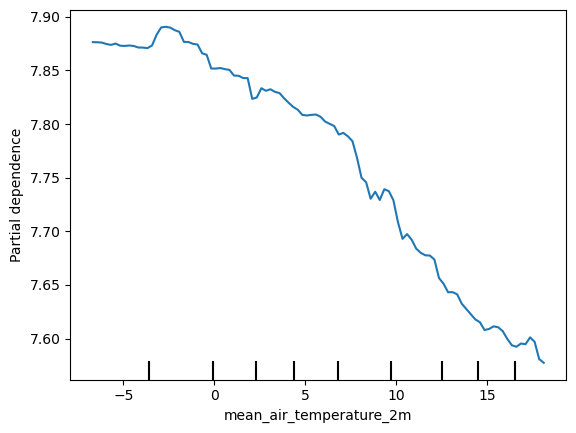

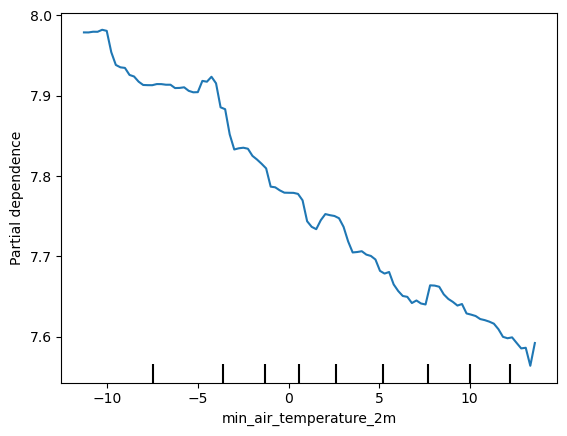

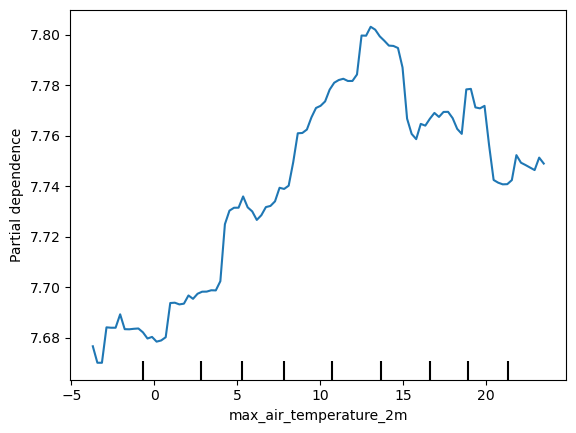

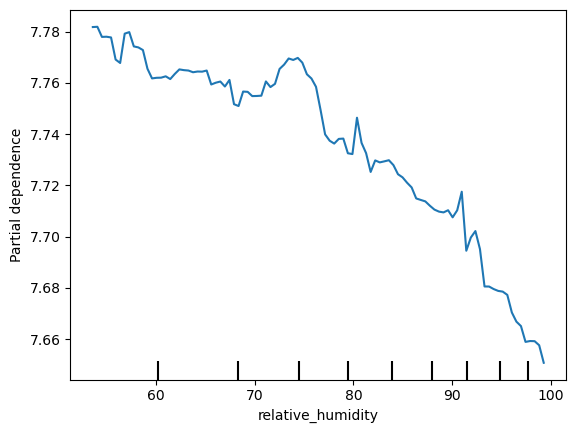

...

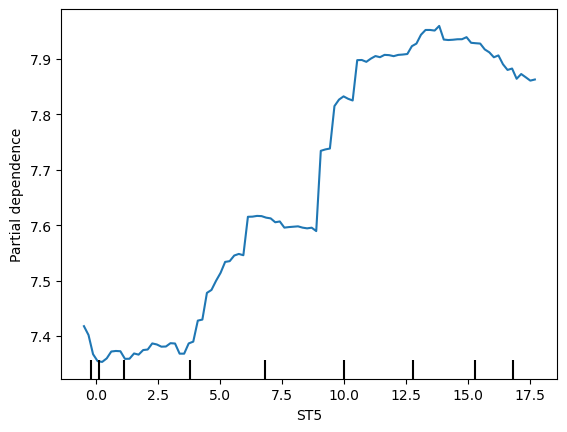

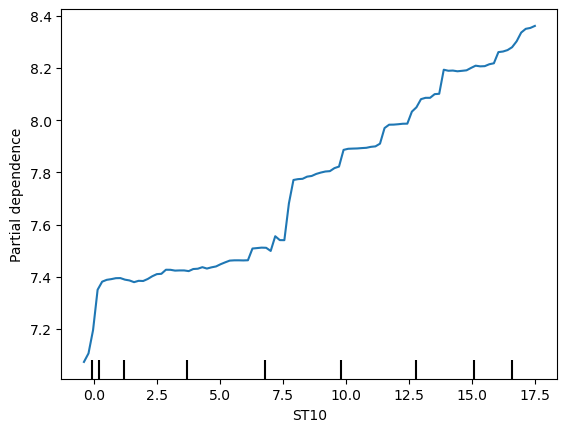

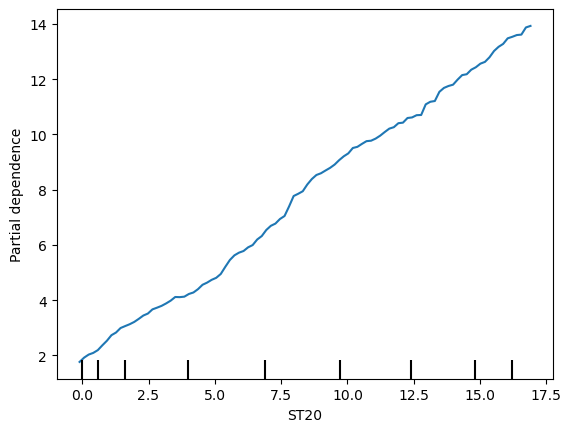

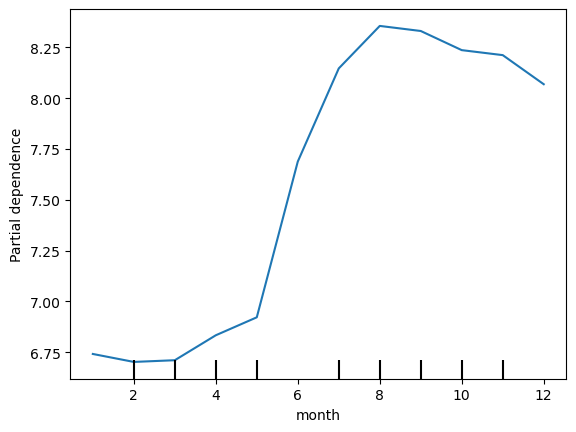

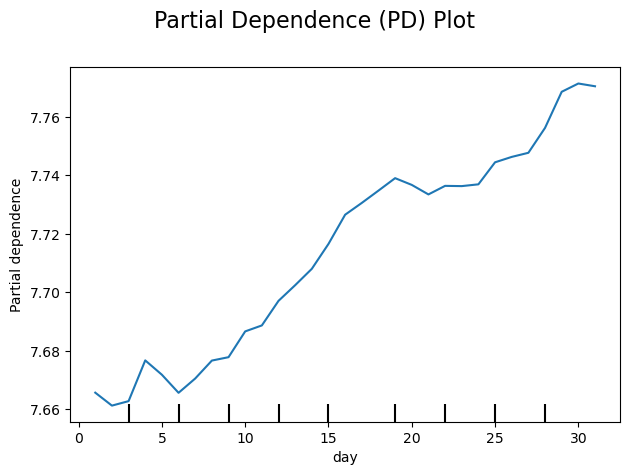

======================== ST50 Individual Conditional Expectation Plot  ===============================


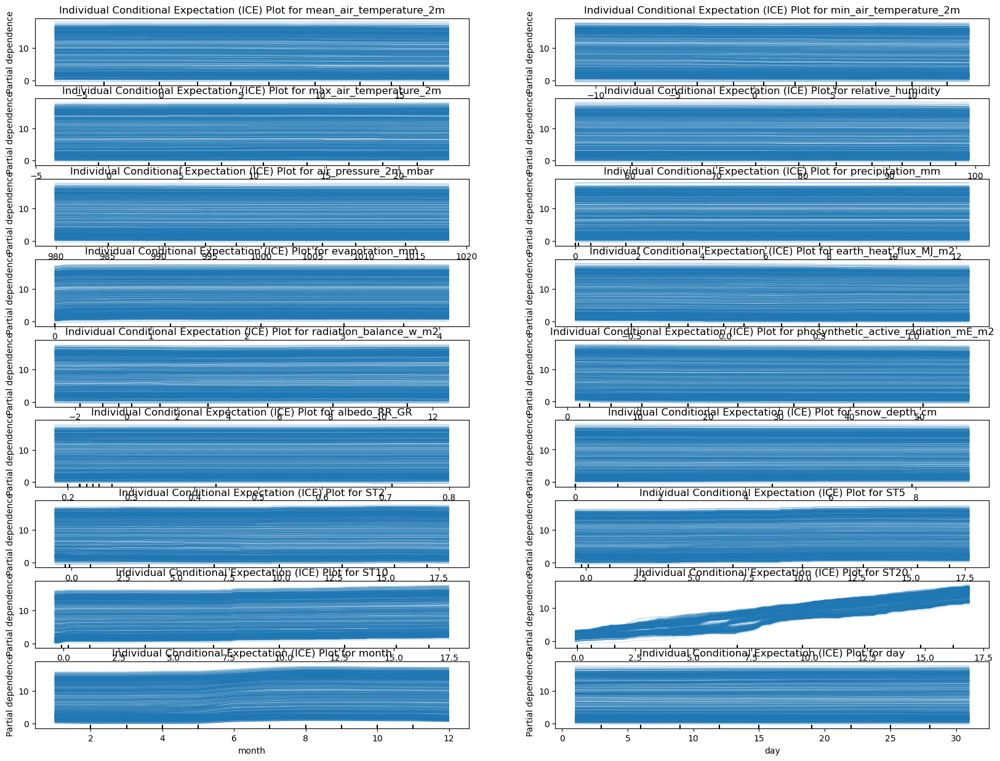

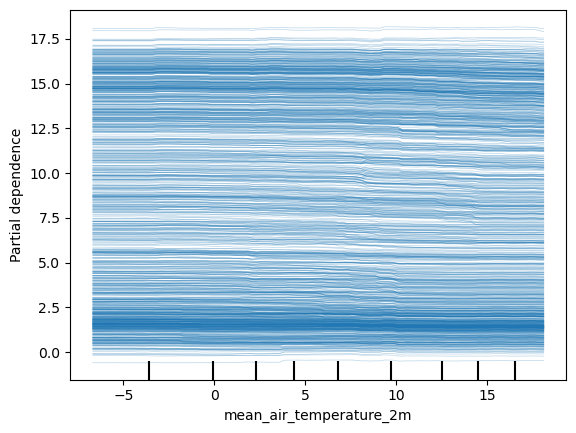

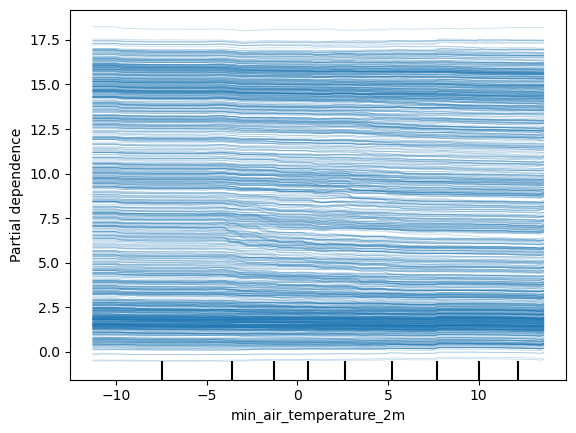

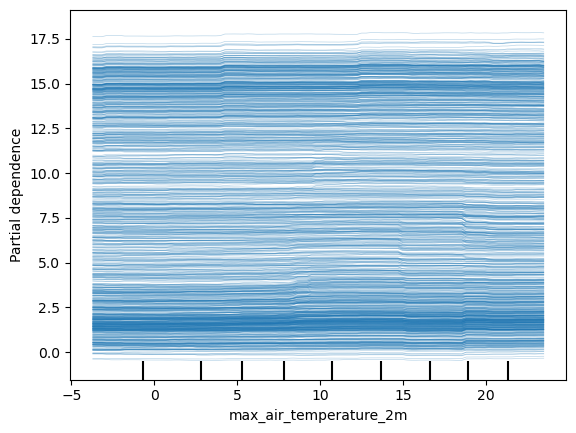

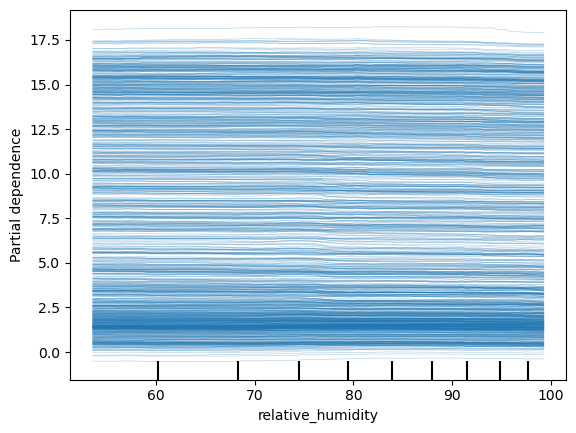

...

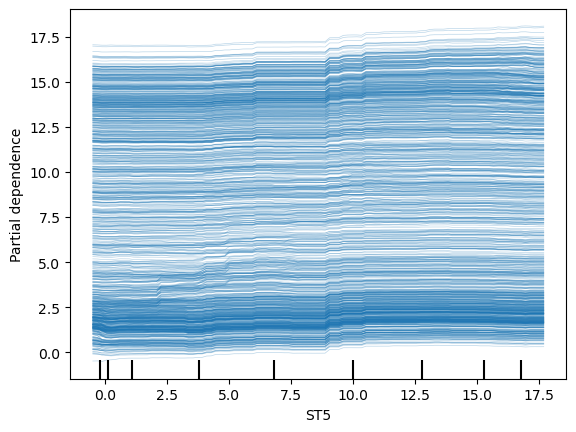

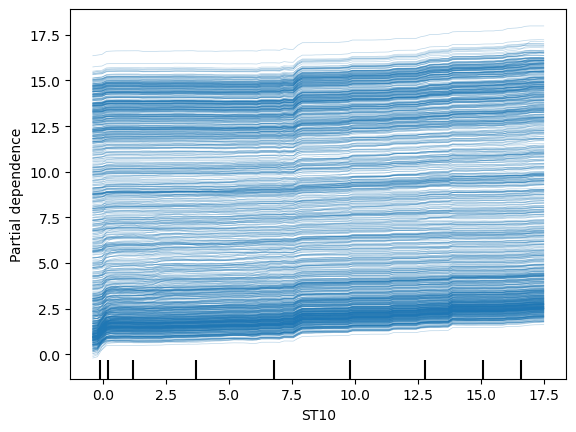

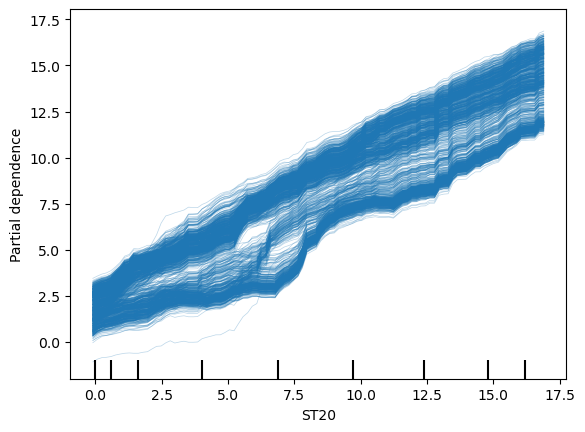

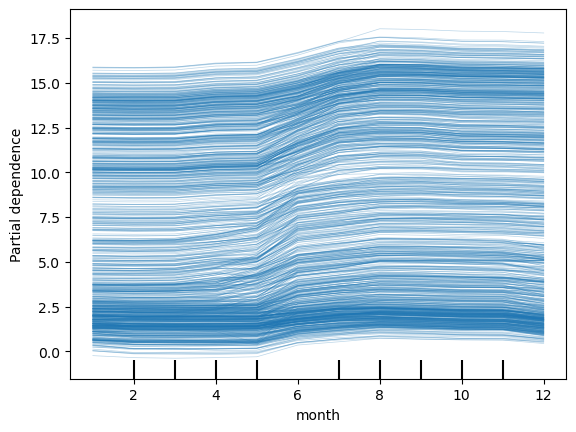

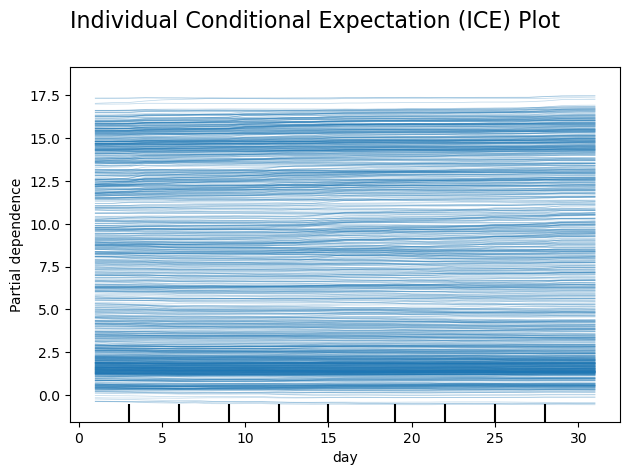

========================= ST50 Residual Analysis Plot ==============================


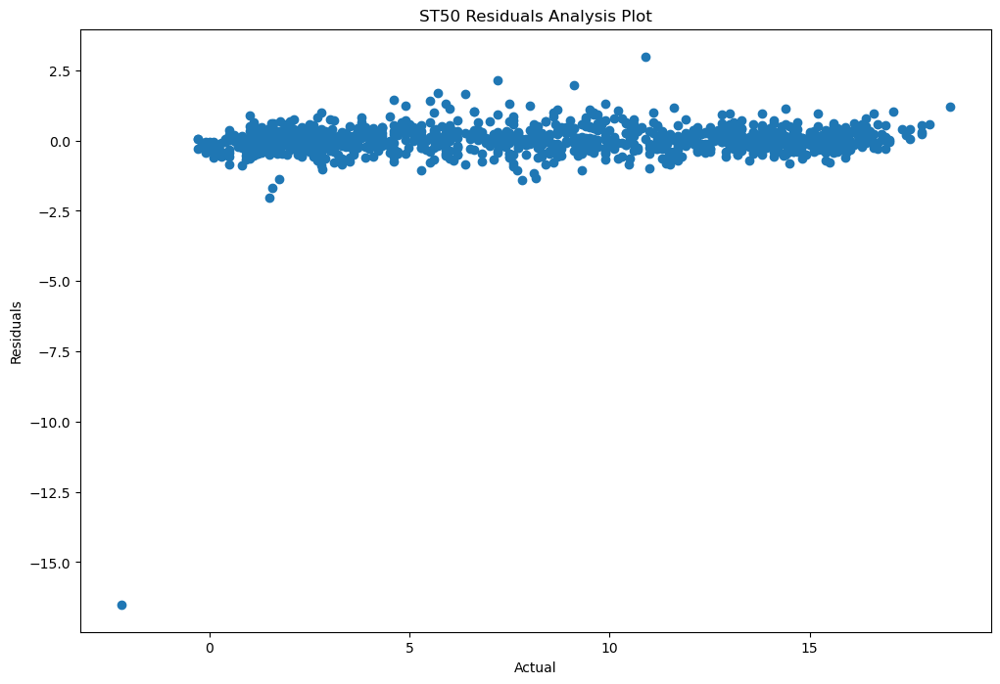

========================= ST50 Q-Q Plot ==============================


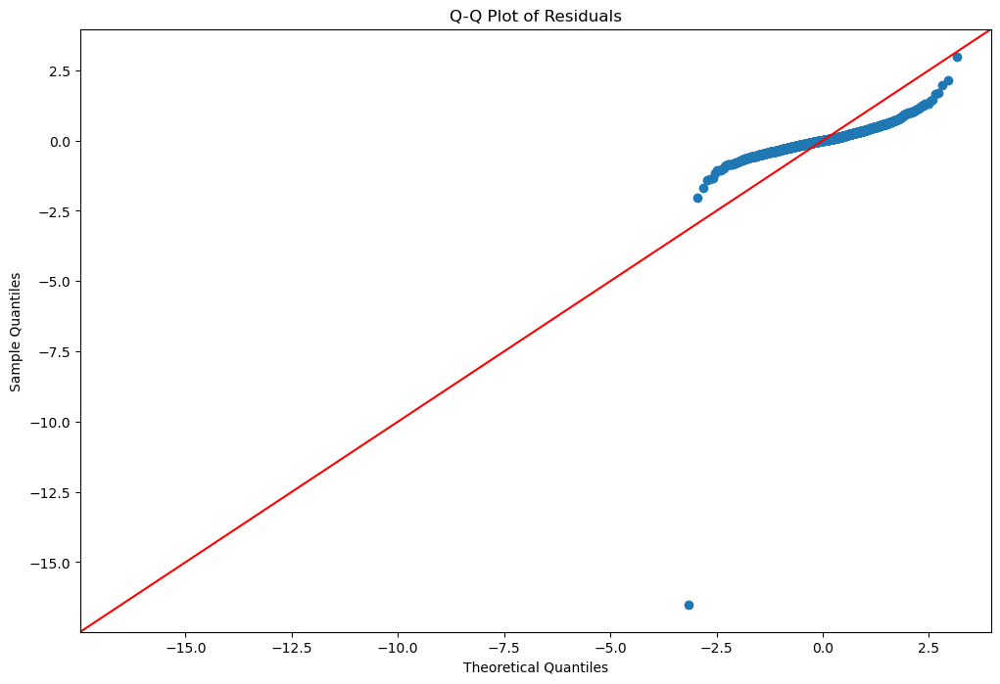

In [150]:
from sklearn.inspection import PartialDependenceDisplay
import statsmodels.api as sm
from pycebox.ice import ice, ice_plot
import matplotlib.pyplot as plt

# Partial Dependence Plot
print('====================================================== ST50 Partial Dependence Plot')
ST50_feature_names = ST50_X_train.columns.tolist()
n_features = len(ST50_feature_names)
n_cols = 2
n_rows = (n_features + n_cols - 1) // n_cols

fig1, ax1 = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 15))
axes_flat = ax1.flatten()

for idx, feature in enumerate(ST50_feature_names):
    display = PartialDependenceDisplay.from_estimator(ST50_stacking_regressor, ST50_X_train, features=[feature])
    display.plot(ax=axes_flat[idx])
    axes_flat[idx].set_title(f'Partial Dependence (PD) Plot for {feature}')
    axes_flat[idx].set_xlabel(feature)

for idx in range(n_features, len(axes_flat)):
    fig1.delaxes(axes_flat[idx])

plt.subplots_adjust(hspace=0.5)
plt.suptitle('Partial Dependence (PD) Plot', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.savefig('images/ST50_final_partial_dependence_plot.png')
plt.show()

# Individual Conditional Expectation Plot (ICE)
print('======================== ST50 Individual Conditional Expectation Plot ===============================')
fig2, axes2 = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 15))
axes_flat2 = axes2.flatten()

for idx, feature in enumerate(ST50_feature_names):
    display = PartialDependenceDisplay.from_estimator(ST50_stacking_regressor, ST50_X_train, features=[feature], kind='individual')
    display.plot(ax=axes_flat2[idx])
    axes_flat2[idx].set_title(f'Individual Conditional Expectation (ICE) Plot for {feature}')
    axes_flat2[idx].set_xlabel(feature)

for idx in range(n_features, len(axes_flat2)):
    fig2.delaxes(axes_flat2[idx])

plt.subplots_adjust(hspace=0.7)
plt.suptitle('Individual Conditional Expectation (ICE) Plot', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.savefig('images/ST50_final_individual_conditional_expectation_plot.png')
plt.show()

# Residual Analysis
print('========================= ST50 Residual Analysis Plot ==============================')
ST50_Y_predictions = ST50_stacking_regressor.predict(ST50_X_test)
ST50_residuals = ST50_Y_test - ST50_Y_predictions

fig3, ax3 = plt.subplots(figsize=(10, 7))
ax3.scatter(ST50_Y_predictions, ST50_residuals)
ax3.set_xlabel('Predictions')
ax3.set_ylabel('Residuals')
ax3.set_title('ST50 Residuals Analysis Plot')
plt.axhline(y=0, color='r', linestyle='--')
plt.savefig('images/ST50_final_residual_analysis_plot.png')
plt.show()

# Residuals vs. Predictor Variables
print('========================= Residuals vs. Predictor Variables ==============================')
for column in ST50_X_test.columns:
    fig, ax = plt.subplots(figsize=(10, 7))
    ax.scatter(ST50_X_test[column], ST50_residuals)
    ax.axhline(y=0, color='r', linestyle='--')
    ax.set_xlabel(column)
    ax.set_ylabel('Residuals')
    ax.set_title(f'Residuals vs. {column}')
    plt.savefig(f'images/ST50_final_residuals_vs_{column}.png')
    plt.show()

# Q-Q Plot
print('========================= ST50 Q-Q Plot ==============================')
fig5, ax5 = plt.subplots(figsize=(10, 7))
sm.qqplot(ST50_residuals, line='45', ax=ax5)
ax5.set_title('Q-Q Plot of Residuals')
plt.savefig('images/ST50_final_Q-Q_plot.png')
plt.show()

# Histogram of residuals
fig6, ax6 = plt.subplots(figsize=(10, 7))
plt.figure(figsize=(10, 6))
sns.histplot(residuals, kde=True, ax=ax6)
plt.xlabel('Residuals')
plt.title('Histogram of Residuals')
plt.show()


### Feature importance analysis for ST50

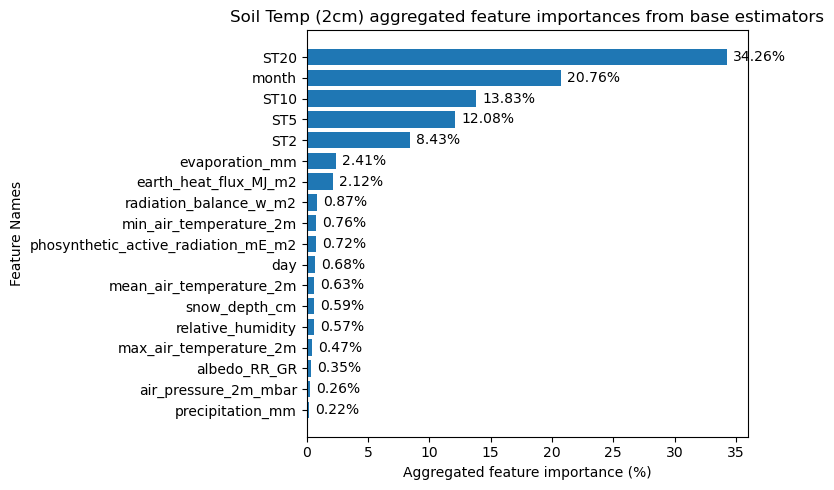

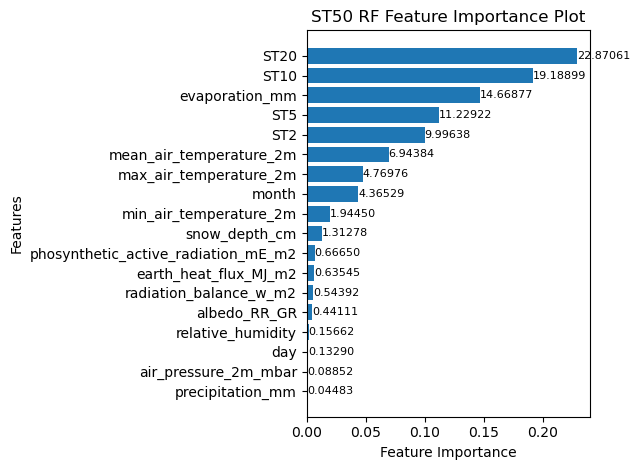

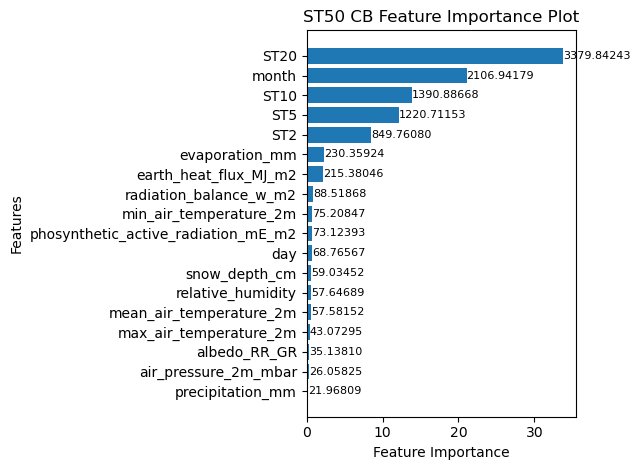

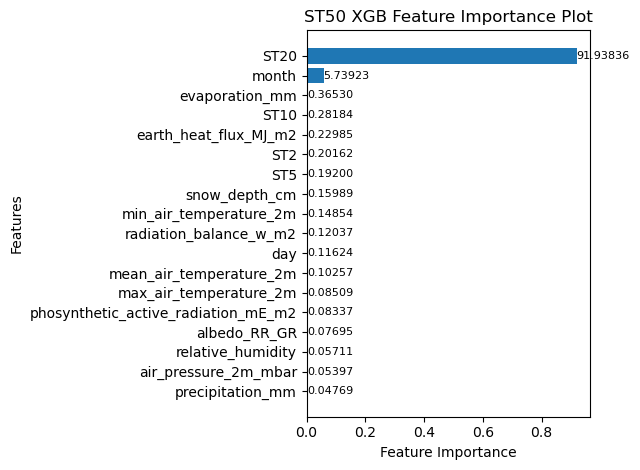

In [217]:
np.random.seed(42)
# Assuming feature_names is a list of your feature names
feature_names = ST50_X_train.columns.tolist()

estimators = [
    ("Random Forest", ST50_rf_model),
    ("Cat Boost", ST50_cb_model),
    ("XG Boost", ST50_xgb_model)
]

# Initialize an array to store aggregated feature importances
num_features = ST50_X_train.shape[1]
feature_importances = np.zeros(num_features, dtype=np.float64)

# Aggregate feature importances from base models
count = 0
for name, model in estimators:
    if hasattr(model, 'feature_importances_'):
        importances = np.array(model.feature_importances_, dtype=np.float64)
        feature_importances += importances
        count += 1
    else:
        print(f"{name} does not have feature_importances_ attribute")

# Normalize the aggregated feature importances
if count > 0:
    feature_importances /= count

# Convert feature importances to percentages
feature_importances_percentage = 100 * (feature_importances / feature_importances.sum())

# Sort the feature importances in descending order
sorted_indices = np.argsort(feature_importances_percentage)[::-1]
sorted_feature_importances_percentage = feature_importances_percentage[sorted_indices]
sorted_feature_names = [feature_names[i] for i in sorted_indices]

# Plot the sorted feature importances
plt.figure(figsize=(8, 5))
bars = plt.barh(sorted_feature_names, sorted_feature_importances_percentage)
plt.xlabel("Aggregated feature importance (%)")
plt.ylabel("Feature Names")
plt.title("Soil Temp (2cm) aggregated feature importances from base estimators")
plt.gca().invert_yaxis()  # Highest importance at the top

# Add annotations to the bars
for bar in bars:
    width = bar.get_width()
    plt.text(
        width + 0.5,  # Offset slightly to the right of the bar
        bar.get_y() + bar.get_height() / 2,  # Vertical center of the bar
        f'{width:.2f}%',  # Display the width (importance value) formatted to 2 decimal places
        va='center'
    )
# Save the figure
plt.tight_layout()
plt.savefig('data/results/ST50_stacking_regressors_feature_importances.png')
plt.show()

plot_features(ST50_X_train.columns, ST50_rf_model.feature_importances_, 'images/ST50_RF_feature_analysis.png', 'ST50 RF Feature Importance Plot')
plot_features(ST50_X_train.columns, ST50_cb_model.feature_importances_/100, 'images/ST50_CB_feature_analysis.png', 'ST50 CB Feature Importance Plot')
plot_features(ST50_X_train.columns, ST50_xgb_model.feature_importances_, 'images/ST50_XGB_feature_analysis.png', 'ST50 XGB Feature Importance Plot')

### GridSearhCV Evaluation for all models used in the stacked regressor for ST50

In [149]:
%%time
import time
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor, HistGradientBoostingRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.model_selection import cross_val_predict, cross_validate
from catboost import CatBoostRegressor



# Define parameter grids for each model
param_grid_cb = {
    'iterations': [100, 200, 500],
    'learning_rate': [0.01, 0.1, 0.05],
    'depth': [4, 6, 10],
    'l2_leaf_reg': [1, 3, 5, 7, 9],
    'border_count': [32, 50, 100]
}
param_grid_rf = {
    'n_estimators': [100, 300, 500],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

param_grid_hgb = {
    'learning_rate': [0.01, 0.1, 0.05],
    'max_iter': [100, 200, 500],
    'max_leaf_nodes': [31, 50, 100],
    'max_depth': [None, 10, 20],
    'min_samples_leaf': [20, 50, 100],
    'l2_regularization': [0, 0.1, 1]
}

param_grid_xgb = {
    'n_estimators': [100, 200, 500],
    'learning_rate': [0.01, 0.1, 0.05],
    'max_depth': [3, 5, 7],
    'subsample': [1.0, 0.8, 0.6],
    'colsample_bytree': [1.0, 0.8, 0.6],
    'gamma': [0, 1, 5],
    'reg_alpha': [0, 0.1, 1],
    'reg_lambda': [1, 0.1, 0.01],
    'tree_method': ['gpu_hist']  # Use GPU
}
param_grid_ada = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.05],
    'loss': ['linear', 'square', 'exponential']
}
# stacking_param_grid ={
#     'rf__n_estimators': [100, 300, 500],
#     'rf__max_depth': [None, 10, 20, 30],
#     'hgb__learning_rate': [0.01, 0.1, 0.05],
#     'hgb__max_iter': [100, 200, 500],
#     'catboost__iterations': [100, 200, 500],
#     'catboost__learning_rate': [0.01, 0.1, 0.05],
#     'catboost__depth': [4, 6, 10],
#     'xgb__n_estimators': [100, 200],
#     'xgb__max_depth': [3, 5]
# }


# Initialize models
cb = CatBoostRegressor(random_state=42)
rf = RandomForestRegressor(random_state=42)
hgb = HistGradientBoostingRegressor(random_state=42)
ada = AdaBoostRegressor(random_state=42)
xgb = XGBRegressor(random_state=42, objective='reg:squarederror')

# estimators = [
#     ('rf', RandomForestRegressor()),
#     ('cb', CatBoostRegressor()),
#     ('hgb', HistGradientBoostingRegressor()),    
#     ('xgb', XGBRegressor())
# ]

# stacking_regressor = StackingRegressor(
#     estimators=estimators,
#     final_estimator=RidgeCV()
# )

# Initialize GridSearchCV for RF model
start_time_rf = time.time()
ST50_grid_search_rf = GridSearchCV(estimator=rf, param_grid=param_grid_rf, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_rf_search = time.time()
ST50_grid_search_rf.fit(ST50_X_train, ST50_Y_train)
end_time_rf_fit = time.time()
elapsed_time_search_rf = end_time_rf_search - start_time_rf
elapsed_time_fit_rf = end_time_rf_fit - end_time_rf_search
# Get the best parameters and scores
print("Best parameters for RandomForestRegressor:", ST50_grid_search_rf.best_params_)
print("Best score for RandomForestRegressor:", -ST50_grid_search_rf.best_score_)
print("RandomForestRegressor GridSearchCV Time:", elapsed_time_search_rf)
print("RandomForestRegressor Fitting Time:", elapsed_time_fit_rf)

# Initialize GridSearchCV for HGB model
start_time_hgb = time.time()
ST50_grid_search_hgb = GridSearchCV(estimator=hgb, param_grid=param_grid_hgb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_hgb_search = time.time()
ST50_grid_search_hgb.fit(ST50_X_train, ST50_Y_train)
end_time_hgb_fit = time.time()
elapsed_time_search_hgb = end_time_hgb_search - start_time_hgb
elapsed_time_fit_hgb = end_time_hgb_fit - end_time_hgb_search
# Get the best parameters and scores
print("Best parameters for HistGradientBoostingRegressor:", ST50_grid_search_hgb.best_params_)
print("Best score for HistGradientBoostingRegressor:", -ST50_grid_search_hgb.best_score_)
print("HistGradientBoostingRegressor GridSearchCV Time:", elapsed_time_search_hgb)
print("HistGradientBoostingRegressor Fitting Time:", elapsed_time_fit_hgb)

# Initialize GridSearchCV for XGB model
start_time_xgb = time.time()
ST50_grid_search_xgb = GridSearchCV(estimator=xgb, param_grid=param_grid_xgb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_xgb_search = time.time()
ST50_grid_search_xgb.fit(ST50_X_train, ST50_Y_train)
end_time_xgb_fit = time.time()
elapsed_time_search_xgb = end_time_xgb_search - start_time_xgb
elapsed_time_fit_xgb = end_time_xgb_fit - end_time_xgb_search
# Get the best parameters and scores
print("Best parameters for XGBRegressor:", ST50_grid_search_xgb.best_params_)
print("Best score for XGBRegressor:", -ST50_grid_search_xgb.best_score_)
print("XGBRegressor GridSearchCV Time:", elapsed_time_search_xgb)
print("XGBRegressor Fitting Time:", elapsed_time_fit_xgb)

# Initialize GridSearchCV for ADA model
start_time_ada = time.time()
ST50_grid_search_ada = GridSearchCV(estimator=ada, param_grid=param_grid_ada, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_ada_search = time.time()
ST50_grid_search_ada.fit(ST50_X_train, ST50_Y_train)
end_time_ada_fit = time.time()
elapsed_time_search_ada = end_time_ada_search - start_time_ada
elapsed_time_fit_ada = end_time_ada_fit - end_time_ada_search
# Get the best parameters and scores
print("Best parameters for AdaBoostRegressor:", ST50_grid_search_ada.best_params_)
print("Best score for AdaBoostRegressor:", -ST50_grid_search_ada.best_score_)
print("AdaBoostRegressor GridSearchCV Time:", elapsed_time_search_ada)
print("AdaBoostRegressor Fitting Time:", elapsed_time_fit_ada)

# Initialize GridSearchCV for CB model
start_time_cb = time.time()
ST50_grid_search_cb = GridSearchCV(estimator=cb, param_grid=param_grid_cb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_cb_search = time.time()
ST50_grid_search_cb.fit(ST50_X_train, ST50_Y_train)
end_time_cb_fit = time.time()
elapsed_time_search_cb = end_time_cb_search - start_time_cb
elapsed_time_fit_cb = end_time_cb_fit - end_time_cb_search
# Get the best parameters and scores
print("Best parameters for CatBoostRegressor:", ST50_grid_search_cb.best_params_)
print("Best score for CatBoost:", -ST50_grid_search_cb.best_score_)
print("CatBoostRegressor GridSearchCV Time:", elapsed_time_search_cb)
print("CatBoostRegressor Fitting Time:", elapsed_time_fit_cb)

# # Initialize GridSearchCV for Stacking model
# start_time_stacking = time.time()
# ST50_grid_search_stacking = GridSearchCV(estimator=stacking_regressor, param_grid=stacking_param_grid, cv=5, n_jobs=-1, verbose=0,scoring='neg_mean_absolute_error')
# end_time_stacking_search = time.time()
# ST50_grid_search_stacking.fit(ST50_X_train, ST50_Y_train)
# end_time_stacking = time.time()
# elapsed_time_search_stacking = end_time_stacking_search - start_time_stacking
# elapsed_time_fit_stacking = end_time_stacking_fit - end_time_stacking_search

# print("Best parameters for StackingRegressor:", ST50_grid_search_stacking.best_params_)
# print("Best score for StackingRegressor:", -ST50_grid_search_stacking.best_score_)
# print("StackingRegressor GridSearchCV Time:", elapsed_time_search_stacking)
# print("StackingRegressor Fitting Time:", elapsed_time_fit_stacking)

# Define the results of print statements as variables
ST50_grid_search_and_fitting_results = {
    'Model': ['RandomForestRegressor', 'HistGradientBoostingRegressor', 'AdaBoostRegressor', 'XGBRegressor'],
    'Best Parameters': [ST50_grid_search_rf.best_params_, ST50_grid_search_hgb.best_params_, ST50_grid_search_ada.best_params_, ST50_grid_search_xgb.best_params_],
    'Best Score': [-ST50_grid_search_rf.best_score_, -ST50_grid_search_hgb.best_score_, -ST50_grid_search_ada.best_score_, -ST50_grid_search_xgb.best_score_],
    'GridSearchCV Time': [elapsed_time_search_rf, elapsed_time_search_hgb, elapsed_time_search_ada, elapsed_time_search_xgb],
    'Fitting Time': [elapsed_time_fit_rf, elapsed_time_fit_hgb, elapsed_time_fit_ada, elapsed_time_fit_xgb]
}

# Create a DataFrame
df_results = pd.DataFrame(ST50_grid_search_and_fitting_results)

# Export DataFrame to Excel
df_results.to_excel('data/ST50_grid_search_and_fitting_results.xlsx', index=False)

### F. Stacking Regressor for Soil temperature at 100cm

### Correlation analysis

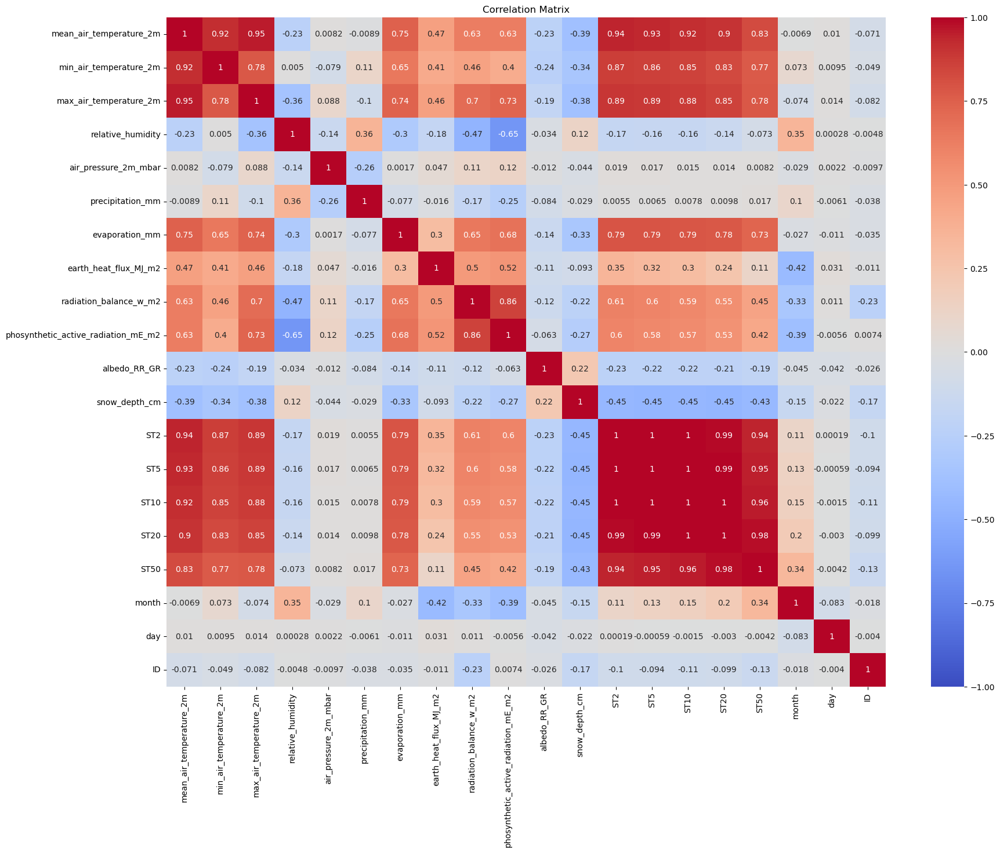

Highly correlated pairs (above threshold):
('mean_air_temperature_2m', 'max_air_temperature_2m')
('ST2', 'ST5')
('ST2', 'ST10')
('ST2', 'ST20')
('ST5', 'ST10')
('ST5', 'ST20')
('ST5', 'ST50')
('ST10', 'ST20')
('ST10', 'ST50')
('ST20', 'ST50')
Removed features: {'ST10', 'max_air_temperature_2m', 'ST50', 'ST5', 'ST20'}
Shape of the reduced dataset: (4917, 15)


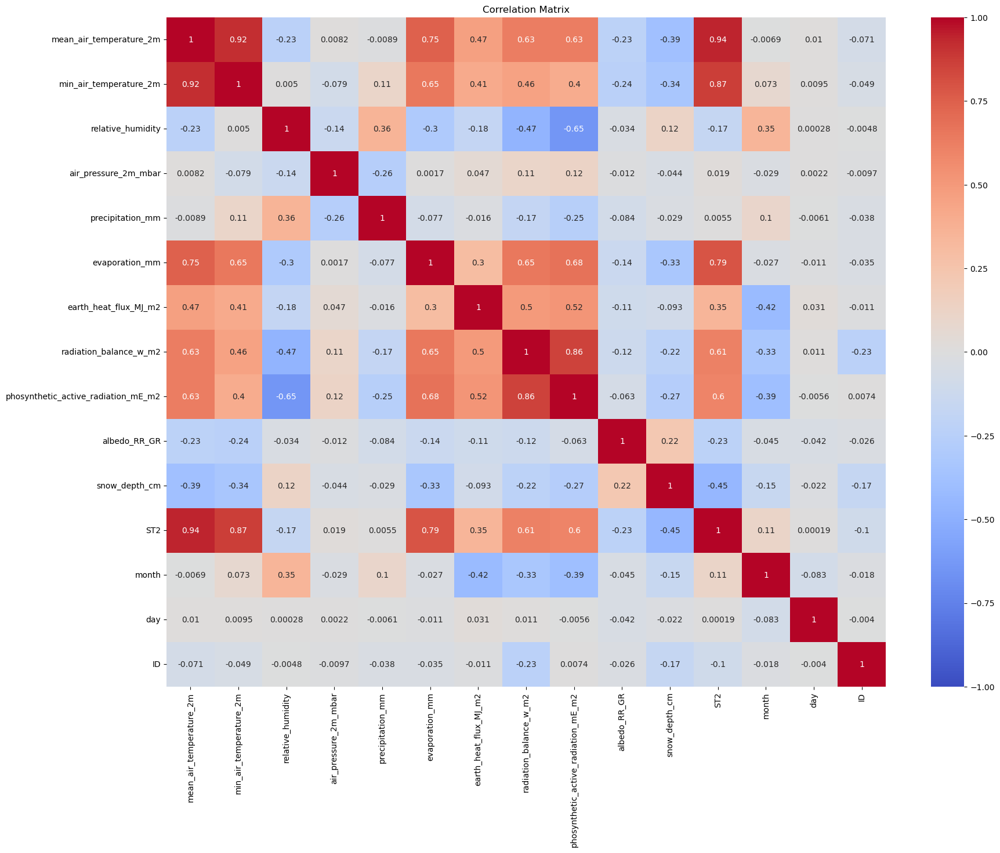

Removing feature 'const' with VIF: 11364.82993805704
Removing feature 'air_pressure_2m_mbar' with VIF: 158.05659939484258
Removing feature 'mean_air_temperature_2m' with VIF: 67.981817491232
Final VIF data:
                                feature        VIF
0                min_air_temperature_2m  10.360298
1                     relative_humidity  25.786547
2                      precipitation_mm   1.535929
3                        evaporation_mm   6.589078
4                 earth_heat_flux_MJ_m2   2.067554
5                radiation_balance_w_m2   7.002595
6   phosynthetic_active_radiation_mE_m2  15.456643
7                          albedo_RR_GR  14.709957
8                         snow_depth_cm   1.494114
9                                   ST2  33.153917
10                                month  13.128323
11                                  day   4.107878


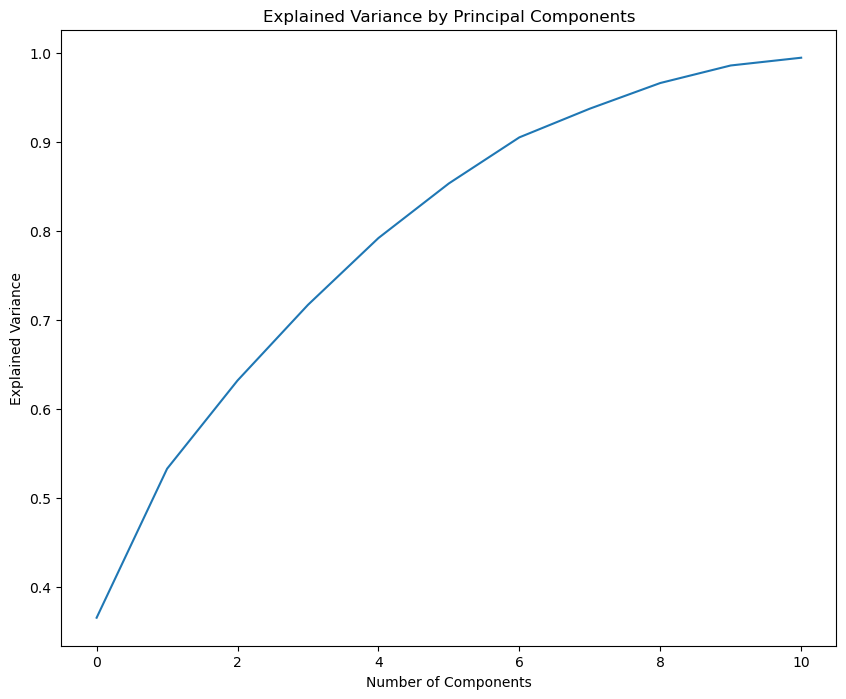

In [228]:
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Calculate the covariance matrix for target ST100
ST100_dataset_correlation = ST100_clean_dataset_denormalized.drop(['ST100'], axis=1)
ST100_covariance_matrix = ST100_dataset_correlation.cov()

# Calculate the correlation matrix
ST100_correlation_matrix = ST100_dataset_correlation.corr()

# Visualize the correlation matrix
plt.figure(figsize=(20, 15))
sns.heatmap(ST100_correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.savefig("images/ST100_denormalized_before_correlation_matrix.png")
plt.show()

# Set the threshold
threshold = 0.95
# Find pairs of features with correlation above the threshold
highly_correlated = np.where(np.abs(ST100_correlation_matrix) > threshold)
highly_correlated_pairs = [(ST100_correlation_matrix.index[x], ST100_correlation_matrix.columns[y]) 
                           for x, y in zip(*highly_correlated) if x != y and x < y]

print("Highly correlated pairs (above threshold):")
for pair in highly_correlated_pairs:
    print(pair)
# Example: Removing one feature from each highly correlated pair
features_to_remove = set()
for pair in highly_correlated_pairs:
    features_to_remove.add(pair[1])  # You can choose to remove pair[0] or pair[1]

# Drop the features from the dataframe
ST100_dataset_denormalized_outlier_filtered_uncorrelated = ST100_dataset_correlation.drop(columns=features_to_remove)

print(f"Removed features: {features_to_remove}")
print("Shape of the reduced dataset:", ST100_dataset_denormalized_outlier_filtered_uncorrelated.shape)

# After removing the correlated features
# Calculate the correlation matrix
ST100_correlation_matrix_new = ST100_dataset_denormalized_outlier_filtered_uncorrelated.corr()

# Visualize the correlation matrix
plt.figure(figsize=(20, 15))
sns.heatmap(ST100_correlation_matrix_new, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix')
plt.savefig("images/ST100_denormalized_after_correlation_matrix.png")
plt.show()

# Assuming dataset_denormalized_outlier_filtered is your DataFrame
ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = ST100_dataset_denormalized_outlier_filtered_uncorrelated.copy()

# Add a constant term for the intercept
ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = sm.add_constant(ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif)
ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop('ID', axis=1, inplace=True)

# Function to calculate VIF
def calculate_vif(data):
    vif_data = pd.DataFrame()
    vif_data["feature"] = data.columns
    vif_data["VIF"] = [variance_inflation_factor(data.values, i) for i in range(data.shape[1])]
    return vif_data

# Iteratively remove features with VIF above the threshold
def remove_high_vif_features(data, threshold=40.0):
    while True:
        vif_data = calculate_vif(data)
        max_vif = vif_data['VIF'].max()
        if max_vif > threshold:
            # Identify the feature with the highest VIF
            feature_to_remove = vif_data.sort_values('VIF', ascending=False)['feature'].iloc[0]
            print(f"Removing feature '{feature_to_remove}' with VIF: {max_vif}")
            data = data.drop(columns=[feature_to_remove])
        else:
            break
    return data, vif_data

# Remove high VIF features
ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif, ST100_final_vif_data = remove_high_vif_features(ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif)

print("Final VIF data:")
print(ST100_final_vif_data)
ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ID'] = ST100_clean_dataset_denormalized['ID']
ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ST100'] = ST100_clean_dataset_denormalized['ST100']
ST100_dataset_denormalized_outlier_filtered_uncorrelated['ID'] = ST100_clean_dataset_denormalized['ID']
ST100_dataset_denormalized_outlier_filtered_uncorrelated['ST100'] = ST100_clean_dataset_denormalized['ST100']
# Remove the constant term before creating the final DataFrame
if 'const' in ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.columns:
    ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif = ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop(columns=['const'])

# Store the 'ID' and 'ST100' columns with their corresponding index before PCA
ID_index_mapping = ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ID']
ST100_index_mapping = ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif['ST100']

# Assume X is your feature dataframe
ST100_X_pca = ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif.drop(['ST100', 'ID'], axis=1)

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(ST100_X_pca)

# Apply PCA
pca = PCA(n_components=0.99)  # Choose the number of components
principal_components = pca.fit_transform(X_scaled)

# Create a DataFrame with the principal components
ST100_pca_df = pd.DataFrame(data=principal_components, columns=[f"PC{i}" for i in range(principal_components.shape[1])])

# Merge PCA DataFrame with original DataFrame to maintain original index order
ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca = pd.merge(ID_index_mapping, ST100_index_mapping, left_index=True, right_index=True)
ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca = pd.merge(ST100_dataset_denormalized_outlier_filtered_uncorrelated_after_vif_after_pca, ST100_pca_df, left_index=True, right_index=True)

# Plot the explained variance
plt.figure(figsize=(10,8))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Explained Variance')
plt.title('Explained Variance by Principal Components')
plt.savefig('images/ST100_PCA_analysis.png')
plt.show()

### Option 1: Dataset used is after correlation analysis

====================CatBoost The Evaluation Metrics Results For ST100 Denormalized =======================

{'Validation Set R^2 Score': 0.9834239089845979, 'Validation Set MAE': 0.40229750065065895, 'Validation Set MSE': 0.2904794230339771, 'Validation Set Median Absolute Error': 0.3042677920114589, 'Validation Set Max Error': 3.6719580597418346, 'Validation Set Explained Variance Score': 0.9834588290328801}

====================Random Forest The Evaluation Metrics Results For ST100 Denormalized =======================

{'Validation Set R^2 Score': 0.9808417020873488, 'Validation Set MAE': 0.4273738560192477, 'Validation Set MSE': 0.33573001733696023, 'Validation Set Median Absolute Error': 0.3283623188405782, 'Validation Set Max Error': 3.838333333333331, 'Validation Set Explained Variance Score': 0.9808470408541008}

====================The Histogram-Based Gradient Boosting Evaluation Metrics Results For ST100 Denormalized =======================

{'Validation Set R^2 Score': 0.9826

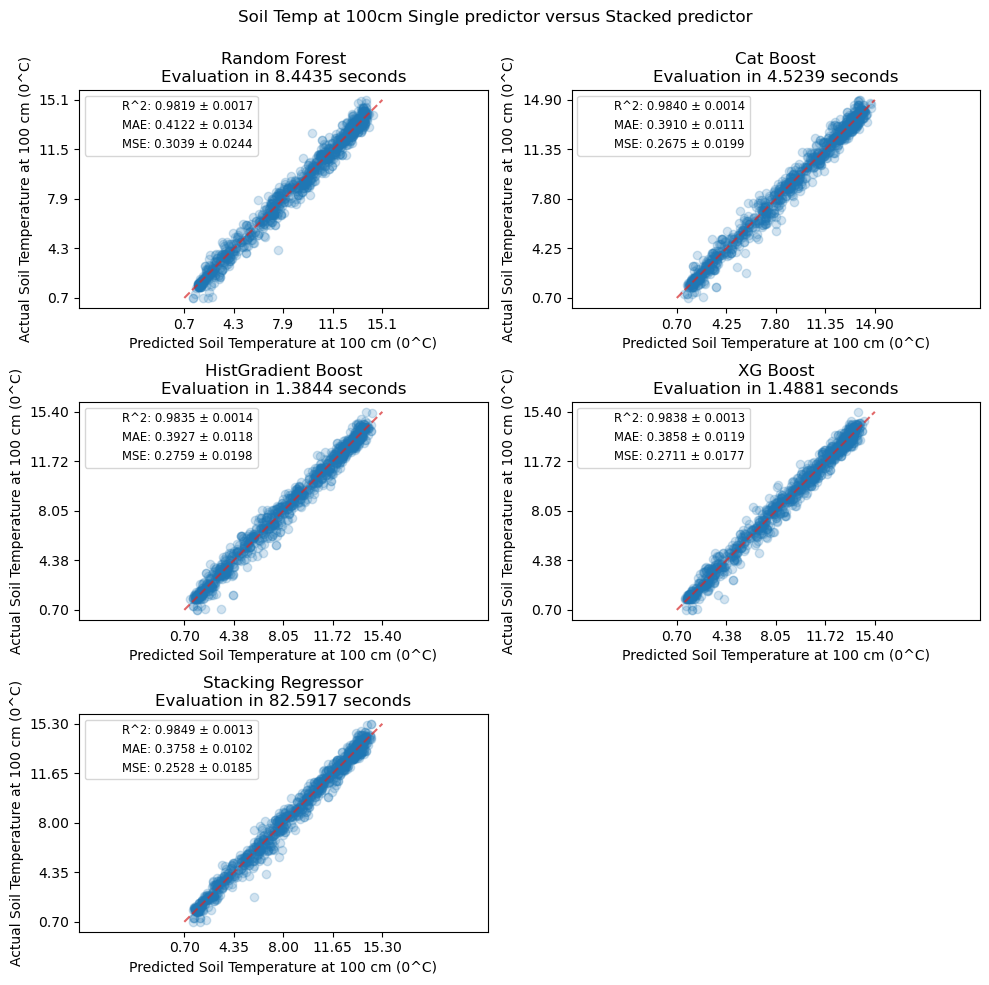

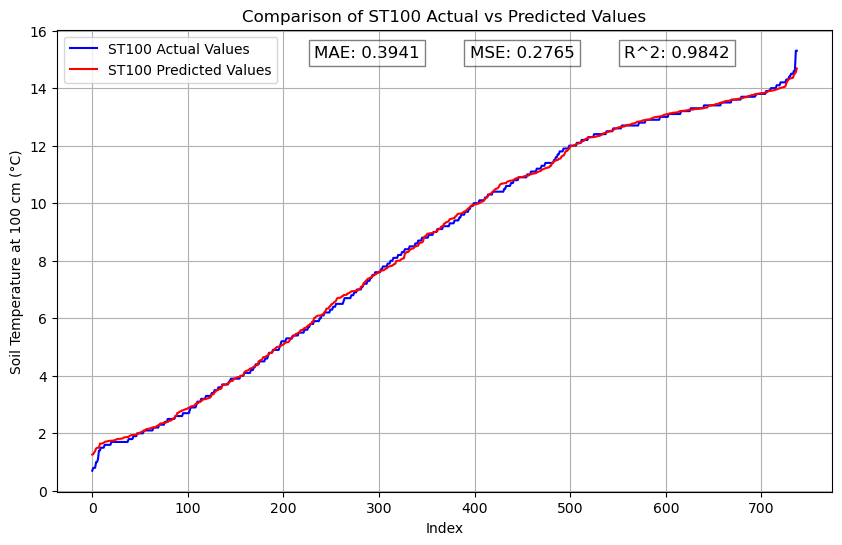

CPU times: total: 3min 3s
Wall time: 4min 5s


In [229]:
%%time
import numpy as np
from sklearn.linear_model import LassoCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.metrics import PredictionErrorDisplay
from sklearn.model_selection import cross_val_predict, cross_validate
import time

np.random.seed(42)
  
# Create function to evaluate model on few different levels
def show_scores(model, X_train, X_valid, Y_train, Y_valid, target='ST100', model_name='RF'):
    """
    Calculates and shows the different sklearn evaluation metrics
        
    Parameters:
        model: the model fitted.
        X_train: the input training set.
        X_valid: the input validation or test set.
        Y_train: the target training set.
        Y_valid: the target validation or test set.
            
    Returns:
        scores: the dictionary of the calculated sklearn metrics for train and valid sets.
    """
    
    train_preds = model.predict(X_train)
    val_preds = model.predict(X_valid)
    scores = {
              # "Training Set R^2 Score": r2_score(Y_train, train_preds),
              "Validation Set R^2 Score":r2_score(Y_valid, val_preds),
              # "Training Set MAE": mean_absolute_error(Y_train, train_preds),
              "Validation Set MAE": mean_absolute_error(Y_valid, val_preds),             
              # "Training Set MSE": mean_squared_error(Y_train, train_preds),
              "Validation Set MSE": mean_squared_error(Y_valid, val_preds),
              # "Training Set Median Absolute Error": median_absolute_error(Y_train, train_preds),
              "Validation Set Median Absolute Error": median_absolute_error(Y_valid, val_preds),
              # "Training Set MA Percentage Error": mean_absolute_percentage_error(Y_train, train_preds),
              # "Validation Set MA Percentage Error": mean_absolute_percentage_error(Y_valid, val_preds),
              # "Training Set Max Error": max_error(Y_train, train_preds),
              "Validation Set Max Error": max_error(Y_valid, val_preds),
              # "Training Set Explained Variance Score": explained_variance_score(Y_train, train_preds),
              "Validation Set Explained Variance Score": explained_variance_score(Y_valid, val_preds)}
    # Convert the dictionary to a DataFrame
    df = pd.DataFrame(list(scores.items()), columns=['Metric', 'Value'])    
    # Export the DataFrame to an Excel file
    df.to_excel(f'data/results/{target}_{model_name}_scores.xlsx', index=False)
    return scores

# Define a function that takes test set and validation sets as input and generates prediction curve and returns test set prediction data 
def predict_plot(model, ST_X_test, ST_X_validation, ST_Y_validation, name):
    # Predict the test set which is forecast data
    ST_Y_test_preds = model.predict(ST_X_test)
    # Changes the predicted array values to pandas series
    ST_Y_test_preds_series = pd.Series(ST_Y_test_preds, name=name) 
    # Convert the Series to a DataFrame
    ST_Y_test_preds_df = ST_Y_test_preds_series.to_frame()
    ST_Y_test_preds_df.index =  ST_X_test.index
    # Predict the validation set
    ST_Y_validation_preds = model.predict(ST_X_validation)
    # Change validation predictions to pandas series
    ST_Y_validation_preds_series = pd.Series(ST_Y_validation_preds)
    # Make the original and predicted series to have the same index
    ST_Y_validation_preds_series.index =ST_Y_validation.index
    # Sort Y_valid and Y_valid_preds in ascending order and reset indices
    ST_Y_validation_sorted = ST_Y_validation.sort_values().reset_index(drop=True)
    ST_Y_validation_preds_sorted = ST_Y_validation_preds_series[ST_Y_validation.index].sort_values().reset_index(drop=True)
  
    # Calculate mean absolute error
    ST_mae = mean_absolute_error(ST_Y_validation,ST_Y_validation_preds)
    # Calculate mean squared error
    ST_mse = mean_squared_error(ST_Y_validation,ST_Y_validation_preds)
    # Calculate the R^2 score
    ST_r2_score = r2_score(ST_Y_validation,ST_Y_validation_preds)
    # Plot the sorted values
    plt.figure(figsize=(10, 6))
    plt.plot(ST_Y_validation_sorted.index,ST_Y_validation_sorted, color='blue', label=f'{name} Actual Values')
    plt.plot(ST_Y_validation_preds_sorted.index,ST_Y_validation_preds_sorted, color='red', label=f'{name} Predicted Values')
    # Display the mean absolute error as text annotation
    plt.text(0.4, 0.95, f'MAE: {ST_mae:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.text(0.6, 0.95, f'MSE: {ST_mse:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.text(0.8, 0.95, f'R^2: {ST_r2_score:.4f}', ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.5))
    plt.xlabel('Index')
    plt.ylabel(f'Soil Temperature at 100 cm (°C)')
    plt.title(f'Comparison of {name} Actual vs Predicted Values')
    plt.legend()
    plt.grid(True)
    plt.savefig(f'data/results/{name}_predicted_vs_actual_values_line_plot.png')  # Save as PNG format
    plt.show()
    return ST_Y_test_preds_df
    
# Let us shuffle the entire dataset so that it is randomly arranged
dataset_shuffled = ST100_dataset_denormalized_outlier_filtered_uncorrelated.sample(frac=1)
# Split the dataset into features and target
many_features_dropped = ['earth_heat_flux_MJ_m2','radiation_balance_w_m2','phosynthetic_active_radiation_mE_m2','albedo_RR_GR','ST100','ID']
soil_features_dropped = ['ST100','ID']
uncorrelated_dropped = ['ST100','ID']
# ST100_X = dataset_shuffled.drop(many_features_dropped, axis=1)
ST100_X = dataset_shuffled.drop(uncorrelated_dropped, axis=1)
ST100_Y = dataset_shuffled['ST100']

# Split the dataset in to features (independent variables) and labels(dependent variable = target_soil_temperature_2cm ).
# Then split into train, validation and test sets
train_split = round(0.7*len(dataset_shuffled)) # 70% for train set
valid_split = round(train_split + 0.15*len(dataset_shuffled))
ST100_X_train, ST100_Y_train = ST100_X[:train_split], ST100_Y[:train_split]
ST100_X_valid, ST100_Y_valid =ST100_X[train_split:valid_split], ST100_Y[train_split:valid_split]
ST100_X_test, ST100_Y_test = ST100_X[valid_split:], ST100_Y[valid_split:]

# A. CatBoostRegressor (CB)
# Create CB model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST100_cb_model = CatBoostRegressor(iterations=500,
                                learning_rate=0.1,
                                depth=6,
                                l2_leaf_reg=3,
                                loss_function='RMSE',
                                silent=True,
                                random_state=42)
# Fit the model for ST100 to start with
ST100_cb_model.fit(ST100_X_train, ST100_Y_train, eval_set=(ST100_X_valid, ST100_Y_valid), early_stopping_rounds=100)
# Show the scoring metrics for this model
print("====================CatBoost The Evaluation Metrics Results For ST100 Denormalized =======================\n")

print(show_scores(ST100_cb_model, ST100_X_train, ST100_X_valid, ST100_Y_train, ST100_Y_valid, 'ST100', 'CB'))
print("==================================================================================================\n")

# B. RandomForestRegressor
# Create RF model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST100_rf_model = RandomForestRegressor(n_estimators=300, 
                                     min_samples_leaf=1,
                                     min_samples_split=2,
                                     max_features='sqrt',
                                     max_depth=None,
                                     bootstrap=False,
                                     random_state=42)
# Fit the model for ST100 to start with
ST100_rf_model.fit(ST100_X_train, ST100_Y_train)
# Show the scoring metrics for this model
print("====================Random Forest The Evaluation Metrics Results For ST100 Denormalized =======================\n")

print(show_scores(ST100_rf_model, ST100_X_train, ST100_X_valid, ST100_Y_train, ST100_Y_valid,'ST100', 'RF'))
print("==================================================================================================\n")

# C. Histogram Based Gradient Boosting Regressor
# Setup random seed
np.random.seed(42)
# Create Ridge model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST100_gbr_model = HistGradientBoostingRegressor(learning_rate=0.1, 
                                              max_iter=300, 
                                              max_leaf_nodes=41,
                                              random_state=42)
# Fit the ST100 model for soil temp at 100 cm
ST100_gbr_model.fit(ST100_X_train, ST100_Y_train)
# Show the scoring metrics for this model
print("====================The Histogram-Based Gradient Boosting Evaluation Metrics Results For ST100 Denormalized =======================\n")
print(show_scores(ST100_gbr_model, ST100_X_train, ST100_X_valid, ST100_Y_train, ST100_Y_valid,'ST100', 'HGB'))
print("====================================================================================================\n")

# D. XGBoost Regressor
# Setup random seed
np.random.seed(42)
# Create XGBoost for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST100_xgb_model = XGBRegressor(objective='reg:squarederror',
                             learning_rate=0.1, 
                             max_depth=6, 
                             n_estimators=200, 
                             subsample=0.8, 
                             random_state=42)
# Fit the ST100 model for soil temp at 100 cm
ST100_xgb_model.fit(ST100_X_train, ST100_Y_train)
# Show the scoring metrics for this model
print("====================The XGBoost Evaluation Metrics Results For ST100 Denormalized =======================\n")
print(show_scores(ST100_xgb_model, ST100_X_train, ST100_X_valid, ST100_Y_train, ST100_Y_valid,'ST100', 'XGB'))
print("====================================================================================================\n")


# E. AdaBoostRegressor 
# Setup random seed
np.random.seed(42)
# Create AdaBoost Regressor for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST100_adb_model = AdaBoostRegressor(learning_rate=0.1, 
                                  n_estimators=100,
                                  random_state=42)
# Fit the ST100 model for soil temp at 100 cm
ST100_adb_model.fit(ST100_X_train, ST100_Y_train)
# Show the scoring metrics for this model
print("====================The AdaBoost Regressor Evaluation Metrics Results For ST100 Denormalized =======================\n")
print(show_scores(ST100_adb_model, ST100_X_train, ST100_X_valid, ST100_Y_train, ST100_Y_valid,'ST100', 'ADB'))
print("====================================================================================================\n")


# F. Ridge Regressor
# Setup random seed
np.random.seed(42)
# Create Ridge model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST100_rg_model = Ridge(random_state=42)
# Fit the ST100 model for soil temp at 100 cm
ST100_rg_model.fit(ST100_X_train, ST100_Y_train)
# Show the scoring metrics for this model
print("====================The Ridge Regressor Evaluation Metrics Results For ST100 Denormalized =======================\n")
print(show_scores(ST100_rg_model, ST100_X_train, ST100_X_valid, ST100_Y_train, ST100_Y_valid,'ST100', 'RR'))
print("====================================================================================================\n")


# G. Lasso Regressor
# Set up a radom seed
np.random.seed(42)
# Create Lasso model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST100_la_model = Lasso(random_state=42)
# Fit the ST100 model for soil temp at 100cm
ST100_la_model.fit(ST100_X_train, ST100_Y_train)
# Show the scoring metrics for this model
print("====================The Lasso Regressor Evaluation Metrics Results For ST100 Denormalized =======================\n")
print(show_scores(ST100_la_model, ST100_X_train, ST100_X_valid, ST100_Y_train, ST100_Y_valid,'ST100', 'LA'))
print("====================================================================================================\n")

# H. ElasticNet Regressor
# Set up a radom seed
np.random.seed(42)
# Create ElasticNet model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST100_en_model = ElasticNet(random_state=42)
# Fit the ST100 model for soil temp at 100cm
ST100_en_model.fit(ST100_X_train, ST100_Y_train)
# Show the scoring metrics for this model
print("====================The ElasticNet Regressor Evaluation Metrics Results For ST100 Denormalized =======================\n")
print(show_scores(ST100_en_model, ST100_X_train, ST100_X_valid, ST100_Y_train, ST100_Y_valid,'ST100', 'EN'))
print("=========================================================================================================\n")

# I. SVR-L Regressor
# Set up a radom seed
np.random.seed(42)
# Create SVR-L model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST100_svrl_model = SVR(kernel='linear')
# Fit the ST100 model for soil temp at 100cm
ST100_svrl_model.fit(ST100_X_train, ST100_Y_train)
# Show the scoring metrics for this model
print("====================The SVR with linear model Evaluation Metrics Results For ST100 Denormalized =======================\n")
print(show_scores(ST100_svrl_model, ST100_X_train, ST100_X_valid, ST100_Y_train, ST100_Y_valid,'ST100', 'SVR-L'))
print("==========================================================================================================\n")

# J. SVR-R Regressor
# Set up a radom seed
np.random.seed(42)
# Create SVR-R model for all possible target variables (soil temperature at 2cm, 5cm, 10cm, 20cm, 50cm, 100cm) to be used later
ST100_svrr_model = SVR(kernel='rbf')
# Fit the ST100 model for soil temp at 100cm
ST100_svrr_model.fit(ST100_X_train, ST100_Y_train)
# Show the scoring metrics for this model
print("====================The SVR with rfb model Evaluation Metrics Results For ST100 Denormalized =======================\n")
print(show_scores(ST100_svrr_model, ST100_X_train, ST100_X_valid, ST100_Y_train, ST100_Y_valid,'ST100', 'SVR-R'))
print("=======================================================================================================\n")


# Stack of predictors on a single data set
rf_regressor = RandomForestRegressor(n_estimators=300, 
                                     min_samples_leaf=1,
                                     min_samples_split=2,
                                     max_features='sqrt',
                                     max_depth=None,
                                     bootstrap=False,
                                     random_state=42)
gbdt_regresssor = HistGradientBoostingRegressor(learning_rate=0.1, 
                                              max_iter=300, 
                                              max_leaf_nodes=41,
                                              random_state=42)
xgb_model = XGBRegressor(objective='reg:squarederror',
                             learning_rate=0.1, 
                             max_depth=6, 
                             n_estimators=200, 
                             subsample=0.8, 
                             random_state=42)
cb_regressor = CatBoostRegressor(iterations=500,
                                learning_rate=0.1,
                                depth=6,
                                l2_leaf_reg=3,
                                loss_function='RMSE',
                                silent=True,
                                random_state=42)
adb_regressor = AdaBoostRegressor(learning_rate=0.1, 
                                  n_estimators=100,
                                  random_state=42)

estimators = [
    ("Random Forest", rf_regressor),
    ("Cat Boost", cb_regressor),
    ("HistGradient Boost", gbdt_regresssor),
    ("XG Boost", xgb_model)
]
ST100_stacking_regressor = StackingRegressor(estimators=estimators, final_estimator=RidgeCV())

# Measure and plot the results
fig, axs = plt.subplots(3, 2, figsize=(10, 10))
axs = np.ravel(axs)

for ax, (name, est) in zip(axs, estimators + [("Stacking Regressor", ST100_stacking_regressor)]):
    scorers = {"R^2": "r2", "MAE": "neg_mean_absolute_error", "MSE":"neg_mean_squared_error"}

    start_time = time.time()
    scores = cross_validate(est, ST100_X, ST100_Y, scoring=list(scorers.values()), n_jobs=-1, verbose=0)
    elapsed_time = time.time() - start_time

    y_pred = cross_val_predict(est, ST100_X, ST100_Y, n_jobs=-1, verbose=0)
    scores = {
        key: (
            f"{np.abs(np.mean(scores[f'test_{value}'])):.4f} ± "
            f"{np.std(scores[f'test_{value}']):.4f}"
        )
        for key, value in scorers.items()
    }

    display = PredictionErrorDisplay.from_predictions(
        y_true=ST100_Y,
        y_pred=y_pred,
        kind="actual_vs_predicted",
        ax=ax,
        scatter_kwargs={"alpha": 0.2, "color": "tab:blue"},
        line_kwargs={"color": "tab:red"},
    )
    ax.set_title(f"{name}\nEvaluation in {elapsed_time:.4f} seconds")
    # Set custom x-label and y-label
    ax.set_xlabel("Predicted Soil Temperature at 100 cm (0^C)")
    ax.set_ylabel("Actual Soil Temperature at 100 cm (0^C)")
    for name, score in scores.items():
        ax.plot([], [], " ", label=f"{name}: {score}")
    ax.legend(loc="best", fontsize='small')
# Hide any unused subplots
for i in range(len(estimators)+1, len(axs)):
    fig.delaxes(axs[i])
plt.suptitle("Soil Temp at 100cm Single predictor versus Stacked predictor")
plt.tight_layout()
plt.subplots_adjust(top=0.9)
plt.savefig('data/results/ST100_stacking_regressors_predicted_actual_values.png')  # Save as PNG format
plt.show()

# Call the validation sets prediction function to plot the actual and predicted values and get the test predicted values
ST100_stacking_regressor.fit(ST100_X_train, ST100_Y_train)
ST100_Y_test_preds_df = predict_plot(ST100_stacking_regressor, ST100_X_test, ST100_X_valid, ST100_Y_valid, 'ST100')

### Cross-validation to check stability of the stacking regressor for ST100

In [230]:
import numpy as np
from sklearn.model_selection import cross_val_score, KFold
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error


# Perform k-fold cross-validation
kf = KFold(n_splits=10, shuffle=True, random_state=42)
ST100_cv_scores = cross_val_score(ST100_stacking_regressor, ST100_X_train, ST100_Y_train, cv=kf, scoring='neg_mean_squared_error')

# Convert scores to positive
ST100_cv_scores = -ST100_cv_scores

# Print cross-validation scores
print("Cross-Validation Scores (MSE):", ST100_cv_scores)
print("Mean CV Score (MSE):", np.mean(ST100_cv_scores))
print("Standard Deviation of CV Scores:", np.std(ST100_cv_scores))
# Save the scores to an Excel file
ST100_cv_scores_df = pd.DataFrame(ST100_cv_scores, columns=['MSE'])
ST100_cv_scores_df.to_excel('data/ST100_cv_scores.xlsx', index=False)

##=========== Visualize the problematic Fold using histogram==================
# Calculate mean MSE
ST100_mean_mse = np.mean(ST100_cv_scores)
# Identify the problematic fold
ST100_problematic_fold_index = np.argmax(np.abs(ST100_cv_scores - ST100_mean_mse))
# Get the indices of the data points in the problematic fold
for fold_index, (train_index, test_index) in enumerate(kf.split(ST100_X_train)):
    if fold_index == ST100_problematic_fold_index:
        problematic_fold_train_indices = train_index
        problematic_fold_test_indices = test_index

# Subset the data for the problematic fold
X_problematic_fold = ST100_X_train.iloc[problematic_fold_test_indices]
y_problematic_fold = ST100_Y_train.iloc[problematic_fold_test_indices]
# Visualize or analyze features for the problematic fold
for feature in ST100_X_train.columns:
    plt.figure(figsize=(12, 6))
    # Histogram for the problematic fold
    plt.subplot(1, 2, 1)
    sns.histplot(X_problematic_fold[feature], kde=True, bins=20, color='red')
    plt.title(f'{feature} - Problematic Fold')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    # Histogram for the entire dataset
    plt.subplot(1, 2, 2)
    sns.histplot(ST100_X_train[feature], kde=True, bins=20, color='blue')
    plt.title(f'{feature} - Entire Dataset')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.tight_layout()
    plt.savefig('images/ST100_CV_problematic_fold_vs_main_dataset_histograms.png')
    plt.show()

Cross-Validation Scores (MSE): [0.28223095 0.2455185  0.29794143 0.27684249 0.25930335 0.26164711
 0.29165275 0.24962836 0.27302489 0.25795739]
Mean CV Score (MSE): 0.2695747210991489
Standard Deviation of CV Scores: 0.016723885757677075


### Partial Dependence, Individual Conditional Expectation and Residual Analysis Plots for ST100

====================================================== ST100 Partial Dependence Plot


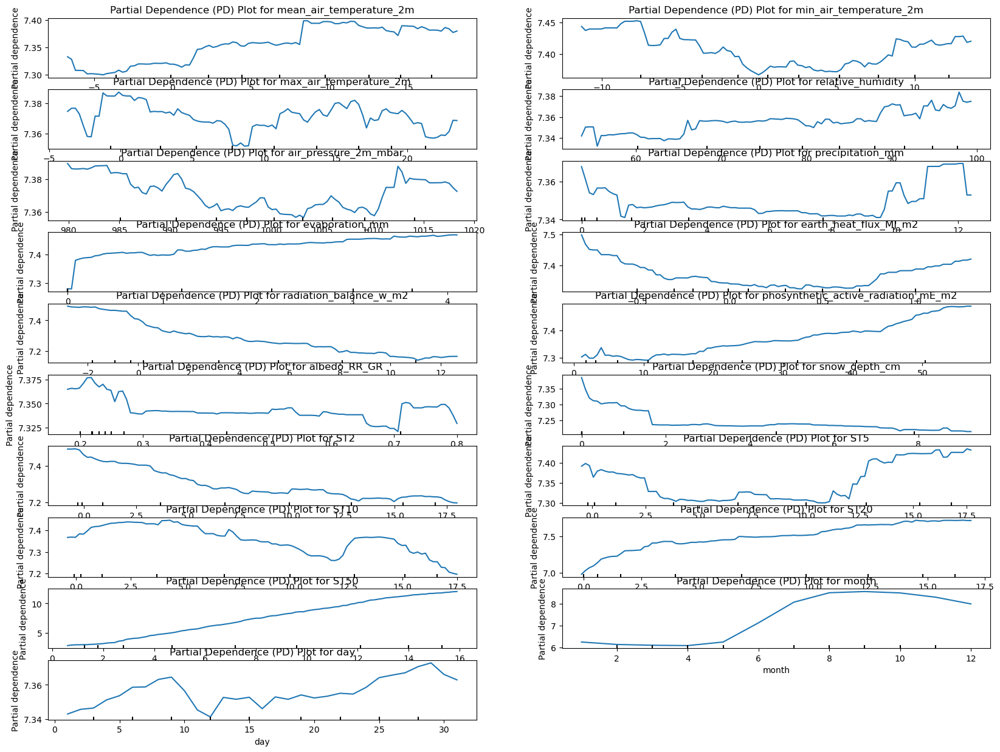

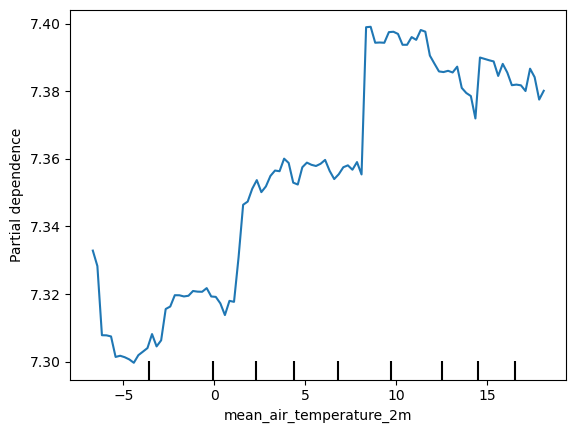

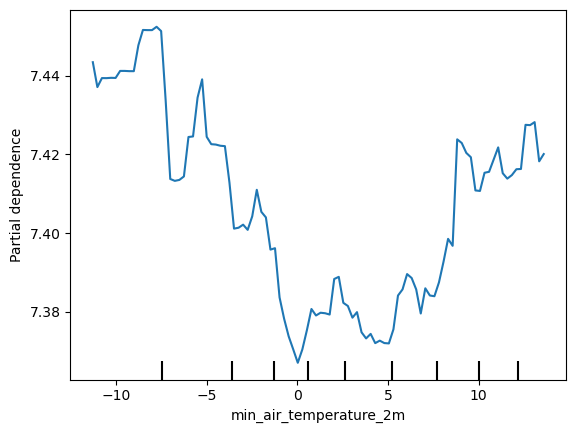

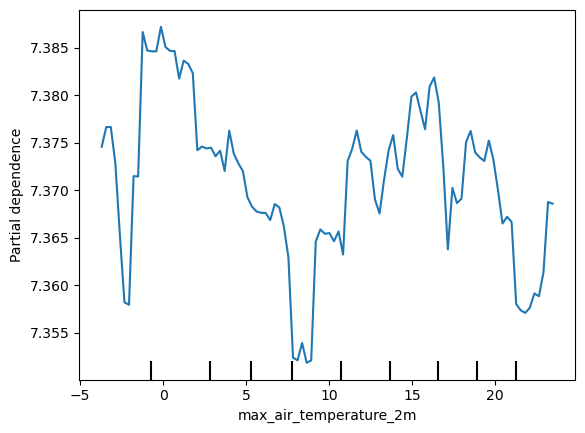

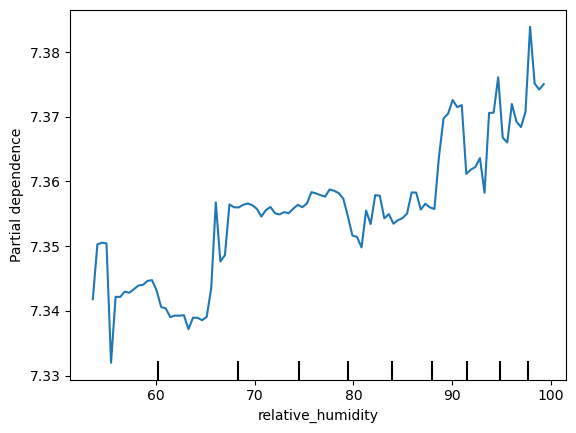

...

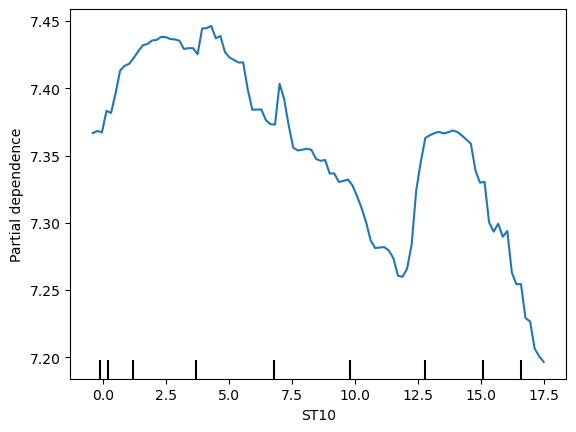

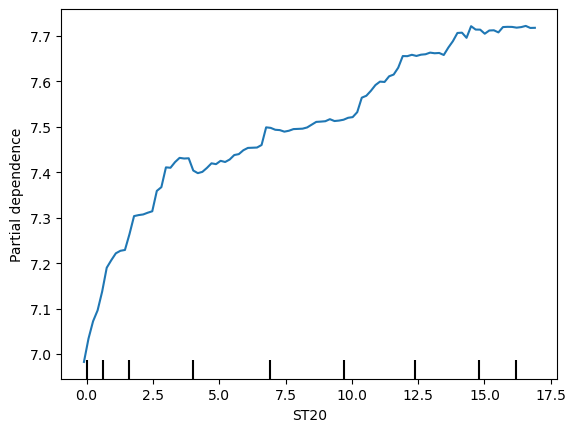

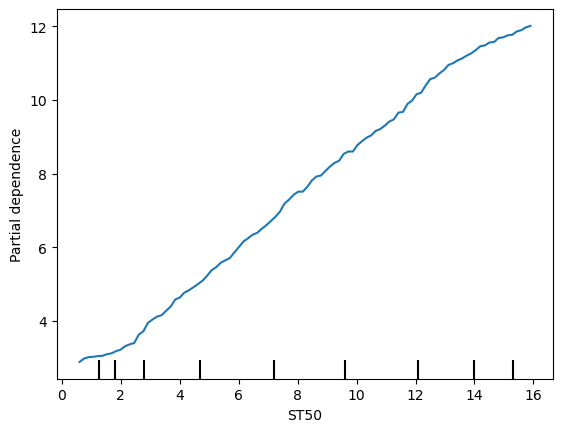

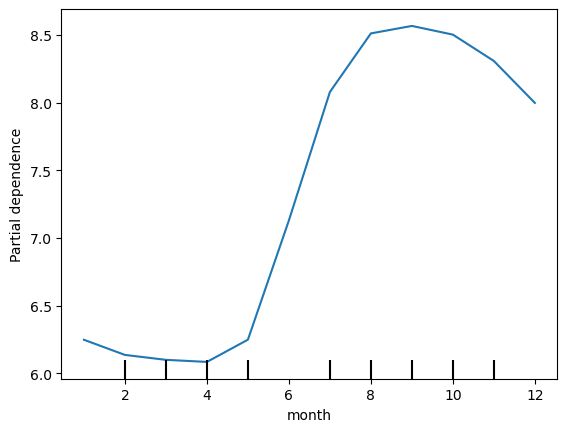

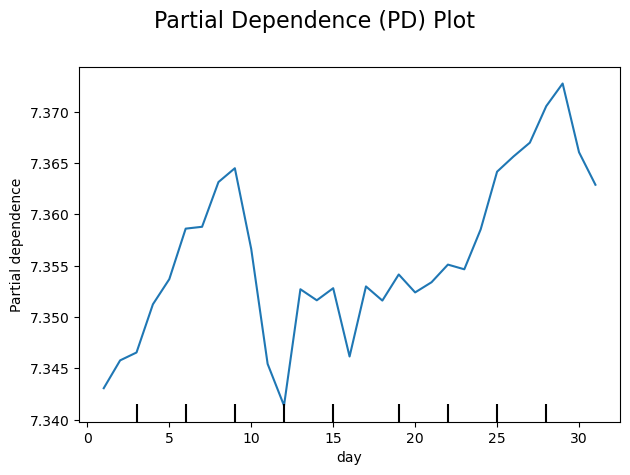

======================== ST100 Individual Conditional Expectation Plot  ===============================


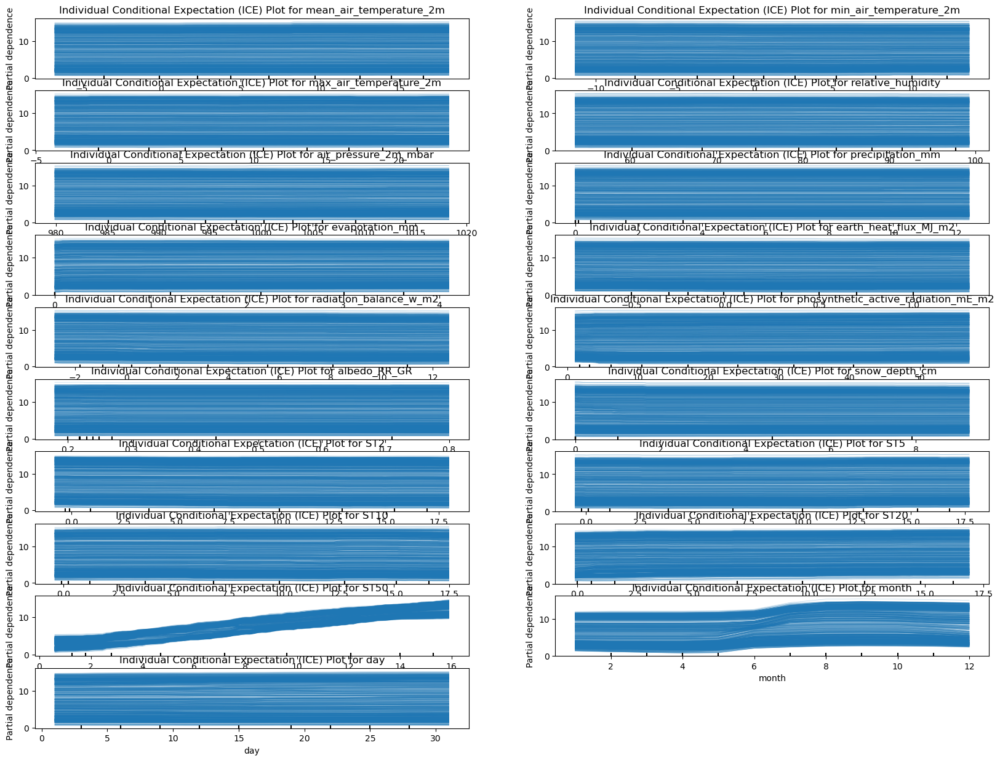

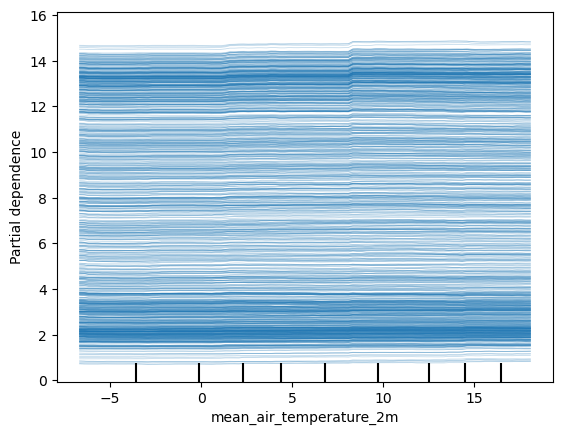

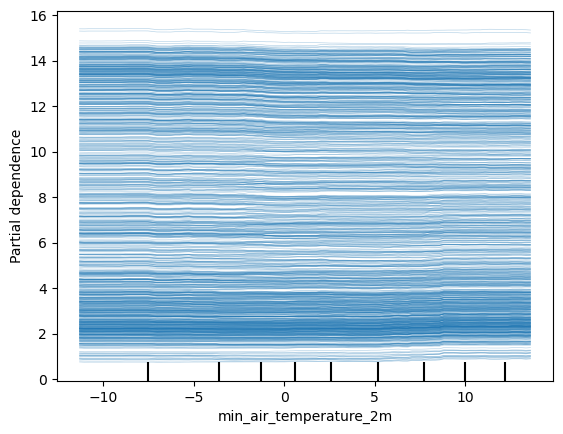

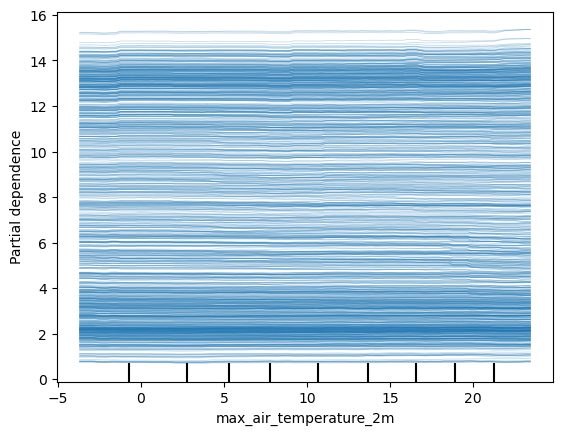

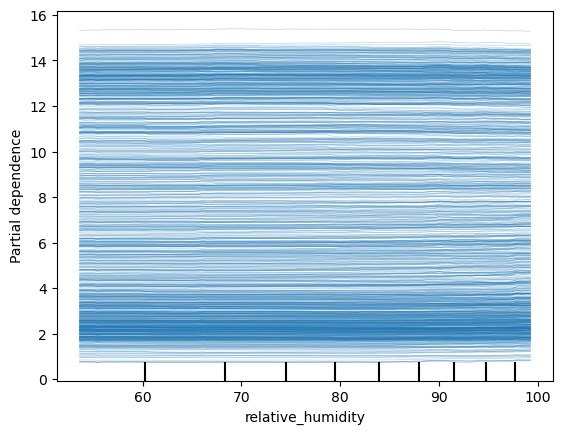

...

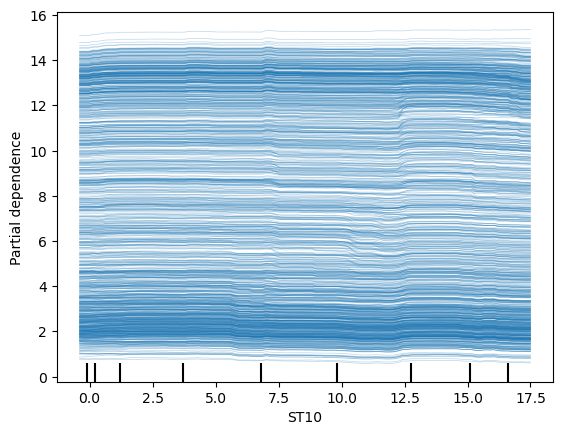

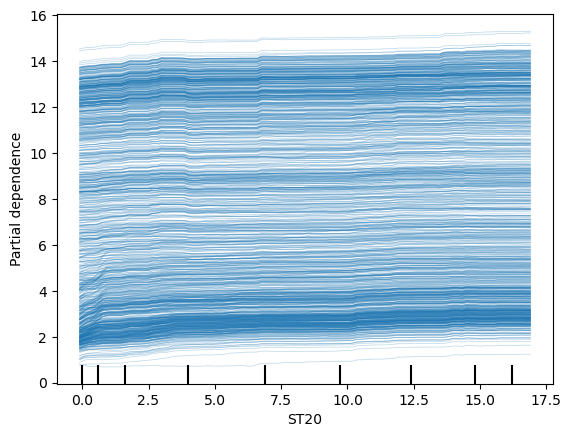

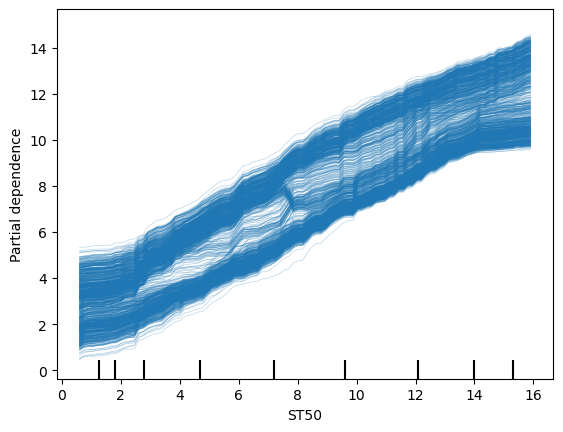

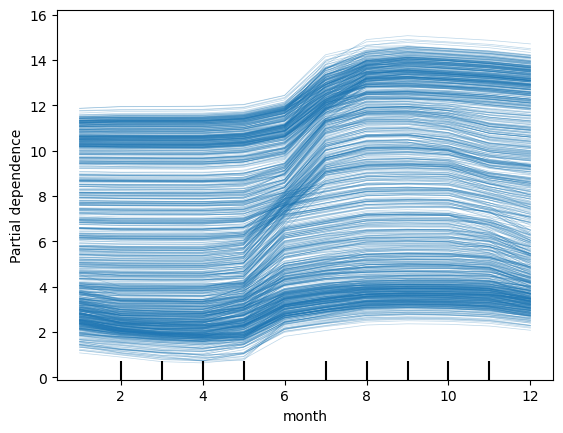

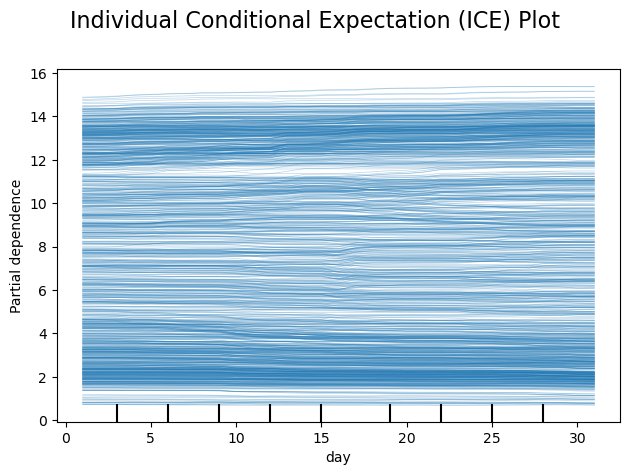

========================= ST100 Residual Analysis Plot ==============================


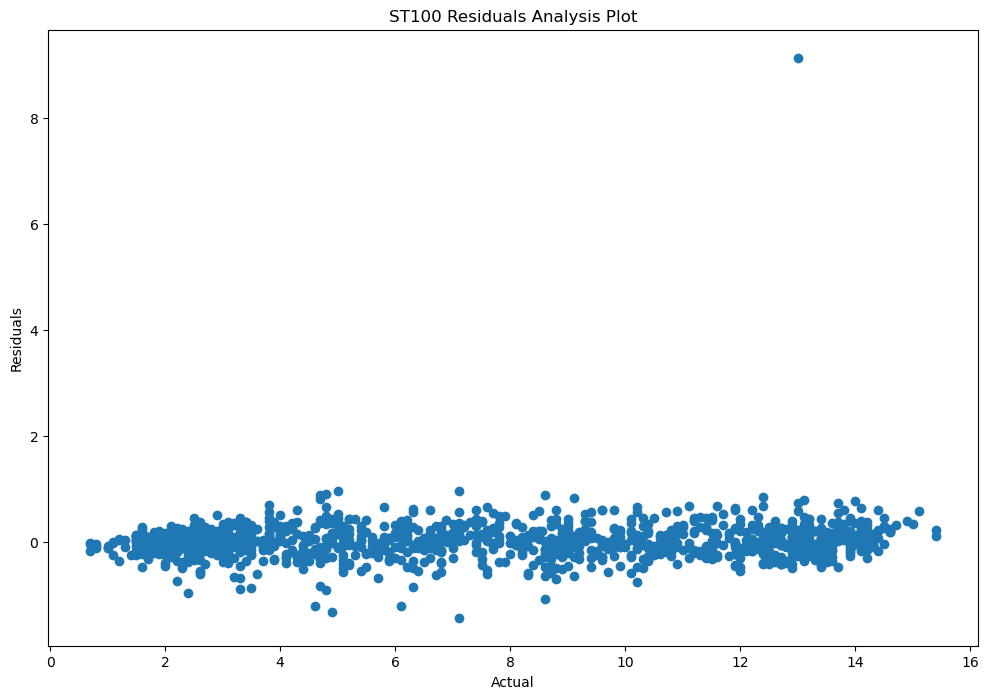

========================= ST100 Q-Q Plot ==============================


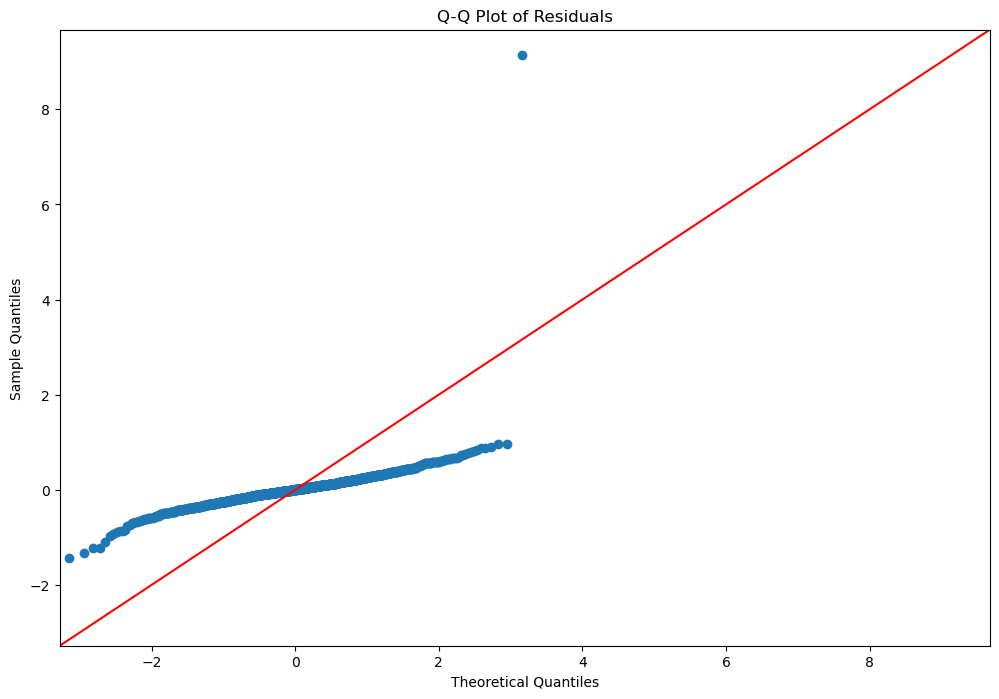

In [154]:
from sklearn.inspection import PartialDependenceDisplay
import statsmodels.api as sm
from pycebox.ice import ice, ice_plot
import matplotlib.pyplot as plt

# Partial Dependence Plot
print('====================================================== ST100 Partial Dependence Plot')
ST100_feature_names = ST100_X_train.columns.tolist()
n_features = len(ST100_feature_names)
n_cols = 2
n_rows = (n_features + n_cols - 1) // n_cols

fig1, ax1 = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 15))
axes_flat = ax1.flatten()

for idx, feature in enumerate(ST100_feature_names):
    display = PartialDependenceDisplay.from_estimator(ST100_stacking_regressor, ST100_X_train, features=[feature])
    display.plot(ax=axes_flat[idx])
    axes_flat[idx].set_title(f'Partial Dependence (PD) Plot for {feature}')
    axes_flat[idx].set_xlabel(feature)

for idx in range(n_features, len(axes_flat)):
    fig1.delaxes(axes_flat[idx])

plt.subplots_adjust(hspace=0.5)
plt.suptitle('Partial Dependence (PD) Plot', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.savefig('images/ST100_final_partial_dependence_plot.png')
plt.show()

# Individual Conditional Expectation Plot (ICE)
print('======================== ST100 Individual Conditional Expectation Plot ===============================')
fig2, axes2 = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 15))
axes_flat2 = axes2.flatten()

for idx, feature in enumerate(ST100_feature_names):
    display = PartialDependenceDisplay.from_estimator(ST100_stacking_regressor, ST100_X_train, features=[feature], kind='individual')
    display.plot(ax=axes_flat2[idx])
    axes_flat2[idx].set_title(f'Individual Conditional Expectation (ICE) Plot for {feature}')
    axes_flat2[idx].set_xlabel(feature)

for idx in range(n_features, len(axes_flat2)):
    fig2.delaxes(axes_flat2[idx])

plt.subplots_adjust(hspace=0.7)
plt.suptitle('Individual Conditional Expectation (ICE) Plot', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.savefig('images/ST100_final_individual_conditional_expectation_plot.png')
plt.show()

# Residual Analysis
print('========================= ST100 Residual Analysis Plot ==============================')
ST100_Y_predictions = ST100_stacking_regressor.predict(ST100_X_test)
ST100_residuals = ST100_Y_test - ST100_Y_predictions

fig3, ax3 = plt.subplots(figsize=(10, 7))
ax3.scatter(ST100_Y_predictions, ST100_residuals)
ax3.set_xlabel('Predictions')
ax3.set_ylabel('Residuals')
ax3.set_title('ST100 Residuals Analysis Plot')
plt.axhline(y=0, color='r', linestyle='--')
plt.savefig('images/ST100_final_residual_analysis_plot.png')
plt.show()

# Residuals vs. Predictor Variables
print('========================= Residuals vs. Predictor Variables ==============================')
for column in ST100_X_test.columns:
    fig, ax = plt.subplots(figsize=(10, 7))
    ax.scatter(ST100_X_test[column], ST100_residuals)
    ax.axhline(y=0, color='r', linestyle='--')
    ax.set_xlabel(column)
    ax.set_ylabel('Residuals')
    ax.set_title(f'Residuals vs. {column}')
    plt.savefig(f'images/ST100_final_residuals_vs_{column}.png')
    plt.show()

# Q-Q Plot
print('========================= ST100 Q-Q Plot ==============================')
fig5, ax5 = plt.subplots(figsize=(10, 7))
sm.qqplot(ST100_residuals, line='45', ax=ax5)
ax5.set_title('Q-Q Plot of Residuals')
plt.savefig('images/ST100_final_Q-Q_plot.png')
plt.show()

# Histogram of residuals
fig6, ax6 = plt.subplots(figsize=(10, 7))
plt.figure(figsize=(10, 6))
sns.histplot(residuals, kde=True, ax=ax6)
plt.xlabel('Residuals')
plt.title('Histogram of Residuals')
plt.show()


### Feature importances analysis for ST100

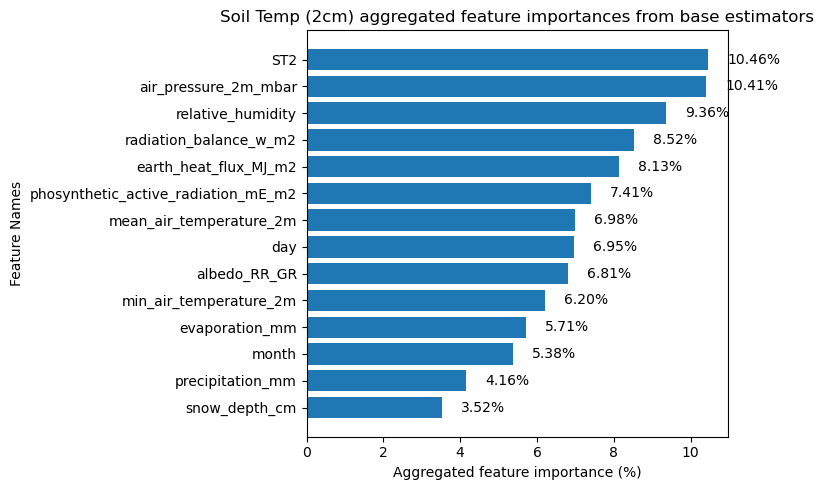

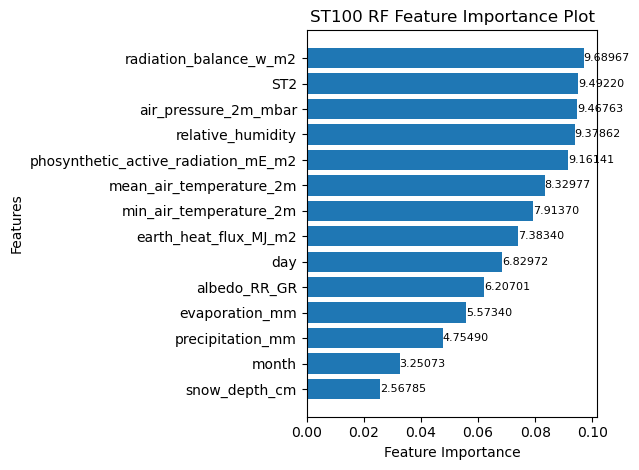

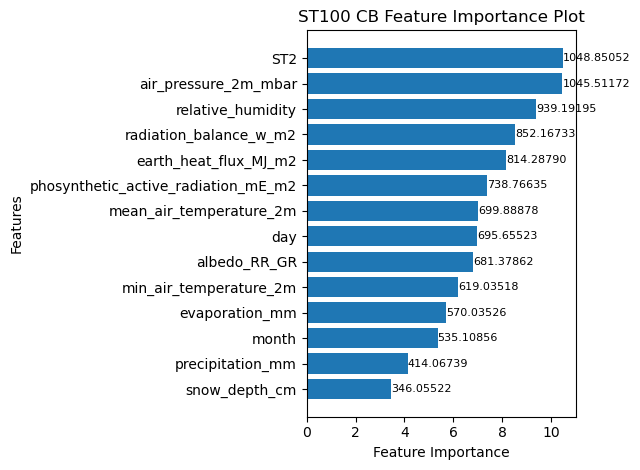

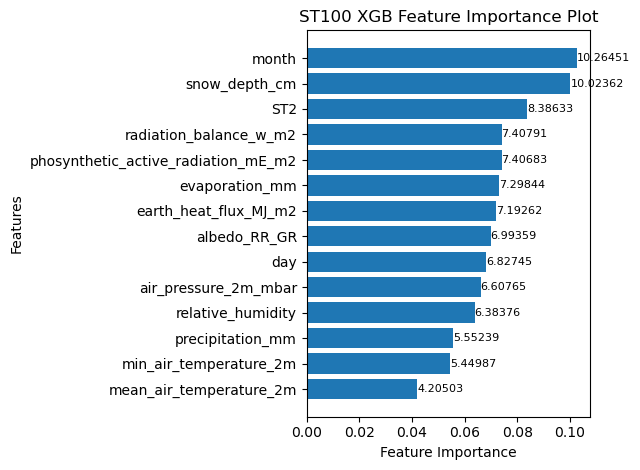

In [222]:
np.random.seed(42)
# Assuming feature_names is a list of your feature names
feature_names = ST100_X_train.columns.tolist()

estimators = [
    ("Random Forest", ST100_rf_model),
    ("Cat Boost", ST100_cb_model),
    ("XG Boost", ST100_xgb_model)
]

# Initialize an array to store aggregated feature importances
num_features = ST100_X_train.shape[1]
feature_importances = np.zeros(num_features, dtype=np.float64)

# Aggregate feature importances from base models
count = 0
for name, model in estimators:
    if hasattr(model, 'feature_importances_'):
        importances = np.array(model.feature_importances_, dtype=np.float64)
        feature_importances += importances
        count += 1
    else:
        print(f"{name} does not have feature_importances_ attribute")

# Normalize the aggregated feature importances
if count > 0:
    feature_importances /= count

# Convert feature importances to percentages
feature_importances_percentage = 100 * (feature_importances / feature_importances.sum())

# Sort the feature importances in descending order
sorted_indices = np.argsort(feature_importances_percentage)[::-1]
sorted_feature_importances_percentage = feature_importances_percentage[sorted_indices]
sorted_feature_names = [feature_names[i] for i in sorted_indices]

# Plot the sorted feature importances
plt.figure(figsize=(8, 5))
bars = plt.barh(sorted_feature_names, sorted_feature_importances_percentage)
plt.xlabel("Aggregated feature importance (%)")
plt.ylabel("Feature Names")
plt.title("Soil Temp (2cm) aggregated feature importances from base estimators")
plt.gca().invert_yaxis()  # Highest importance at the top

# Add annotations to the bars
for bar in bars:
    width = bar.get_width()
    plt.text(
        width + 0.5,  # Offset slightly to the right of the bar
        bar.get_y() + bar.get_height() / 2,  # Vertical center of the bar
        f'{width:.2f}%',  # Display the width (importance value) formatted to 2 decimal places
        va='center'
    )
# Save the figure
plt.tight_layout()
plt.savefig('data/results/ST100_stacking_regressors_feature_importances.png')
plt.show()

plot_features(ST100_X_train.columns, ST100_rf_model.feature_importances_, 'images/ST100_RF_feature_analysis.png', 'ST100 RF Feature Importance Plot')
plot_features(ST100_X_train.columns, ST100_cb_model.feature_importances_/100, 'images/ST100_CB_feature_analysis.png', 'ST100 CB Feature Importance Plot')
plot_features(ST100_X_train.columns, ST100_xgb_model.feature_importances_, 'images/ST100_XGB_feature_analysis.png', 'ST100 XGB Feature Importance Plot')

### GridSearhCV Evaluation for all models used in the stacked regressor for ST100

In [ ]:
%%time
import time
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor, HistGradientBoostingRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.model_selection import cross_val_predict, cross_validate
from catboost import CatBoostRegressor



# Define parameter grids for each model
param_grid_cb = {
    'iterations': [100, 200, 500],
    'learning_rate': [0.01, 0.1, 0.05],
    'depth': [4, 6, 10],
    'l2_leaf_reg': [1, 3, 5, 7, 9],
    'border_count': [32, 50, 100]
}
param_grid_rf = {
    'n_estimators': [100, 300, 500],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

param_grid_hgb = {
    'learning_rate': [0.01, 0.1, 0.05],
    'max_iter': [100, 200, 500],
    'max_leaf_nodes': [31, 50, 100],
    'max_depth': [None, 10, 20],
    'min_samples_leaf': [20, 50, 100],
    'l2_regularization': [0, 0.1, 1]
}

param_grid_xgb = {
    'n_estimators': [100, 200, 500],
    'learning_rate': [0.01, 0.1, 0.05],
    'max_depth': [3, 5, 7],
    'subsample': [1.0, 0.8, 0.6],
    'colsample_bytree': [1.0, 0.8, 0.6],
    'gamma': [0, 1, 5],
    'reg_alpha': [0, 0.1, 1],
    'reg_lambda': [1, 0.1, 0.01],
    'tree_method': ['gpu_hist']  # Use GPU
}
param_grid_ada = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.05],
    'loss': ['linear', 'square', 'exponential']
}
# stacking_param_grid ={
#     'rf__n_estimators': [100, 300, 500],
#     'rf__max_depth': [None, 10, 20, 30],
#     'hgb__learning_rate': [0.01, 0.1, 0.05],
#     'hgb__max_iter': [100, 200, 500],
#     'catboost__iterations': [100, 200, 500],
#     'catboost__learning_rate': [0.01, 0.1, 0.05],
#     'catboost__depth': [4, 6, 10],
#     'xgb__n_estimators': [100, 200],
#     'xgb__max_depth': [3, 5]
# }


# Initialize models
cb = CatBoostRegressor(random_state=42)
rf = RandomForestRegressor(random_state=42)
hgb = HistGradientBoostingRegressor(random_state=42)
ada = AdaBoostRegressor(random_state=42)
xgb = XGBRegressor(random_state=42, objective='reg:squarederror')

# estimators = [
#     ('rf', RandomForestRegressor()),
#     ('cb', CatBoostRegressor()),
#     ('hgb', HistGradientBoostingRegressor()),    
#     ('xgb', XGBRegressor())
# ]

# stacking_regressor = StackingRegressor(
#     estimators=estimators,
#     final_estimator=RidgeCV()
# )

# Initialize GridSearchCV for RF model
start_time_rf = time.time()
ST100_grid_search_rf = GridSearchCV(estimator=rf, param_grid=param_grid_rf, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_rf_search = time.time()
ST100_grid_search_rf.fit(ST100_X_train, ST100_Y_train)
end_time_rf_fit = time.time()
elapsed_time_search_rf = end_time_rf_search - start_time_rf
elapsed_time_fit_rf = end_time_rf_fit - end_time_rf_search
# Get the best parameters and scores
print("Best parameters for RandomForestRegressor:", ST100_grid_search_rf.best_params_)
print("Best score for RandomForestRegressor:", -ST100_grid_search_rf.best_score_)
print("RandomForestRegressor GridSearchCV Time:", elapsed_time_search_rf)
print("RandomForestRegressor Fitting Time:", elapsed_time_fit_rf)

# Initialize GridSearchCV for HGB model
start_time_hgb = time.time()
ST100_grid_search_hgb = GridSearchCV(estimator=hgb, param_grid=param_grid_hgb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_hgb_search = time.time()
ST100_grid_search_hgb.fit(ST100_X_train, ST100_Y_train)
end_time_hgb_fit = time.time()
elapsed_time_search_hgb = end_time_hgb_search - start_time_hgb
elapsed_time_fit_hgb = end_time_hgb_fit - end_time_hgb_search
# Get the best parameters and scores
print("Best parameters for HistGradientBoostingRegressor:", ST100_grid_search_hgb.best_params_)
print("Best score for HistGradientBoostingRegressor:", -ST100_grid_search_hgb.best_score_)
print("HistGradientBoostingRegressor GridSearchCV Time:", elapsed_time_search_hgb)
print("HistGradientBoostingRegressor Fitting Time:", elapsed_time_fit_hgb)

# Initialize GridSearchCV for XGB model
start_time_xgb = time.time()
ST100_grid_search_xgb = GridSearchCV(estimator=xgb, param_grid=param_grid_xgb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_xgb_search = time.time()
ST100_grid_search_xgb.fit(ST100_X_train, ST100_Y_train)
end_time_xgb_fit = time.time()
elapsed_time_search_xgb = end_time_xgb_search - start_time_xgb
elapsed_time_fit_xgb = end_time_xgb_fit - end_time_xgb_search
# Get the best parameters and scores
print("Best parameters for XGBRegressor:", ST100_grid_search_xgb.best_params_)
print("Best score for XGBRegressor:", -ST100_grid_search_xgb.best_score_)
print("XGBRegressor GridSearchCV Time:", elapsed_time_search_xgb)
print("XGBRegressor Fitting Time:", elapsed_time_fit_xgb)

# Initialize GridSearchCV for ADA model
start_time_ada = time.time()
ST100_grid_search_ada = GridSearchCV(estimator=ada, param_grid=param_grid_ada, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_ada_search = time.time()
ST100_grid_search_ada.fit(ST100_X_train, ST100_Y_train)
end_time_ada_fit = time.time()
elapsed_time_search_ada = end_time_ada_search - start_time_ada
elapsed_time_fit_ada = end_time_ada_fit - end_time_ada_search
# Get the best parameters and scores
print("Best parameters for AdaBoostRegressor:", ST100_grid_search_ada.best_params_)
print("Best score for AdaBoostRegressor:", -ST100_grid_search_ada.best_score_)
print("AdaBoostRegressor GridSearchCV Time:", elapsed_time_search_ada)
print("AdaBoostRegressor Fitting Time:", elapsed_time_fit_ada)

# Initialize GridSearchCV for CB model
start_time_cb = time.time()
ST100_grid_search_cb = GridSearchCV(estimator=cb, param_grid=param_grid_cb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_cb_search = time.time()
ST100_grid_search_cb.fit(ST100_X_train, ST100_Y_train)
end_time_cb_fit = time.time()
elapsed_time_search_cb = end_time_cb_search - start_time_cb
elapsed_time_fit_cb = end_time_cb_fit - end_time_cb_search
# Get the best parameters and scores
print("Best parameters for CatBoostRegressor:", ST100_grid_search_cb.best_params_)
print("Best score for CatBoost:", -ST100_grid_search_cb.best_score_)
print("CatBoostRegressor GridSearchCV Time:", elapsed_time_search_cb)
print("CatBoostRegressor Fitting Time:", elapsed_time_fit_cb)

# # Initialize GridSearchCV for Stacking model
# start_time_stacking = time.time()
# ST100_grid_search_stacking = GridSearchCV(estimator=stacking_regressor, param_grid=stacking_param_grid, cv=5, n_jobs=-1, verbose=0,scoring='neg_mean_absolute_error')
# end_time_stacking_search = time.time()
# ST100_grid_search_stacking.fit(ST100_X_train, ST100_Y_train)
# end_time_stacking = time.time()
# elapsed_time_search_stacking = end_time_stacking_search - start_time_stacking
# elapsed_time_fit_stacking = end_time_stacking_fit - end_time_stacking_search

# print("Best parameters for StackingRegressor:", ST100_grid_search_stacking.best_params_)
# print("Best score for StackingRegressor:", -ST100_grid_search_stacking.best_score_)
# print("StackingRegressor GridSearchCV Time:", elapsed_time_search_stacking)
# print("StackingRegressor Fitting Time:", elapsed_time_fit_stacking)

# Define the results of print statements as variables
ST100_grid_search_and_fitting_results = {
    'Model': ['RandomForestRegressor', 'HistGradientBoostingRegressor', 'AdaBoostRegressor', 'XGBRegressor'],
    'Best Parameters': [ST100_grid_search_rf.best_params_, ST100_grid_search_hgb.best_params_, ST100_grid_search_ada.best_params_, ST100_grid_search_xgb.best_params_],
    'Best Score': [-ST100_grid_search_rf.best_score_, -ST100_grid_search_hgb.best_score_, -ST100_grid_search_ada.best_score_, -ST100_grid_search_xgb.best_score_],
    'GridSearchCV Time': [elapsed_time_search_rf, elapsed_time_search_hgb, elapsed_time_search_ada, elapsed_time_search_xgb],
    'Fitting Time': [elapsed_time_fit_rf, elapsed_time_fit_hgb, elapsed_time_fit_ada, elapsed_time_fit_xgb]
}

# Create a DataFrame
df_results = pd.DataFrame(ST100_grid_search_and_fitting_results)

# Export DataFrame to Excel
df_results.to_excel('data/ST100_grid_search_and_fitting_results.xlsx', index=False)

In [224]:
ST100_dataset_denormalized_outlier_filtered_uncorrelated

,mean_air_temperature_2m,min_air_temperature_2m,relative_humidity,air_pressure_2m_mbar,precipitation_mm,evaporation_mm,earth_heat_flux_MJ_m2,radiation_balance_w_m2,phosynthetic_active_radiation_mE_m2,albedo_RR_GR,snow_depth_cm,ST2,month,day,ID,ST100
1,0.6,-3.6,98.2,993.3,1.200000,0.0,-0.2,-0.44,1.68,0.17,8.187500,-8.881784e-16,1.0,5.0,2,3.4
3,1.8,-2.8,88.9,997.9,1.886364,0.0,-0.2,-4.28,2.77,0.25,8.444444,-8.881784e-16,1.0,9.0,4,3.4
4,-0.3,-4.6,92.2,1009.6,0.500000,0.0,-0.2,0.05,2.48,0.09,8.555556,-8.881784e-16,1.0,10.0,5,3.4
7,1.3,-0.1,96.3,1002.6,0.100000,0.0,-0.2,-0.23,1.00,0.24,10.000000,-8.881784e-16,1.0,13.0,8,3.2
9,2.9,-1.4,91.9,992.8,0.000000,0.0,0.1,-1.46,4.23,0.24,7.912500,-5.000000e-01,2.0,4.0,10,3.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5188,5.2,2.4,90.0,976.7,7.600000,0.0,0.6,0.45,13.34,0.21,0.000000,1.600000e+00,3.0,28.0,5386,11.9
5189,5.9,4.7,93.6,978.3,2.600000,0.0,0.8,0.29,9.17,0.18,0.000000,2.900000e+00,3.0,29.0,5387,11.9
5190,5.9,4.0,94.4,990.1,2.000000,0.0,0.7,0.61,9.32,0.18,4.428571,3.500000e+00,3.0,30.0,5388,11.8
5191,6.2,2.4,93.6,988.1,2.900000,0.0,0.6,0.02,8.09,0.18,4.571429,4.200000e+00,3.0,31.0,5389,11.7


In [226]:
ST100_clean_dataset_denormalized

,mean_air_temperature_2m,min_air_temperature_2m,max_air_temperature_2m,relative_humidity,air_pressure_2m_mbar,precipitation_mm,evaporation_mm,earth_heat_flux_MJ_m2,radiation_balance_w_m2,phosynthetic_active_radiation_mE_m2,...,snow_depth_cm,ST2,ST5,ST10,ST20,ST50,ST100,month,day,ID
1,0.6,-3.6,4.4,98.2,993.3,1.200000,0.0,-0.2,-0.44,1.68,...,8.187500,-8.881784e-16,0.0,0.1,0.5,1.9,3.4,1.0,5.0,5
3,1.8,-2.8,3.7,88.9,997.9,1.886364,0.0,-0.2,-4.28,2.77,...,8.444444,-8.881784e-16,0.0,0.2,0.5,1.8,3.2,1.0,9.0,9
4,-0.3,-4.6,4.2,92.2,1009.6,0.500000,0.0,-0.2,0.05,2.48,...,8.555556,-8.881784e-16,0.1,0.2,0.5,1.8,3.1,1.0,10.0,10
7,1.3,-0.1,3.8,96.3,1002.6,0.100000,0.0,-0.2,-0.23,1.00,...,10.000000,-8.881784e-16,0.2,0.4,0.7,1.8,3.1,1.0,13.0,13
9,2.9,-1.4,5.6,91.9,992.8,0.000000,0.0,0.1,-1.46,4.23,...,7.912500,-5.000000e-01,-0.6,-0.6,-0.2,1.3,2.5,2.0,4.0,35
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5188,5.2,2.4,7.9,90.0,976.7,7.600000,0.0,0.6,0.45,13.34,...,0.000000,1.600000e+00,1.3,1.0,0.9,1.2,2.0,3.0,28.0,8852
5189,5.9,4.7,7.4,93.6,978.3,2.600000,0.0,0.8,0.29,9.17,...,0.000000,2.900000e+00,2.6,2.1,1.7,1.5,2.1,3.0,29.0,8853
5190,5.9,4.0,7.4,94.4,990.1,2.000000,0.0,0.7,0.61,9.32,...,4.428571,3.500000e+00,3.3,2.8,2.5,1.9,2.2,3.0,30.0,8854
5191,6.2,2.4,8.0,93.6,988.1,2.900000,0.0,0.6,0.02,8.09,...,4.571429,4.200000e+00,4.1,3.6,3.1,2.4,2.3,3.0,31.0,8855


In [227]:
dataset_denormalized_outlier_filtered

,mean_air_temperature_2m,min_air_temperature_2m,max_air_temperature_2m,relative_humidity,air_pressure_2m_mbar,precipitation_mm,evaporation_mm,earth_heat_flux_MJ_m2,radiation_balance_w_m2,phosynthetic_active_radiation_mE_m2,...,snow_depth_cm,ST2,ST5,ST10,ST20,ST50,ST100,month,day,ID
0,-5.0,-7.6,-3.0,100.0,1001.5,2.635294,0.0,-0.3,-0.12,1.17,...,4.666667,-2.000000e-01,-0.1,0.1,0.4,1.9,3.4,1.0,1.0,1
1,0.6,-5.0,4.0,88.6,997.7,2.334783,0.0,-0.2,-2.21,1.62,...,6.444444,-1.000000e-01,-0.1,0.0,0.4,1.9,3.4,1.0,2.0,2
2,2.1,-1.1,4.6,88.6,991.5,8.800000,0.0,-0.1,-1.80,0.71,...,6.500000,-1.000000e-01,-0.1,0.0,0.5,1.9,3.4,1.0,3.0,3
3,1.8,-3.3,4.4,67.3,987.0,2.100000,0.0,-0.1,-4.83,2.49,...,6.437500,-8.881784e-16,0.0,0.1,0.5,1.9,3.4,1.0,4.0,4
4,0.6,-3.6,4.4,98.2,993.3,1.200000,0.0,-0.2,-0.44,1.68,...,8.187500,-8.881784e-16,0.0,0.1,0.5,1.9,3.4,1.0,5.0,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8247,5.2,2.4,7.9,90.0,976.7,7.600000,0.0,0.6,0.45,13.34,...,0.000000,1.600000e+00,1.3,1.0,0.9,1.2,2.0,3.0,28.0,8852
8248,5.9,4.7,7.4,93.6,978.3,2.600000,0.0,0.8,0.29,9.17,...,0.000000,2.900000e+00,2.6,2.1,1.7,1.5,2.1,3.0,29.0,8853
8249,5.9,4.0,7.4,94.4,990.1,2.000000,0.0,0.7,0.61,9.32,...,4.428571,3.500000e+00,3.3,2.8,2.5,1.9,2.2,3.0,30.0,8854
8250,6.2,2.4,8.0,93.6,988.1,2.900000,0.0,0.6,0.02,8.09,...,4.571429,4.200000e+00,4.1,3.6,3.1,2.4,2.3,3.0,31.0,8855


# 8. AutoRegressive Integrated Moving Average (ARIMA) and Seasonal AutoRegressive Integrated Moving Average (SARIMA) For ST2

In [153]:
# # Import necessary libraries
# import pandas as pd
# import numpy as np
# import matplotlib.pyplot as plt
# from statsmodels.tsa.arima.model import ARIMA
# from sklearn.metrics import mean_squared_error

# # 1. Load and Prepare the Dataset
# # Load the dataset
# dataset_new = pd.read_csv('data/NMBUBigDatasetFinal.csv')

# # Convert 'date' column to datetime format
# dataset_new['date'] = pd.to_datetime(dataset_new['date'])

# # Set 'date' column as index
# dataset_new.set_index('date', inplace=True)

# # Plot each feature as a separate subplot
# fig, axes = plt.subplots(nrows=len(dataset_new.columns), ncols=1, figsize=(10, 5*len(dataset_new.columns)), sharex=True)

# for i, col in enumerate(dataset_new.columns):
#     axes[i].plot(dataset_new.index, dataset_new[col], label=col)
#     axes[i].set_ylabel(col)
#     axes[i].legend()
    
# plt.xlabel('Date')
# plt.tight_layout()
# plt.show()
# # 3. Feature Selection
# # Select relevant features and preprocess the data as needed

# # 4. Split the Dataset
# # Split the dataset into training and testing sets

# # 5. Build the ARIMA Model
# # Determine optimal parameters (p, d, q) using grid search or other techniques

# # # 6. Fit the ARIMA Model
# # # Fit ARIMA model to training data
# # model = ARIMA(dataset_new['ST2'], order=(p, d, q))
# # fitted_model = model.fit()

# # # 7. Fit the SARIMA Model
# # # Fit SARIMA model to training data
# # sarima_model = SARIMAX(dataset_new['ST2'], order=(p, d, q), seasonal_order=(P, D, Q, s))
# # sarima_fitted_model = sarima_model.fit()

# # # 8. Make Predictions
# # # Make predictions on testing set
# # predictions = fitted_model.forecast(steps=len(test_data))

# # # In-sample forecasting
# # forecast_values_in_sample = sarima_fitted_model.predict(start=start_date, end=end_date)
# # # Out-of-sample forecasting
# # forecast_values_out_of_sample = sarima_fitted_model.forecast(steps=num_steps)

# # # 9. Evaluate the Model
# # # Evaluate model performance using evaluation metrics
# # mse = mean_squared_error(test_data['ST2'], predictions)
# # rmse = np.sqrt(mse)

# # # Visualize actual vs predicted values
# # plt.plot(test_data.index, test_data['ST2'], label='Actual')
# # plt.plot(test_data.index, predictions, label='Predicted')
# # plt.legend()
# # plt.show()

### Explore for the extreme values of in each feature and either remove or limit them to the maximum/minimum possible values for each feature

In [154]:
# # 2. Exploratory Data Analysis (EDA)
# # Conduct EDA and visualize the time series data
# # Replace values greater than 1050 with 1050 in the 'air_pressure_2m_mbar' column because values above 1050 are considered outliers
# dataset_new_copied = dataset_new.copy()
# dataset_new_copied.drop(['snow_depth_cm','evaporation_mm'], axis=1, inplace=True)
# dataset_new_copied.loc[dataset_new_copied['air_pressure_2m_mbar'] > 1050, 'air_pressure_2m_mbar'] = 1050

# # Replace values less than -3 with -3 in the 'earth_heat_flux_MJ_m2' column because values below -3 are considered outliers
# dataset_new_copied.loc[dataset_new_copied['earth_heat_flux_MJ_m2'] < -3, 'earth_heat_flux_MJ_m2'] = -3

# # Replace values less than -1 with -1 in the 'ST50' column because values below -1 are considered outliers
# dataset_new_copied.loc[dataset_new_copied['ST50'] < -1, 'ST50'] = -1

# # Replace values greater than 1 with 1 in the 'albedo_RR_GR' column because values above 1 are considered outliers
# dataset_new_copied.loc[dataset_new_copied['albedo_RR_GR'] > 1, 'albedo_RR_GR'] = 1

# # # Replace values greater than 33 with 33 in the 'snow_depth_cm' column because values above 33 are considered outliers
# # dataset_new_copied.loc[dataset_new_copied['snow_depth_cm'] > 33, 'snow_depth_cm'] = 33

# # # Replace values greater than 33 with 33 in the 'snow_depth_cm' column because values above 33 are considered outliers
# # dataset_new_copied.loc[dataset_new_copied['snow_depth_cm'] > 33, 'snow_depth_cm'] = 33

# # Plot each feature as a separate subplot
# fig, axes = plt.subplots(nrows=len(dataset_new_copied.columns), ncols=1, figsize=(10, 5*len(dataset_new_copied.columns)), sharex=True)

# for i, col in enumerate(dataset_new_copied.columns):
#     axes[i].plot(dataset_new_copied.index, dataset_new_copied[col], label=col)
#     axes[i].set_ylabel(col)
#     axes[i].legend()
    
# plt.xlabel('Date')
# plt.tight_layout()
# plt.show()

In [155]:
dataset_new_copied

NameError: name 'dataset_new_copied' is not defined

### Seasonal decomposition of time series (STL) and classical seasonal decomposition of ST2

In [ ]:
# import pandas as pd
# import matplotlib.pyplot as plt
# from statsmodels.tsa.seasonal import STL, seasonal_decompose

# dataset_denormalized_outlier_filtered_decompose = dataset_denormalized_outlier_filtered.merge(dataset_copied[['date']], left_index=True, right_index=True, how='left')
# # Set 'date' column as index
# dataset_denormalized_outlier_filtered_decompose.set_index('date', inplace=True)
# # Perform seasonal decomposition using STL
# stl = STL(dataset_denormalized_outlier_filtered_decompose['ST2'], seasonal=365)  # Assuming a seasonal period of 365 (for yearly data)
# result_stl = stl.fit()

# # Plot the decomposition
# fig = result_stl.plot()
# plt.show()

# # Perform seasonal decomposition using classical seasonal decomposition
# result_classical = seasonal_decompose(dataset_denormalized_outlier_filtered_decompose['ST2'], model='multiplicative')  # You can choose 'additive' or 'multiplicative'

# # Plot the decomposition
# fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(10, 8))
# result_classical.observed.plot(ax=ax1)
# ax1.set_ylabel('Observed')
# result_classical.trend.plot(ax=ax2)
# ax2.set_ylabel('Trend')
# result_classical.seasonal.plot(ax=ax3)
# ax3.set_ylabel('Seasonal')
# result_classical.resid.plot(ax=ax4)
# ax4.set_ylabel('Residual')
# plt.tight_layout()
# plt.show()

### Update the requirements.txt file with the updated list of packages

In [ ]:
# !pip freeze > all_requirements.txt

In [ ]:
# # Read all_requirements.txt and filter out non-standard lines
# with open('all_requirements.txt', 'r') as infile, open('requirements.txt', 'w') as outfile:
#     for line in infile:
#         # Only write lines that match the standard format
#         if '==' in line and '@' not in line:
#             outfile.write(line)

In [ ]:
# !pip install -r requirements.txt

In [ ]:
# # Initialize GridSearchCV for RF model
# start_time_rf = time.time()
# ST2_grid_search_rf = GridSearchCV(estimator=rf, param_grid=param_grid_rf, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
# end_time_rf_search = time.time()
# ST2_grid_search_rf.fit(ST2_X_train, ST2_Y_train)
# end_time_rf_fit = time.time()
# elapsed_time_search_rf = end_time_rf_search - start_time_rf
# elapsed_time_fit_rf = end_time_rf_fit - end_time_rf_search
# # Get the best parameters and scores
# print("Best parameters for RandomForestRegressor:", ST2_grid_search_rf.best_params_)
# print("Best score for RandomForestRegressor:", -ST2_grid_search_rf.best_score_)
# print("RandomForestRegressor GridSearchCV Time:", elapsed_time_search_rf)
# print("RandomForestRegressor Fitting Time:", elapsed_time_fit_rf)

# # Initialize GridSearchCV for HGB model
# start_time_hgb = time.time()
# ST2_grid_search_hgb = GridSearchCV(estimator=hgb, param_grid=param_grid_hgb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
# end_time_hgb_search = time.time()
# ST2_grid_search_hgb.fit(ST2_X_train, ST2_Y_train)
# end_time_hgb_fit = time.time()
# elapsed_time_search_hgb = end_time_hgb_search - start_time_hgb
# elapsed_time_fit_hgb = end_time_hgb_fit - end_time_hgb_search
# # Get the best parameters and scores
# print("Best parameters for HistGradientBoostingRegressor:", ST2_grid_search_hgb.best_params_)
# print("Best score for HistGradientBoostingRegressor:", -ST2_grid_search_hgb.best_score_)
# print("HistGradientBoostingRegressor GridSearchCV Time:", elapsed_time_search_hgb)
# print("HistGradientBoostingRegressor Fitting Time:", elapsed_time_fit_hgb)

In [ ]:
%%time
import time
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor, HistGradientBoostingRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import StackingRegressor
from sklearn.linear_model import RidgeCV
from sklearn.model_selection import cross_val_predict, cross_validate
from catboost import CatBoostRegressor



# Define parameter grids for each model
param_grid_cb = {
    'iterations': [100, 200, 500],
    'learning_rate': [0.01, 0.1, 0.05],
    'depth': [4, 6, 10],
    'l2_leaf_reg': [1, 3, 5, 7, 9],
    'border_count': [32, 50, 100]
}
param_grid_rf = {
    'n_estimators': [100, 300, 500],
    'max_features': [None, 'sqrt', 'log2'],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

param_grid_hgb = {
    'learning_rate': [0.01, 0.1, 0.05],
    'max_iter': [100, 200, 500],
    'max_leaf_nodes': [31, 50, 100],
    'max_depth': [None, 10, 20],
    'min_samples_leaf': [20, 50, 100],
    'l2_regularization': [0, 0.1, 1]
}

param_grid_xgb = {
    'n_estimators': [100, 200, 500],
    'learning_rate': [0.01, 0.1, 0.05],
    'max_depth': [3, 5, 7],
    'subsample': [1.0, 0.8, 0.6],
    'colsample_bytree': [1.0, 0.8, 0.6],
    'gamma': [0, 1, 5],
    'reg_alpha': [0, 0.1, 1],
    'reg_lambda': [1, 0.1, 0.01],
    'tree_method': ['gpu_hist']  # Use GPU
}
param_grid_ada = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.05],
    'loss': ['linear', 'square', 'exponential']
}
# stacking_param_grid ={
#     'rf__n_estimators': [100, 300, 500],
#     'rf__max_depth': [None, 10, 20, 30],
#     'hgb__learning_rate': [0.01, 0.1, 0.05],
#     'hgb__max_iter': [100, 200, 500],
#     'catboost__iterations': [100, 200, 500],
#     'catboost__learning_rate': [0.01, 0.1, 0.05],
#     'catboost__depth': [4, 6, 10],
#     'xgb__n_estimators': [100, 200],
#     'xgb__max_depth': [3, 5]
# }


# Initialize models
cb = CatBoostRegressor(random_state=42)
rf = RandomForestRegressor(random_state=42)
hgb = HistGradientBoostingRegressor(random_state=42)
ada = AdaBoostRegressor(random_state=42)
xgb = XGBRegressor(random_state=42, objective='reg:squarederror')

# estimators = [
#     ('rf', RandomForestRegressor()),
#     ('cb', CatBoostRegressor()),
#     ('hgb', HistGradientBoostingRegressor()),    
#     ('xgb', XGBRegressor())
# ]

# stacking_regressor = StackingRegressor(
#     estimators=estimators,
#     final_estimator=RidgeCV()
# )

# Initialize GridSearchCV for RF model
start_time_rf = time.time()
ST2_grid_search_rf = GridSearchCV(estimator=rf, param_grid=param_grid_rf, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_rf_search = time.time()
ST2_grid_search_rf.fit(ST2_X_train, ST2_Y_train)
end_time_rf_fit = time.time()
elapsed_time_search_rf = end_time_rf_search - start_time_rf
elapsed_time_fit_rf = end_time_rf_fit - end_time_rf_search
# Get the best parameters and scores
print("Best parameters for RandomForestRegressor:", ST2_grid_search_rf.best_params_)
print("Best score for RandomForestRegressor:", -ST2_grid_search_rf.best_score_)
print("RandomForestRegressor GridSearchCV Time:", elapsed_time_search_rf)
print("RandomForestRegressor Fitting Time:", elapsed_time_fit_rf)

# Initialize GridSearchCV for HGB model
start_time_hgb = time.time()
ST2_grid_search_hgb = GridSearchCV(estimator=hgb, param_grid=param_grid_hgb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_hgb_search = time.time()
ST2_grid_search_hgb.fit(ST2_X_train, ST2_Y_train)
end_time_hgb_fit = time.time()
elapsed_time_search_hgb = end_time_hgb_search - start_time_hgb
elapsed_time_fit_hgb = end_time_hgb_fit - end_time_hgb_search
# Get the best parameters and scores
print("Best parameters for HistGradientBoostingRegressor:", ST2_grid_search_hgb.best_params_)
print("Best score for HistGradientBoostingRegressor:", -ST2_grid_search_hgb.best_score_)
print("HistGradientBoostingRegressor GridSearchCV Time:", elapsed_time_search_hgb)
print("HistGradientBoostingRegressor Fitting Time:", elapsed_time_fit_hgb)

# # Initialize GridSearchCV for XGB model
# start_time_xgb = time.time()
# ST2_grid_search_xgb = GridSearchCV(estimator=xgb, param_grid=param_grid_xgb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
# end_time_xgb_search = time.time()
# ST2_grid_search_xgb.fit(ST2_X_train, ST2_Y_train)
# end_time_xgb_fit = time.time()
# elapsed_time_search_xgb = end_time_xgb_search - start_time_xgb
# elapsed_time_fit_xgb = end_time_xgb_fit - end_time_xgb_search
# # Get the best parameters and scores
# print("Best parameters for XGBRegressor:", ST2_grid_search_xgb.best_params_)
# print("Best score for XGBRegressor:", -ST2_grid_search_xgb.best_score_)
# print("XGBRegressor GridSearchCV Time:", elapsed_time_search_xgb)
# print("XGBRegressor Fitting Time:", elapsed_time_fit_xgb)

# Initialize GridSearchCV for ADA model
start_time_ada = time.time()
ST2_grid_search_ada = GridSearchCV(estimator=ada, param_grid=param_grid_ada, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
end_time_ada_search = time.time()
ST2_grid_search_ada.fit(ST2_X_train, ST2_Y_train)
end_time_ada_fit = time.time()
elapsed_time_search_ada = end_time_ada_search - start_time_ada
elapsed_time_fit_ada = end_time_ada_fit - end_time_ada_search
# Get the best parameters and scores
print("Best parameters for AdaBoostRegressor:", ST2_grid_search_ada.best_params_)
print("Best score for AdaBoostRegressor:", -ST2_grid_search_ada.best_score_)
print("AdaBoostRegressor GridSearchCV Time:", elapsed_time_search_ada)
print("AdaBoostRegressor Fitting Time:", elapsed_time_fit_ada)

# # Initialize GridSearchCV for CB model
# start_time_cb = time.time()
# ST2_grid_search_cb = GridSearchCV(estimator=cb, param_grid=param_grid_cb, cv=5, n_jobs=-1, scoring='neg_mean_absolute_error')
# end_time_cb_search = time.time()
# ST2_grid_search_cb.fit(ST2_X_train, ST2_Y_train)
# end_time_cb_fit = time.time()
# elapsed_time_search_cb = end_time_cb_search - start_time_cb
# elapsed_time_fit_cb = end_time_cb_fit - end_time_cb_search
# # Get the best parameters and scores
# print("Best parameters for CatBoostRegressor:", ST2_grid_search_cb.best_params_)
# print("Best score for CatBoost:", -ST2_grid_search_cb.best_score_)
# print("CatBoostRegressor GridSearchCV Time:", elapsed_time_search_cb)
# print("CatBoostRegressor Fitting Time:", elapsed_time_fit_cb)

# # Initialize GridSearchCV for Stacking model
# start_time_stacking = time.time()
# ST2_grid_search_stacking = GridSearchCV(estimator=stacking_regressor, param_grid=stacking_param_grid, cv=5, n_jobs=-1, verbose=0,scoring='neg_mean_absolute_error')
# end_time_stacking_search = time.time()
# ST2_grid_search_stacking.fit(ST2_X_train, ST2_Y_train)
# end_time_stacking = time.time()
# elapsed_time_search_stacking = end_time_stacking_search - start_time_stacking
# elapsed_time_fit_stacking = end_time_stacking_fit - end_time_stacking_search

# print("Best parameters for StackingRegressor:", ST2_grid_search_stacking.best_params_)
# print("Best score for StackingRegressor:", -ST2_grid_search_stacking.best_score_)
# print("StackingRegressor GridSearchCV Time:", elapsed_time_search_stacking)
# print("StackingRegressor Fitting Time:", elapsed_time_fit_stacking)

# # Define the results of print statements as variables
# ST2_grid_search_and_fitting_results = {
#     'Model': ['RandomForestRegressor', 'HistGradientBoostingRegressor', 'AdaBoostRegressor', 'XGBRegressor'],
#     'Best Parameters': [ST2_grid_search_rf.best_params_, ST2_grid_search_hgb.best_params_, ST2_grid_search_ada.best_params_, ST2_grid_search_xgb.best_params_],
#     'Best Score': [-ST2_grid_search_rf.best_score_, -ST2_grid_search_hgb.best_score_, -ST2_grid_search_ada.best_score_, -ST2_grid_search_xgb.best_score_],
#     'GridSearchCV Time': [elapsed_time_search_rf, elapsed_time_search_hgb, elapsed_time_search_ada, elapsed_time_search_xgb],
#     'Fitting Time': [elapsed_time_fit_rf, elapsed_time_fit_hgb, elapsed_time_fit_ada, elapsed_time_fit_xgb]
# }

# # Create a DataFrame
# df_results = pd.DataFrame(ST2_grid_search_and_fitting_results)

# # Export DataFrame to Excel
# df_results.to_excel('data/ST2_grid_search_and_fitting_results.xlsx', index=False)